# <b>Project Definition</b>

### <b>Domain Background</b>

In the field of instrumental analytical chemistry, there are many techniques for identifying unknown substances. This field is primarily researched for the detection of explosives, drugs and chemical weapons, however, there are many other applications for it. In the healthcare field, researchers are using it to detect cancer and diseases.
Chromatography is a method by which a substance is separated into different components and split across time. For example, if you sample a mixture that is made up of multiple substances you could separate those substances and detect them individually with chromatography. One method of chromatography is using what is called a column. This device is what will separate out the components of a mixture, however, it is extremely slow. It takes minutes to work.

Mass spectrometry is the technique of identifying the chemical structure of a substance by separating ions into differing mass and charge. The three essential components of a mass spectrometer are the ion source, the mass analyzer, and the detector. The ionizer ionizes the sampled substance. The analyzer sorts and separates the ions by mass and charge. The detector measures or counts the separated ions. Ions can be displayed as a histogram of mass-to-charge ratio(m/z) or can be displayed across time to see line curves where the peaks would be where the max quantity of ions were detected. There are many different techniques for each component in performing the identification of substances.


The most popular analytical technique today is ion-mobility spectrometry (IMS). This technique separates and identifies ionized molecules based on their mobility within a carrier gas. It is extremely fast and takes milliseconds to achieve a result, but it is less sensitive than other techniques. This technique is very popular because you can make an IMS device for relative low cost compared to other techniques and the device can be small enough to be hand-held.

The final technique that we will discuss is triple quadrupole mass spectrometry (TQMS). This is a tandem mass spectrometry technique, which just means it has two analyzers. The components in order are the ion source, a quadrupole mass analyzer, a quadrupole that acts as a collision cell to fragment the molecules entering it, a second analyzer that analyzes the resulting fragments, and finally the detector. The quadrupole works by creating an electro-magnetic field that separates the ions and makes them follow a trajectory based on their mass-to-charge ratio (m/z). This technique in theory is the most sensitive and will achieve results in seconds. These devices tend to be very expensive and large. This is the device a team and I are working on.

The above techniques discussed can all be combined to solve problems depending on the application. There are trade-offs that must be made for each technique. Cost and weight are always a major factor. In some cases, the science is not well understood.

### Problem Statement

My team and I are currently working on a triple quad mass spectrometer that is cheaper and smaller so that we can address new markets and applications that TQMS was unable to address previously. Our current instrument displays mass-to-charge ratios over time. We have in the past used peak thresholds to determine what is a detected substance. This technique only gives us an accuracy of 40% with a very high rate of false positives. We are trying to achieve an accuracy of 90% with no more than a 2% false positive rate. We have talked about adding some filtering techniques, but there will be a tradeoff in time and cost. We need to complete our analysis in under 10 seconds. Ideally, we can solve our problem with purely algorithms.

### Data sets and Input

The datasets that will be used in this project were generated from collected samples from our instrument. The instrument was sent out for testing and 12 different substances were tested. The data files we got back are the results from that testing. The datasets are generated from these data files. The datasets have been modified to abstract out any sensitive details such as the substance name and mass pairs. Most importantly the intensities are all generated to mimic the shape of the collected data. The data has also been filtered to remove any malformed data because of a hardware or any other error. There is no proprietary data associated with this project. The model that will be built will need to be re-trained on the actual proprietary dataset to have it work with our instrument. The generated data should be more than adequate in evaluating a model. In most cases, I have between 50 and 80 samples for each substance I am testing for. I realize that this may not be enough, but I am also trying to gauge how many samples will be needed if extending out the substance library. If a compound is performing poorly from lack of samples I will remove it from the test.

Each data file consists of multiple components. First, there will be a mass pair transition id. A mass pair transition consists of an ion charge (+ or -), parent mass, a daughter mass, and collision energy i.e. +123->456(78). The ion charge is from the ion source, the parent mass is from the first quad, the daughter mass is from the third quad and the collision energy is applied at the second quad. Instead of seeing this transition you will see a number 0 to n-1 where n is the total quantity of specified transitions (i.e. n=51). After the id there will be a sample id associated to the dataset, a comment field which will specify if another substance was combined the tested for substance, and what substrate it was sampled on. Substrate could have the value direct, or a harvest code like Perf5. Direct means the substance was inserted into the instrument through a syringe. Direct should be the most stable result. If the substance was harvested off material Perf5 that means the substance was applied to the material and then swiped off with one of our swabs. Theoretically when a substance is harvested it should measure lower ions than direct because you may not of collected the entire amount of the substance. After the substrate field, there will be detection field and an association field. The detection field will have an array of numbers specifying what compounds are detected within that dataset. The association field will specify what mass pairs are associated to which compounds according to our chemist, for example mass pair 1 is associated to compounds [1,3]. After the associated field there will be a height, width, area, and position of the mass pair peak. These values are acquired by applying a smoothing filter to reduce the noise of the signal. Finally, there will be a time series of intensities over a specified number of time steps or scans (i.e. 23). For now, the scan count is fixed to 23, however, in the future it would be better to have scan count be variable in case we want to stop early. So, for each data file you would have that structure per row times the amount of transitions for example 51x33.

In [1]:
# Install required packages in the current Jupyter kernel
import sys
#Used with Anaconda 64 3.7
#run as admin
!"{sys.executable}" -m pip install -U pip
!"{sys.executable}" -m pip install -U matplotlib
!"{sys.executable}" -m pip install -U scikit-learn
!"{sys.executable}" -m pip install -U setuptools
!"{sys.executable}" -m pip install joblib
!"{sys.executable}" -m pip install tensorflow
!"{sys.executable}" -m pip install tensorflow-gpu
!"{sys.executable}" -m pip install keras
!"{sys.executable}" -m pip install scipy

Requirement already up-to-date: pip in c:\users\brian.mello\appdata\local\continuum\anaconda3\lib\site-packages (19.2.1)
Requirement already up-to-date: matplotlib in c:\users\brian.mello\appdata\local\continuum\anaconda3\lib\site-packages (3.1.1)
Requirement already up-to-date: scikit-learn in c:\users\brian.mello\appdata\local\continuum\anaconda3\lib\site-packages (0.21.3)
Requirement already up-to-date: setuptools in c:\users\brian.mello\appdata\local\continuum\anaconda3\lib\site-packages (41.0.1)


In [2]:
#Load datasets
import pandas as pd
import glob, os

os.chdir("./data")

samples = []
count = 0
max_mass_pair_count = 0
for file in glob.glob("*.csv"):
    data_frame = pd.read_csv(file)
    count += 1
    mass_pair_count = len(data_frame)
    max_mass_pair_count = mass_pair_count if mass_pair_count > max_mass_pair_count else max_mass_pair_count
    samples.append(data_frame)
    
os.chdir("..")

merged_data_set = pd.concat(samples, ignore_index=True)

print("Number of Samples: ", count)
print("Max number of mass pairs: ", max_mass_pair_count)


Number of Samples:  641
Max number of mass pairs:  51


In [3]:
#multi detection
display(merged_data_set.head(1))
#single detection row
display(samples[10].head(1))
# no detection
display(samples[1].head(1))

,mass_pair_id,sample_id,comment,substrate,detection,association,peak_height,peak_width,peak_area,peak_position,...,timestep_14,timestep_15,timestep_16,timestep_17,timestep_18,timestep_19,timestep_20,timestep_21,timestep_22,timestep_23
0,0,30037,Positive Control,None,"[21, 0, 18, 4]",[10],477.454417,6.386572,1823.300717,20.0,...,12.077684,12.398664,1170.550038,13.094119,10.633276,8.600405,5.765087,7.052225,10.963616,3.839209


,mass_pair_id,sample_id,comment,substrate,detection,association,peak_height,peak_width,peak_area,peak_position,...,timestep_14,timestep_15,timestep_16,timestep_17,timestep_18,timestep_19,timestep_20,timestep_21,timestep_22,timestep_23
0,0,30052,None,None,[7],[10],447.624519,3.221712,999.48066,15.0,...,0.040866,7.451546,9.563259,0.0,1.164296,4.748567,0.0,0.0,0.0,1.431779


,mass_pair_id,sample_id,comment,substrate,detection,association,peak_height,peak_width,peak_area,peak_position,...,timestep_14,timestep_15,timestep_16,timestep_17,timestep_18,timestep_19,timestep_20,timestep_21,timestep_22,timestep_23
0,0,30038,Blank,None,None,[10],190.374474,2.452172,297.368117,6.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [4]:
results = (merged_data_set.groupby(['detection']).count()/max_mass_pair_count)['mass_pair_id']

results.index.name = 'Compounds'
results.index = sorted(results.index)
results.name = 'Sample count per compound'

results.round() # in case sample file has extra mass pair

None              11.0
[10]              58.0
[13]              68.0
[14]              36.0
[15]              68.0
[18]              77.0
[19]               4.0
[21, 0, 18, 4]    75.0
[21]              79.0
[22]              79.0
[3]               19.0
[7]                9.0
[8]               58.0
Name: Sample count per compound, dtype: float64

Compound 7 and 19 do not have enough samples. I will perform data analysis anyways. I will consider dropping later.

## Metrics

### Benchmark Model

The model can only be benchmarked against the previous solution which yields a total accuracy of 40%. Minimum peak height was the only threshold where it was manually set based on internal lab testing. for example, compound 1 could have a minimum height threshold of 1600 ion counts. If the peak signal was below this amount it was deemed noise and ignored. If it was above it would be part of some additional logic that required all associated mass pairs to be above their limits to raise a substance detection alert. Below is most of a confusion matrix, but TNR is missing.

<table>
<thead>
<tr>
<th>Compound ID</th>
<th>TPR</th>
<th>FPR</th>
<th>FNR</th>
</tr>
</thead>
<tbody>
<tr>
<td>Compound 3</td>
<td>5.00%</td>
<td>4.55%</td>
<td>95.00%</td>
</tr>
<tr>
<td>Compound 4</td>
<td>30.34%</td>
<td>52.81%</td>
<td>32.58%</td>
</tr>
<tr>
<td>Compound 7</td>
<td>0.00%</td>
<td>87.50%</td>
<td>12.50%</td>
</tr>
<tr>
<td>Compound 8</td>
<td>13.33%</td>
<td>20.00%</td>
<td>66.67%</td>
</tr>
<tr>
<td>Compound 10</td>
<td>12.31%</td>
<td>7.69%</td>
<td>86.15%</td>
</tr>
<tr>
<td>Compound 13</td>
<td>0.00%</td>
<td>21.21%</td>
<td>84.85%</td>
</tr>
<tr>
<td>Compound 14</td>
<td>5.00%</td>
<td>0.00%</td>
<td>95.00%</td>
</tr>
<tr>
<td>Compound 15</td>
<td>20.37%</td>
<td>12.96%</td>
<td>68.52%</td>
</tr>
<tr>
<td>Compound 18</td>
<td>59.65%</td>
<td>28.95%</td>
<td>14.91%</td>
</tr>
<tr>
<td>Compound 19</td>
<td>20.00%</td>
<td>70.00%</td>
<td>50.00%</td>
</tr>
<tr>
<td>Compound 21</td>
<td>72.90%</td>
<td>26.17%</td>
<td>0.93%</td>
</tr>
<tr>
<td>Compound 22</td>
<td>70.27%</td>
<td>17.12%</td>
<td>15.32%</td>
</tr>
</tbody>
</table>

Accuracy: ~40%

### Evaluation Metrics

To evaluate our models, we should be using a weighted accuracy metric such as fbeta_score and a confusion matrix to see our false positive rate. According to our requirements we could miss a detection 10% of the time if we have a false positive rate below 2%. Since it is more important to be precise than have high recall we should have our beta be a value of 0.5.

## Analysis

### Data Exploration

I need to build a compound to mass pair lookup table in order to find the mass pairs that are important.

In [5]:
import numpy as np
#All samples have the same asssociation per mass pair
#take a sample as input

def string_to_list_of_int(string):
    mod_str = string.replace('[', '').replace(']', '').split(',')
    return list(map(int, mod_str))

compounds_to_detection_data_set = merged_data_set.groupby(['detection']).groups

compound_id_to_mass_pair_ids = dict()
for compounds, detection_indices in sorted(compounds_to_detection_data_set.items()):
    if compounds == 'None':
        continue
    else:
        compound_ids = string_to_list_of_int(compounds)
    compound_dataset = merged_data_set.iloc[detection_indices]
    compound_dataset = compound_dataset.iloc[:max_mass_pair_count]
    for i, row in compound_dataset.iterrows():
        detected_compounds = set(compound_ids)
        association = set(string_to_list_of_int(row['association']))
        associated_compounds = detected_compounds.intersection(association)
        if len(associated_compounds) > 0:
            for associated_compound in associated_compounds:
                if associated_compound not in compound_id_to_mass_pair_ids:
                    compound_id_to_mass_pair_ids[associated_compound] = []
                if row['mass_pair_id'] not in compound_id_to_mass_pair_ids[associated_compound]:
                    compound_id_to_mass_pair_ids[associated_compound].append(row['mass_pair_id'])
        
compound_id_to_mass_pair_ids[-1] = np.arange(max_mass_pair_count).tolist()
        
compound_id_to_mass_pair_ids = dict(sorted(compound_id_to_mass_pair_ids.items()))

compound_count = max(compound_id_to_mass_pair_ids.keys()) + 1

compound_id_to_mass_pair_ids

{-1: [0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38,
  39,
  40,
  41,
  42,
  43,
  44,
  45,
  46,
  47,
  48,
  49,
  50],
 0: [22, 23, 25, 26, 33, 34],
 3: [20, 47, 49, 50],
 4: [2, 11],
 7: [16, 18, 27, 30, 46],
 8: [16, 18, 39, 46],
 10: [0, 3, 4, 19, 20, 22, 23],
 13: [41, 42, 46],
 14: [16, 18, 46],
 15: [36, 39, 46],
 18: [19, 20, 21, 40],
 19: [7, 8],
 21: [22, 23, 25, 26, 33, 34],
 22: [35, 37, 38]}

Explore peak properties first. If data ends up being gaussian then we can just use a non-parametric solution. We will need to scale values because they are disproportionate and large across feature columns. I need to see a description of the data by mass pair id to compound so I can determine what features look the most promising.

In [6]:
peak_properties = ['peak_height', 'peak_width', 'peak_area', 'peak_position']

compounds_to_detection_data_set = merged_data_set.groupby(['detection']).groups
mass_pair_id_to_group_indices = merged_data_set.groupby(['mass_pair_id']).groups

mass_pair_id_to_compound_ids_to_dataset = dict()
for compounds, detection_indices in sorted(compounds_to_detection_data_set.items()):
    if compounds == 'None':
        compound_ids = [-1]
    else:
        compound_ids = string_to_list_of_int(compounds)
    compound_indices = compounds_to_detection_data_set[compounds]
    for compound in compound_ids:
        for mass_pair_id in compound_id_to_mass_pair_ids[compound]:
            mass_pair_indices = mass_pair_id_to_group_indices[mass_pair_id]
            #intersection of group indices
            intersection_indices = list(set(mass_pair_indices).intersection(set(compound_indices)))
            dataset = merged_data_set.iloc[intersection_indices]
            if mass_pair_id not in mass_pair_id_to_compound_ids_to_dataset:
                mass_pair_id_to_compound_ids_to_dataset[mass_pair_id] = dict()
            if compound not in mass_pair_id_to_compound_ids_to_dataset[mass_pair_id]:
                mass_pair_id_to_compound_ids_to_dataset[mass_pair_id][compound] = dataset
            else:
                pd.concat([mass_pair_id_to_compound_ids_to_dataset[mass_pair_id][compound], dataset])

for mass_pair_id, compound_id_to_dataset in mass_pair_id_to_compound_ids_to_dataset.items():
    for compound_id, dataset in compound_id_to_dataset.items():
        if compound_id == -1:
            continue
        print("Mass pair ID: ", mass_pair_id)  
        print("Compound id: ", compound_id)
        display(dataset[peak_properties].describe())


Mass pair ID:  0
Compound id:  10


,peak_height,peak_width,peak_area,peak_position
count,58.000000,58.000000,58.000000,58.000000
mean,11550.699613,2.947469,24126.172809,9.603448
std,21829.875428,0.466799,45804.076400,3.631923
min,161.671196,2.455954,504.394940,7.000000
25%,775.652289,2.720582,2211.525918,8.000000
50%,3186.260561,2.839728,7821.474898,9.000000
75%,12483.160226,3.170623,24369.551928,9.000000
max,113501.014255,5.594501,235102.816555,24.000000


Mass pair ID:  2
Compound id:  4


,peak_height,peak_width,peak_area,peak_position
count,7.500000e+01,75.000000,7.500000e+01,75.000000
mean,1.222119e+06,13.997053,1.020967e+07,14.840000
std,1.428405e+06,2.094582,1.130238e+07,2.922605
min,8.705637e+03,7.493258,8.443583e+04,10.000000
25%,3.823921e+05,12.625422,3.085438e+06,13.000000
50%,8.582706e+05,13.928521,8.009356e+06,14.000000
75%,1.510735e+06,15.546636,1.311979e+07,16.000000
max,7.812279e+06,18.818824,5.996655e+07,24.000000


Mass pair ID:  3
Compound id:  10


,peak_height,peak_width,peak_area,peak_position
count,58.000000,58.000000,58.000000,58.000000
mean,2394.239806,4.140446,6999.662056,11.586207
std,3848.098654,2.501450,8324.895862,5.143671
min,232.034191,2.458624,712.747770,7.000000
25%,502.073760,2.811514,2499.255030,8.000000
50%,916.222353,3.017299,4009.936668,9.000000
75%,2155.255170,3.790881,8221.065088,12.750000
max,19697.147224,12.807715,45066.008653,26.000000


Mass pair ID:  4
Compound id:  10


,peak_height,peak_width,peak_area,peak_position
count,5.800000e+01,58.000000,5.800000e+01,58.000000
mean,1.742153e+05,2.890880,3.500940e+05,8.551724
std,3.055890e+05,0.180269,6.201140e+05,1.778748
min,3.250899e+02,2.453575,7.748027e+02,7.000000
25%,9.616824e+03,2.802679,2.036929e+04,8.000000
50%,4.689655e+04,2.892822,9.500289e+04,8.000000
75%,1.902662e+05,2.970350,3.593384e+05,9.000000
max,1.440630e+06,3.353485,2.892788e+06,21.000000


Mass pair ID:  7
Compound id:  19


,peak_height,peak_width,peak_area,peak_position
count,4.000000,4.000000,4.000000e+00,4.000000
mean,543430.037354,9.375763,3.378096e+06,9.250000
std,219256.562660,2.159290,1.378049e+06,0.957427
min,290126.344881,7.806395,1.687921e+06,8.000000
25%,441122.107843,8.190122,2.634308e+06,8.750000
50%,531755.701796,8.571265,3.466379e+06,9.500000
75%,634063.631307,9.756907,4.210167e+06,10.000000
max,820082.400943,12.554128,4.891705e+06,10.000000


Mass pair ID:  8
Compound id:  19


,peak_height,peak_width,peak_area,peak_position
count,4.000000,4.000000,4.000000e+00,4.000000
mean,200977.214796,9.386097,1.246179e+06,9.250000
std,77478.346994,2.103321,5.000883e+05,0.957427
min,111684.718303,7.812197,6.478259e+05,8.000000
25%,165794.922701,8.351683,9.579853e+05,8.750000
50%,196438.982690,8.622817,1.269398e+06,9.500000
75%,231621.274786,9.657231,1.557592e+06,10.000000
max,299346.175503,12.486556,1.798094e+06,10.000000


Mass pair ID:  11
Compound id:  4


,peak_height,peak_width,peak_area,peak_position
count,7.500000e+01,75.000000,7.500000e+01,75.000000
mean,7.515866e+06,7.500856,3.112777e+07,10.120000
std,1.472584e+07,2.938236,5.451120e+07,1.770326
min,3.171780e+03,3.684442,3.070851e+04,8.000000
25%,3.178175e+05,5.295238,2.092234e+06,9.000000
50%,1.584894e+06,6.866681,9.854158e+06,10.000000
75%,7.409986e+06,8.685017,3.479238e+07,11.000000
max,8.349197e+07,18.100199,3.101983e+08,16.000000


Mass pair ID:  16
Compound id:  14


,peak_height,peak_width,peak_area,peak_position
count,3.600000e+01,36.000000,3.600000e+01,36.000000
mean,2.967178e+06,9.655698,2.595272e+07,10.500000
std,2.819156e+06,4.850498,2.760304e+07,2.677952
min,1.810196e+05,2.944458,4.267900e+05,7.000000
25%,4.159634e+05,5.107734,1.637275e+06,8.000000
50%,2.086791e+06,10.485256,1.710200e+07,10.000000
75%,5.324451e+06,14.530156,4.244696e+07,12.250000
max,8.509852e+06,18.390611,8.495161e+07,17.000000


Mass pair ID:  16
Compound id:  7


,peak_height,peak_width,peak_area,peak_position
count,9.000000e+00,9.000000,9.000000e+00,9.000000
mean,6.386698e+07,4.442566,2.240194e+08,7.555556
std,2.711744e+07,0.753150,1.149507e+08,0.881917
min,1.263006e+07,2.614652,2.144087e+07,6.000000
25%,5.019006e+07,4.545878,1.668317e+08,7.000000
50%,6.700041e+07,4.690279,2.223790e+08,8.000000
75%,7.976908e+07,4.842519,2.842765e+08,8.000000
max,1.058004e+08,5.091974,4.285697e+08,9.000000


Mass pair ID:  16
Compound id:  8


,peak_height,peak_width,peak_area,peak_position
count,5.800000e+01,58.000000,5.800000e+01,58.000000
mean,1.568260e+06,8.571021,1.052365e+07,9.000000
std,9.014707e+05,4.055719,7.738931e+06,2.008753
min,3.377495e+05,2.665711,8.617611e+05,6.000000
25%,9.950637e+05,6.220393,5.195725e+06,8.000000
50%,1.290840e+06,8.170008,8.201630e+06,9.000000
75%,1.887694e+06,10.757524,1.359228e+07,9.750000
max,4.148422e+06,20.296718,3.221484e+07,21.000000


Mass pair ID:  18
Compound id:  14


,peak_height,peak_width,peak_area,peak_position
count,3.600000e+01,36.000000,3.600000e+01,36.000000
mean,7.407487e+05,11.658412,6.313986e+06,10.527778
std,5.427309e+05,4.787521,4.839979e+06,1.539687
min,1.177058e+05,4.994515,3.953604e+05,9.000000
25%,2.304957e+05,7.708109,1.799347e+06,10.000000
50%,6.735404e+05,9.927625,5.961629e+06,10.000000
75%,1.302438e+06,16.695908,1.077006e+07,11.000000
max,1.806910e+06,20.288940,1.447994e+07,16.000000


Mass pair ID:  18
Compound id:  7


,peak_height,peak_width,peak_area,peak_position
count,9.000000e+00,9.000000,9.000000e+00,9.000000
mean,2.131112e+07,4.074560,6.625707e+07,7.777778
std,9.272220e+06,0.555329,3.037827e+07,0.833333
min,9.669997e+06,3.147055,2.071504e+07,6.000000
25%,1.609312e+07,3.885655,5.402813e+07,8.000000
50%,2.185067e+07,3.984346,6.569613e+07,8.000000
75%,2.233894e+07,4.347974,6.898221e+07,8.000000
max,4.219839e+07,5.168316,1.350991e+08,9.000000


Mass pair ID:  18
Compound id:  8


,peak_height,peak_width,peak_area,peak_position
count,5.800000e+01,58.000000,5.800000e+01,58.000000
mean,4.994707e+05,5.435087,2.272742e+06,10.275862
std,3.487154e+05,3.417836,1.765104e+06,5.369809
min,4.092446e+04,2.452172,6.380462e+04,6.000000
25%,2.852682e+05,3.192881,9.139663e+05,7.000000
50%,3.539890e+05,4.068656,1.847894e+06,8.000000
75%,7.015402e+05,6.353337,3.037407e+06,10.000000
max,1.807145e+06,19.590298,7.865656e+06,26.000000


Mass pair ID:  19
Compound id:  10


,peak_height,peak_width,peak_area,peak_position
count,58.000000,58.000000,5.800000e+01,58.000000
mean,238325.187990,16.009649,2.289077e+06,13.982759
std,174618.152315,2.921640,1.735561e+06,2.180386
min,64452.321976,4.779604,2.917099e+05,10.000000
25%,112212.857879,15.351717,1.080122e+06,12.250000
50%,188460.019654,16.914432,1.835375e+06,14.000000
75%,295991.989626,17.828319,2.873823e+06,16.000000
max,914635.753165,19.432612,8.986503e+06,19.000000


Mass pair ID:  19
Compound id:  18


,peak_height,peak_width,peak_area,peak_position
count,7.700000e+01,77.000000,7.700000e+01,77.000000
mean,4.500833e+05,14.873896,4.342824e+06,12.194805
std,3.001051e+05,2.898284,3.042522e+06,2.924664
min,9.256844e+04,4.805308,8.313043e+05,8.000000
25%,1.815022e+05,12.822405,1.569147e+06,10.000000
50%,4.252968e+05,14.612173,4.104781e+06,12.000000
75%,6.289710e+05,17.372039,6.010935e+06,14.000000
max,1.336757e+06,20.349248,1.314185e+07,20.000000


Mass pair ID:  20
Compound id:  10


,peak_height,peak_width,peak_area,peak_position
count,5.800000e+01,58.000000,5.800000e+01,58.000000
mean,8.359452e+05,13.821371,7.683963e+06,12.758621
std,3.907607e+05,3.811914,4.129399e+06,2.258010
min,2.108817e+05,2.682328,1.260363e+06,8.000000
25%,4.933464e+05,11.940673,4.369941e+06,11.250000
50%,7.920441e+05,15.023460,7.253584e+06,13.000000
75%,1.069611e+06,16.414408,9.704602e+06,14.000000
max,1.892119e+06,19.280642,2.127938e+07,21.000000


Mass pair ID:  20
Compound id:  18


,peak_height,peak_width,peak_area,peak_position
count,7.700000e+01,77.000000,7.700000e+01,77.000000
mean,1.440345e+06,13.327914,1.262571e+07,10.597403
std,9.455875e+05,4.503466,8.789226e+06,3.746085
min,3.516594e+05,2.452172,5.510971e+05,6.000000
25%,8.160628e+05,10.680999,6.548030e+06,7.000000
50%,1.145098e+06,13.614981,1.072457e+07,10.000000
75%,1.826460e+06,16.840379,1.566395e+07,14.000000
max,4.432742e+06,21.024457,4.391625e+07,20.000000


Mass pair ID:  20
Compound id:  3


,peak_height,peak_width,peak_area,peak_position
count,1.900000e+01,19.000000,1.900000e+01,19.000000
mean,2.193434e+06,17.053593,2.290557e+07,15.473684
std,8.207494e+05,2.232246,9.562938e+06,1.866917
min,8.631663e+05,12.193839,8.194749e+06,11.000000
25%,1.671582e+06,16.323010,1.654642e+07,15.000000
50%,2.055549e+06,17.975483,2.277465e+07,16.000000
75%,2.483129e+06,18.434493,2.585585e+07,16.000000
max,3.869061e+06,19.762986,4.297130e+07,20.000000


Mass pair ID:  21
Compound id:  18


,peak_height,peak_width,peak_area,peak_position
count,7.700000e+01,77.000000,7.700000e+01,77.000000
mean,2.644991e+07,7.047426,1.419906e+08,9.454545
std,4.675379e+07,1.546539,2.756235e+08,1.153318
min,1.460428e+05,3.789931,8.422742e+05,7.000000
25%,3.298240e+06,6.149662,2.063189e+07,9.000000
50%,1.013254e+07,7.140363,5.175609e+07,9.000000
75%,2.622139e+07,8.112010,1.226810e+08,10.000000
max,2.565351e+08,10.313661,1.548351e+09,13.000000


Mass pair ID:  22
Compound id:  10


,peak_height,peak_width,peak_area,peak_position
count,58.000000,58.000000,58.000000,58.000000
mean,15696.730143,14.087742,142394.828796,13.948276
std,15473.835113,4.833405,138022.763871,3.153513
min,1043.711684,2.452172,1712.453602,9.000000
25%,5610.438808,11.152749,49184.186388,12.000000
50%,11675.379819,16.193612,114296.201832,14.000000
75%,19781.314218,17.743308,160401.962199,15.750000
max,74305.062501,20.480615,721414.980455,25.000000


Mass pair ID:  22
Compound id:  21


,peak_height,peak_width,peak_area,peak_position
count,7.500000e+01,75.000000,7.500000e+01,75.000000
mean,1.444380e+07,10.603888,9.876014e+07,10.800000
std,1.578353e+07,2.469346,1.058380e+08,1.345664
min,9.284946e+05,3.244526,8.430021e+06,7.000000
25%,3.301311e+06,9.315620,2.459569e+07,10.000000
50%,7.653294e+06,10.188289,5.683974e+07,11.000000
75%,2.050206e+07,11.560455,1.419985e+08,12.000000
max,7.097164e+07,18.226236,4.819534e+08,13.000000


Mass pair ID:  22
Compound id:  0


,peak_height,peak_width,peak_area,peak_position
count,7.500000e+01,75.000000,7.500000e+01,75.000000
mean,1.444380e+07,10.603888,9.876014e+07,10.800000
std,1.578353e+07,2.469346,1.058380e+08,1.345664
min,9.284946e+05,3.244526,8.430021e+06,7.000000
25%,3.301311e+06,9.315620,2.459569e+07,10.000000
50%,7.653294e+06,10.188289,5.683974e+07,11.000000
75%,2.050206e+07,11.560455,1.419985e+08,12.000000
max,7.097164e+07,18.226236,4.819534e+08,13.000000


Mass pair ID:  23
Compound id:  10


,peak_height,peak_width,peak_area,peak_position
count,58.000000,58.000000,5.800000e+01,58.000000
mean,25370.274000,13.998901,2.242074e+05,13.586207
std,29135.985606,4.361335,2.436490e+05,2.896062
min,846.791729,3.625504,2.464041e+03,9.000000
25%,6407.660702,11.940023,6.022572e+04,11.250000
50%,14117.210769,15.610128,1.270292e+05,13.000000
75%,28319.703420,17.310880,2.807710e+05,15.750000
max,133108.091594,19.407040,1.176443e+06,21.000000


Mass pair ID:  23
Compound id:  21


,peak_height,peak_width,peak_area,peak_position
count,7.500000e+01,75.000000,7.500000e+01,75.000000
mean,2.565019e+07,10.396420,1.742665e+08,10.786667
std,2.824773e+07,2.358097,1.872478e+08,1.358590
min,1.150850e+06,3.543507,1.075233e+07,7.000000
25%,6.310968e+06,9.081648,4.242180e+07,10.000000
50%,1.395869e+07,10.056657,1.003047e+08,11.000000
75%,3.548005e+07,11.292125,2.479950e+08,12.000000
max,1.325394e+08,18.057834,8.945906e+08,13.000000


Mass pair ID:  23
Compound id:  0


,peak_height,peak_width,peak_area,peak_position
count,7.500000e+01,75.000000,7.500000e+01,75.000000
mean,2.565019e+07,10.396420,1.742665e+08,10.786667
std,2.824773e+07,2.358097,1.872478e+08,1.358590
min,1.150850e+06,3.543507,1.075233e+07,7.000000
25%,6.310968e+06,9.081648,4.242180e+07,10.000000
50%,1.395869e+07,10.056657,1.003047e+08,11.000000
75%,3.548005e+07,11.292125,2.479950e+08,12.000000
max,1.325394e+08,18.057834,8.945906e+08,13.000000


Mass pair ID:  25
Compound id:  21


,peak_height,peak_width,peak_area,peak_position
count,75.000000,75.000000,7.500000e+01,75.000000
mean,94315.080374,11.644450,7.209953e+05,11.800000
std,115201.480679,2.837105,8.690179e+05,1.938235
min,4353.885171,4.222570,3.110520e+04,7.000000
25%,24646.179078,9.768227,1.995947e+05,11.000000
50%,61761.264751,11.424587,4.613269e+05,12.000000
75%,108360.361007,13.293318,7.780573e+05,13.000000
max,549874.592688,19.142943,4.456880e+06,18.000000


Mass pair ID:  25
Compound id:  0


,peak_height,peak_width,peak_area,peak_position
count,75.000000,75.000000,7.500000e+01,75.000000
mean,94315.080374,11.644450,7.209953e+05,11.800000
std,115201.480679,2.837105,8.690179e+05,1.938235
min,4353.885171,4.222570,3.110520e+04,7.000000
25%,24646.179078,9.768227,1.995947e+05,11.000000
50%,61761.264751,11.424587,4.613269e+05,12.000000
75%,108360.361007,13.293318,7.780573e+05,13.000000
max,549874.592688,19.142943,4.456880e+06,18.000000


Mass pair ID:  26
Compound id:  21


,peak_height,peak_width,peak_area,peak_position
count,7.500000e+01,75.000000,7.500000e+01,75.000000
mean,1.168362e+06,12.336882,9.474680e+06,10.760000
std,9.517988e+05,3.165150,7.172560e+06,2.222976
min,1.106145e+05,4.699291,6.726277e+05,7.000000
25%,4.955451e+05,10.086163,4.013653e+06,9.000000
50%,9.732959e+05,12.379334,8.177752e+06,11.000000
75%,1.389312e+06,14.060296,1.265702e+07,12.000000
max,4.814959e+06,19.953618,3.552369e+07,15.000000


Mass pair ID:  26
Compound id:  0


,peak_height,peak_width,peak_area,peak_position
count,7.500000e+01,75.000000,7.500000e+01,75.000000
mean,1.168362e+06,12.336882,9.474680e+06,10.760000
std,9.517988e+05,3.165150,7.172560e+06,2.222976
min,1.106145e+05,4.699291,6.726277e+05,7.000000
25%,4.955451e+05,10.086163,4.013653e+06,9.000000
50%,9.732959e+05,12.379334,8.177752e+06,11.000000
75%,1.389312e+06,14.060296,1.265702e+07,12.000000
max,4.814959e+06,19.953618,3.552369e+07,15.000000


Mass pair ID:  27
Compound id:  7


,peak_height,peak_width,peak_area,peak_position
count,9.000000e+00,9.000000,9.000000e+00,9.000000
mean,2.464817e+06,3.207022,6.666297e+06,6.111111
std,2.098921e+06,1.367518,5.383723e+06,2.472066
min,0.000000e+00,0.000000,0.000000e+00,0.000000
25%,1.834979e+06,3.100628,4.427083e+06,6.000000
50%,2.667438e+06,3.641777,6.910033e+06,7.000000
75%,2.683250e+06,3.774765,7.818847e+06,7.000000
max,7.175240e+06,4.750191,1.795843e+07,9.000000


Mass pair ID:  30
Compound id:  7


,peak_height,peak_width,peak_area,peak_position
count,9.000000e+00,9.000000,9.000000e+00,9.000000
mean,8.349561e+06,3.456697,2.049160e+07,7.444444
std,6.201945e+06,0.453589,1.492183e+07,0.881917
min,1.153164e+06,2.452172,1.795627e+06,6.000000
25%,6.297880e+06,3.327699,1.410858e+07,7.000000
50%,6.799035e+06,3.628134,1.737124e+07,7.000000
75%,8.468356e+06,3.705811,2.179522e+07,8.000000
max,2.375689e+07,3.902693,5.671965e+07,9.000000


Mass pair ID:  33
Compound id:  21


,peak_height,peak_width,peak_area,peak_position
count,7.500000e+01,75.000000,7.500000e+01,75.000000
mean,6.750094e+06,11.593263,5.016115e+07,11.080000
std,8.305578e+06,2.465544,5.773102e+07,1.642016
min,5.170656e+05,7.145901,4.517552e+06,7.000000
25%,1.605405e+06,9.914963,1.207827e+07,10.000000
50%,4.109278e+06,11.131732,3.202821e+07,11.000000
75%,8.801113e+06,12.968005,6.150206e+07,12.000000
max,4.083981e+07,20.668285,2.911642e+08,19.000000


Mass pair ID:  33
Compound id:  0


,peak_height,peak_width,peak_area,peak_position
count,7.500000e+01,75.000000,7.500000e+01,75.000000
mean,6.750094e+06,11.593263,5.016115e+07,11.080000
std,8.305578e+06,2.465544,5.773102e+07,1.642016
min,5.170656e+05,7.145901,4.517552e+06,7.000000
25%,1.605405e+06,9.914963,1.207827e+07,10.000000
50%,4.109278e+06,11.131732,3.202821e+07,11.000000
75%,8.801113e+06,12.968005,6.150206e+07,12.000000
max,4.083981e+07,20.668285,2.911642e+08,19.000000


Mass pair ID:  34
Compound id:  21


,peak_height,peak_width,peak_area,peak_position
count,7.500000e+01,75.000000,7.500000e+01,75.000000
mean,2.556850e+07,11.605009,1.906140e+08,11.226667
std,3.090063e+07,2.433437,2.173528e+08,1.341372
min,1.205778e+06,5.756982,1.192262e+07,7.000000
25%,6.207555e+06,10.105324,4.816796e+07,10.000000
50%,1.517032e+07,11.006814,1.192823e+08,11.000000
75%,3.490274e+07,12.436377,2.468579e+08,12.000000
max,1.522854e+08,20.254776,1.037163e+09,15.000000


Mass pair ID:  34
Compound id:  0


,peak_height,peak_width,peak_area,peak_position
count,7.500000e+01,75.000000,7.500000e+01,75.000000
mean,2.556850e+07,11.605009,1.906140e+08,11.226667
std,3.090063e+07,2.433437,2.173528e+08,1.341372
min,1.205778e+06,5.756982,1.192262e+07,7.000000
25%,6.207555e+06,10.105324,4.816796e+07,10.000000
50%,1.517032e+07,11.006814,1.192823e+08,11.000000
75%,3.490274e+07,12.436377,2.468579e+08,12.000000
max,1.522854e+08,20.254776,1.037163e+09,15.000000


Mass pair ID:  35
Compound id:  22


,peak_height,peak_width,peak_area,peak_position
count,79.000000,79.000000,7.900000e+01,79.000000
mean,73864.814598,12.092220,5.635849e+05,12.189873
std,88991.390969,4.083024,7.033894e+05,3.316918
min,2341.366270,4.719815,1.004838e+04,8.000000
25%,15717.598187,9.006231,1.349920e+05,10.000000
50%,30997.285563,12.572762,2.720452e+05,12.000000
75%,108300.237193,15.086229,6.568326e+05,14.000000
max,390699.096628,19.897318,3.579114e+06,24.000000


Mass pair ID:  36
Compound id:  15


,peak_height,peak_width,peak_area,peak_position
count,6.800000e+01,68.000000,6.800000e+01,68.000000
mean,1.036023e+06,3.495226,2.503572e+06,7.411765
std,7.982288e+05,0.463332,1.879104e+06,0.717277
min,8.760581e+03,2.766482,5.294928e+04,6.000000
25%,3.572970e+05,3.195621,8.774689e+05,7.000000
50%,9.012085e+05,3.443262,2.143702e+06,7.000000
75%,1.523929e+06,3.645677,3.474478e+06,8.000000
max,3.066635e+06,6.050314,7.707890e+06,10.000000


Mass pair ID:  37
Compound id:  22


,peak_height,peak_width,peak_area,peak_position
count,7.900000e+01,79.000000,7.900000e+01,79.000000
mean,3.189961e+06,7.042674,1.200191e+07,8.759494
std,4.323129e+06,5.035305,1.204077e+07,2.237301
min,2.850976e+04,2.958335,2.811701e+05,7.000000
25%,7.940869e+05,3.549599,3.645184e+06,8.000000
50%,1.786175e+06,4.347609,8.222651e+06,8.000000
75%,3.293128e+06,9.155703,1.502977e+07,9.000000
max,2.245019e+07,20.976171,5.967084e+07,22.000000


Mass pair ID:  38
Compound id:  22


,peak_height,peak_width,peak_area,peak_position
count,7.900000e+01,79.000000,7.900000e+01,79.000000
mean,2.861310e+06,12.773777,2.228871e+07,10.493671
std,2.698454e+06,4.404227,2.154011e+07,2.153551
min,1.079051e+05,4.821662,1.047934e+06,8.000000
25%,1.160996e+06,9.124537,8.999913e+06,9.000000
50%,1.560125e+06,12.825408,1.404589e+07,10.000000
75%,4.345612e+06,16.752573,2.843580e+07,12.000000
max,1.164148e+07,20.333405,1.109389e+08,16.000000


Mass pair ID:  39
Compound id:  15


,peak_height,peak_width,peak_area,peak_position
count,6.800000e+01,68.000000,6.800000e+01,68.000000
mean,1.718188e+05,4.322887,4.739795e+05,8.529412
std,2.389992e+05,1.506271,5.819044e+05,2.209009
min,1.932533e+03,3.314716,1.433907e+04,7.000000
25%,2.792920e+04,3.707799,1.014318e+05,8.000000
50%,8.648522e+04,3.967476,2.725549e+05,8.000000
75%,2.050251e+05,4.306155,6.010728e+05,9.000000
max,1.381911e+06,13.952646,3.179694e+06,24.000000


Mass pair ID:  39
Compound id:  8


,peak_height,peak_width,peak_area,peak_position
count,5.800000e+01,58.000000,5.800000e+01,58.000000
mean,7.931768e+05,3.337041,1.769362e+06,7.396552
std,1.301948e+06,0.478679,2.835482e+06,2.308943
min,1.644323e+03,2.452172,1.220224e+04,6.000000
25%,1.070639e+05,3.106494,2.893110e+05,7.000000
50%,3.355000e+05,3.343659,7.867555e+05,7.000000
75%,6.787084e+05,3.536889,1.487187e+06,8.000000
max,6.873657e+06,5.385342,1.467482e+07,24.000000


Mass pair ID:  40
Compound id:  18


,peak_height,peak_width,peak_area,peak_position
count,7.700000e+01,77.000000,7.700000e+01,77.000000
mean,2.499732e+06,6.295979,1.148111e+07,8.870130
std,3.353770e+06,1.315913,1.445580e+07,1.116275
min,1.864864e+04,3.739931,1.108676e+05,6.000000
25%,4.613951e+05,5.295874,2.352656e+06,8.000000
50%,1.329989e+06,6.405446,6.476638e+06,9.000000
75%,2.611747e+06,7.246410,1.189568e+07,10.000000
max,1.790656e+07,9.171847,6.966985e+07,11.000000


Mass pair ID:  41
Compound id:  13


,peak_height,peak_width,peak_area,peak_position
count,6.800000e+01,68.000000,6.800000e+01,68.000000
mean,3.184188e+05,4.007952,8.156799e+05,7.470588
std,3.072278e+05,2.090636,6.771168e+05,1.071623
min,2.138621e+04,2.452172,4.321526e+04,6.000000
25%,1.181833e+05,3.388246,3.874418e+05,7.000000
50%,2.282898e+05,3.711245,5.874961e+05,7.000000
75%,4.070596e+05,3.922180,1.097691e+06,8.000000
max,1.520982e+06,19.579604,3.113983e+06,14.000000


Mass pair ID:  42
Compound id:  13


,peak_height,peak_width,peak_area,peak_position
count,6.800000e+01,68.000000,6.800000e+01,68.000000
mean,8.676906e+05,3.491566,1.851035e+06,7.132353
std,1.011941e+06,1.657885,2.014635e+06,0.960479
min,2.613513e+04,2.452172,6.779775e+04,6.000000
25%,1.394905e+05,3.067795,3.594730e+05,7.000000
50%,5.503229e+05,3.346311,1.198996e+06,7.000000
75%,1.049253e+06,3.561136,2.294096e+06,7.000000
max,4.403598e+06,16.621766,8.748797e+06,13.000000


Mass pair ID:  46
Compound id:  13


,peak_height,peak_width,peak_area,peak_position
count,6.800000e+01,68.000000,6.800000e+01,68.000000
mean,6.583235e+07,3.492357,1.674721e+08,7.897059
std,5.400239e+07,0.263023,1.308167e+08,2.312456
min,2.667774e+06,2.987880,5.668008e+06,6.000000
25%,2.410940e+07,3.305534,6.645365e+07,7.000000
50%,5.629072e+07,3.476623,1.470808e+08,8.000000
75%,9.922835e+07,3.653925,2.562901e+08,8.000000
max,2.332196e+08,4.475798,6.294118e+08,26.000000


Mass pair ID:  46
Compound id:  14


,peak_height,peak_width,peak_area,peak_position
count,3.600000e+01,36.000000,3.600000e+01,36.000000
mean,2.577573e+06,6.886797,1.715199e+07,21.944444
std,2.437740e+06,3.383797,1.716193e+07,4.604001
min,1.488651e+05,2.452172,3.849649e+05,6.000000
25%,5.070902e+05,3.054046,2.097374e+06,22.000000
50%,1.230121e+06,7.564291,8.040491e+06,23.000000
75%,4.358575e+06,9.429767,3.153686e+07,25.000000
max,7.441644e+06,15.171434,5.701379e+07,27.000000


Mass pair ID:  46
Compound id:  15


,peak_height,peak_width,peak_area,peak_position
count,6.800000e+01,68.000000,6.800000e+01,68.000000
mean,1.252985e+07,3.681262,3.596209e+07,9.617647
std,1.155478e+07,0.826678,3.124628e+07,4.554904
min,2.727391e+05,2.452172,4.646458e+05,7.000000
25%,3.279011e+06,3.314810,1.110139e+07,8.000000
50%,9.036487e+06,3.551948,2.768803e+07,8.000000
75%,1.908374e+07,3.816710,5.128929e+07,9.000000
max,5.185229e+07,8.186192,1.287225e+08,27.000000


Mass pair ID:  46
Compound id:  7


,peak_height,peak_width,peak_area,peak_position
count,9.000000e+00,9.000000,9.000000e+00,9.000000
mean,4.229248e+08,5.028857,1.554213e+09,7.888889
std,1.077517e+08,0.705981,5.781744e+08,0.600925
min,1.805378e+08,3.553460,4.280525e+08,7.000000
25%,4.349197e+08,4.953887,1.456364e+09,8.000000
50%,4.440946e+08,5.267108,1.745117e+09,8.000000
75%,4.713727e+08,5.407740,1.826945e+09,8.000000
max,5.295740e+08,5.696873,2.416779e+09,9.000000


Mass pair ID:  46
Compound id:  8


,peak_height,peak_width,peak_area,peak_position
count,5.800000e+01,58.000000,5.800000e+01,58.000000
mean,3.082720e+06,5.716763,1.264780e+07,11.155172
std,4.319268e+06,4.768030,1.378148e+07,6.614184
min,9.363107e+04,2.452172,1.458815e+05,6.000000
25%,7.864664e+05,2.856468,1.898218e+06,7.000000
50%,1.835228e+06,3.301933,8.606340e+06,7.000000
75%,3.029960e+06,6.620613,2.045724e+07,16.500000
max,2.240906e+07,20.767212,6.847510e+07,27.000000


Mass pair ID:  47
Compound id:  3


,peak_height,peak_width,peak_area,peak_position
count,1.900000e+01,19.000000,1.900000e+01,19.000000
mean,4.269835e+05,9.781497,2.897155e+06,17.894737
std,3.923868e+05,4.357221,2.714785e+06,5.867942
min,1.358203e+04,3.355288,2.858411e+04,12.000000
25%,1.792002e+05,5.914354,1.174827e+06,12.500000
50%,2.829175e+05,10.226939,2.008055e+06,14.000000
75%,4.745862e+05,12.691027,3.211365e+06,24.000000
max,1.437313e+06,17.004845,1.119713e+07,27.000000


Mass pair ID:  49
Compound id:  3


,peak_height,peak_width,peak_area,peak_position
count,19.000000,19.000000,1.900000e+01,19.000000
mean,52367.781741,15.266681,4.543493e+05,15.842105
std,39475.112910,2.736494,2.890417e+05,4.206650
min,12873.231577,5.726083,9.877450e+04,12.000000
25%,28603.766619,14.660854,2.692949e+05,13.000000
50%,41644.940480,16.425932,4.132128e+05,13.000000
75%,63296.967942,16.636180,5.715892e+05,20.000000
max,174471.979661,18.141088,1.125818e+06,24.000000


Mass pair ID:  50
Compound id:  3


,peak_height,peak_width,peak_area,peak_position
count,19.000000,19.000000,1.900000e+01,19.000000
mean,121711.825429,14.853753,1.099327e+06,13.578947
std,91404.859862,2.171235,8.047978e+05,1.643701
min,24076.600760,9.425342,2.204191e+05,11.000000
25%,43331.486392,13.745348,4.107886e+05,12.000000
50%,107469.398887,15.108297,1.015813e+06,13.000000
75%,156799.853689,16.445830,1.465546e+06,14.500000
max,318663.883979,17.804570,2.774490e+06,17.000000


After seeing a description of the data, it is obvious that width and position seem to be the most stable features with the least amount of variance. By looking at the data it seems there may be some correlation between height to area and width to position. I need to test to make sure so that I can remove the features that are correlated to improve my future model's accuracy. I'm going to look at all data first, then break it down.

## Exploratory Visualization

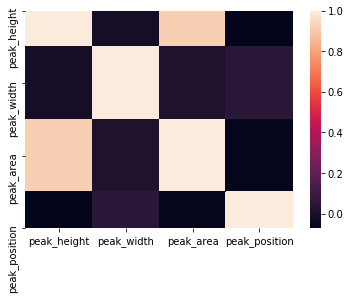

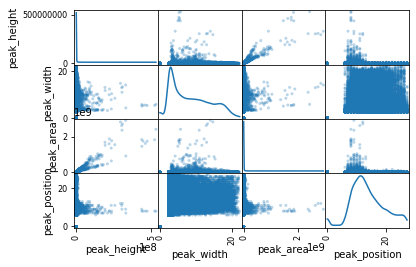

In [7]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

peak_props_all_data = merged_data_set[peak_properties]

sns.heatmap(peak_props_all_data.corr())

# Produce a scatter matrix for each pair of features in the data
pd.plotting.scatter_matrix(peak_props_all_data, alpha=0.3, diagonal='kde')

plt.show()

You can tell there is a strong correlation between peak height and area. This makes sense that area under our peak would be calculated based on height. Let’s remove area and see if we can see any other correlations once we break down the data to important compound to mass pair associations. I will use a heatmap and scatter matrix to determine correlations and the distribution of data related to each feature.

Mass pair ID:  0
Compound id:  10


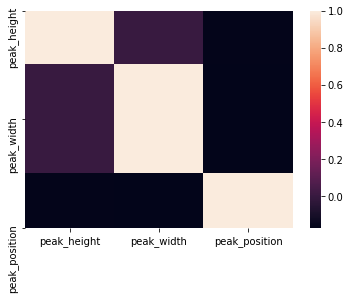

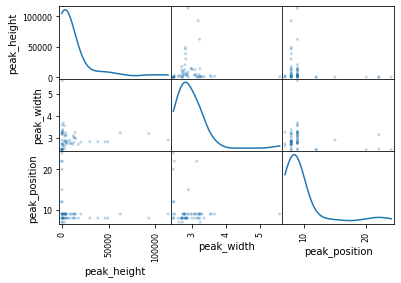

Mass pair ID:  2
Compound id:  4


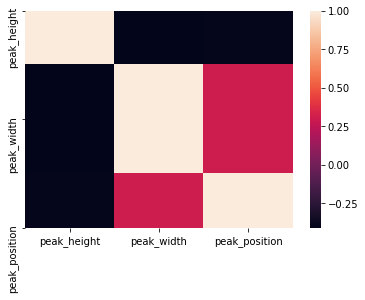

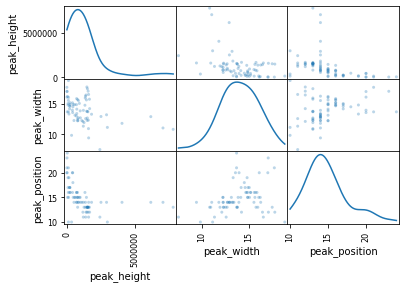

Mass pair ID:  3
Compound id:  10


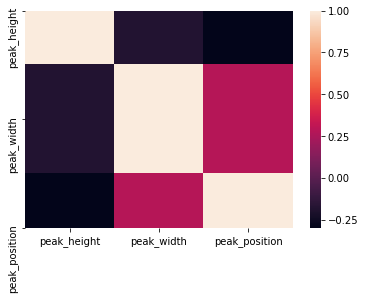

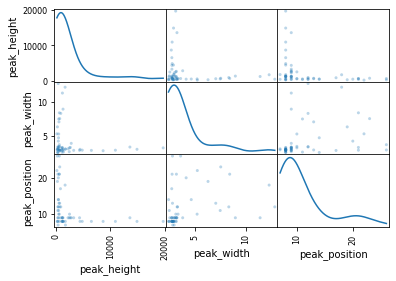

Mass pair ID:  4
Compound id:  10


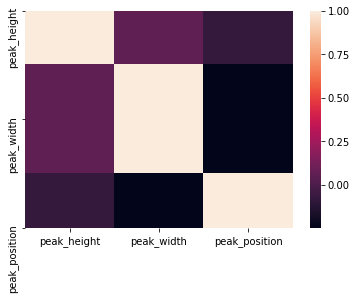

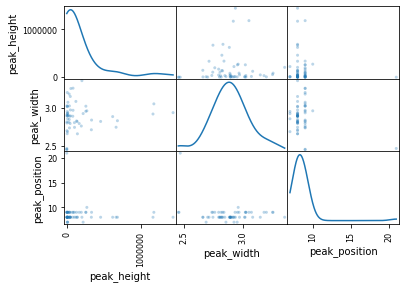

Mass pair ID:  7
Compound id:  19


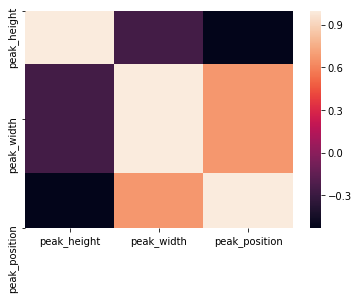

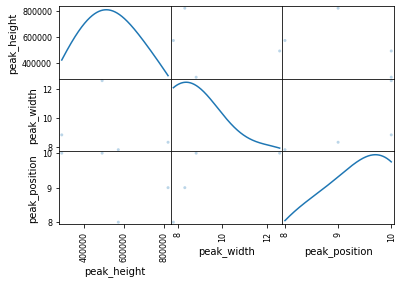

Mass pair ID:  8
Compound id:  19


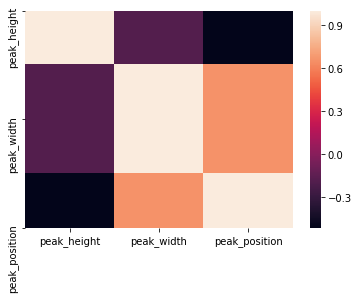

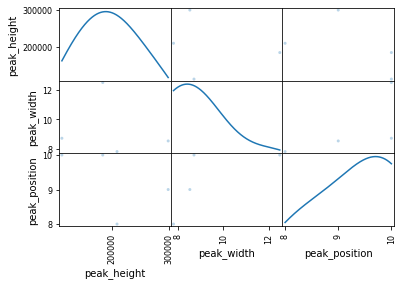

Mass pair ID:  11
Compound id:  4


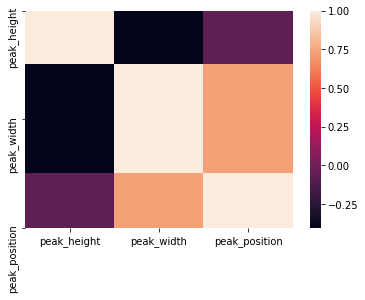

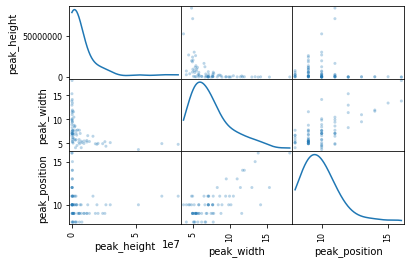

Mass pair ID:  16
Compound id:  14


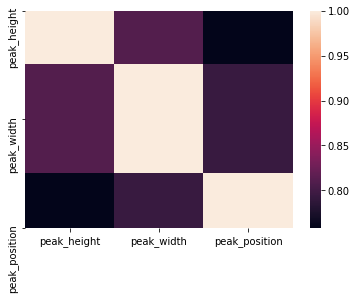

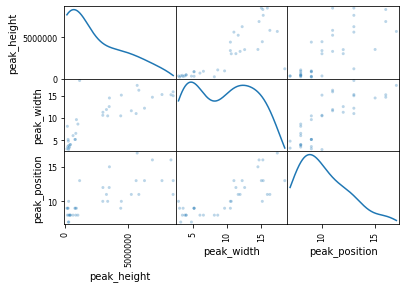

Mass pair ID:  16
Compound id:  7


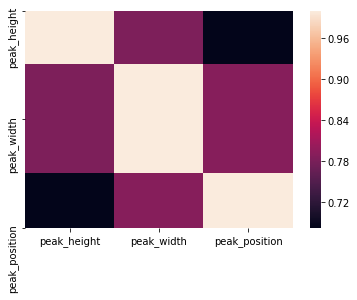

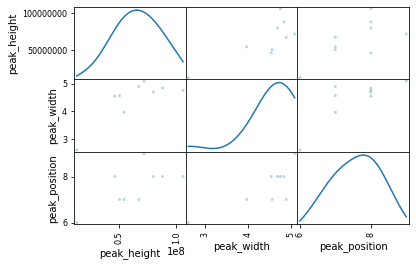

Mass pair ID:  16
Compound id:  8


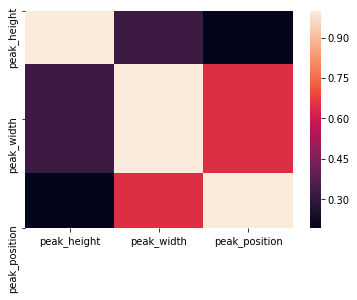

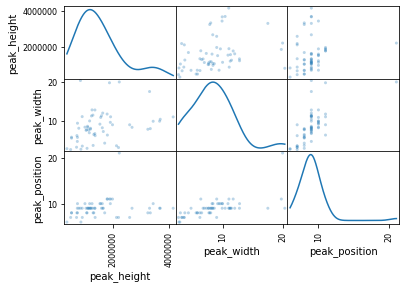

Mass pair ID:  18
Compound id:  14


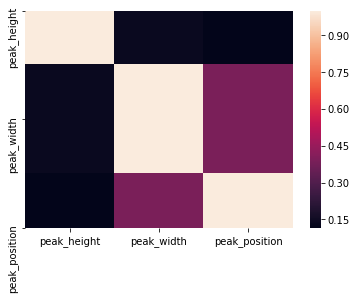

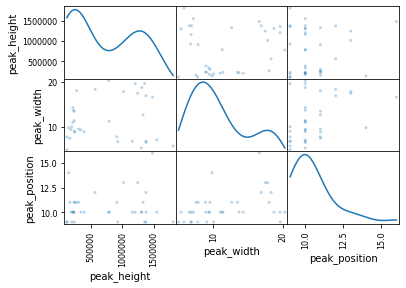

Mass pair ID:  18
Compound id:  7


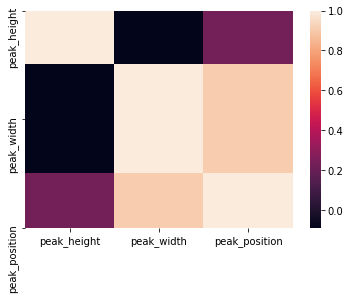

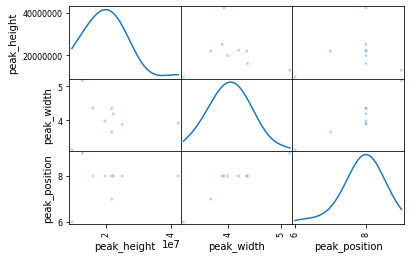

Mass pair ID:  18
Compound id:  8


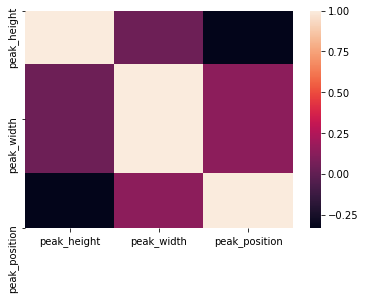

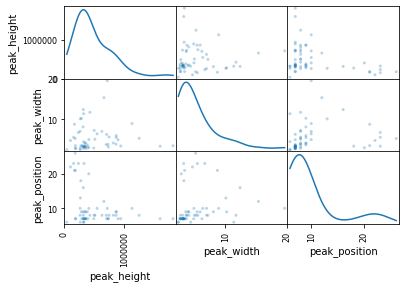

Mass pair ID:  19
Compound id:  10


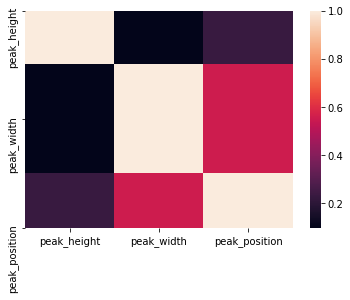

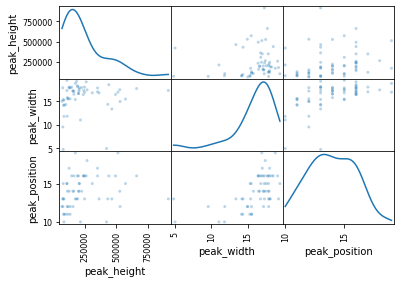

Mass pair ID:  19
Compound id:  18


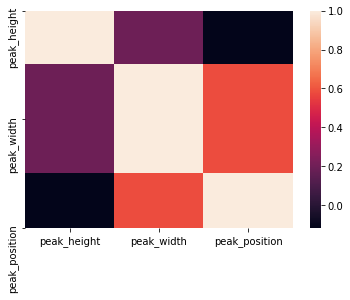

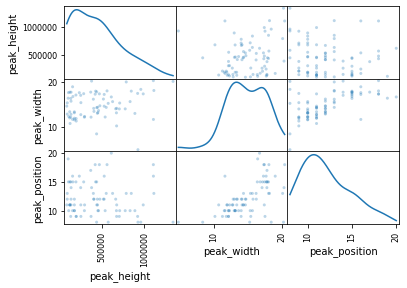

Mass pair ID:  20
Compound id:  10


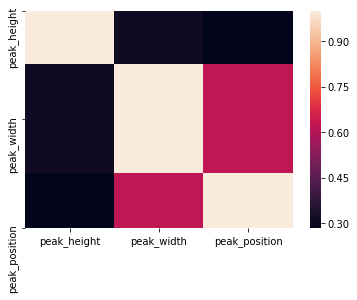

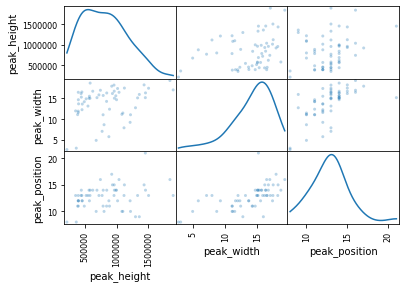

Mass pair ID:  20
Compound id:  18


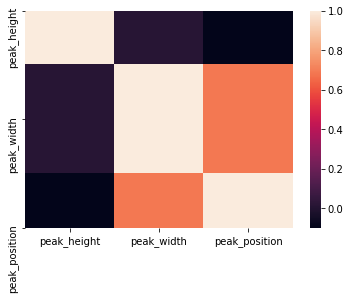

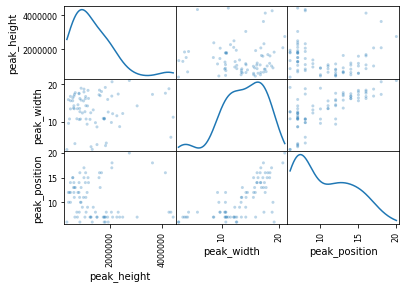

Mass pair ID:  20
Compound id:  3


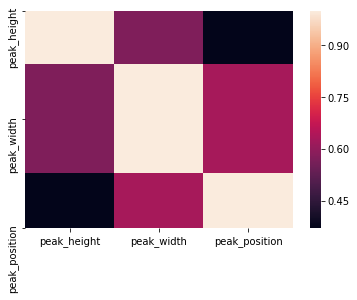

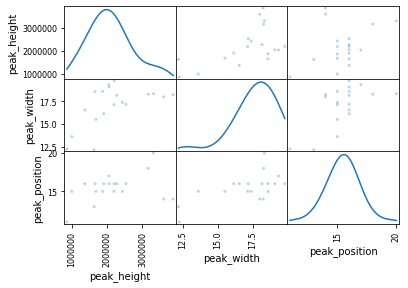

Mass pair ID:  21
Compound id:  18


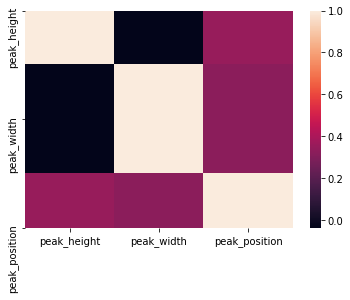

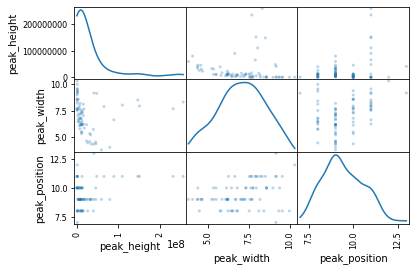

Mass pair ID:  22
Compound id:  10


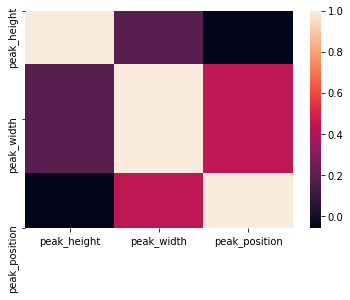

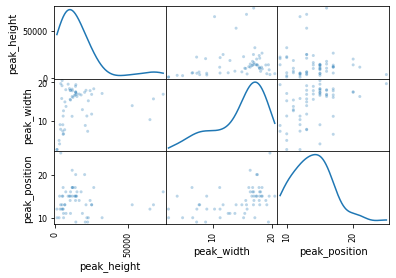

Mass pair ID:  22
Compound id:  21


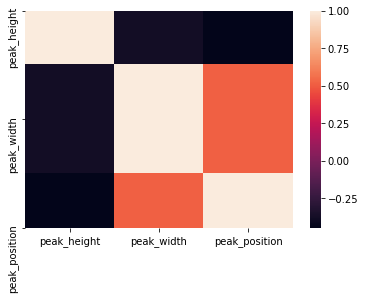

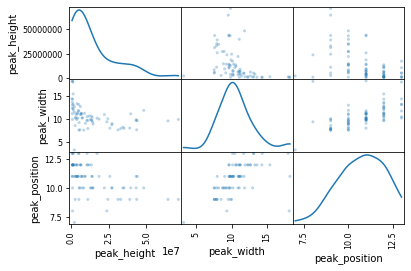

Mass pair ID:  22
Compound id:  0


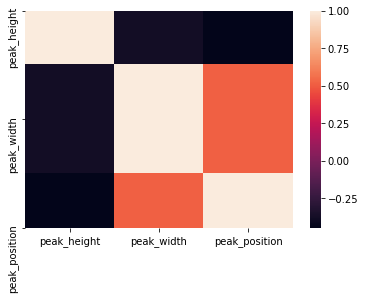

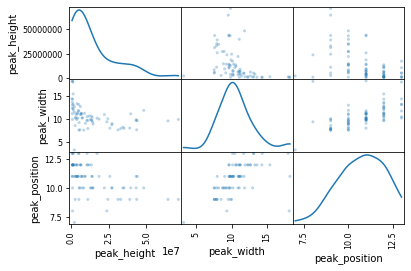

Mass pair ID:  23
Compound id:  10


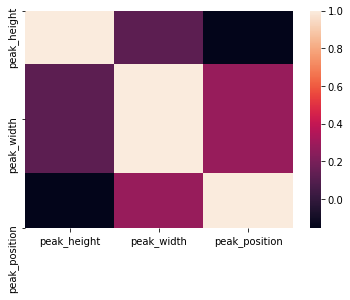

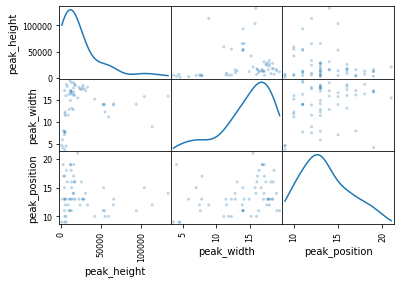

Mass pair ID:  23
Compound id:  21


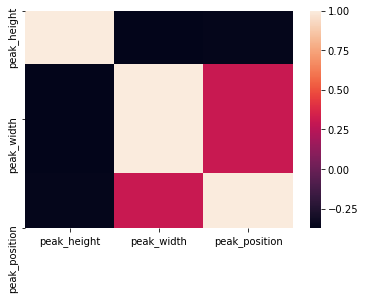

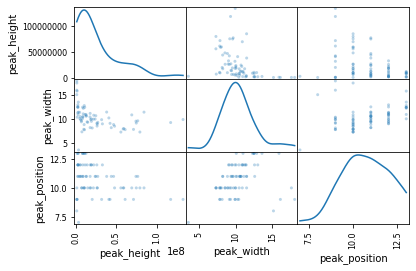

Mass pair ID:  23
Compound id:  0


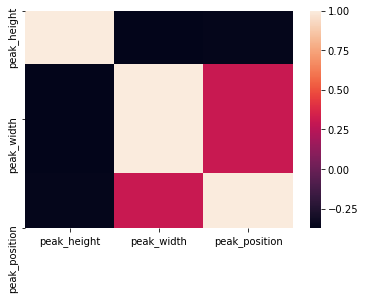

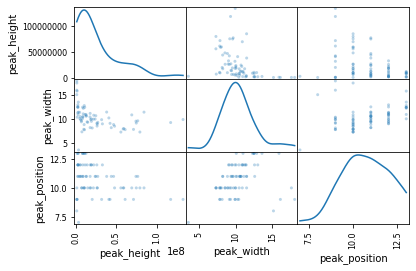

Mass pair ID:  25
Compound id:  21


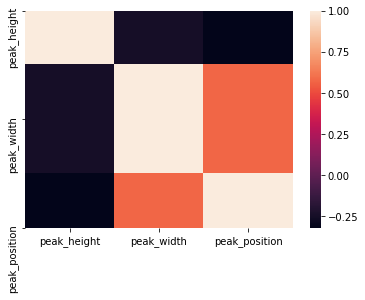

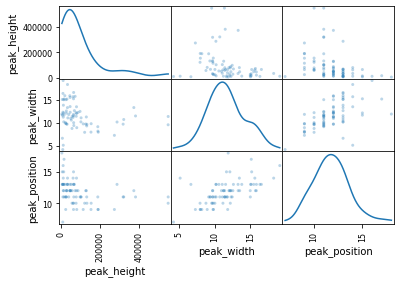

Mass pair ID:  25
Compound id:  0


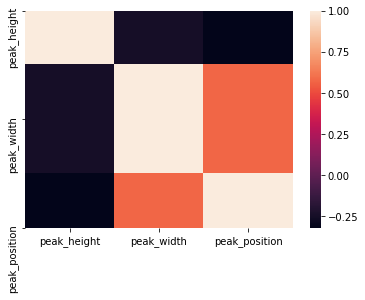

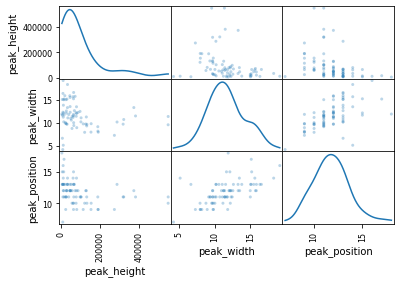

Mass pair ID:  26
Compound id:  21


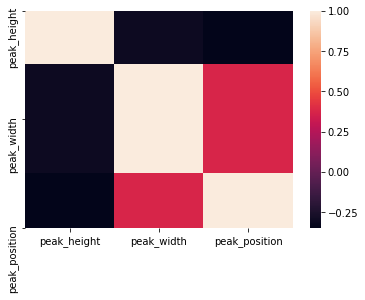

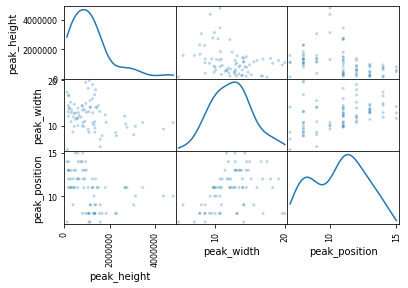

Mass pair ID:  26
Compound id:  0


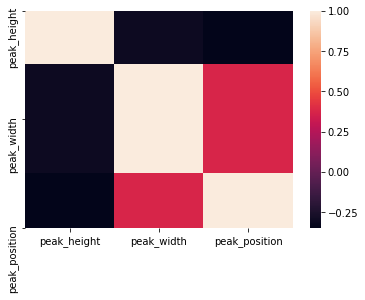

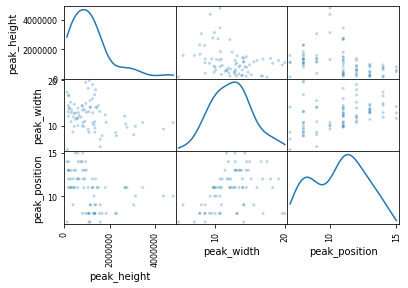

Mass pair ID:  27
Compound id:  7


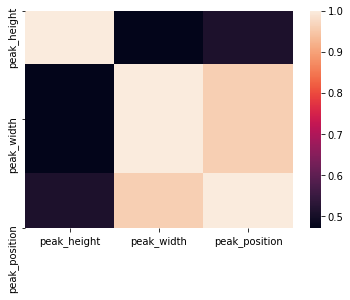

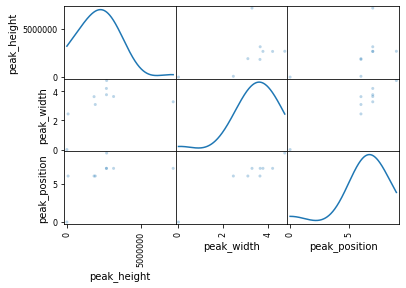

Mass pair ID:  30
Compound id:  7


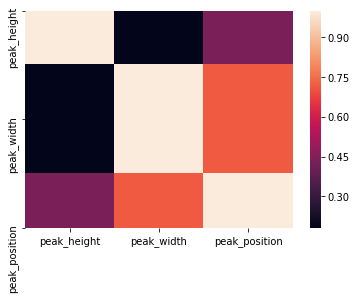

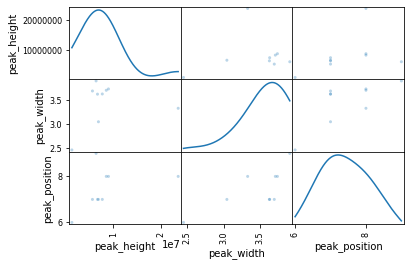

Mass pair ID:  33
Compound id:  21


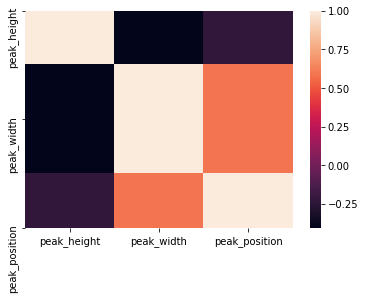

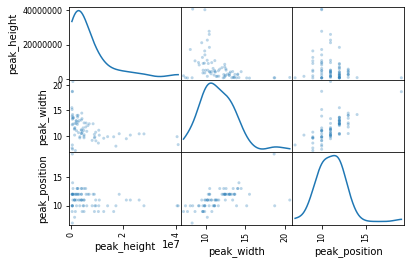

Mass pair ID:  33
Compound id:  0


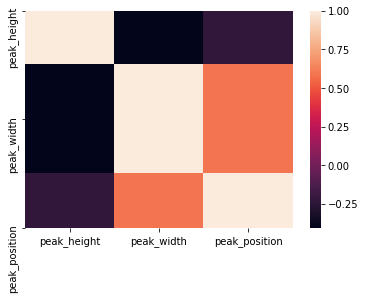

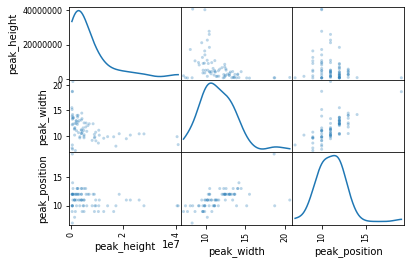

Mass pair ID:  34
Compound id:  21


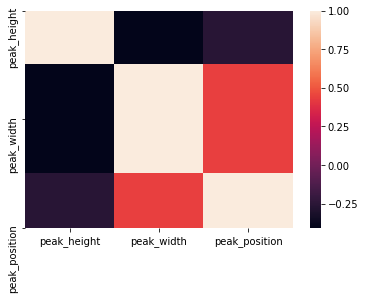

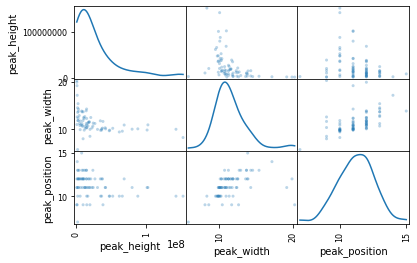

Mass pair ID:  34
Compound id:  0


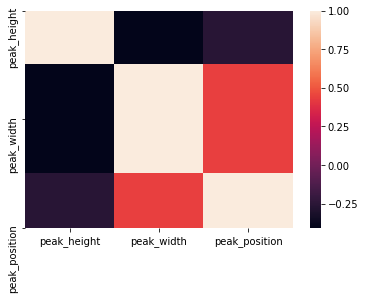

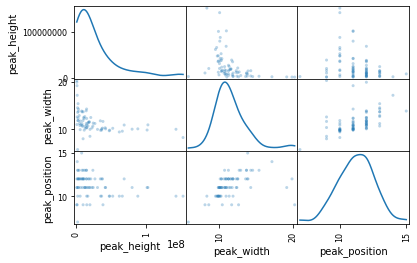

Mass pair ID:  35
Compound id:  22


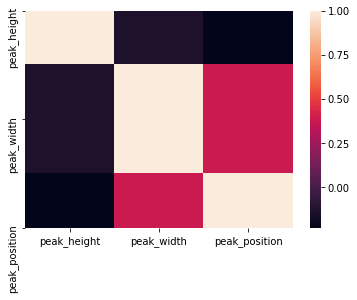

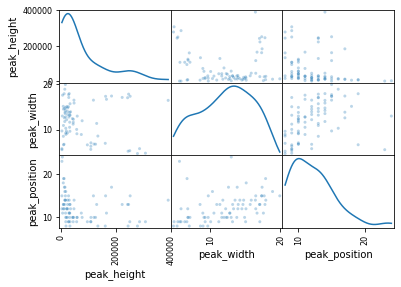

Mass pair ID:  36
Compound id:  15


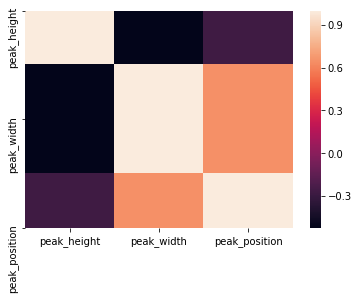

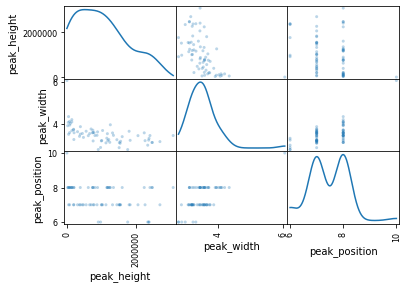

Mass pair ID:  37
Compound id:  22


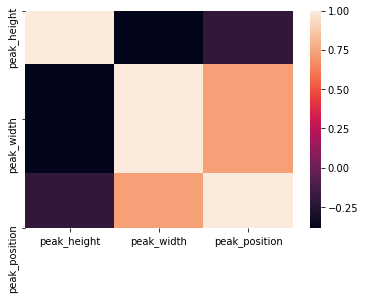

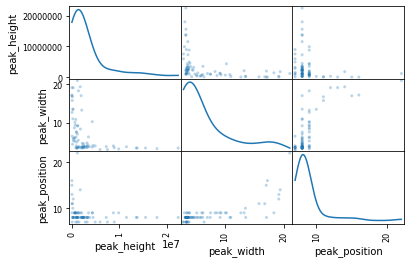

Mass pair ID:  38
Compound id:  22


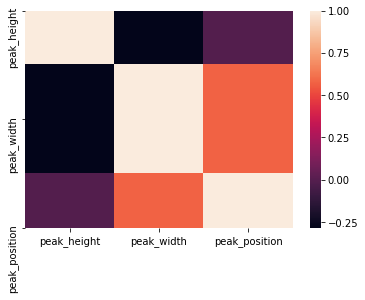

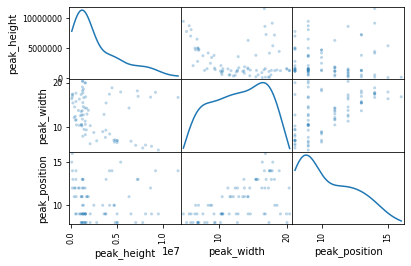

Mass pair ID:  39
Compound id:  15


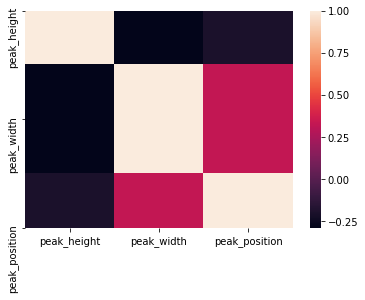

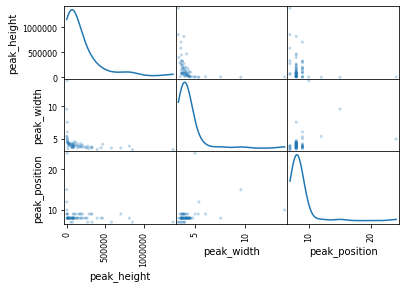

Mass pair ID:  39
Compound id:  8


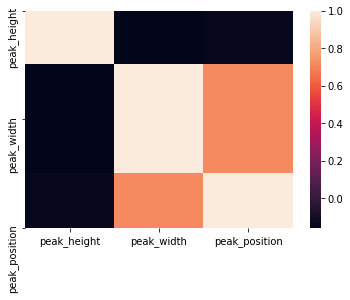

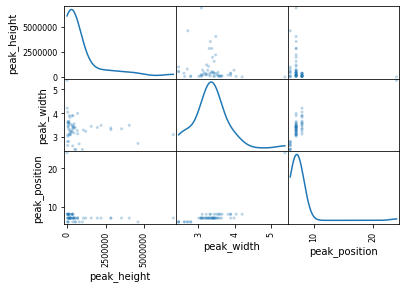

Mass pair ID:  40
Compound id:  18


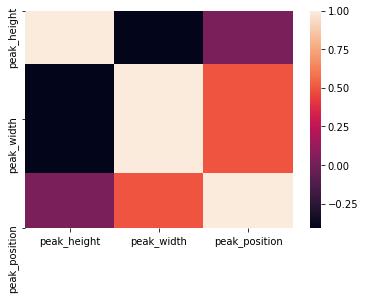

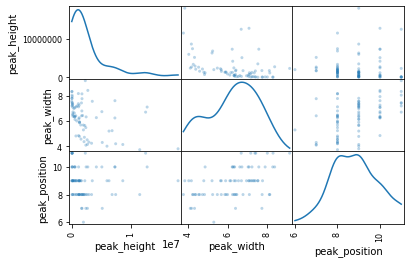

Mass pair ID:  41
Compound id:  13


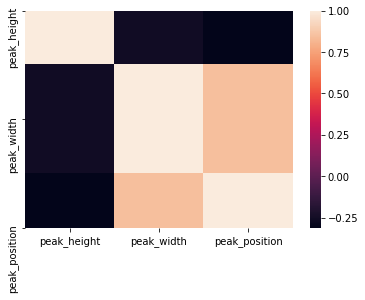

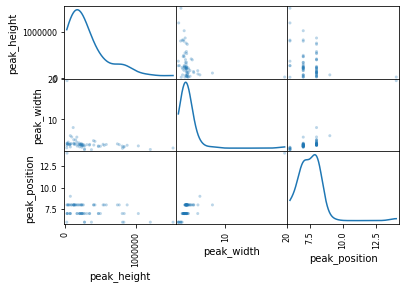

Mass pair ID:  42
Compound id:  13


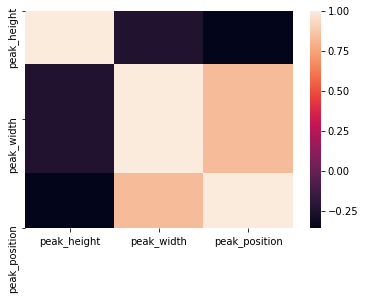

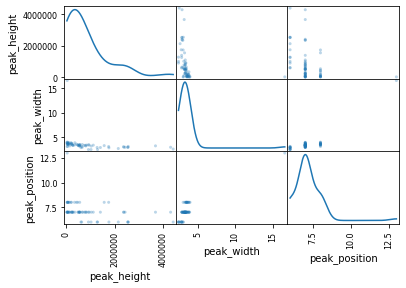

Mass pair ID:  46
Compound id:  13


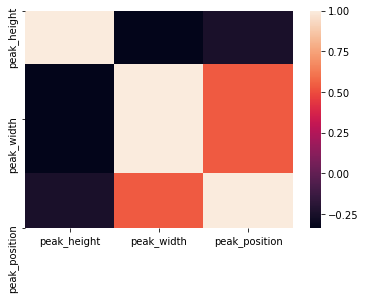

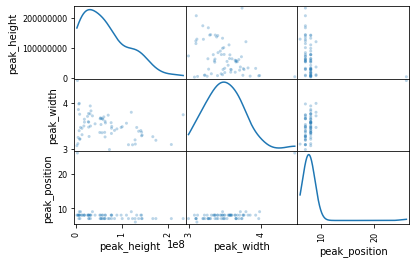

Mass pair ID:  46
Compound id:  14


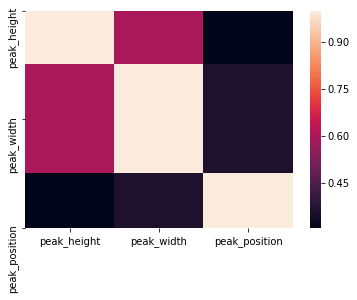

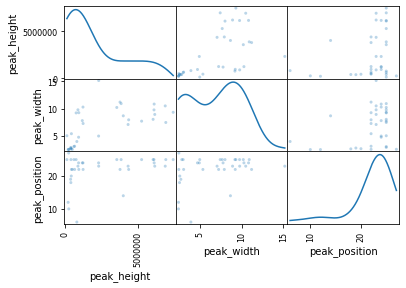

Mass pair ID:  46
Compound id:  15


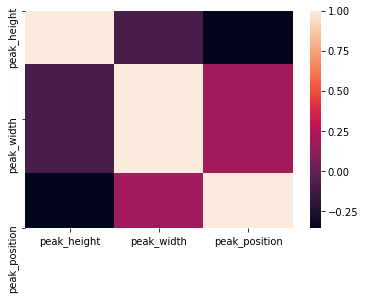

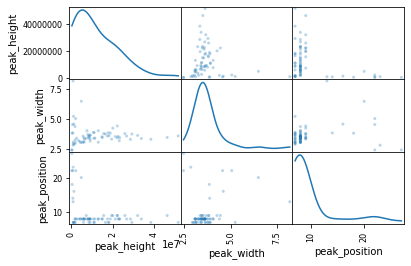

Mass pair ID:  46
Compound id:  7


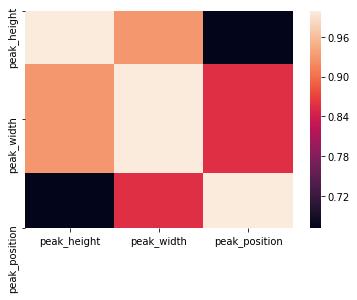

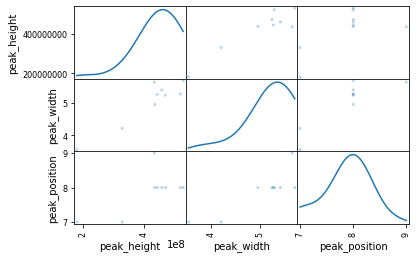

Mass pair ID:  46
Compound id:  8


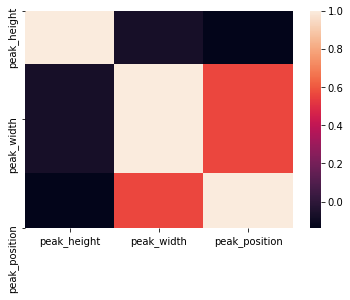

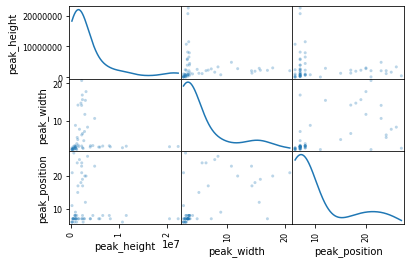

Mass pair ID:  47
Compound id:  3


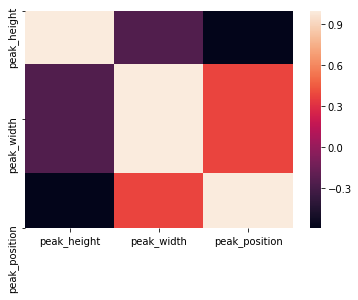

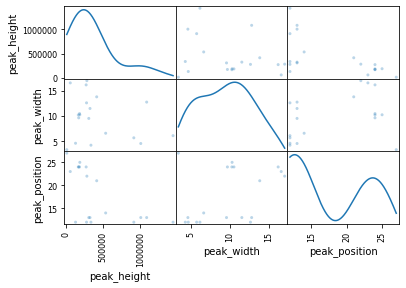

Mass pair ID:  49
Compound id:  3


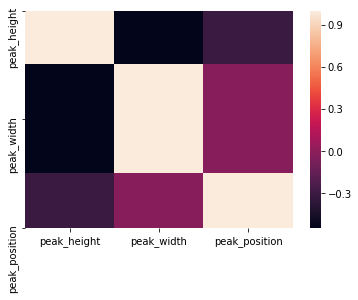

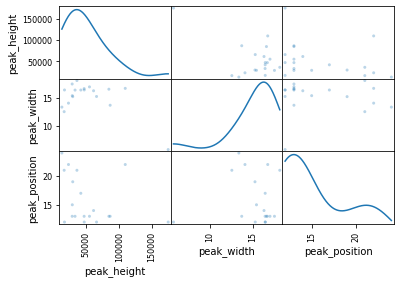

Mass pair ID:  50
Compound id:  3


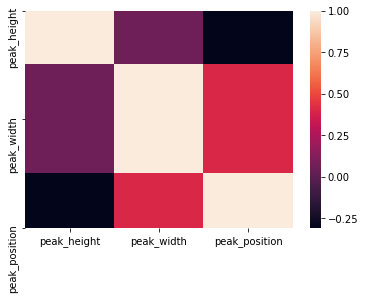

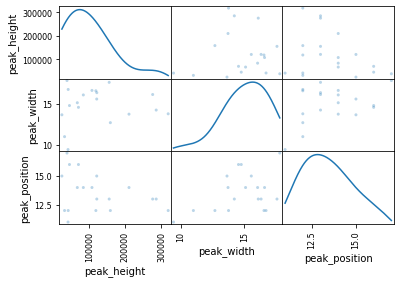

In [8]:
peak_properties = ['peak_height', 'peak_width', 'peak_position']

for mass_pair_id, compound_id_to_dataset in mass_pair_id_to_compound_ids_to_dataset.items():
    for compound_id, dataset in compound_id_to_dataset.items():
        if compound_id == -1:
            continue
        print("Mass pair ID: ", mass_pair_id)  
        print("Compound id: ", compound_id)
        peak_props = dataset[peak_properties]
        sns.heatmap(peak_props.corr())

        # Produce a scatter matrix for each pair of features in the data
        pd.plotting.scatter_matrix(peak_props, alpha=0.3, diagonal='kde')
        
        plt.show()

In most cases there is no other correlation. Some of the heatmaps show a little bit, but I think it could just be due to a lack of samples. Some of the scatter plots show a shifted gaussian curve, however, in other cases the distribution of the data looks non-gaussian. I am going to apply a log transform to see if I can change the data to be more gaussian.

Mass pair ID:  0
Compound id:  10


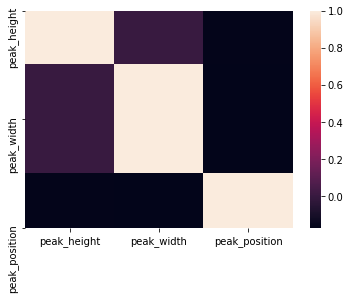

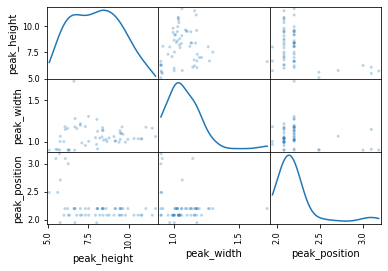

Mass pair ID:  2
Compound id:  4


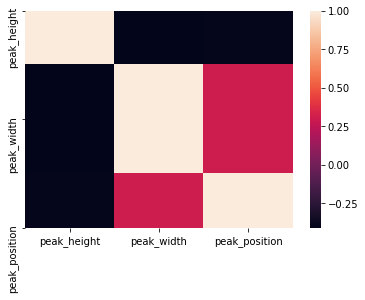

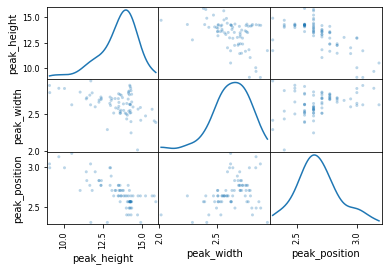

Mass pair ID:  3
Compound id:  10


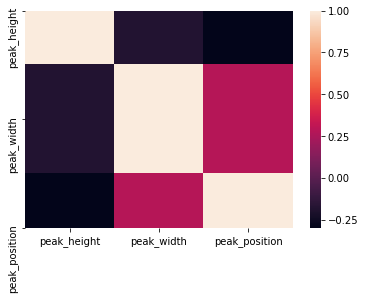

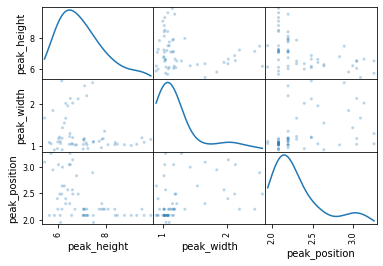

Mass pair ID:  4
Compound id:  10


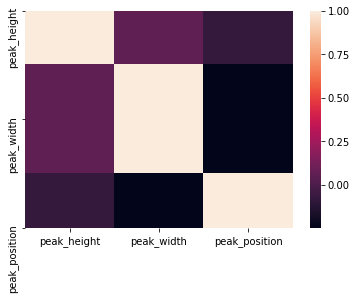

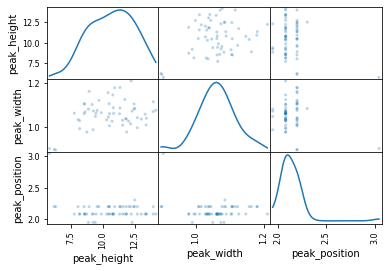

Mass pair ID:  7
Compound id:  19


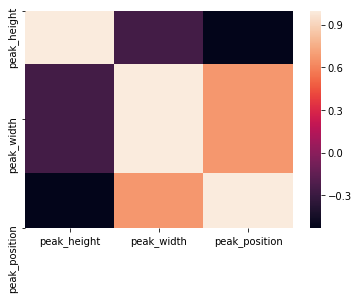

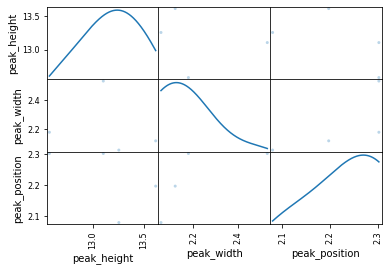

Mass pair ID:  8
Compound id:  19


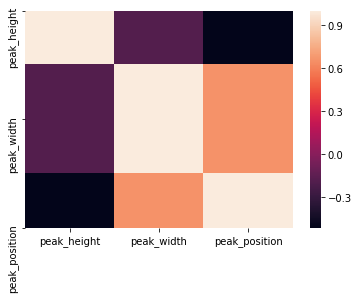

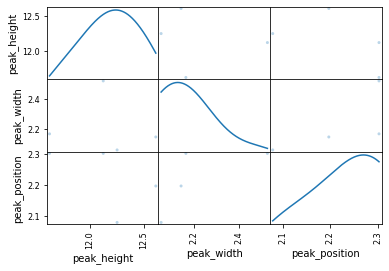

Mass pair ID:  11
Compound id:  4


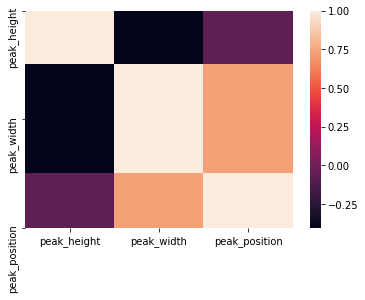

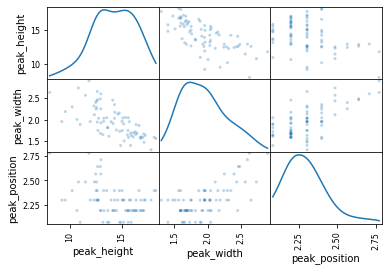

Mass pair ID:  16
Compound id:  14


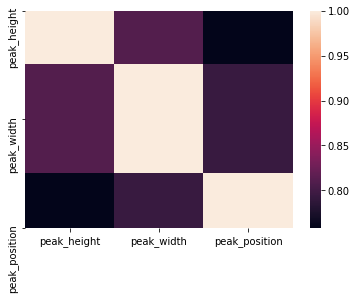

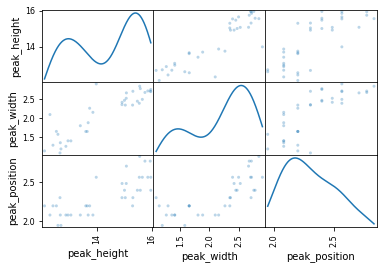

Mass pair ID:  16
Compound id:  7


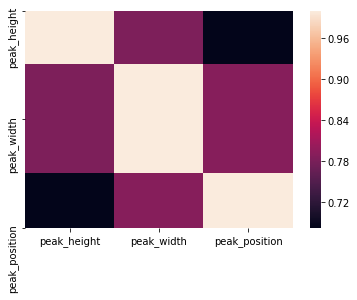

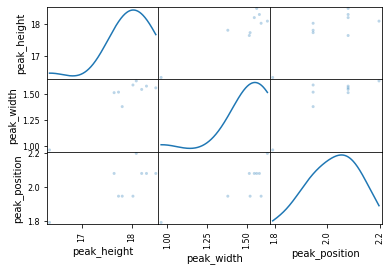

Mass pair ID:  16
Compound id:  8


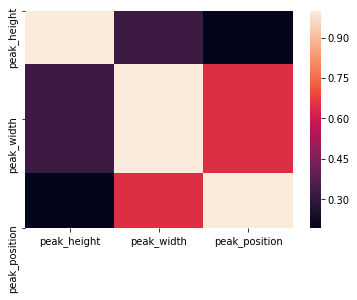

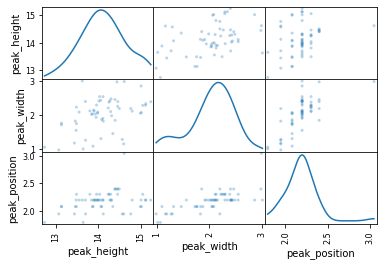

Mass pair ID:  18
Compound id:  14


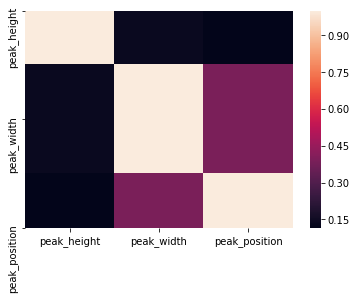

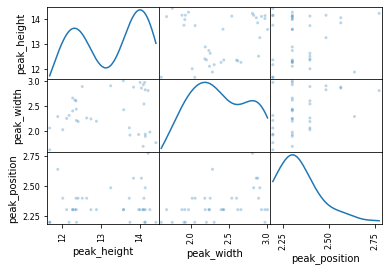

Mass pair ID:  18
Compound id:  7


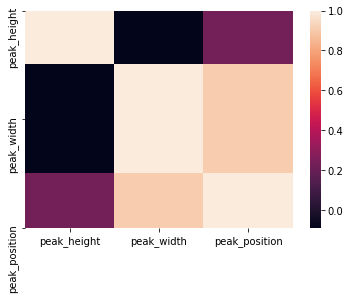

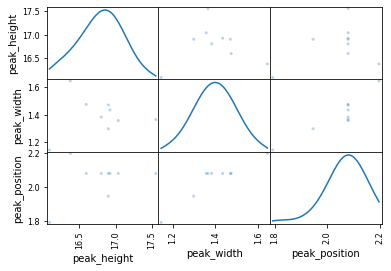

Mass pair ID:  18
Compound id:  8


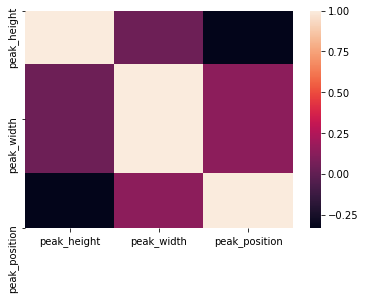

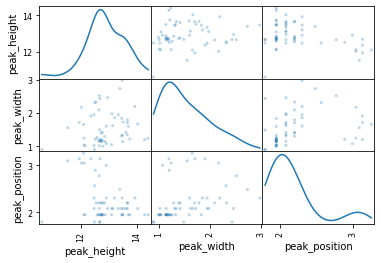

Mass pair ID:  19
Compound id:  10


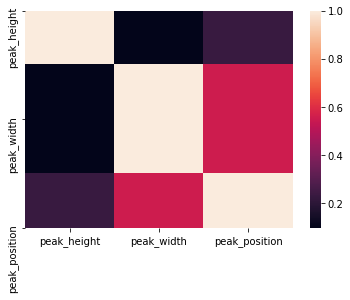

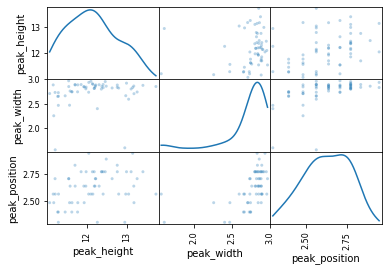

Mass pair ID:  19
Compound id:  18


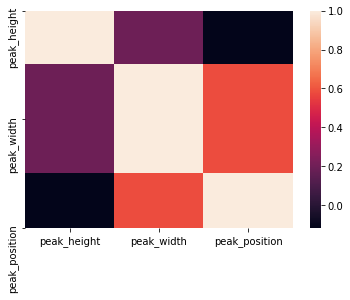

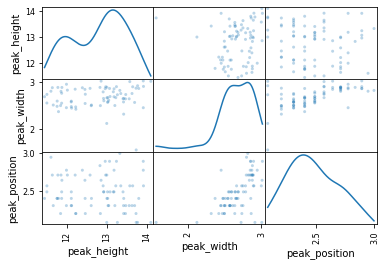

Mass pair ID:  20
Compound id:  10


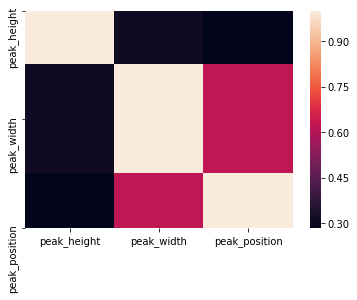

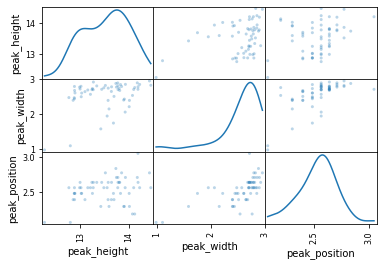

Mass pair ID:  20
Compound id:  18


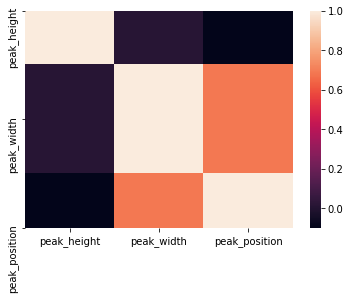

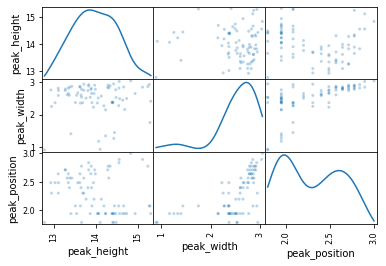

Mass pair ID:  20
Compound id:  3


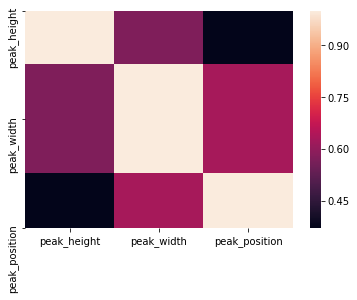

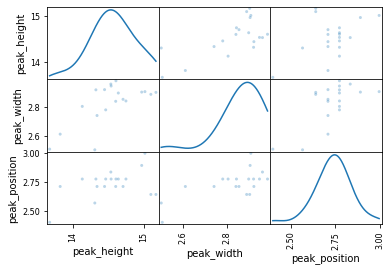

Mass pair ID:  21
Compound id:  18


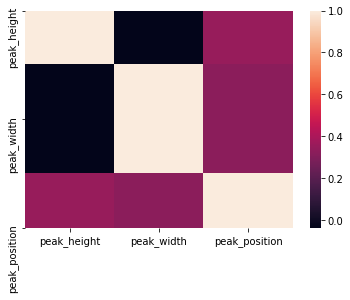

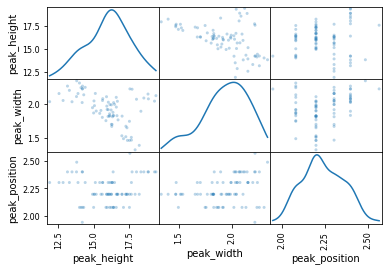

Mass pair ID:  22
Compound id:  10


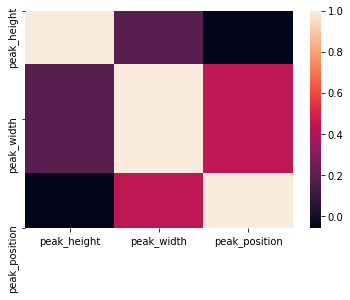

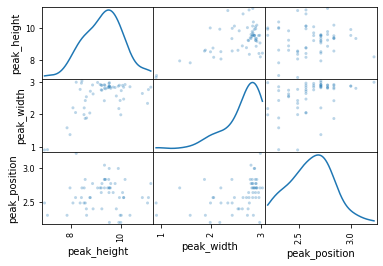

Mass pair ID:  22
Compound id:  21


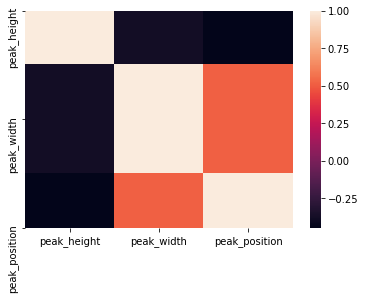

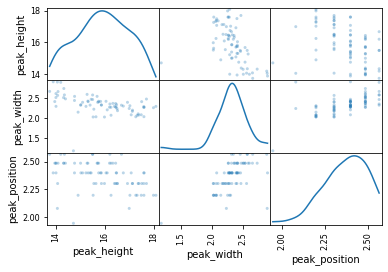

Mass pair ID:  22
Compound id:  0


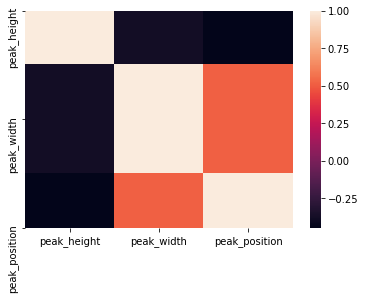

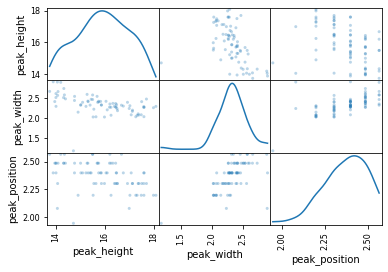

Mass pair ID:  23
Compound id:  10


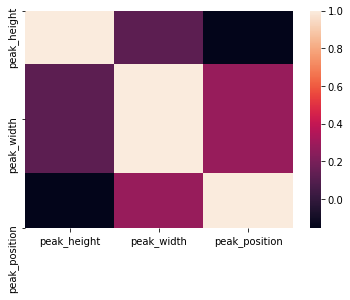

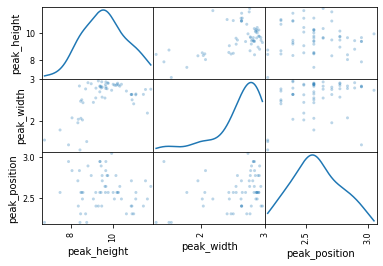

Mass pair ID:  23
Compound id:  21


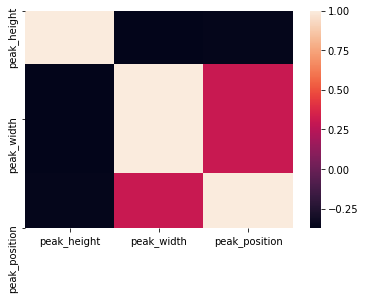

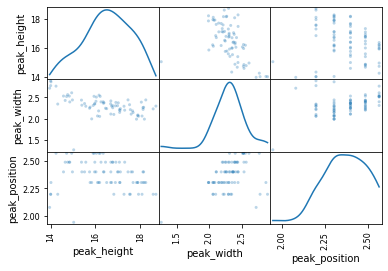

Mass pair ID:  23
Compound id:  0


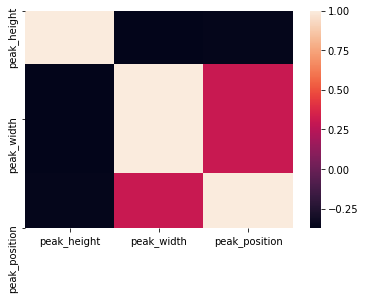

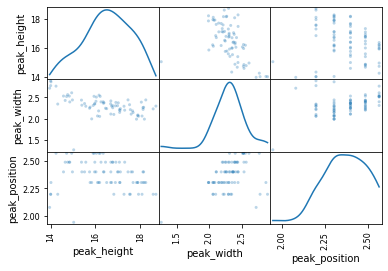

Mass pair ID:  25
Compound id:  21


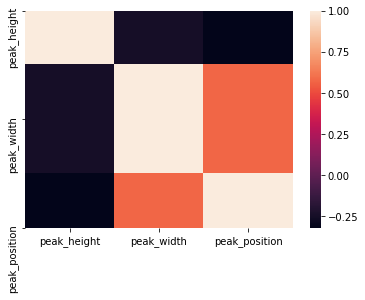

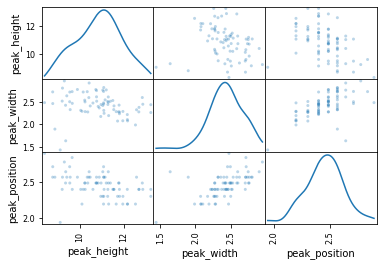

Mass pair ID:  25
Compound id:  0


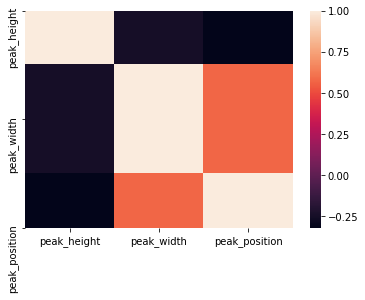

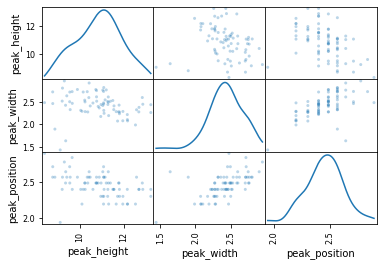

Mass pair ID:  26
Compound id:  21


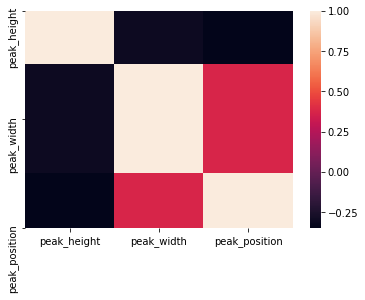

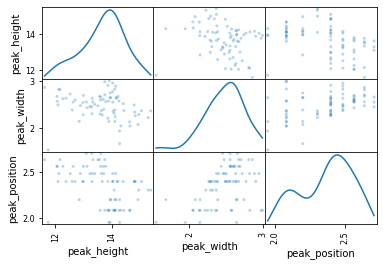

Mass pair ID:  26
Compound id:  0


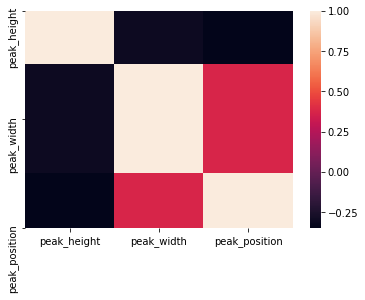

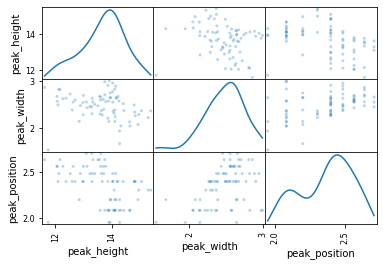

Mass pair ID:  27
Compound id:  7


C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: divide by zero encountered in log
  del sys.path[0]


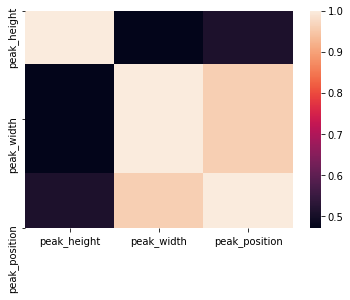

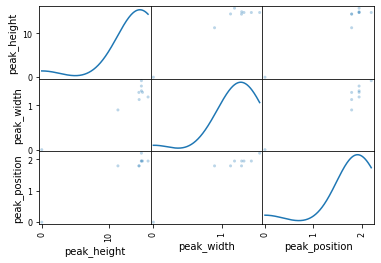

Mass pair ID:  30
Compound id:  7


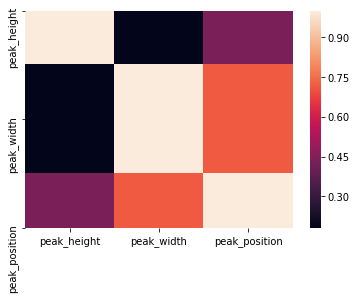

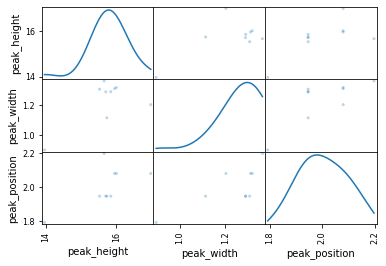

Mass pair ID:  33
Compound id:  21


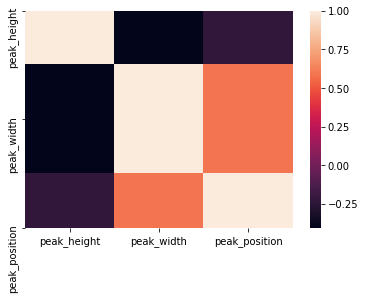

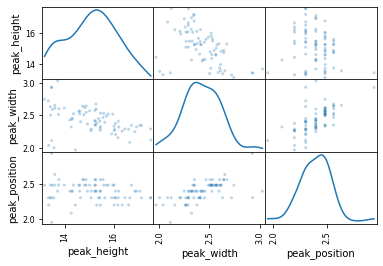

Mass pair ID:  33
Compound id:  0


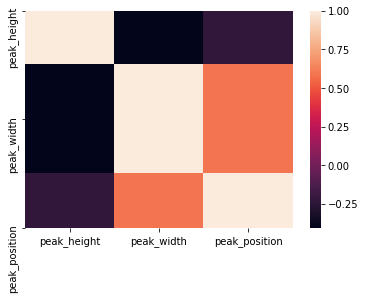

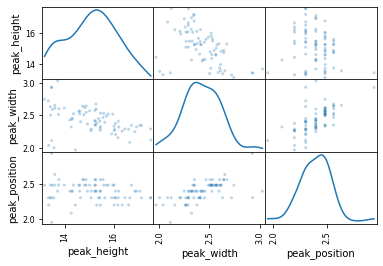

Mass pair ID:  34
Compound id:  21


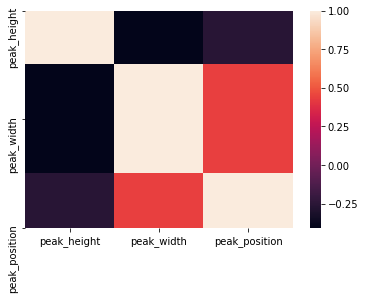

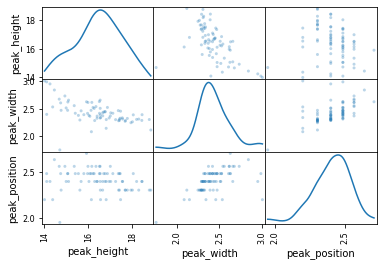

Mass pair ID:  34
Compound id:  0


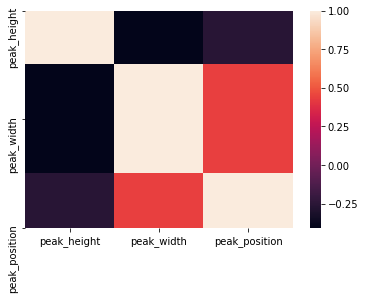

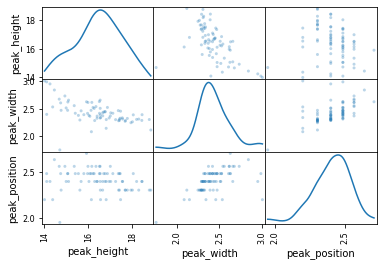

Mass pair ID:  35
Compound id:  22


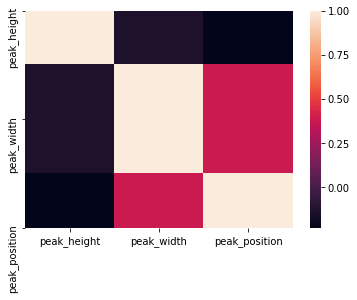

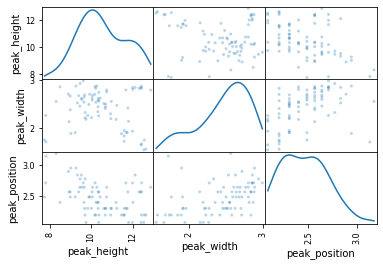

Mass pair ID:  36
Compound id:  15


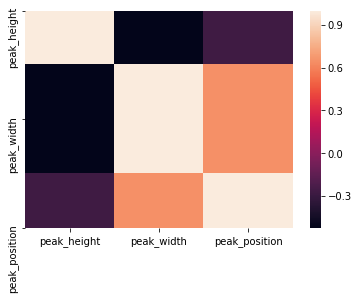

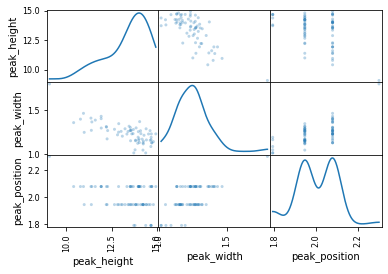

Mass pair ID:  37
Compound id:  22


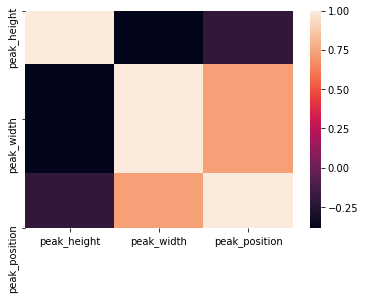

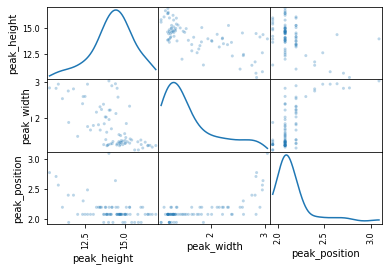

Mass pair ID:  38
Compound id:  22


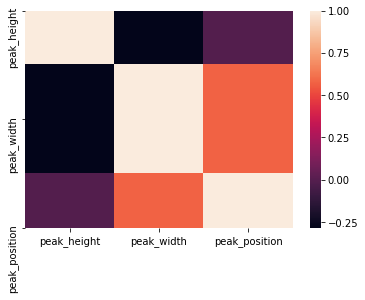

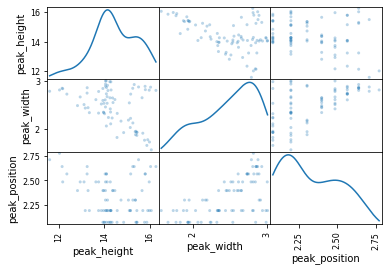

Mass pair ID:  39
Compound id:  15


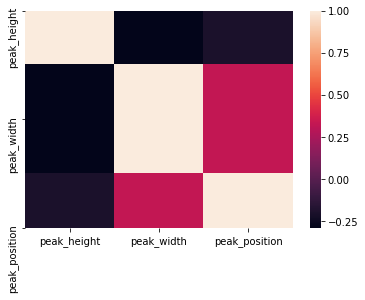

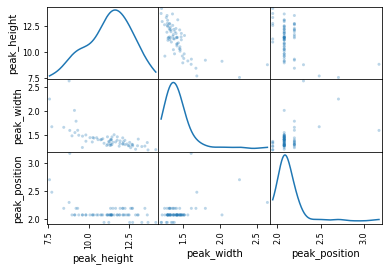

Mass pair ID:  39
Compound id:  8


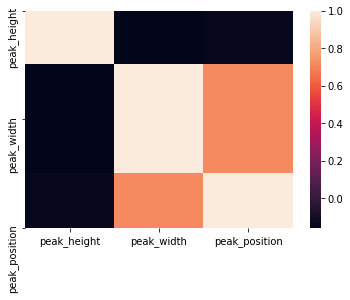

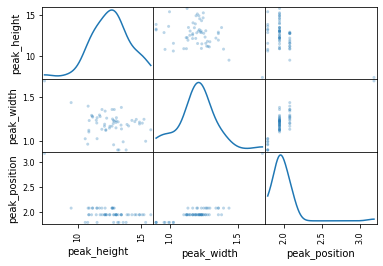

Mass pair ID:  40
Compound id:  18


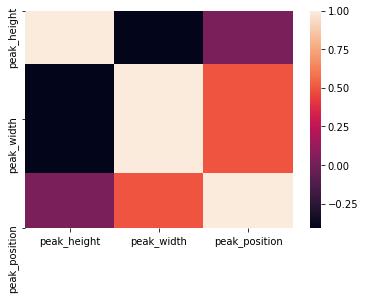

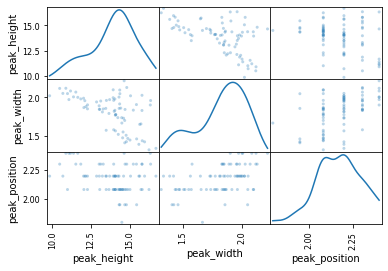

Mass pair ID:  41
Compound id:  13


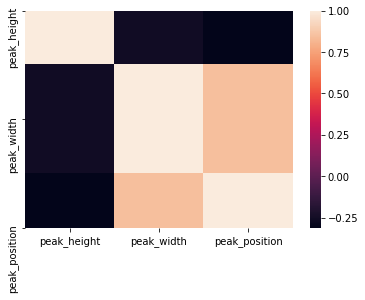

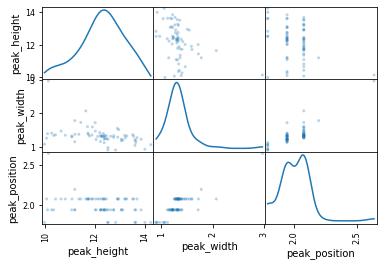

Mass pair ID:  42
Compound id:  13


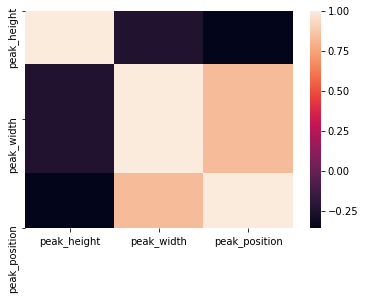

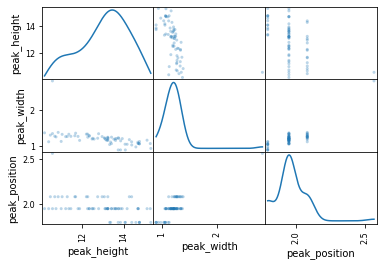

Mass pair ID:  46
Compound id:  13


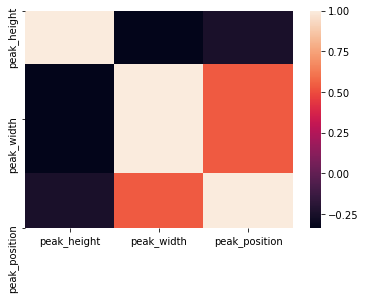

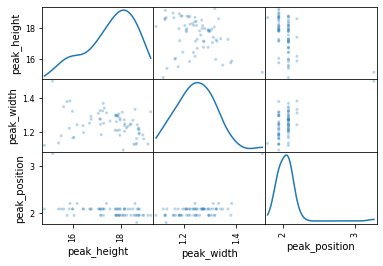

Mass pair ID:  46
Compound id:  14


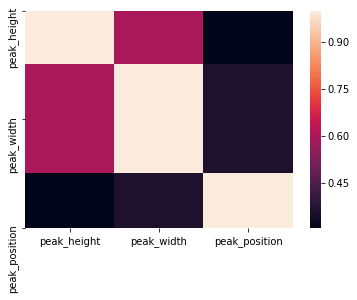

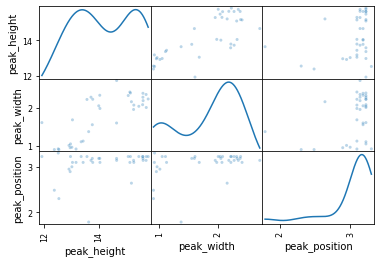

Mass pair ID:  46
Compound id:  15


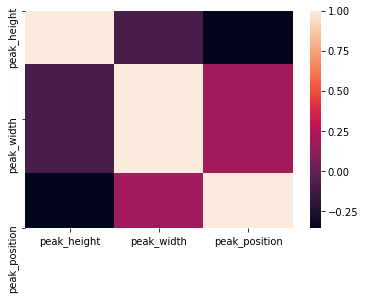

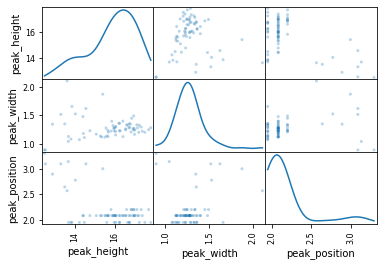

Mass pair ID:  46
Compound id:  7


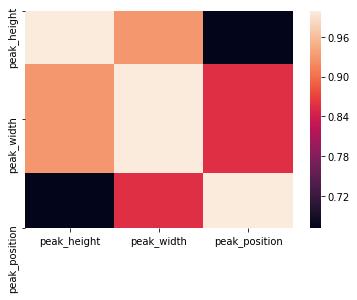

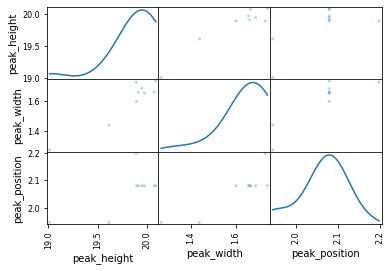

Mass pair ID:  46
Compound id:  8


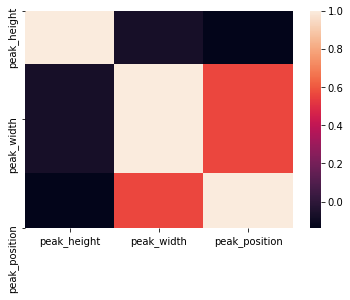

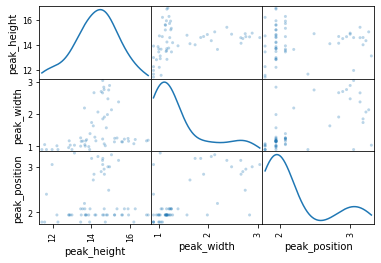

Mass pair ID:  47
Compound id:  3


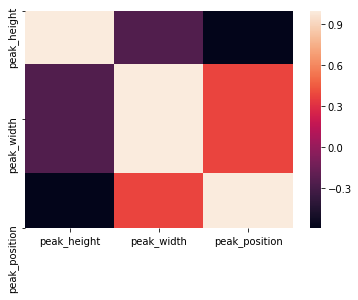

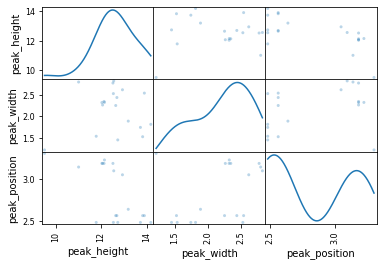

Mass pair ID:  49
Compound id:  3


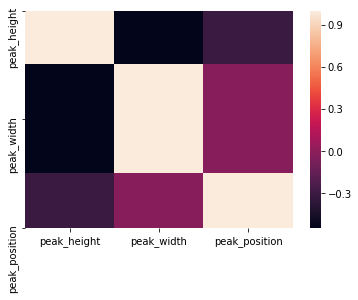

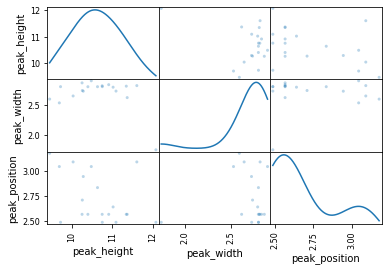

Mass pair ID:  50
Compound id:  3


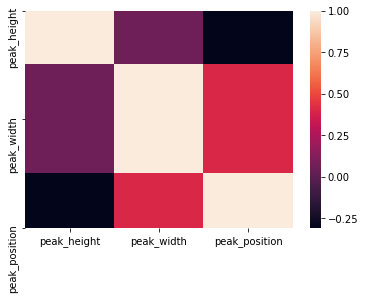

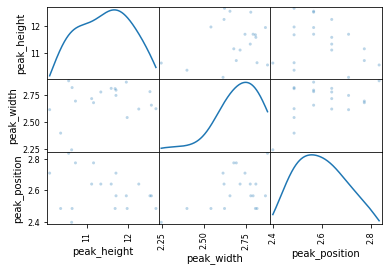

In [9]:
import numpy as np

for mass_pair_id, compound_id_to_dataset in mass_pair_id_to_compound_ids_to_dataset.items():
    for compound_id, dataset in compound_id_to_dataset.items():
        if compound_id == -1:
            continue
        print("Mass pair ID: ", mass_pair_id)  
        print("Compound id: ", compound_id)
        peak_props = dataset[peak_properties]
        sns.heatmap(peak_props.corr())

        # Produce a scatter matrix for each pair of features in the data
        pd.plotting.scatter_matrix(np.log(peak_props).replace([np.inf, -np.inf], np.nan).fillna(0), alpha=0.3, diagonal='kde')
        
        plt.show()

In some cases, the transformation of the data works well. In most cases it does not. It seems that either I do not have enough samples to represent the total population of samples or the current features are not deterministic enough to determine detections.

For the most part, width seems to be a very stable and independent feature. Position and height even though not correlated tend to mimic each other so I could probably get away with using either just height or position. I will try position because it previously had the least amount of standard deviation. Some of the mass pair to compounds are much more stable than others. On all cases, there are some outliers. Depending on the algorithm I use, I may need to remove these outliers to not overfit my model. Next, I want to plot and label all my mass pair data to get an idea of how well my algorithm will do on test data.

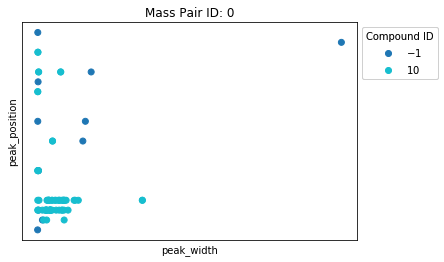

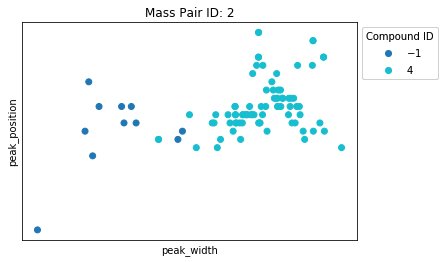

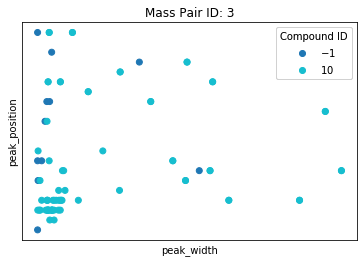

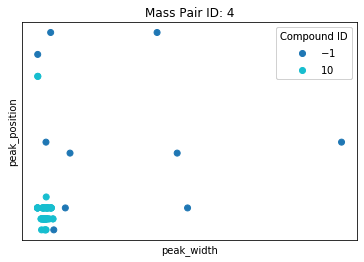

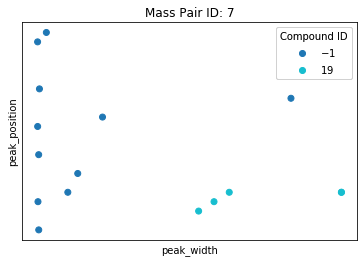

...

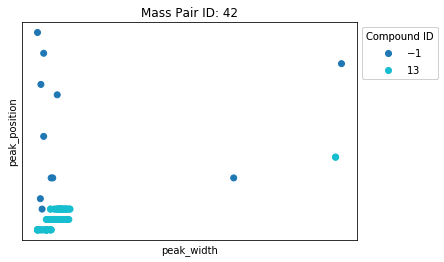

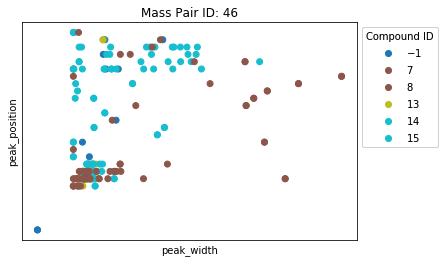

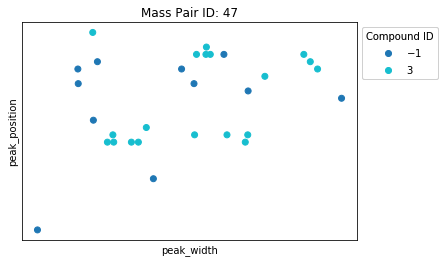

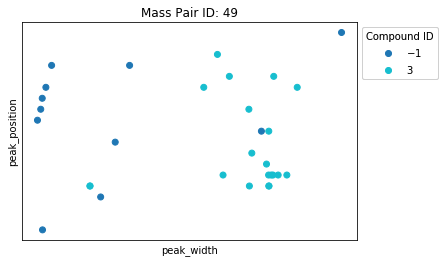

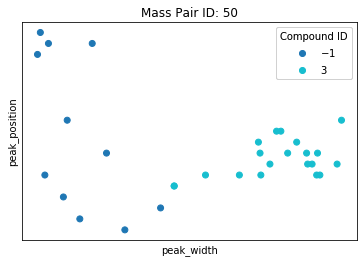

In [10]:
def find_outliers(gaussian_data: pd.DataFrame):
    outliers = []
    commonOutliers = []

    # For each feature find the data points with extreme high or low values
    for feature in gaussian_data.keys():
        # Calculate Q1 (25th percentile of the data) for the given feature
        Q1 = np.percentile(gaussian_data[feature], 25)

        # Calculate Q3 (75th percentile of the data) for the given feature
        Q3 = np.percentile(gaussian_data[feature], 75)

        # Use the interquartile range to calculate an outlier step (1.5 times the interquartile range)
        step = (Q3 - Q1) * 1.5

        data = gaussian_data[~((gaussian_data[feature] >= Q1 - step) &
                               (gaussian_data[feature] <= Q3 + step))]

        # Display the outliers
        #print("Data points considered outliers for the feature '{}':".format(feature))
        #print(data)

        for index, _ in data.iterrows():
            if index not in outliers:
                outliers.append(index)
            elif index not in commonOutliers:
                commonOutliers.append(index)

    #print('Outliers:')
    #print(sorted(outliers))

    # Remove the outliers, if any were specified
    # good_data = gaussian_data.drop(outliers).reset_index(drop=True)
    return outliers

def plot_with_labels(mass_pair_id, compound_id_to_dataset, peak_properties, create_model=None):
    
    data = []
    outliers = []
    groups = []
    
    xColumnLabel, yColumnLabel = peak_properties
    
    for compound_id, dataset in compound_id_to_dataset.items():
        dataset = dataset[peak_properties]
        if compound_id == -1:
            outliers.append(None)
            groups.append('Noise')
        else:
            found_outliers_indices = find_outliers(dataset)
            outliers.append(dataset.loc[found_outliers_indices])
            #dataset = dataset.drop(found_outliers_indices).reset_index(drop=True)
            groups.append('Compound {}'.format(compound_id))
        data.append(dataset)
        
    if len(groups) <= 1:
        return
    
    # Create plot
    fig = plt.figure()
    ax = fig.add_subplot(111)
    title = 'Mass Pair ID: {}'.format(mass_pair_id)
    ax.set_xlabel(xColumnLabel)
    ax.set_ylabel(yColumnLabel)

    dataset = None
    for datum, group, outlier in zip(data, groups, outliers):
        if dataset is None:
            dataset = datum.assign(output=-1)#Noise is first
        else:
            output = int(group.split()[-1])
            temp = datum
            temp = temp.append(outlier)
            temp = temp.assign(output=output)
            dataset = dataset.append(temp)
                
    X = dataset[peak_properties].values
    y = dataset['output'].values
    
    #fit model
    if create_model is not None:
        model = create_model()
        
        
        h = .02  # step size in the mesh
        # create a mesh to plot in
        x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
        y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
        xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                     np.arange(y_min, y_max, h))
        
        
        model.fit(X, y)
       
        Z = model.predict(np.c_[xx.ravel(), yy.ravel()])

        # Put the result into a color plot
        Z = Z.reshape(xx.shape)
        plt.contourf(xx, yy, Z, cmap=plt.cm.tab10, alpha=0.8)
        
    # Plot also the training points
    scatter = ax.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.tab10)
    plt.xticks(())
    plt.yticks(())
    
    # produce a legend with the unique colors from the scatter
    legend = ax.legend(*scatter.legend_elements(), bbox_to_anchor=(1, 1), title="Compound ID")
    ax.add_artist(legend)
    
    #for datum, group, outlier in zip(data, groups, outliers):
    #    X1, X2 = datum[xColumnLabel], datum[yColumnLabel]
    #    ax.scatter(X1, X2, edgecolors='none', s=30, label=group, cmap=plt.cm.coolwarm)
    #    if outlier is not None and len(outlier) > 0:
    #        ax.scatter(outlier[xColumnLabel], outlier[yColumnLabel],
    #                   alpha=1, edgecolors='face', s=35, label='{} Outlier'.format(group))
    plt.title(title)

for mass_pair_id, compound_id_to_dataset in mass_pair_id_to_compound_ids_to_dataset.items():
    plot_with_labels(mass_pair_id, compound_id_to_dataset, ['peak_width', 'peak_position'])
    plt.show()
    

Some mass pairs look better than others. Let me see how height looks instead of position.

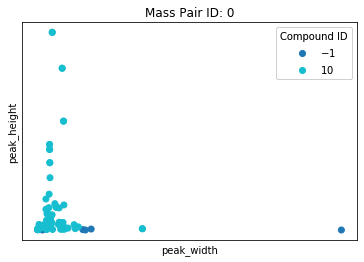

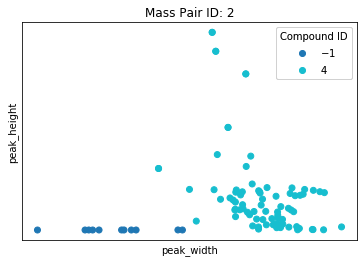

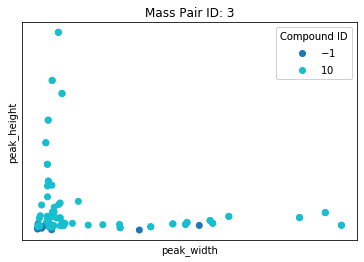

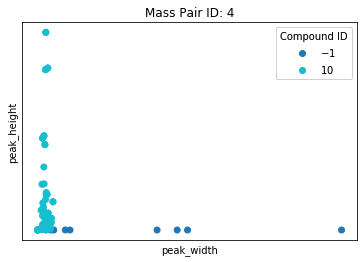

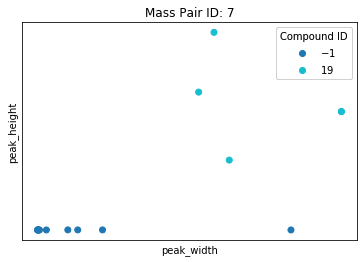

...

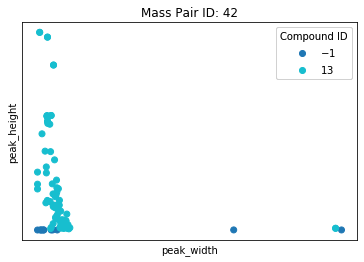

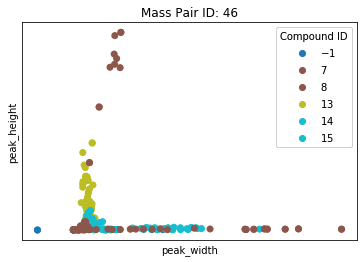

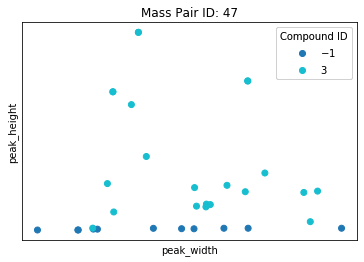

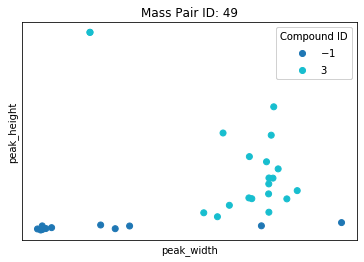

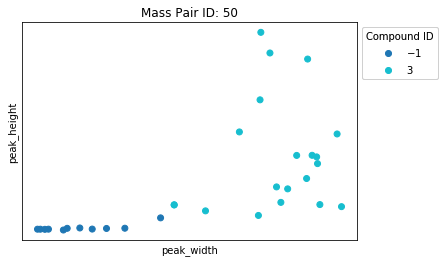

In [11]:
for mass_pair_id, compound_id_to_dataset in mass_pair_id_to_compound_ids_to_dataset.items():
    plot_with_labels(mass_pair_id, compound_id_to_dataset, ['peak_width', 'peak_height'])
    plt.show()

## Algorithms and Techniques

In most cases, graphically height looks a lot worse than position as a feature. In both cases, the features seem less than ideal. Let's apply a polynomial support vector machine to the data. My hope is to create a very general classification that combined with all the associated mass pairs we can gain good results. Based on the data, it appears we could probably draw circles around pieces of the data, therefore, we could use an SVM of either polynomial or RBF. RBF may overfit so I will first try polynomial and see the resuls. I will graph the classifications so I can see how well the algorithm fits per mass pair.

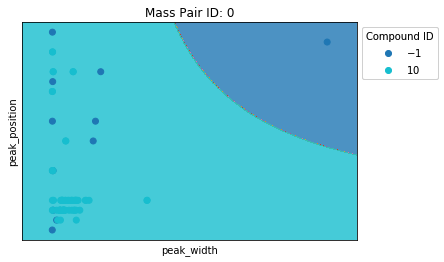

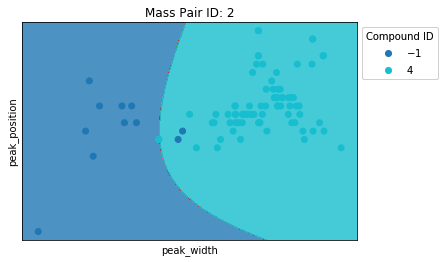

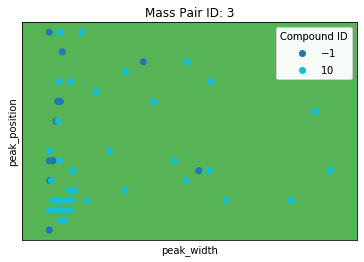

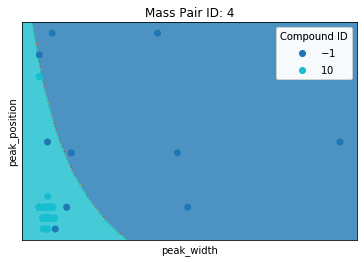

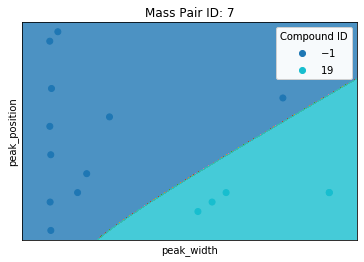

...

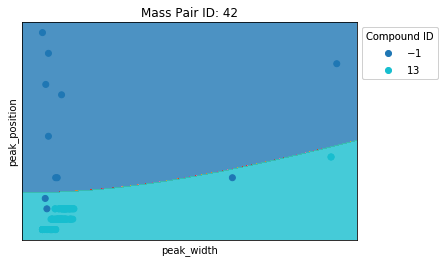

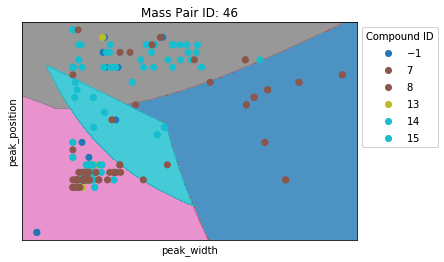

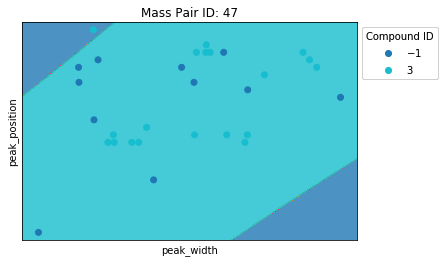

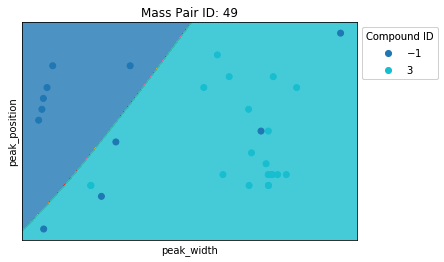

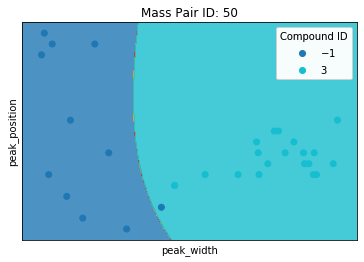

In [12]:
from sklearn.svm import SVC
C = 1.0  # SVM regularization parameter

for mass_pair_id, compound_id_to_dataset in mass_pair_id_to_compound_ids_to_dataset.items():
    plot_with_labels(mass_pair_id, compound_id_to_dataset, ['peak_width', 'peak_position'], lambda: SVC(kernel='poly', degree=2, gamma='scale', C=C))
    plt.show()

After reviewing each mass pair graph, it appears that in some cases we can distinguish quite well, while in other cases we cannot. Looking at mass pair id 46 we can see that the regions drawn are quite elaborate. This is very concerning because it could indicate that the current feature set we are using will not scale well if we were to expand our compound library. Peak shape may be a possible distinguisher. I will have to use a CNN on the intensities to see if they can be classified accordingly.

## Benchmark

As previously discussed, our benchmark will be a true positive rate of greater or equal to 90% and a false positive rate less than or equal to 2%.

# Methodology

In [13]:
#reminder of what data looks like
display(merged_data_set.head(1))

max_timestep = int(merged_data_set.columns[-1].split('_')[-1])

,mass_pair_id,sample_id,comment,substrate,detection,association,peak_height,peak_width,peak_area,peak_position,...,timestep_14,timestep_15,timestep_16,timestep_17,timestep_18,timestep_19,timestep_20,timestep_21,timestep_22,timestep_23
0,0,30037,Positive Control,None,"[21, 0, 18, 4]",[10],477.454417,6.386572,1823.300717,20.0,...,12.077684,12.398664,1170.550038,13.094119,10.633276,8.600405,5.765087,7.052225,10.963616,3.839209


## Data preprocessing

I want to build a data structure that would allow me to easily switch between different algorithm prototypes.The data structure will be a dictionary of compound_id to associated mass pairs. Each associated mass pair will have a lookup of their timestep intensity values that will be passed into its respective model. I do not need to pad the time steps because they are currently all the same. We will investigate later if smoothing the time step intensities has any impact. We will normalize the timesteps when passing them into the model. The normalization will work by taking the max intensity of all relevant mass pairs to a compound and dividing all intensities by that max value therefore making all intensities values between 1 and 0. This normalization allows us to retain the shape of our intensities while allowing us to scale the values down for faster learning. 

In [14]:
def get_compound_ids_to_mass_pair_ids_to_dataset(merged_data_set, compound_id_to_mass_pair_ids):
    merged_data_set = merged_data_set.copy()
    compounds_to_detection_data_set = merged_data_set.groupby(['detection']).groups
    mass_pair_id_to_group_indices = merged_data_set.groupby(['mass_pair_id']).groups
    timestep_columns = merged_data_set.columns[10:]

    compound_ids_to_mass_pair_ids_to_dataset = dict()
    for compounds, compound_detection_indices in sorted(compounds_to_detection_data_set.items()):
        if compounds == 'None':
            continue
        else:
            compound_ids = string_to_list_of_int(compounds)
        for compound_id in compound_ids:
            if compound_id not in compound_id_to_mass_pair_ids:
                continue #skip
            if compound_id not in compound_ids_to_mass_pair_ids_to_dataset:
                compound_ids_to_mass_pair_ids_to_dataset[compound_id] = dict()
            for mass_pair_id in compound_id_to_mass_pair_ids[compound_id]:
                mass_pair_indices = mass_pair_id_to_group_indices[mass_pair_id]
                #intersection of group indices
                detection_indices = list(set(mass_pair_indices).intersection(set(compound_detection_indices)))
                no_detection_indices = list(set(mass_pair_indices) - set(detection_indices))

                detection_dataset = merged_data_set.iloc[detection_indices][timestep_columns]
                no_detection_dataset = merged_data_set.iloc[no_detection_indices][timestep_columns]
                detection_dataset = detection_dataset.assign(detection=compound_id)
                no_detection_dataset = no_detection_dataset.assign(detection=-1)
                dataset = detection_dataset.append(no_detection_dataset)
                #print(set(dataset['detection']))
                if mass_pair_id not in compound_ids_to_mass_pair_ids_to_dataset[compound_id]:
                    compound_ids_to_mass_pair_ids_to_dataset[compound_id][mass_pair_id] = dataset
                else:
                    pd.concat([compound_ids_to_mass_pair_ids_to_dataset[compound_id][mass_pair_id], dataset])
            compound_ids_to_mass_pair_ids_to_dataset[compound_id] = dict(sorted(compound_ids_to_mass_pair_ids_to_dataset[compound_id].items()))
    compound_ids_to_mass_pair_ids_to_dataset = dict(sorted(compound_ids_to_mass_pair_ids_to_dataset.items()))                
    return compound_ids_to_mass_pair_ids_to_dataset
    
compound_ids_to_mass_pair_ids_to_dataset = get_compound_ids_to_mass_pair_ids_to_dataset(merged_data_set, compound_id_to_mass_pair_ids)
for compound_id in compound_ids_to_mass_pair_ids_to_dataset.keys():
    print("Compound ", compound_id)
    print("Mass pairs", list(compound_ids_to_mass_pair_ids_to_dataset[compound_id].keys()))

Compound  0
Mass pairs [22, 23, 25, 26, 33, 34]
Compound  3
Mass pairs [20, 47, 49, 50]
Compound  4
Mass pairs [2, 11]
Compound  7
Mass pairs [16, 18, 27, 30, 46]
Compound  8
Mass pairs [16, 18, 39, 46]
Compound  10
Mass pairs [0, 3, 4, 19, 20, 22, 23]
Compound  13
Mass pairs [41, 42, 46]
Compound  14
Mass pairs [16, 18, 46]
Compound  15
Mass pairs [36, 39, 46]
Compound  18
Mass pairs [19, 20, 21, 40]
Compound  19
Mass pairs [7, 8]
Compound  21
Mass pairs [22, 23, 25, 26, 33, 34]
Compound  22
Mass pairs [35, 37, 38]


## Implementation

I will build a temporal CNN using 1D convolution layers. I could build one using 2D layers, however, I think we could simplify the model by using just the intensities without absolute accurate time coordinates.

Model design:
Our current data follows the format mass pairs to intensities or timesteps. Our model needs to be timesteps to mass pairs. For ease of use we allow the data to be passed in its original format and we will permute the data to reformat it for our needs. Next, we will follow the pattern of using 2 convolutional layers and then a pooling layer to extract and simplify features and the dataset. By using 2 iterations of this design there should be enough features to determine if there are any consistent patterns that allow for accurate classification. I finished the model with a dropout layer as to not overfit our data.

Since I want to have a model made per compound id our last layer will be a dense node of 1 with a sigmoid activation. If we wanted to have a multilabel model we would have the final layer be the number of classes and an activation function of softmax.

In [15]:
from keras.models import Sequential, Model
from keras.layers import Dense, Conv1D, \
    MaxPooling1D, GlobalAveragePooling1D, Dropout, \
    Input, Permute

def build_compound_model(mass_pair_count, max_timestep, print_summary=True):
    input = Input(shape=(mass_pair_count, max_timestep))

    x = Permute((2, 1))(input)
    x = Conv1D(128, 5, activation='relu')(x)
    x = Conv1D(128, 5, activation='relu')(x)
    x = MaxPooling1D()(x)
    x = Conv1D(128, 3, activation='relu')(x)
    x = Conv1D(128, 3, activation='relu')(x)
    x = GlobalAveragePooling1D()(x)
    x = Dropout(0.5)(x)

    shape_output = Dense(1, activation='sigmoid')(x)

    model = Model(input, shape_output)

    if print_summary:
        print(model.summary())

    return model

Using TensorFlow backend.


Next, create an algorithm that passes all associated mass pair intensities into the created model. We could create a multilabel model, but for experimentation purposes, I would like to create a dictionary of compound to model. I will compile each model using the Adam optimizer for updating the graph weights based on the training data and our loss function will be binary cross entropy because our output is theoretically binary. Our output is a probability that we will need to apply a threshold limit to determine if we should mark it as a true detection or no detection. We will use a ROC curve on the training data to determine the best threshold with the parameters of having less than 2% false positives. I will need to stack the associated mass pairs to intensities in order to pass them into my created model.

In [16]:
from sklearn.model_selection import train_test_split
from keras.callbacks import ModelCheckpoint, EarlyStopping
from sklearn.metrics import roc_curve, roc_auc_score
#from sklearn.tree import DecisionTreeClassifier
import time

def build_train_model(mass_pair_ids_to_dataset):
    mass_pair_ids_to_dataset_copy = mass_pair_ids_to_dataset.copy()
    mass_pair_count = len(mass_pair_ids_to_dataset_copy)
    model = build_compound_model(mass_pair_count, max_timestep, False)
    model.compile(optimizer='adam',
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    
    intensities_and_outputs = np.stack(list(mass_pair_ids_to_dataset_copy.values()), axis=1)
    
    
    print(list(mass_pair_ids_to_dataset_copy.keys()))
    
    
    
    #validate
    #for i, (mass_pair_ids, dataset) in enumerate(mass_pair_ids_to_dataset.items()):
    #    if not np.array_equal(intensities_and_outputs[1,i], dataset.to_numpy()[1]):
    #        print("stack fail")
    #        break
    X = intensities_and_outputs[:,:,:-1]

    #normalize
    def normalize(array):
        for i, data in enumerate(array):
            array[i] = np.nan_to_num(data/np.amax(data))
        return array

    X = normalize(X)
    
    y = intensities_and_outputs[:,0,-1]#all of axis 1 will have same value
    #convert y to binary form
    y = (y >= 0).astype(int)

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=7)
    
    detected_count = sum(y_train)
    non_detected_count = len(y_train) - detected_count
    
    arange = np.arange(X.shape[-1])

    fig = plt.figure()
    
    plot_count = detected_count if detected_count < 8 else 8
    
    detected_train_X = X_train[np.where(y_train > 0)]
    
    mass_pairs = list(mass_pair_ids_to_dataset_copy.keys())
    subplot = 241
    for sample_index in range(plot_count):
        ax = fig.add_subplot(subplot)
        subplot += 1
    
        
        for mass_pair_index, array in enumerate(detected_train_X[sample_index]):
            lines = ax.plot(arange, array, label=mass_pairs[mass_pair_index])
        
        ax.legend(loc='upper right')

    plt.subplots_adjust(right=3, top=3)
    plt.show()
    
    
    print("Train on detected ", detected_count, " non-detected ", non_detected_count)
    
    start = time.time()
    early_stopping = EarlyStopping('val_acc', patience=10)
    model.fit(X_train, y_train, epochs=1000, verbose=0,
              validation_split=0.2, callbacks=[early_stopping])
    end = time.time()
    
    train_time = end - start
    print("Train time in seconds: ", train_time)
    
    y_hat = model.predict(X_train)
    fprs, tprs, thresholds = roc_curve(y_train, y_hat)
    
    #choose threshold where fpr <= 2% and tpr is the greatest
    
    potential_indices = np.where(fprs <= 0.02)
    max_tpr = max(tprs[potential_indices])
    index = tprs.tolist().index(max_tpr)
    
    threshold = float(thresholds[index])
    
    #dt = DecisionTreeClassifier(random_state=0, max_depth=1)
    #dt.fit(y_hat, y_test)
    
    #threshold = dt.tree_.threshold[0]
    
    #plot threshold
    fig, ax = plt.subplots()
    
    detection_indices = np.where(y_test > 0)
    no_detection_indices = np.where(y_test == 0)
    
    ax.scatter(y_hat[no_detection_indices], y_test[no_detection_indices], label="No Detection")
    ax.scatter(y_hat[detection_indices], y_test[detection_indices], label="Detection")
    ax.plot([threshold, threshold], [-1, 2], color='g')

    ax.legend()
    ax.grid(True)

    plt.show()
    
    #apply theshold
    y_hat = (y_hat >= threshold).astype(int)
    
    auc_score = roc_auc_score(y_train, y_hat)
    predicted_tpr = tprs[index]
    predicted_fpr = fprs[index]
    print("AUC", auc_score)
    print("Predicted TPR", predicted_tpr)
    print("Predicted FPR", predicted_fpr)
    print("Threshold", threshold)
    
    print("-----------------------End of training---------------------------")
    
    return model, (X_test, y_test), predicted_tpr, predicted_fpr, threshold, auc_score
    

In [17]:
from sklearn.metrics import accuracy_score, confusion_matrix, fbeta_score, classification_report, precision_recall_fscore_support, \
                            roc_curve, roc_auc_score

def test_model_and_output_results(model, testset, threshold, print_results=True):
    X_test, y_test = testset
    y_hat = model.predict(X_test)
    
    #plot threshold
    fig, ax = plt.subplots()
    
    detection_indices = np.where(y_test > 0)
    no_detection_indices = np.where(y_test == 0)
    
    ax.scatter(y_hat[no_detection_indices], y_test[no_detection_indices], label="No Detection")
    ax.scatter(y_hat[detection_indices], y_test[detection_indices], label="Detection")
    ax.plot([threshold, threshold], [-1, 2], color='g')

    ax.legend()
    ax.grid(True)

    plt.show()
    
    #apply theshold
    y_hat = (y_hat >= threshold).astype(int)
    
    count = len(y_test)
    detected_count = sum(y_test)
    non_detected_count = count - detected_count
    if print_results:
        print("Test on detected ", detected_count, " non-detected ", non_detected_count)
        print("F0.5 {0:.2%}".format(fbeta_score(y_test, y_hat, beta=0.5)))
        print()
        print("Confusion Matrix:")
    tn, fp, fn, tp = confusion_matrix(y_test, y_hat).ravel()
    fpr = fp/non_detected_count
    tpr = tp/detected_count
    if print_results:
        print("True Negative {0:.2%}".format(tn/non_detected_count))
        print("False Positive {0:.2%}".format(fpr))
        print("False Negative {0:.2%}".format(fn/detected_count))
        print("True Positive {0:.2%}".format(tpr))
        print()
        print("Classification Report")
        print(classification_report(y_test, y_hat, target_names=['blank', 'detected'], digits=3))
        print("---------------------------end of testing--------------------------------")
    return tpr, fpr

In [18]:
def compound_id_results_to_dataframe(compound_id_to_results, columns=["Compounds", "Tr-TPR" ,"Tr-FPR", "Threshold", "ROC AUC Score", "Test-TPR", "Test-FPR"]):
    table = []
    for compound_id, results in compound_id_to_results.items():
        row = []
        for result in results:
            if isinstance(result, (float, np.float32, np.float64)):
                value = "{:.2%}".format(result)
            else:
                value = result
            row.append(value)
        row.insert(0, compound_id)
        table.append(row)
    return pd.DataFrame(table, columns=columns)

W0806 14:51:44.700052 33916 deprecation_wrapper.py:119] From C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\keras\backend\tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0806 14:51:44.715050 33916 deprecation_wrapper.py:119] From C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\keras\backend\tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0806 14:51:44.720054 33916 deprecation_wrapper.py:119] From C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\keras\backend\tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0806 14:51:44.752054 33916 deprecation_wrapper.py:119] From C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\keras\backend\tensorflow_backend.py:3976: The name tf.nn.max_pool is deprecate


Compound ID 0
[22, 23, 25, 26, 33, 34]


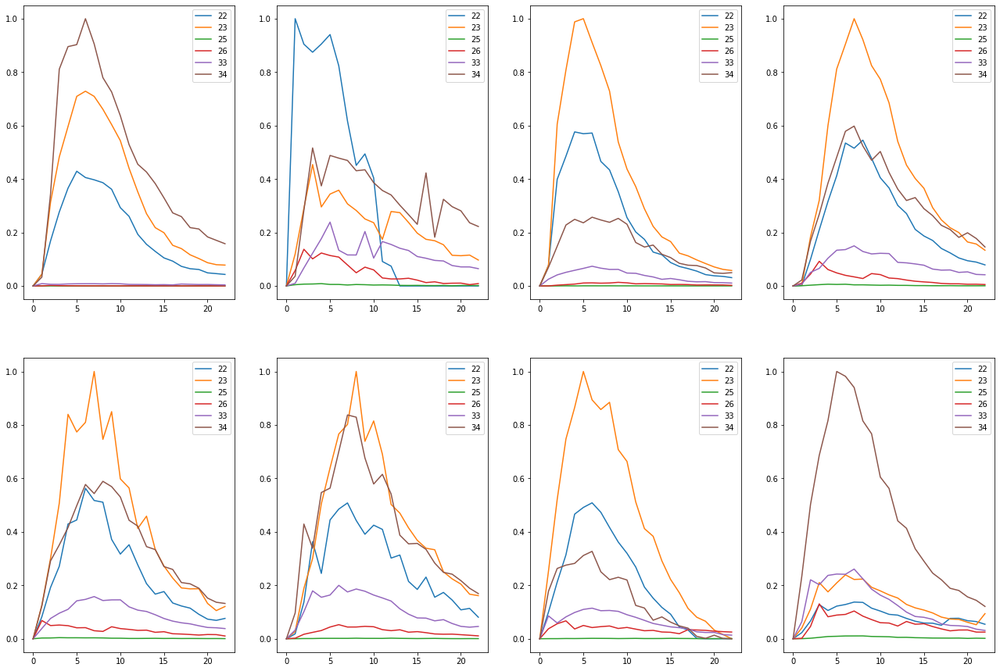

Train on detected  61  non-detected  451
Train time in seconds:  5.472107172012329


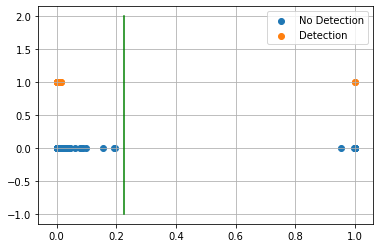

AUC 0.973192541165352
Predicted TPR 0.9508196721311475
Predicted FPR 0.004434589800443459
Threshold 0.226781964302063
-----------------------End of training---------------------------


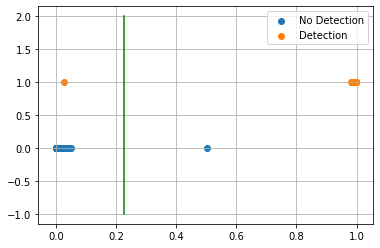

Test on detected  14  non-detected  115
F0.5 92.86%

Confusion Matrix:
True Negative 99.13%
False Positive 0.87%
False Negative 7.14%
True Positive 92.86%

Classification Report
              precision    recall  f1-score   support

       blank      0.991     0.991     0.991       115
    detected      0.929     0.929     0.929        14

    accuracy                          0.984       129
   macro avg      0.960     0.960     0.960       129
weighted avg      0.984     0.984     0.984       129

---------------------------end of testing--------------------------------

Compound ID 3
[20, 47, 49, 50]


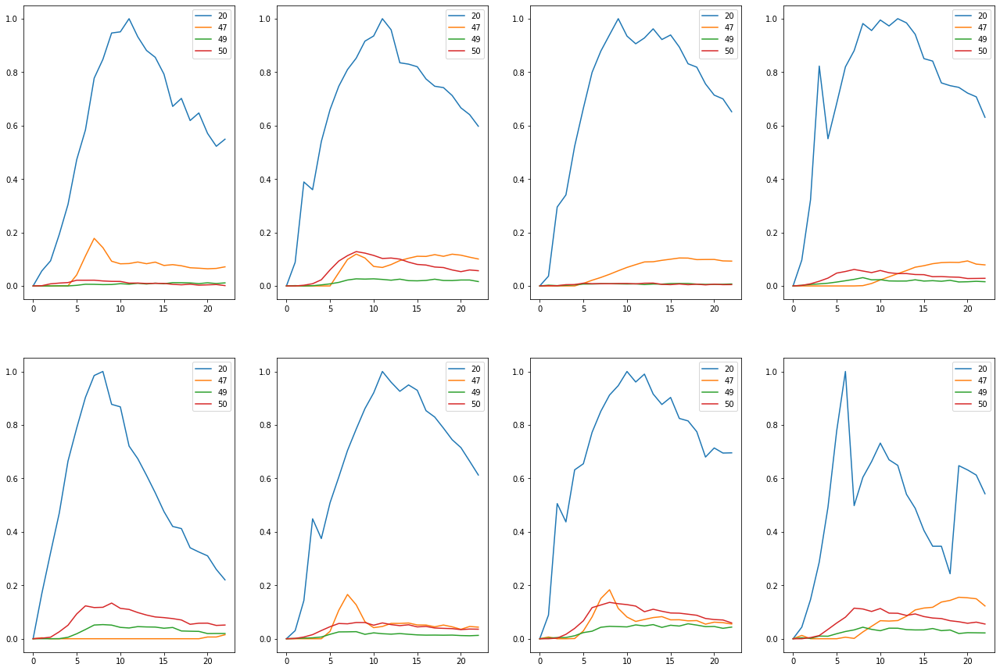

Train on detected  16  non-detected  496
Train time in seconds:  2.906071186065674


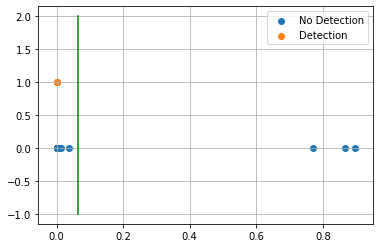

AUC 0.9637096774193549
Predicted TPR 0.9375
Predicted FPR 0.010080645161290322
Threshold 0.06450852751731873
-----------------------End of training---------------------------


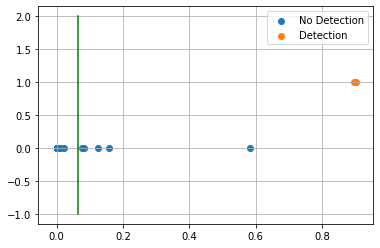

Test on detected  3  non-detected  126
F0.5 42.86%

Confusion Matrix:
True Negative 96.03%
False Positive 3.97%
False Negative 0.00%
True Positive 100.00%

Classification Report
              precision    recall  f1-score   support

       blank      1.000     0.960     0.980       126
    detected      0.375     1.000     0.545         3

    accuracy                          0.961       129
   macro avg      0.688     0.980     0.763       129
weighted avg      0.985     0.961     0.970       129

---------------------------end of testing--------------------------------

Compound ID 4
[2, 11]


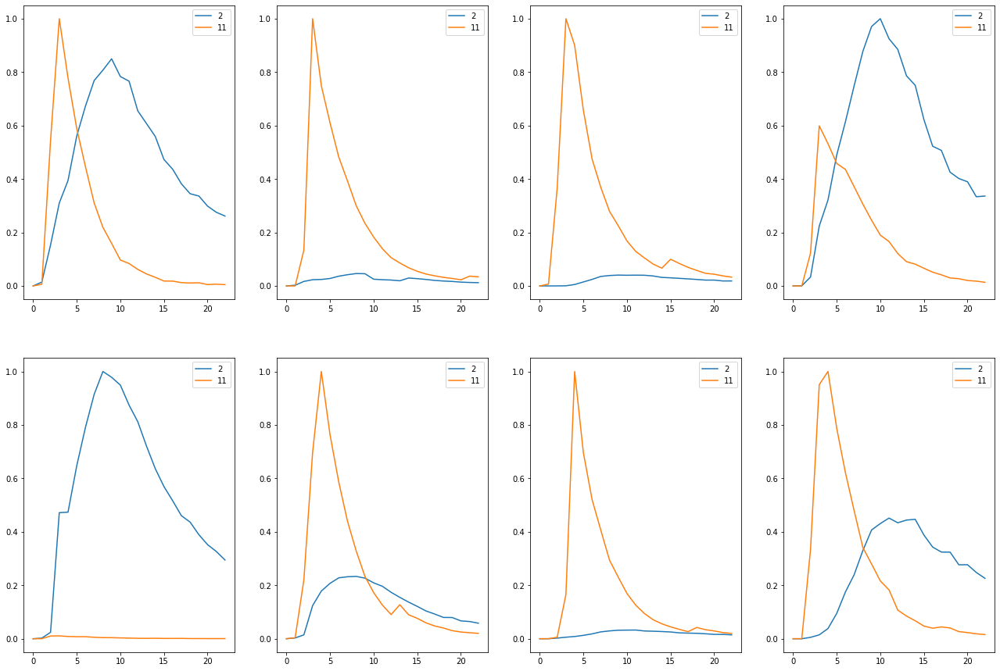

Train on detected  61  non-detected  451
Train time in seconds:  2.8170509338378906


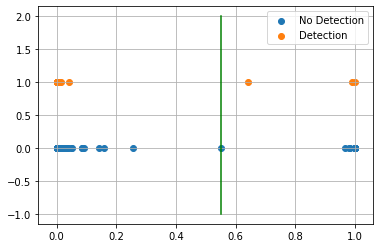

AUC 0.9955654101995565
Predicted TPR 1.0
Predicted FPR 0.008869179600886918
Threshold 0.5519118905067444
-----------------------End of training---------------------------


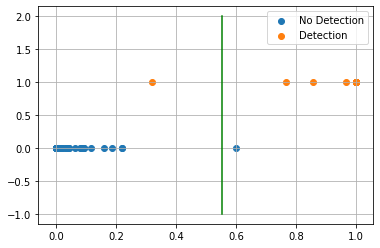

Test on detected  14  non-detected  115
F0.5 92.86%

Confusion Matrix:
True Negative 99.13%
False Positive 0.87%
False Negative 7.14%
True Positive 92.86%

Classification Report
              precision    recall  f1-score   support

       blank      0.991     0.991     0.991       115
    detected      0.929     0.929     0.929        14

    accuracy                          0.984       129
   macro avg      0.960     0.960     0.960       129
weighted avg      0.984     0.984     0.984       129

---------------------------end of testing--------------------------------

Compound ID 7
[16, 18, 27, 30, 46]


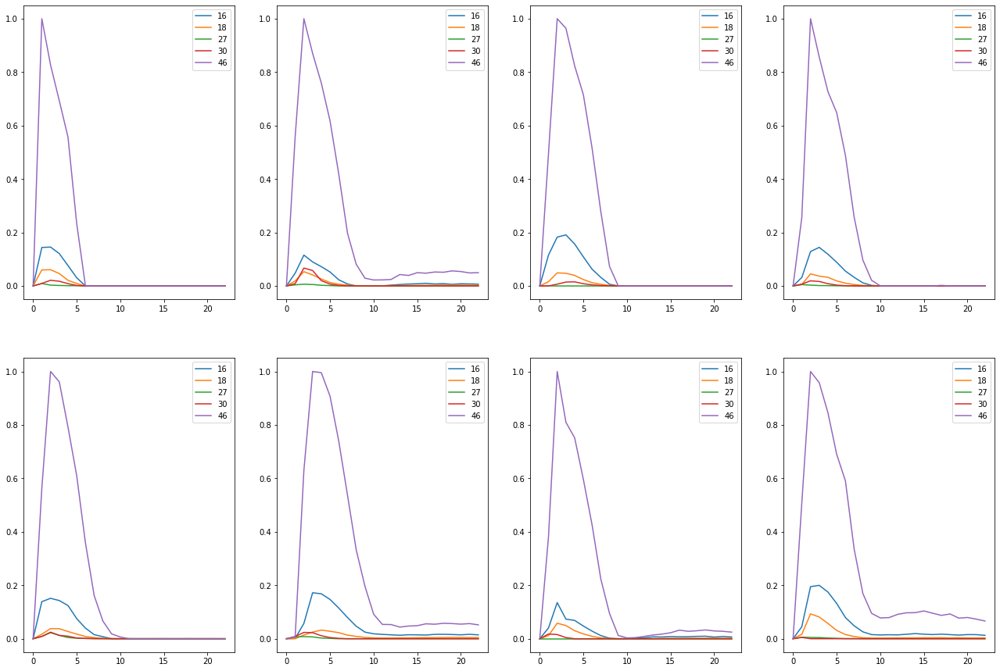

Train on detected  8  non-detected  504
Train time in seconds:  2.2340657711029053


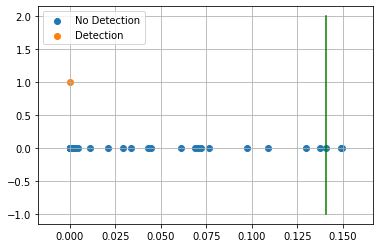

AUC 0.9950396825396826
Predicted TPR 1.0
Predicted FPR 0.00992063492063492
Threshold 0.14103618264198303
-----------------------End of training---------------------------


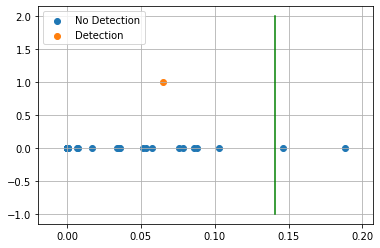

Test on detected  1  non-detected  128
F0.5 0.00%

Confusion Matrix:
True Negative 98.44%
False Positive 1.56%
False Negative 100.00%
True Positive 0.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.992     0.984     0.988       128
    detected      0.000     0.000     0.000         1

    accuracy                          0.977       129
   macro avg      0.496     0.492     0.494       129
weighted avg      0.984     0.977     0.981       129

---------------------------end of testing--------------------------------

Compound ID 8
[16, 18, 39, 46]


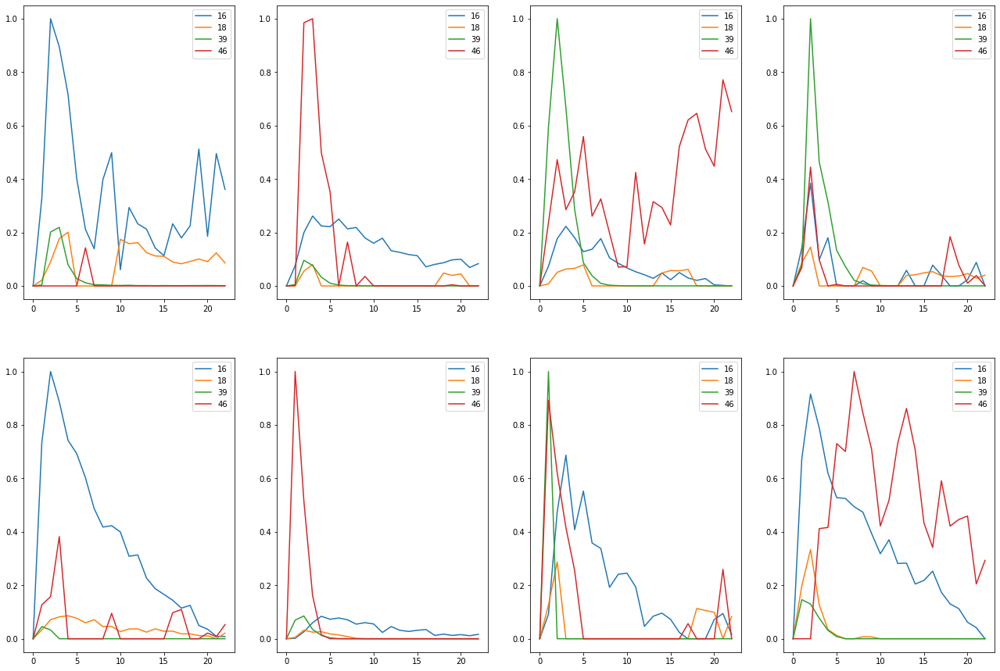

Train on detected  47  non-detected  465
Train time in seconds:  2.604046106338501


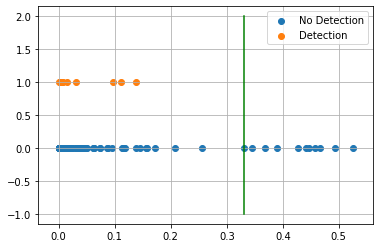

AUC 0.7393045069778083
Predicted TPR 0.48936170212765956
Predicted FPR 0.010752688172043012
Threshold 0.33151668310165405
-----------------------End of training---------------------------


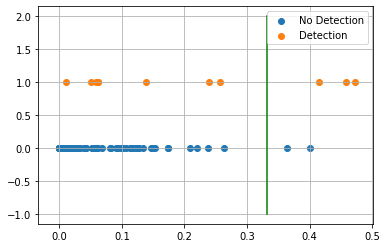

Test on detected  11  non-detected  118
F0.5 48.39%

Confusion Matrix:
True Negative 98.31%
False Positive 1.69%
False Negative 72.73%
True Positive 27.27%

Classification Report
              precision    recall  f1-score   support

       blank      0.935     0.983     0.959       118
    detected      0.600     0.273     0.375        11

    accuracy                          0.922       129
   macro avg      0.768     0.628     0.667       129
weighted avg      0.907     0.922     0.909       129

---------------------------end of testing--------------------------------

Compound ID 10
[0, 3, 4, 19, 20, 22, 23]


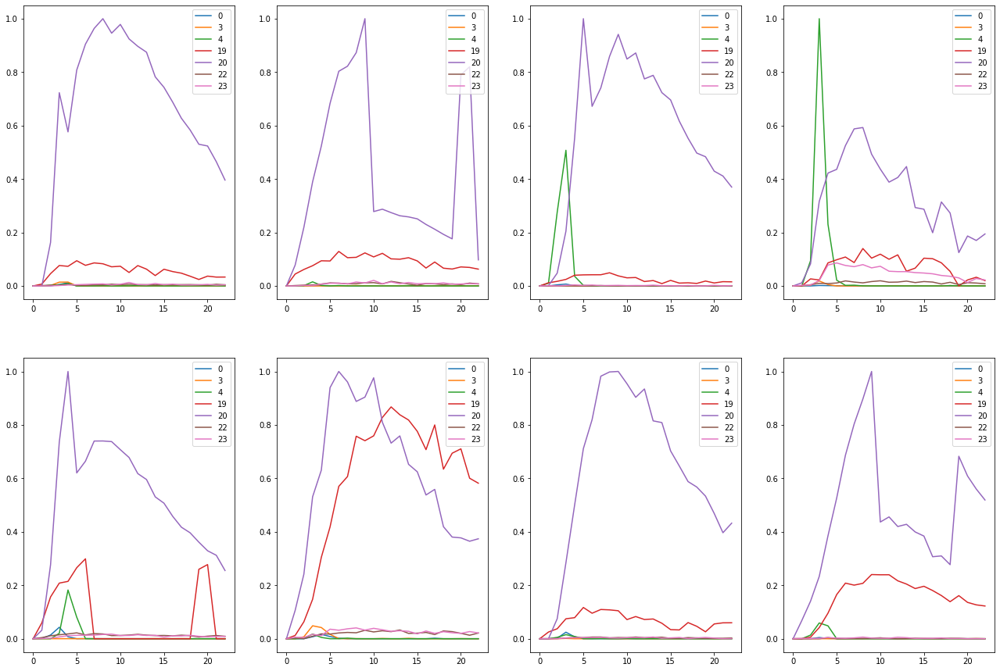

Train on detected  47  non-detected  465
Train time in seconds:  4.21209192276001


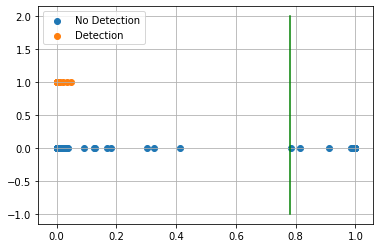

AUC 0.9754975978037064
Predicted TPR 0.9574468085106383
Predicted FPR 0.0064516129032258064
Threshold 0.7800416946411133
-----------------------End of training---------------------------


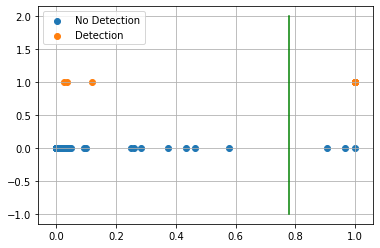

Test on detected  11  non-detected  118
F0.5 72.73%

Confusion Matrix:
True Negative 97.46%
False Positive 2.54%
False Negative 27.27%
True Positive 72.73%

Classification Report
              precision    recall  f1-score   support

       blank      0.975     0.975     0.975       118
    detected      0.727     0.727     0.727        11

    accuracy                          0.953       129
   macro avg      0.851     0.851     0.851       129
weighted avg      0.953     0.953     0.953       129

---------------------------end of testing--------------------------------

Compound ID 13
[41, 42, 46]


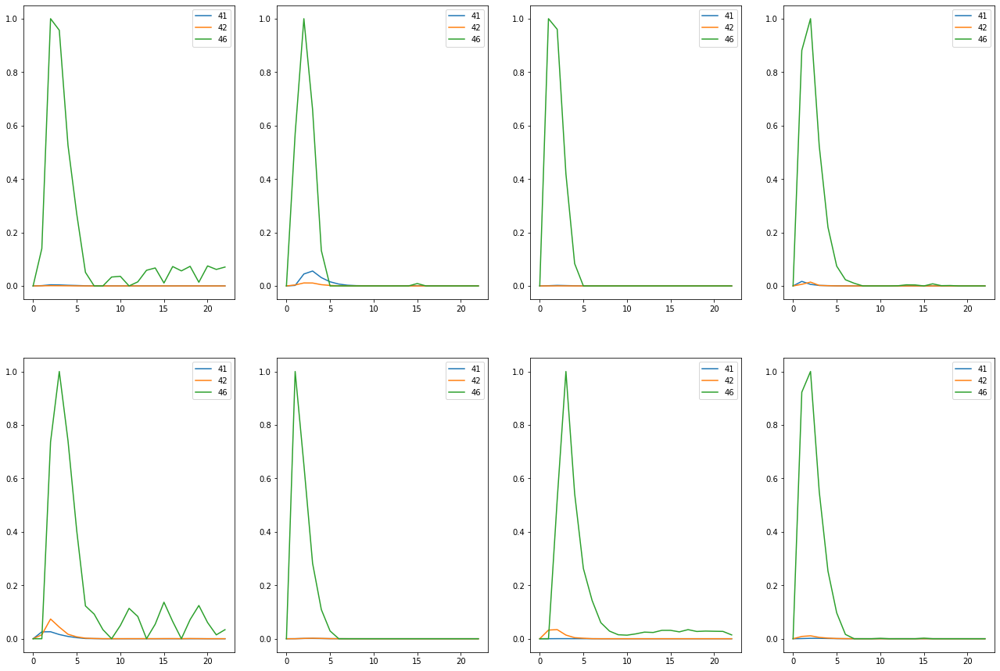

Train on detected  56  non-detected  456
Train time in seconds:  5.741103172302246


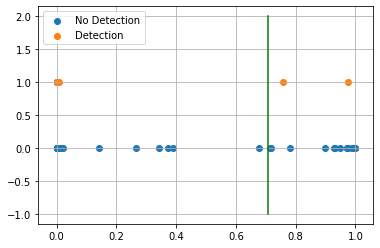

AUC 0.9844924812030075
Predicted TPR 0.9821428571428571
Predicted FPR 0.013157894736842105
Threshold 0.7067968845367432
-----------------------End of training---------------------------


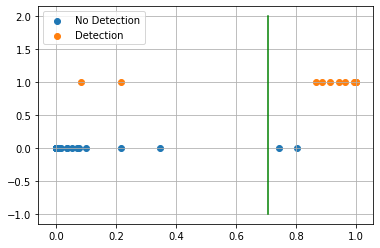

Test on detected  12  non-detected  117
F0.5 83.33%

Confusion Matrix:
True Negative 98.29%
False Positive 1.71%
False Negative 16.67%
True Positive 83.33%

Classification Report
              precision    recall  f1-score   support

       blank      0.983     0.983     0.983       117
    detected      0.833     0.833     0.833        12

    accuracy                          0.969       129
   macro avg      0.908     0.908     0.908       129
weighted avg      0.969     0.969     0.969       129

---------------------------end of testing--------------------------------

Compound ID 14
[16, 18, 46]


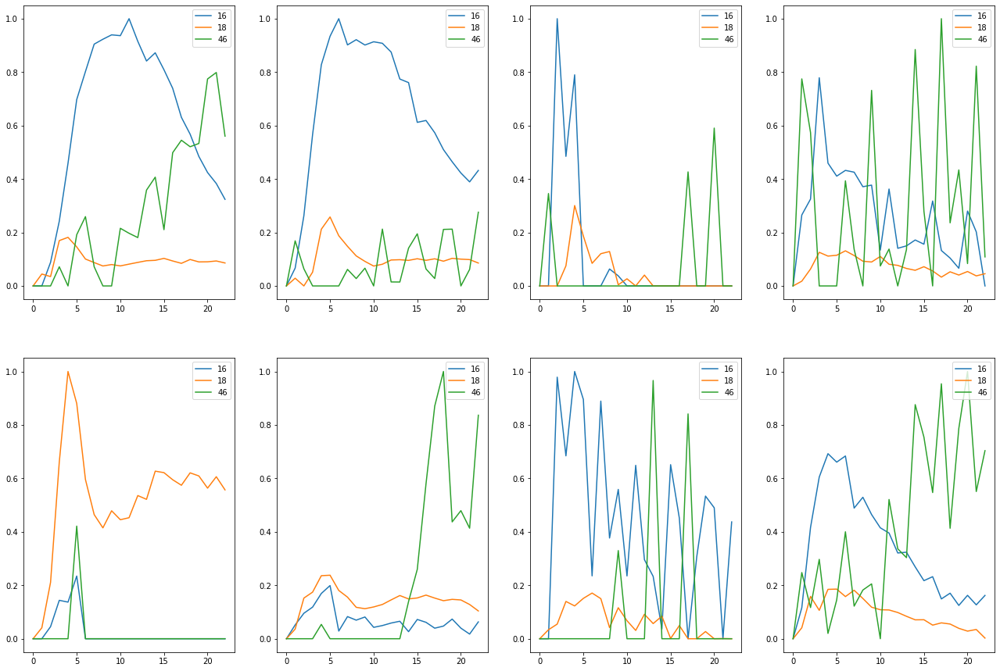

Train on detected  31  non-detected  481
Train time in seconds:  3.056058168411255


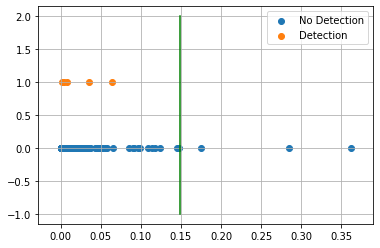

AUC 0.6691033465227014
Predicted TPR 0.3548387096774194
Predicted FPR 0.016632016632016633
Threshold 0.14831757545471191
-----------------------End of training---------------------------


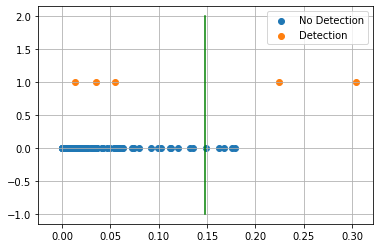

Test on detected  5  non-detected  124
F0.5 30.30%

Confusion Matrix:
True Negative 95.97%
False Positive 4.03%
False Negative 60.00%
True Positive 40.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.975     0.960     0.967       124
    detected      0.286     0.400     0.333         5

    accuracy                          0.938       129
   macro avg      0.631     0.680     0.650       129
weighted avg      0.949     0.938     0.943       129

---------------------------end of testing--------------------------------

Compound ID 15
[36, 39, 46]


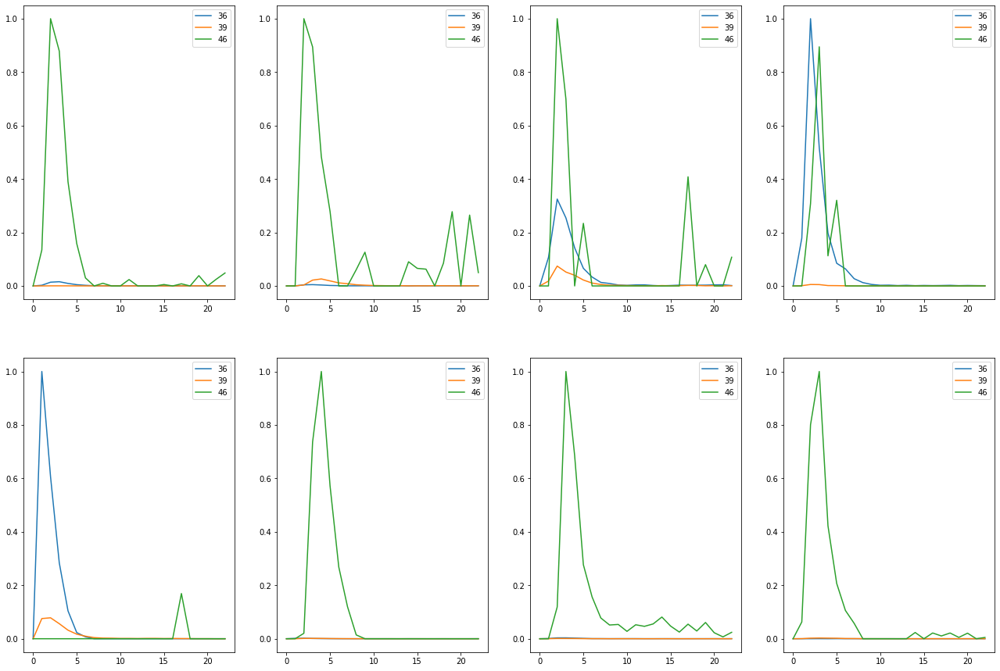

Train on detected  56  non-detected  456
Train time in seconds:  2.6510512828826904


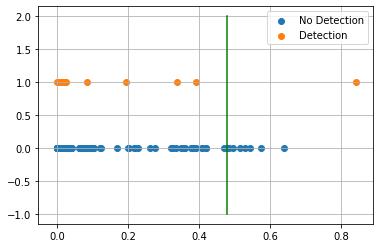

AUC 0.6240601503759398
Predicted TPR 0.26785714285714285
Predicted FPR 0.019736842105263157
Threshold 0.4792516231536865
-----------------------End of training---------------------------


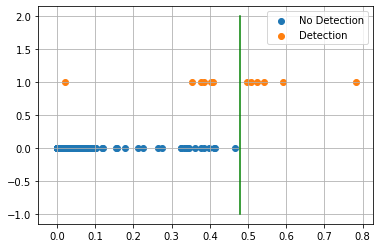

Test on detected  12  non-detected  117
F0.5 83.33%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 50.00%
True Positive 50.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.951     1.000     0.975       117
    detected      1.000     0.500     0.667        12

    accuracy                          0.953       129
   macro avg      0.976     0.750     0.821       129
weighted avg      0.956     0.953     0.946       129

---------------------------end of testing--------------------------------

Compound ID 18
[19, 20, 21, 40]


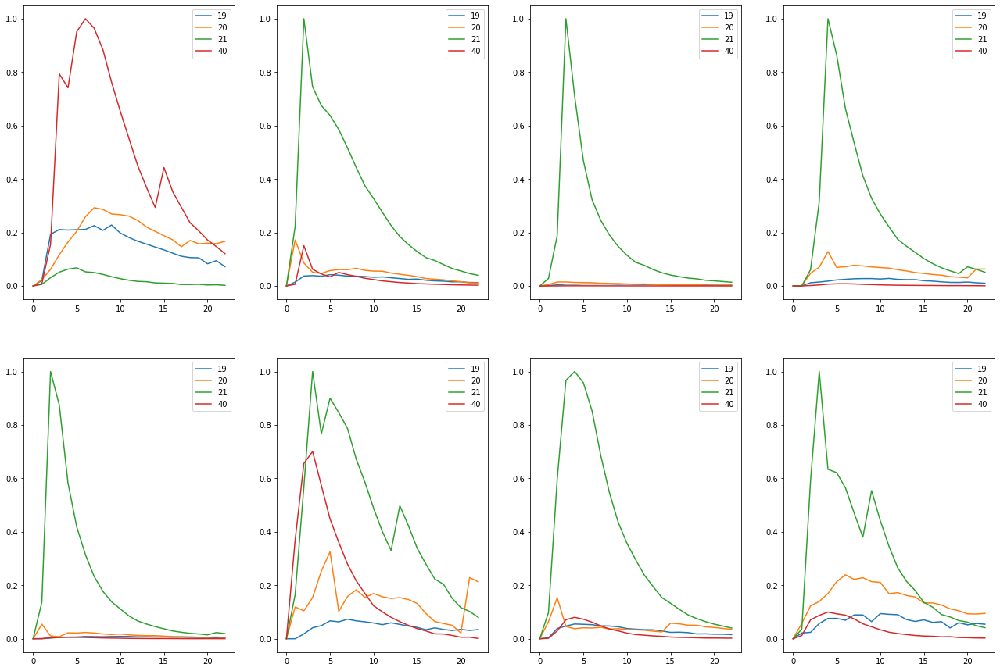

Train on detected  63  non-detected  449
Train time in seconds:  3.5361034870147705


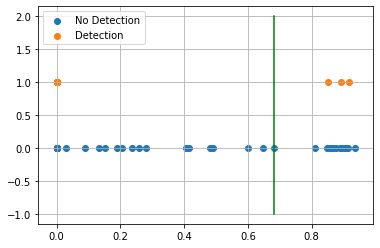

AUC 0.8799802029200692
Predicted TPR 0.7777777777777778
Predicted FPR 0.017817371937639197
Threshold 0.6827720999717712
-----------------------End of training---------------------------


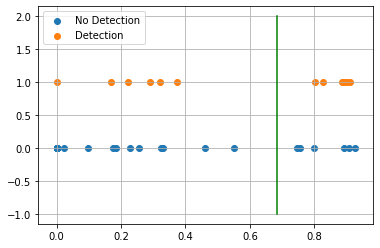

Test on detected  14  non-detected  115
F0.5 57.14%

Confusion Matrix:
True Negative 94.78%
False Positive 5.22%
False Negative 42.86%
True Positive 57.14%

Classification Report
              precision    recall  f1-score   support

       blank      0.948     0.948     0.948       115
    detected      0.571     0.571     0.571        14

    accuracy                          0.907       129
   macro avg      0.760     0.760     0.760       129
weighted avg      0.907     0.907     0.907       129

---------------------------end of testing--------------------------------

Compound ID 19
[7, 8]


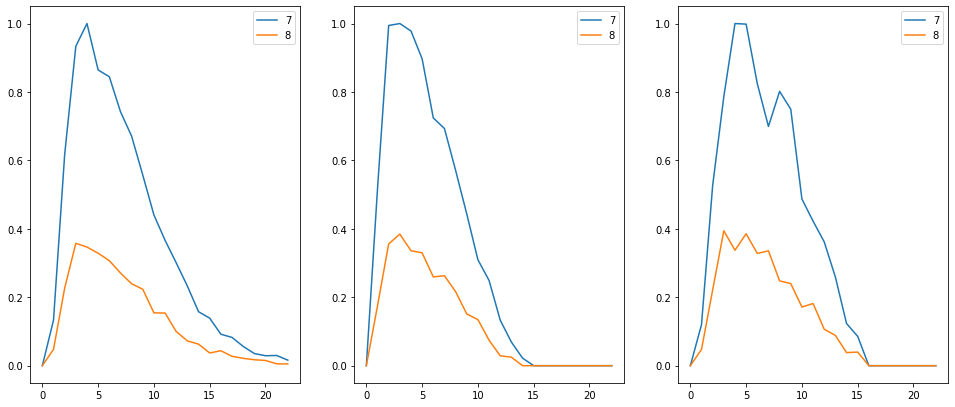

Train on detected  3  non-detected  509
Train time in seconds:  2.7930572032928467


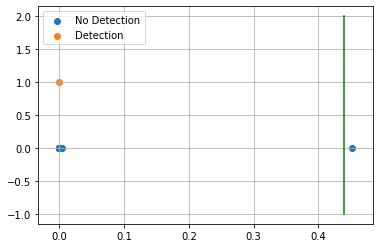

AUC 1.0
Predicted TPR 1.0
Predicted FPR 0.0
Threshold 0.43908393383026123
-----------------------End of training---------------------------


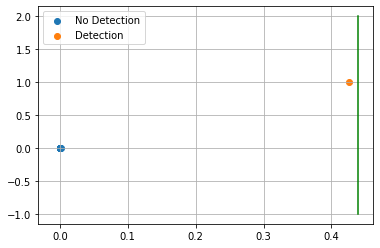

Test on detected  1  non-detected  128
F0.5 0.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 100.00%
True Positive 0.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.992     1.000     0.996       128
    detected      0.000     0.000     0.000         1

    accuracy                          0.992       129
   macro avg      0.496     0.500     0.498       129
weighted avg      0.985     0.992     0.988       129

---------------------------end of testing--------------------------------

Compound ID 21
[22, 23, 25, 26, 33, 34]


C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and bein

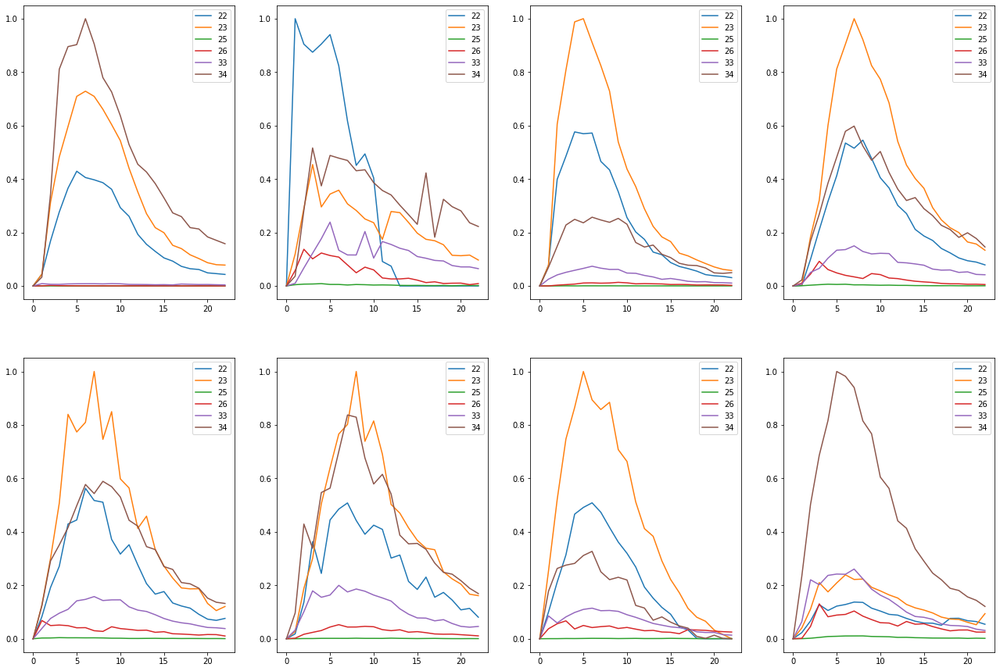

Train on detected  61  non-detected  451
Train time in seconds:  3.4490814208984375


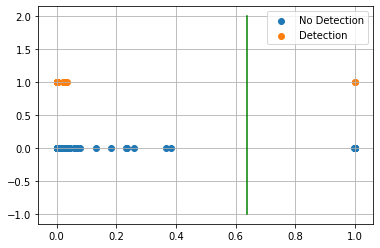

AUC 0.9709752462651303
Predicted TPR 0.9508196721311475
Predicted FPR 0.008869179600886918
Threshold 0.6374834179878235
-----------------------End of training---------------------------


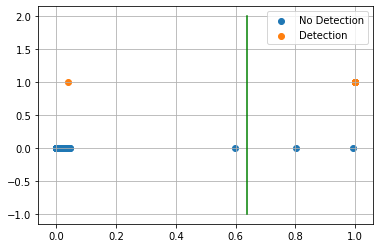

Test on detected  14  non-detected  115
F0.5 87.84%

Confusion Matrix:
True Negative 98.26%
False Positive 1.74%
False Negative 7.14%
True Positive 92.86%

Classification Report
              precision    recall  f1-score   support

       blank      0.991     0.983     0.987       115
    detected      0.867     0.929     0.897        14

    accuracy                          0.977       129
   macro avg      0.929     0.956     0.942       129
weighted avg      0.978     0.977     0.977       129

---------------------------end of testing--------------------------------

Compound ID 22
[35, 37, 38]


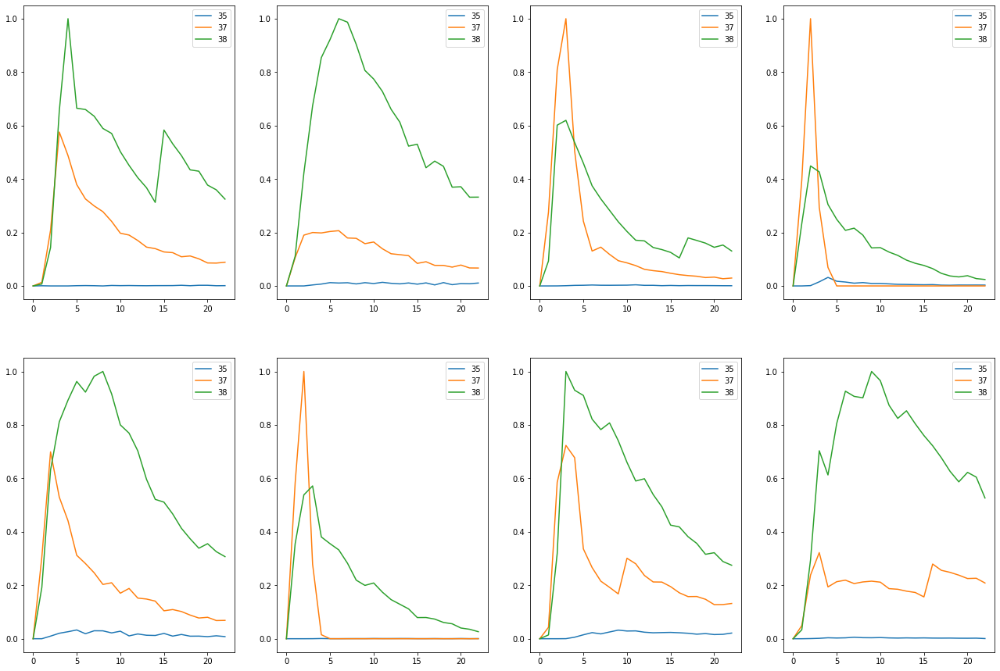

Train on detected  65  non-detected  447
Train time in seconds:  3.2320663928985596


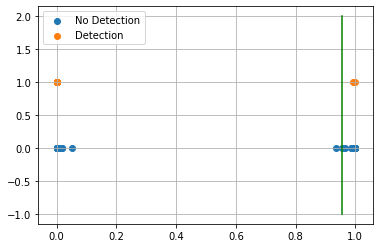

AUC 1.0
Predicted TPR 1.0
Predicted FPR 0.0
Threshold 0.9540458917617798
-----------------------End of training---------------------------


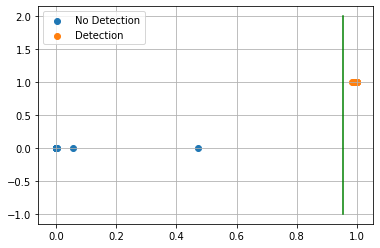

Test on detected  14  non-detected  115
F0.5 100.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 0.00%
True Positive 100.00%

Classification Report
              precision    recall  f1-score   support

       blank      1.000     1.000     1.000       115
    detected      1.000     1.000     1.000        14

    accuracy                          1.000       129
   macro avg      1.000     1.000     1.000       129
weighted avg      1.000     1.000     1.000       129

---------------------------end of testing--------------------------------
 Compounds  Tr-TPR  Tr-FPR Threshold ROC AUC Score Test-TPR Test-FPR
     0       95.08%  0.44%   22.68%       97.32%     92.86%   0.87% 
     3       93.75%  1.01%    6.45%       96.37%    100.00%   3.97% 
     4      100.00%  0.89%   55.19%       99.56%     92.86%   0.87% 
     7      100.00%  0.99%   14.10%       99.50%      0.00%   1.56% 
     8       48.94%  1.08%   33.15%       73.93%     27.27%   1.69% 
    

In [19]:
compound_id_to_results = dict()
for compound_id, mass_pair_ids_to_dataset in compound_ids_to_mass_pair_ids_to_dataset.items():
    print()
    print("Compound ID", compound_id)
    model, testset, predicted_tpr, predicted_fpr, threshold, auc_score = build_train_model(mass_pair_ids_to_dataset)
    tpr, fpr = test_model_and_output_results(model, testset, threshold, auc_score)
    compound_id_to_results[compound_id] = predicted_tpr, predicted_fpr, threshold, auc_score, tpr, fpr
    
original_results_dataframe = compound_id_results_to_dataframe(compound_id_to_results)

print(original_results_dataframe.to_string(index=False, justify='center'))
print()

The above results have come out far better than I expected. The compounds that I am skeptical of are compound 7 and 19. Compound 19 has only trained on 3 true detections and compound 7 only has 8 true samples. There probably needs to be more sample detections for this result to be accurate. I will ignore this result for now. By plotting one sample we can predict what models will do well. For example, compound ID 8 has 2 sets of intensities that should probably be removed from its association. I'm speaking of the red and orange lines because they are very noisy and do not have one clear peak. Let's review our test data before making any further decisions on how to refine our data and/or algorithm

## Refinement

Compounds 0, 21, 22 currently meet our goal.

The rest need more data or further refinement to meet our goal.

Compound 7 and 19 do not have enough sample data so we will discard them for now. 

I will go through each one and see if some improvements can be made by removing some associated mass pair data that might be hurting our results. I also need to consider the noise of a signal. If the mass pair intensity is too noisy then I will not be able to learn the shape. I will probably need to apply some sort of noise filtering per mass pair intensity to achieve consistent results. Let's try filtering first.



In [20]:
from sklearn.model_selection import train_test_split
from keras.callbacks import ModelCheckpoint, EarlyStopping
from scipy.signal import savgol_filter
import time

def build_train_model_with_filter(mass_pair_ids_to_dataset, mass_pair_ids_to_window_size):
    mass_pair_ids_to_dataset_copy = mass_pair_ids_to_dataset.copy()
    mass_pair_count = len(mass_pair_ids_to_dataset_copy)
    model = build_compound_model(mass_pair_count, max_timestep, False)
    model.compile(optimizer='adam',
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    
    def apply_filter(mass_pair_ids_to_dataset, mass_pair_ids_to_window_size):
        dataset_list = []
        for mass_pair_id, dataset in mass_pair_ids_to_dataset.items():
            if mass_pair_id not in mass_pair_ids_to_window_size:
                window_size = 0
            else:
                window_size = mass_pair_ids_to_window_size[mass_pair_id]
                
            timesteps_and_output = dataset.to_numpy()
            if window_size >= 5:
                timesteps_and_output[:, :-1] = savgol_filter(timesteps_and_output[:, :-1], window_size, 3)
            dataset_list.append(timesteps_and_output)
        return dataset_list
    
    intensities_and_outputs = np.stack(apply_filter(mass_pair_ids_to_dataset_copy, mass_pair_ids_to_window_size), axis=1)
    
    
    print(list(mass_pair_ids_to_dataset_copy.keys()))
    
    #validate
    #for i, (mass_pair_ids, dataset) in enumerate(mass_pair_ids_to_dataset.items()):
    #    if not np.array_equal(intensities_and_outputs[1,i], dataset.to_numpy()[1]):
    #        print("stack fail")
    #        break
    X = intensities_and_outputs[:,:,:-1]

    #normalize
    def normalize(array):
        for i, data in enumerate(array):
            array[i] = np.nan_to_num(data/np.amax(data))
        return array

    #preprocess
    X = normalize(X)

    y = intensities_and_outputs[:,0,-1]#all of axis 1 will have same value
    #convert y to binary form
    y = (y >= 0).astype(int)

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=7)
    
    detected_count = sum(y_train)
    non_detected_count = len(y_train) - detected_count
    
    arange = np.arange(X.shape[-1])

    fig = plt.figure()
    
    plot_count = detected_count if detected_count < 8 else 8
    
    detected_train_X = X_train[np.where(y_train > 0)]
    
    mass_pairs = list(mass_pair_ids_to_dataset_copy.keys())
    subplot = 241
    for sample_index in range(plot_count):
        ax = fig.add_subplot(subplot)
        subplot += 1
    
        
        for mass_pair_index, array in enumerate(detected_train_X[sample_index]):
            lines = ax.plot(arange, array, label=mass_pairs[mass_pair_index])
        
        ax.legend(loc='upper right')

    plt.subplots_adjust(right=3, top=3)
    plt.show()
    print("Train on detected ", detected_count, " non-detected ", non_detected_count)
    
    start = time.time()
    early_stopping = EarlyStopping('val_acc', patience=10)
    model.fit(X_train, y_train, epochs=1000, verbose=0,
              validation_split=0.2, callbacks=[early_stopping])
    end = time.time()
    
    train_time = end - start
    
    print("Train time in seconds: ", train_time)
    
    y_hat = model.predict(X_train)
    fprs, tprs, thresholds = roc_curve(y_train, y_hat)
    
    #choose threshold where fpr <= 2% and tpr is the greatest
    
    potential_indices = np.where(fprs <= 0.02)
    max_tpr = max(tprs[potential_indices])
    index = tprs.tolist().index(max_tpr)
    
    threshold = thresholds[index]
    
    #dt = DecisionTreeClassifier(random_state=0, max_depth=1)
    #dt.fit(y_hat, y_test)
    
    #threshold = dt.tree_.threshold[0]
    
    #plot threshold
    fig, ax = plt.subplots()
    
    detection_indices = np.where(y_test > 0)
    no_detection_indices = np.where(y_test == 0)
    
    ax.scatter(y_hat[no_detection_indices], y_test[no_detection_indices], label="No Detection")
    ax.scatter(y_hat[detection_indices], y_test[detection_indices], label="Detection")
    ax.plot([threshold, threshold], [-1, 2], color='g')

    ax.legend()
    ax.grid(True)

    plt.show()
    
    #apply theshold
    y_hat = (y_hat >= threshold).astype(int)
    
    auc_score = roc_auc_score(y_train, y_hat)
    predicted_tpr = tprs[index]
    predicted_fpr = fprs[index]
    print("AUC", auc_score)
    print("Predicted TPR", predicted_tpr)
    print("Predicted FPR", predicted_fpr)
    print("Threshold", threshold)
    
    print("-----------------------End of training---------------------------")
    
    return model, (X_test, y_test), predicted_tpr, predicted_fpr, threshold, auc_score


Compound ID 0
[22, 23, 25, 26, 33, 34]


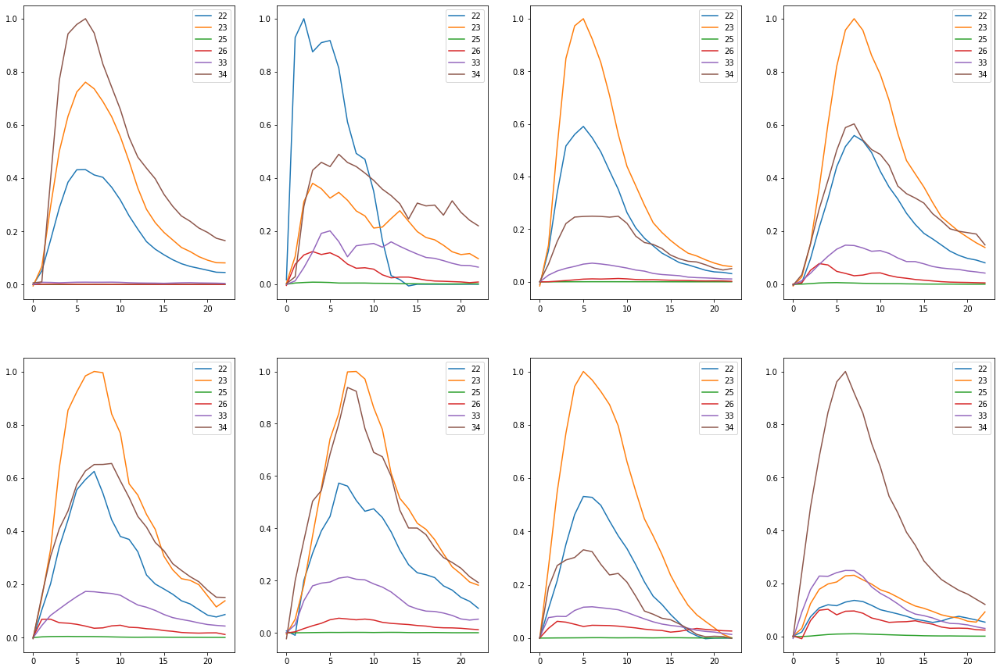

Train on detected  61  non-detected  451
Train time in seconds:  3.2950644493103027


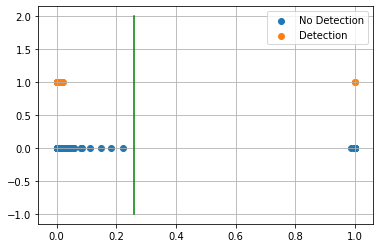

AUC 0.973192541165352
Predicted TPR 0.9508196721311475
Predicted FPR 0.004434589800443459
Threshold 0.25966024
-----------------------End of training---------------------------


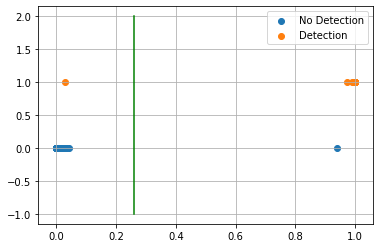

Test on detected  14  non-detected  115
F0.5 92.86%

Confusion Matrix:
True Negative 99.13%
False Positive 0.87%
False Negative 7.14%
True Positive 92.86%

Classification Report
              precision    recall  f1-score   support

       blank      0.991     0.991     0.991       115
    detected      0.929     0.929     0.929        14

    accuracy                          0.984       129
   macro avg      0.960     0.960     0.960       129
weighted avg      0.984     0.984     0.984       129

---------------------------end of testing--------------------------------

Compound ID 3
[20, 47, 49, 50]


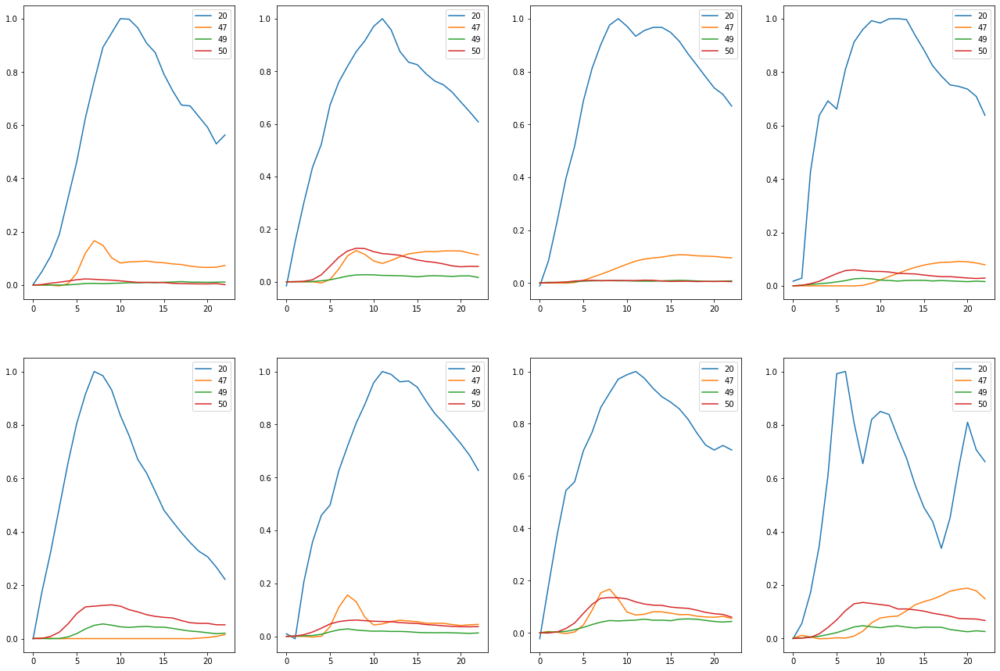

Train on detected  16  non-detected  496
Train time in seconds:  4.123095512390137


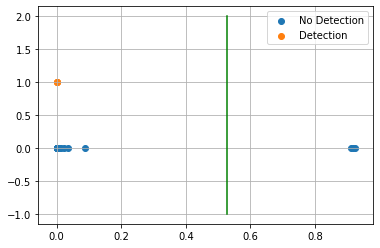

AUC 0.9667338709677419
Predicted TPR 0.9375
Predicted FPR 0.004032258064516129
Threshold 0.5260059
-----------------------End of training---------------------------


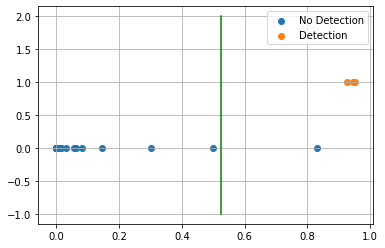

Test on detected  3  non-detected  126
F0.5 78.95%

Confusion Matrix:
True Negative 99.21%
False Positive 0.79%
False Negative 0.00%
True Positive 100.00%

Classification Report
              precision    recall  f1-score   support

       blank      1.000     0.992     0.996       126
    detected      0.750     1.000     0.857         3

    accuracy                          0.992       129
   macro avg      0.875     0.996     0.927       129
weighted avg      0.994     0.992     0.993       129

---------------------------end of testing--------------------------------

Compound ID 4
[2, 11]


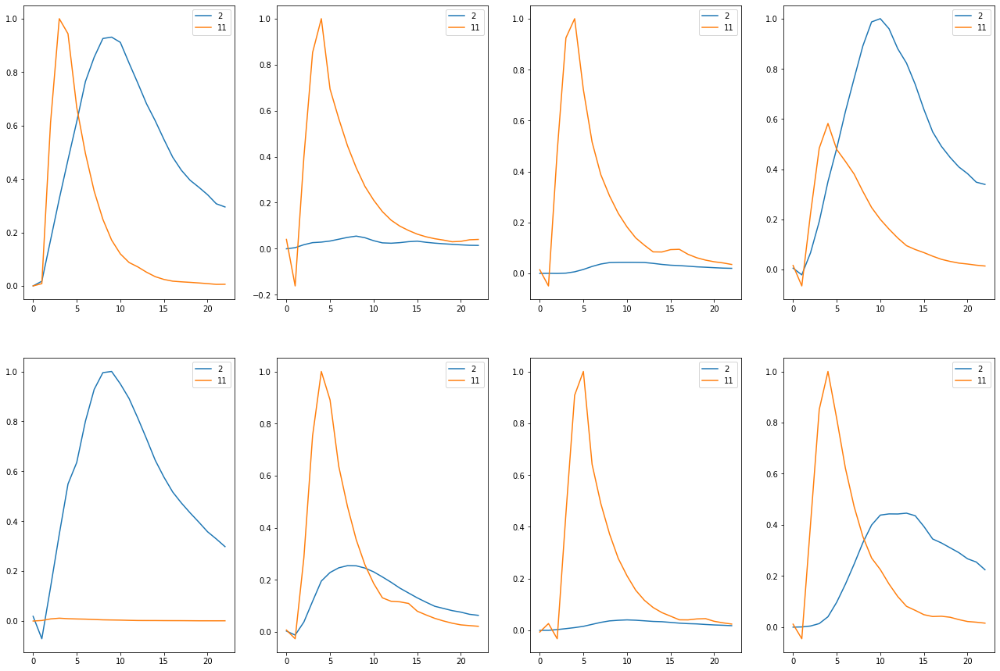

Train on detected  61  non-detected  451
Train time in seconds:  3.562073230743408


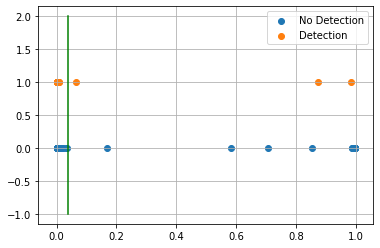

AUC 0.9829340990876377
Predicted TPR 0.9836065573770492
Predicted FPR 0.017738359201773836
Threshold 0.039232463
-----------------------End of training---------------------------


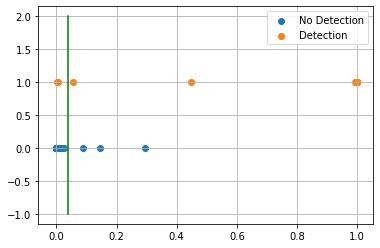

Test on detected  14  non-detected  115
F0.5 81.08%

Confusion Matrix:
True Negative 97.39%
False Positive 2.61%
False Negative 14.29%
True Positive 85.71%

Classification Report
              precision    recall  f1-score   support

       blank      0.982     0.974     0.978       115
    detected      0.800     0.857     0.828        14

    accuracy                          0.961       129
   macro avg      0.891     0.916     0.903       129
weighted avg      0.963     0.961     0.962       129

---------------------------end of testing--------------------------------

Compound ID 7
[16, 18, 27, 30, 46]


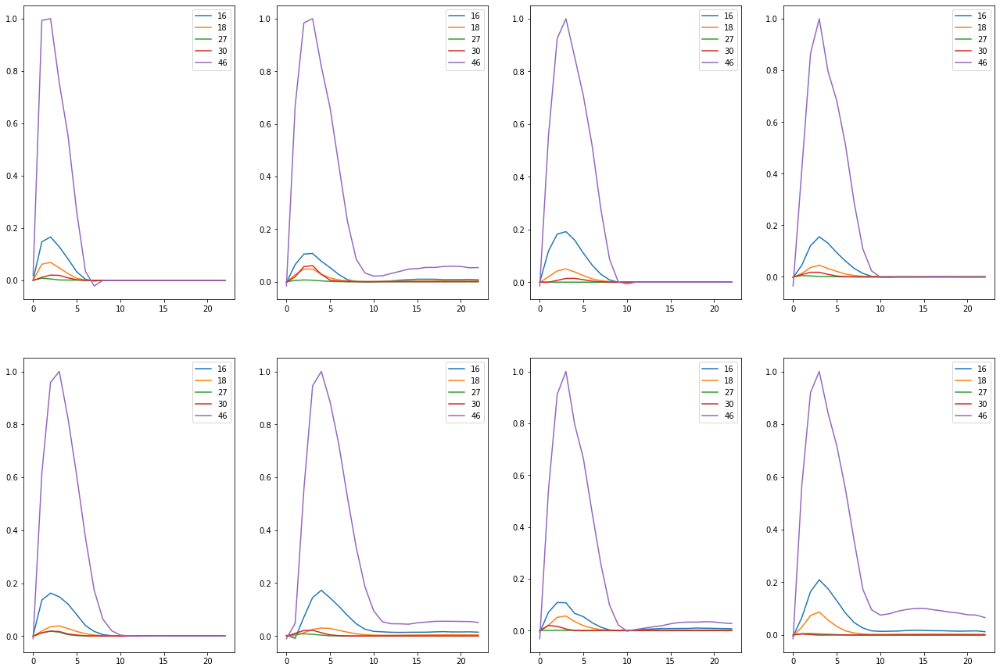

Train on detected  8  non-detected  504
Train time in seconds:  3.519066333770752


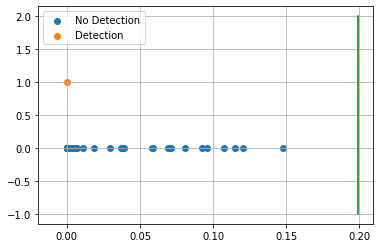

AUC 0.9375
Predicted TPR 0.875
Predicted FPR 0.0
Threshold 0.19901097
-----------------------End of training---------------------------


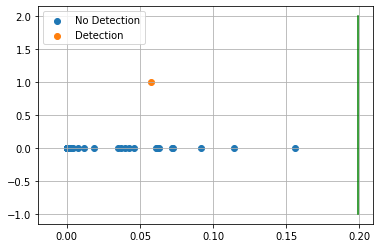

Test on detected  1  non-detected  128
F0.5 0.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 100.00%
True Positive 0.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.992     1.000     0.996       128
    detected      0.000     0.000     0.000         1

    accuracy                          0.992       129
   macro avg      0.496     0.500     0.498       129
weighted avg      0.985     0.992     0.988       129

---------------------------end of testing--------------------------------

Compound ID 8
[16, 18, 39, 46]


C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and bein

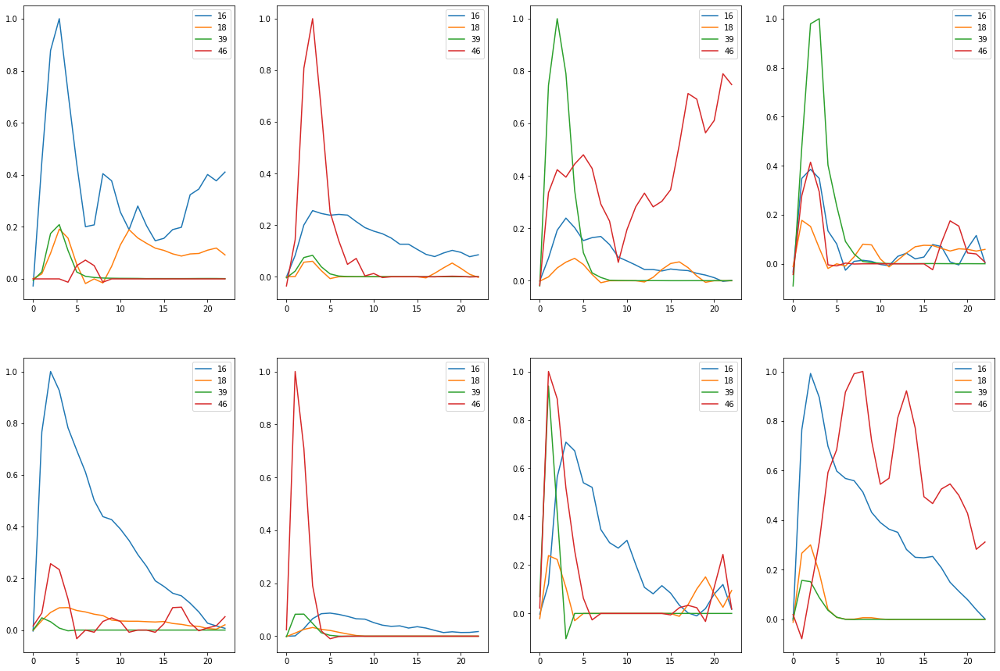

Train on detected  47  non-detected  465
Train time in seconds:  3.894078493118286


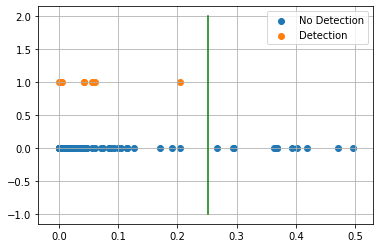

AUC 0.7030885380919697
Predicted TPR 0.425531914893617
Predicted FPR 0.01935483870967742
Threshold 0.25245863
-----------------------End of training---------------------------


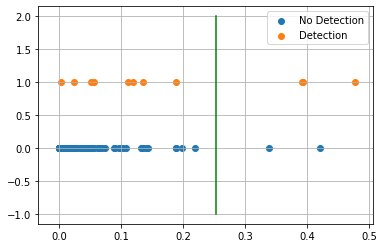

Test on detected  11  non-detected  118
F0.5 48.39%

Confusion Matrix:
True Negative 98.31%
False Positive 1.69%
False Negative 72.73%
True Positive 27.27%

Classification Report
              precision    recall  f1-score   support

       blank      0.935     0.983     0.959       118
    detected      0.600     0.273     0.375        11

    accuracy                          0.922       129
   macro avg      0.768     0.628     0.667       129
weighted avg      0.907     0.922     0.909       129

---------------------------end of testing--------------------------------

Compound ID 10
[0, 3, 4, 19, 20, 22, 23]


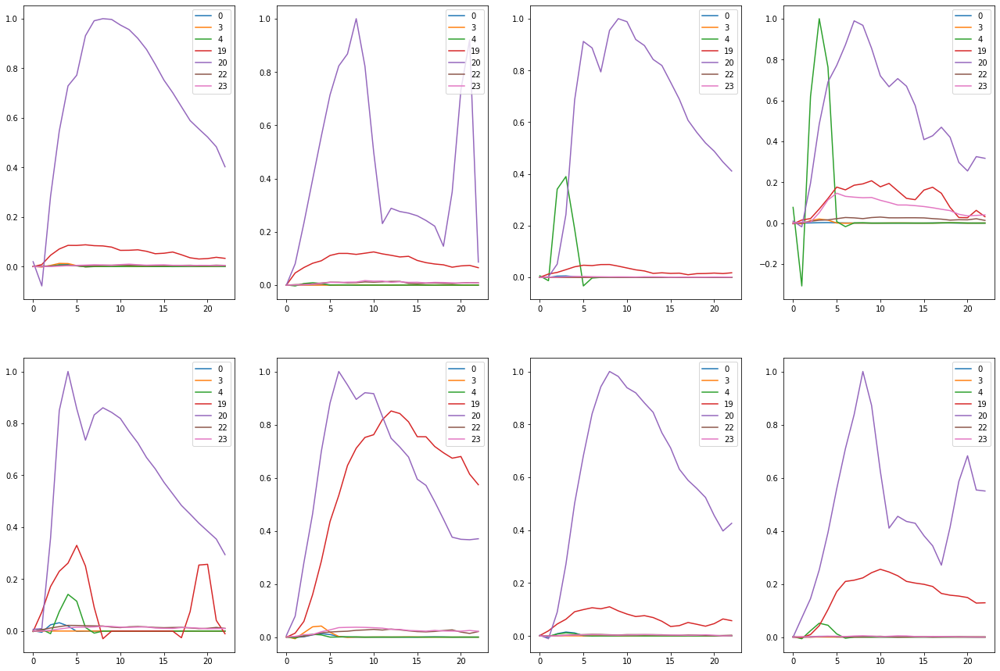

Train on detected  47  non-detected  465
Train time in seconds:  3.7450549602508545


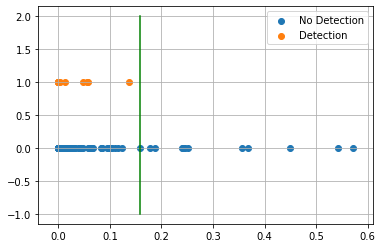

AUC 0.7988332189430337
Predicted TPR 0.6170212765957447
Predicted FPR 0.01935483870967742
Threshold 0.1579926
-----------------------End of training---------------------------


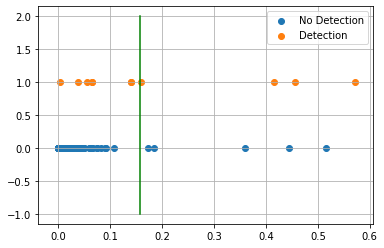

Test on detected  11  non-detected  118
F0.5 42.55%

Confusion Matrix:
True Negative 95.76%
False Positive 4.24%
False Negative 63.64%
True Positive 36.36%

Classification Report
              precision    recall  f1-score   support

       blank      0.942     0.958     0.950       118
    detected      0.444     0.364     0.400        11

    accuracy                          0.907       129
   macro avg      0.693     0.661     0.675       129
weighted avg      0.899     0.907     0.903       129

---------------------------end of testing--------------------------------

Compound ID 13
[41, 42, 46]


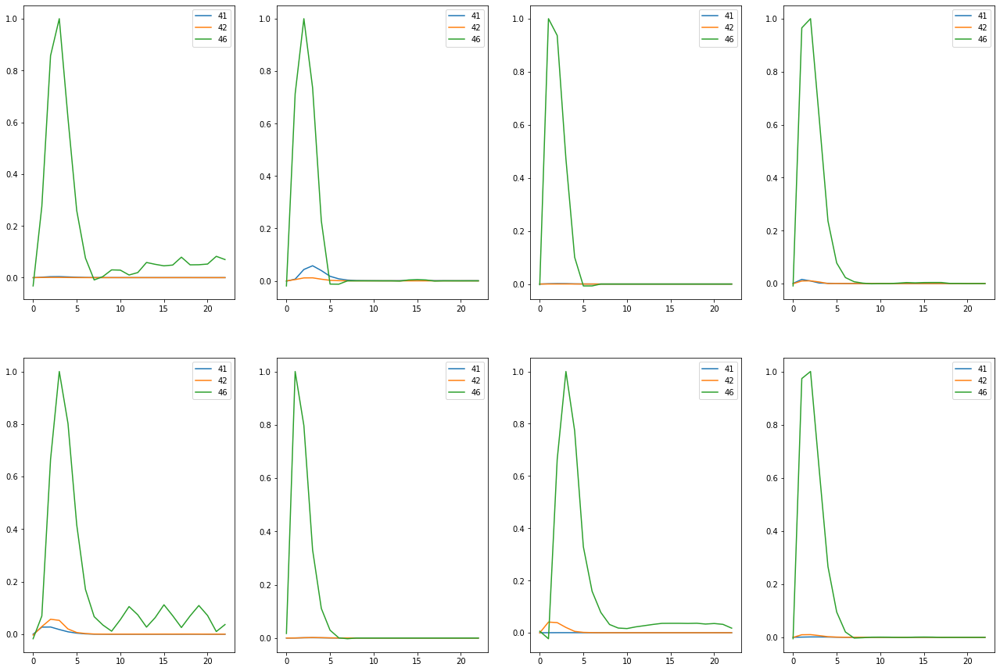

Train on detected  56  non-detected  456
Train time in seconds:  5.184072256088257


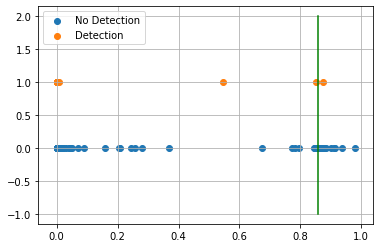

AUC 0.856203007518797
Predicted TPR 0.7321428571428571
Predicted FPR 0.019736842105263157
Threshold 0.85768175
-----------------------End of training---------------------------


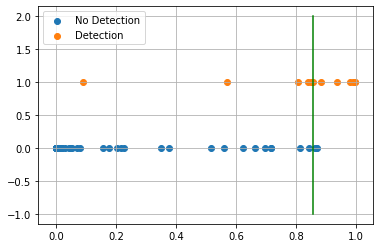

Test on detected  12  non-detected  117
F0.5 62.50%

Confusion Matrix:
True Negative 97.44%
False Positive 2.56%
False Negative 50.00%
True Positive 50.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.950     0.974     0.962       117
    detected      0.667     0.500     0.571        12

    accuracy                          0.930       129
   macro avg      0.808     0.737     0.767       129
weighted avg      0.924     0.930     0.926       129

---------------------------end of testing--------------------------------

Compound ID 14
[16, 18, 46]


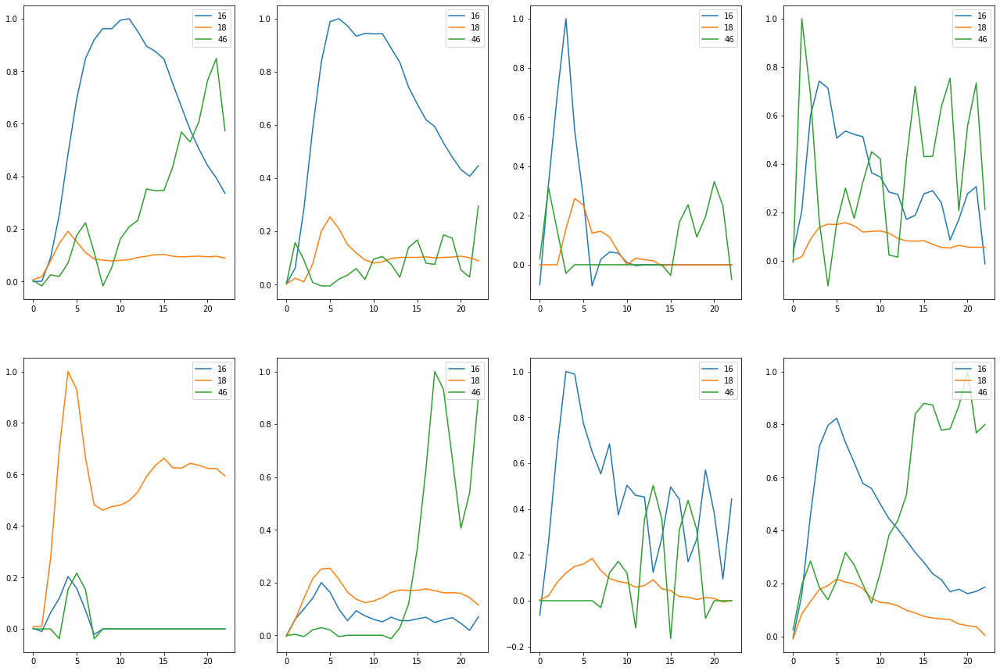

Train on detected  31  non-detected  481
Train time in seconds:  3.7800517082214355


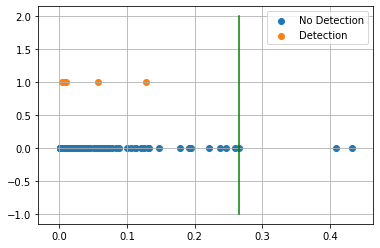

AUC 0.6852323787807659
Predicted TPR 0.3870967741935484
Predicted FPR 0.016632016632016633
Threshold 0.26582313
-----------------------End of training---------------------------


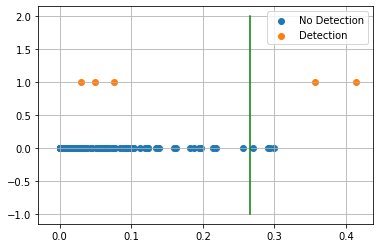

Test on detected  5  non-detected  124
F0.5 34.48%

Confusion Matrix:
True Negative 96.77%
False Positive 3.23%
False Negative 60.00%
True Positive 40.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.976     0.968     0.972       124
    detected      0.333     0.400     0.364         5

    accuracy                          0.946       129
   macro avg      0.654     0.684     0.668       129
weighted avg      0.951     0.946     0.948       129

---------------------------end of testing--------------------------------

Compound ID 15
[36, 39, 46]


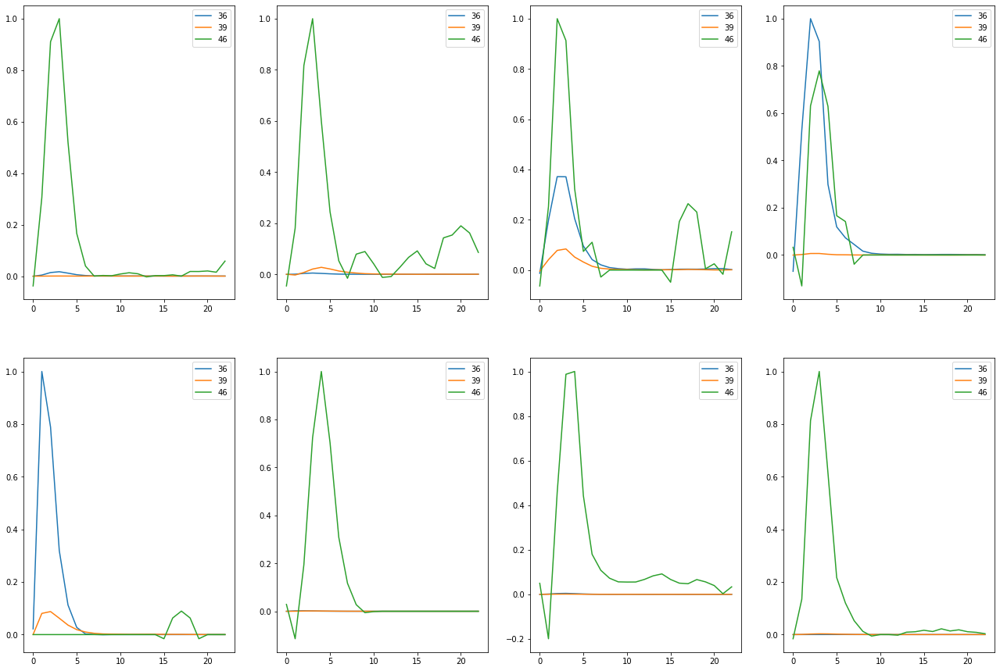

Train on detected  56  non-detected  456
Train time in seconds:  5.998087406158447


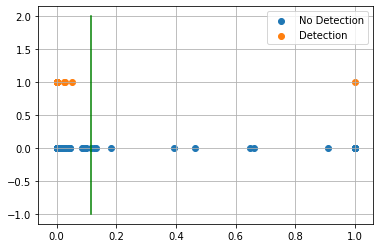

AUC 0.9844924812030075
Predicted TPR 0.9821428571428571
Predicted FPR 0.013157894736842105
Threshold 0.113571286
-----------------------End of training---------------------------


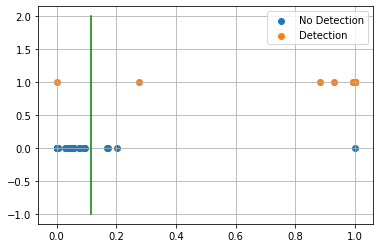

Test on detected  12  non-detected  117
F0.5 76.39%

Confusion Matrix:
True Negative 96.58%
False Positive 3.42%
False Negative 8.33%
True Positive 91.67%

Classification Report
              precision    recall  f1-score   support

       blank      0.991     0.966     0.978       117
    detected      0.733     0.917     0.815        12

    accuracy                          0.961       129
   macro avg      0.862     0.941     0.897       129
weighted avg      0.967     0.961     0.963       129

---------------------------end of testing--------------------------------

Compound ID 18
[19, 20, 21, 40]


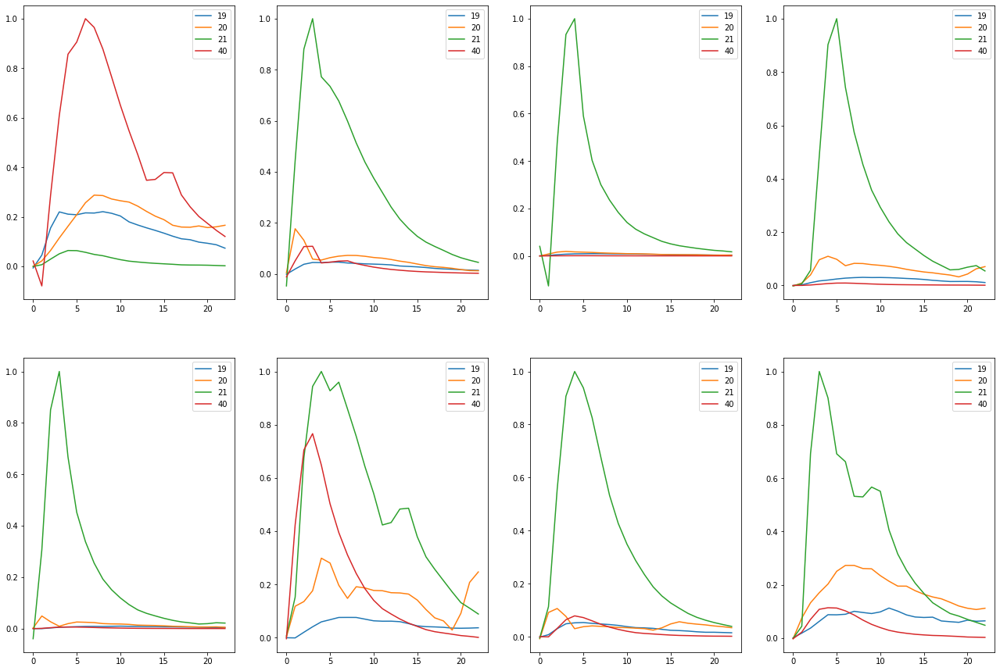

Train on detected  63  non-detected  449
Train time in seconds:  5.1920695304870605


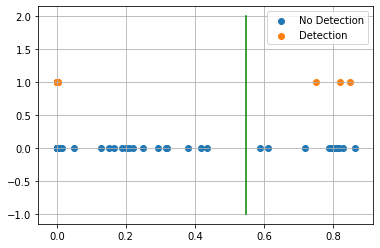

AUC 0.903789726729593
Predicted TPR 0.8253968253968254
Predicted FPR 0.017817371937639197
Threshold 0.5492028
-----------------------End of training---------------------------


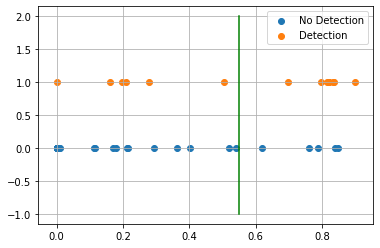

Test on detected  14  non-detected  115
F0.5 60.61%

Confusion Matrix:
True Negative 95.65%
False Positive 4.35%
False Negative 42.86%
True Positive 57.14%

Classification Report
              precision    recall  f1-score   support

       blank      0.948     0.957     0.952       115
    detected      0.615     0.571     0.593        14

    accuracy                          0.915       129
   macro avg      0.782     0.764     0.772       129
weighted avg      0.912     0.915     0.913       129

---------------------------end of testing--------------------------------

Compound ID 19
[7, 8]


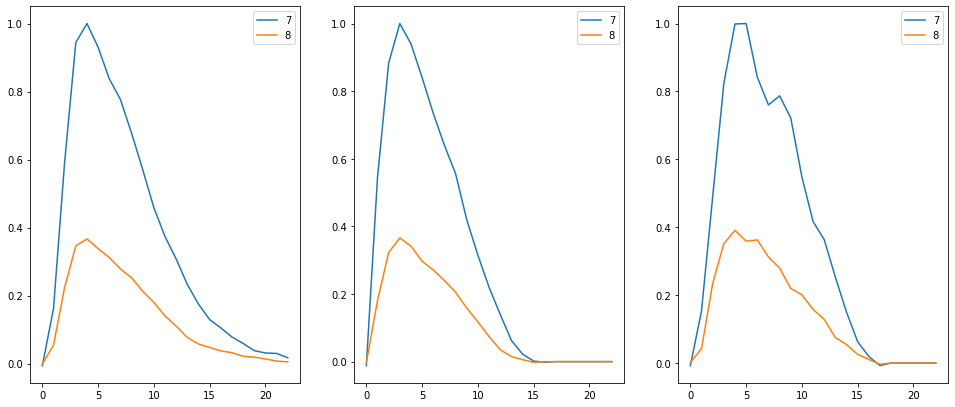

Train on detected  3  non-detected  509
Train time in seconds:  4.134056091308594


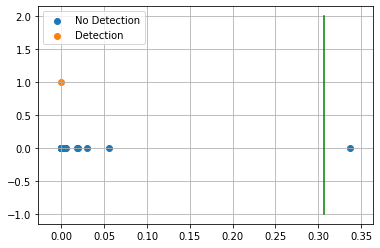

AUC 1.0
Predicted TPR 1.0
Predicted FPR 0.0
Threshold 0.30616772
-----------------------End of training---------------------------


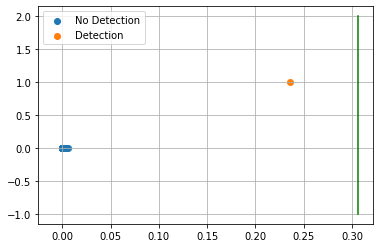

Test on detected  1  non-detected  128
F0.5 0.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 100.00%
True Positive 0.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.992     1.000     0.996       128
    detected      0.000     0.000     0.000         1

    accuracy                          0.992       129
   macro avg      0.496     0.500     0.498       129
weighted avg      0.985     0.992     0.988       129

---------------------------end of testing--------------------------------

Compound ID 21
[22, 23, 25, 26, 33, 34]


C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and bein

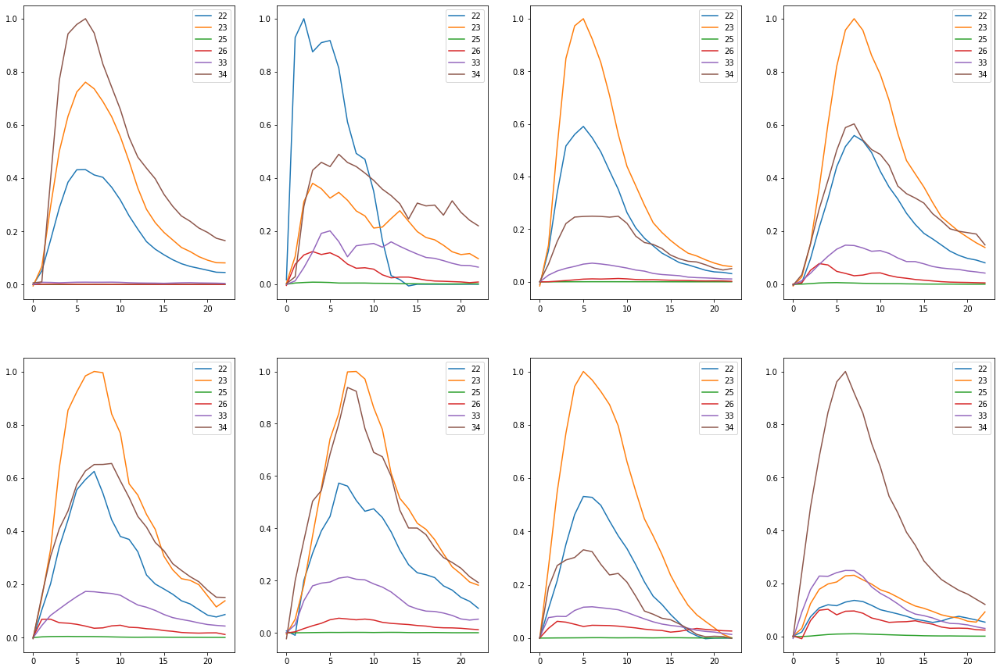

Train on detected  61  non-detected  451
Train time in seconds:  5.095070123672485


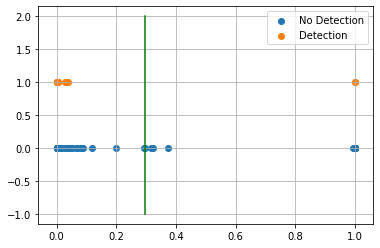

AUC 0.9665406564646868
Predicted TPR 0.9508196721311475
Predicted FPR 0.017738359201773836
Threshold 0.29730058
-----------------------End of training---------------------------


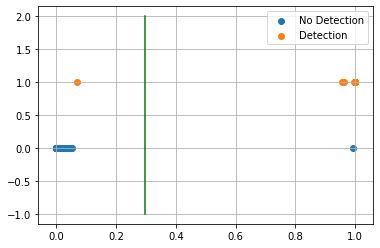

Test on detected  14  non-detected  115
F0.5 92.86%

Confusion Matrix:
True Negative 99.13%
False Positive 0.87%
False Negative 7.14%
True Positive 92.86%

Classification Report
              precision    recall  f1-score   support

       blank      0.991     0.991     0.991       115
    detected      0.929     0.929     0.929        14

    accuracy                          0.984       129
   macro avg      0.960     0.960     0.960       129
weighted avg      0.984     0.984     0.984       129

---------------------------end of testing--------------------------------

Compound ID 22
[35, 37, 38]


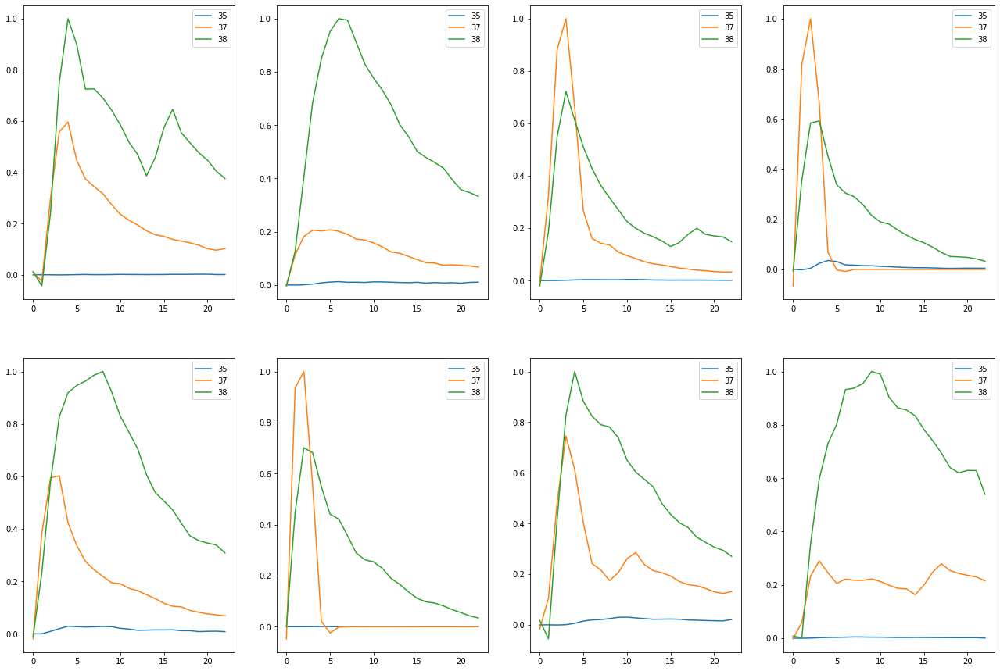

Train on detected  65  non-detected  447
Train time in seconds:  4.396059513092041


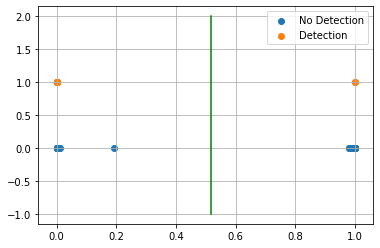

AUC 1.0
Predicted TPR 1.0
Predicted FPR 0.0
Threshold 0.51709247
-----------------------End of training---------------------------


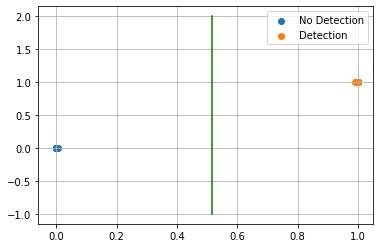

Test on detected  14  non-detected  115
F0.5 100.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 0.00%
True Positive 100.00%

Classification Report
              precision    recall  f1-score   support

       blank      1.000     1.000     1.000       115
    detected      1.000     1.000     1.000        14

    accuracy                          1.000       129
   macro avg      1.000     1.000     1.000       129
weighted avg      1.000     1.000     1.000       129

---------------------------end of testing--------------------------------


In [21]:
#Add filtering to original data

#initialize
mass_pair_ids_to_window_size = dict()
for mass_pair_id in range(max_mass_pair_count):
    mass_pair_ids_to_window_size[mass_pair_id] = 5

compound_id_to_filtered_results = dict()
for compound_id, mass_pair_ids_to_dataset in compound_ids_to_mass_pair_ids_to_dataset.items():
    print()
    print("Compound ID", compound_id)
    model, testset, predicted_tpr, predicted_fpr, threshold, auc_score = build_train_model_with_filter(mass_pair_ids_to_dataset, mass_pair_ids_to_window_size)
    tpr, fpr = test_model_and_output_results(model, testset, threshold)
    compound_id_to_filtered_results[compound_id] = predicted_tpr, predicted_fpr, threshold, auc_score, tpr, fpr

In [22]:
print("Original")
print(original_results_dataframe.to_string(index=False, justify='center'))
print()
print("Filtered")
filtered_results_dataframe = compound_id_results_to_dataframe(compound_id_to_filtered_results)

print(filtered_results_dataframe.to_string(index=False, justify='center'))

Original
 Compounds  Tr-TPR  Tr-FPR Threshold ROC AUC Score Test-TPR Test-FPR
     0       95.08%  0.44%   22.68%       97.32%     92.86%   0.87% 
     3       93.75%  1.01%    6.45%       96.37%    100.00%   3.97% 
     4      100.00%  0.89%   55.19%       99.56%     92.86%   0.87% 
     7      100.00%  0.99%   14.10%       99.50%      0.00%   1.56% 
     8       48.94%  1.08%   33.15%       73.93%     27.27%   1.69% 
    10       95.74%  0.65%   78.00%       97.55%     72.73%   2.54% 
    13       98.21%  1.32%   70.68%       98.45%     83.33%   1.71% 
    14       35.48%  1.66%   14.83%       66.91%     40.00%   4.03% 
    15       26.79%  1.97%   47.93%       62.41%     50.00%   0.00% 
    18       77.78%  1.78%   68.28%       88.00%     57.14%   5.22% 
    19      100.00%  0.00%   43.91%      100.00%      0.00%   0.00% 
    21       95.08%  0.89%   63.75%       97.10%     92.86%   1.74% 
    22      100.00%  0.00%   95.40%      100.00%    100.00%   0.00% 

Filtered
 Compounds  Tr-

Interesting, compounds 4, 10, 13 and 21 do worse and compounds 8, 14, and 15 do better. Mass pairs 16, 18, 46 tend to be very volatile with lots of apparent noise. If I just apply filtering to those compounds I would be interested to see what happens.


Compound ID 8
[16, 18, 39, 46]


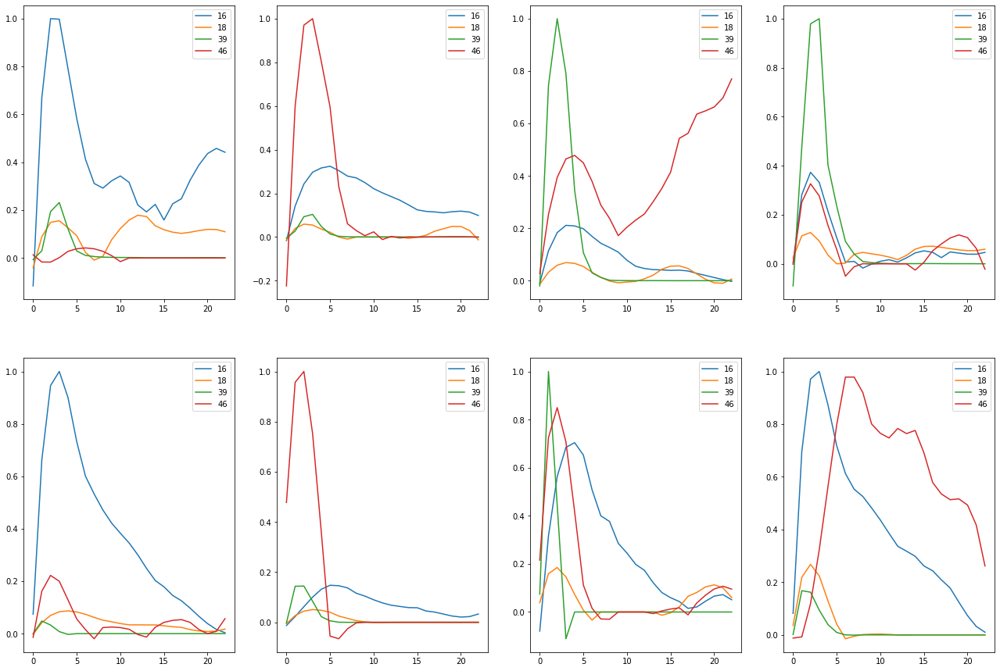

Train on detected  47  non-detected  465
Train time in seconds:  4.843068599700928


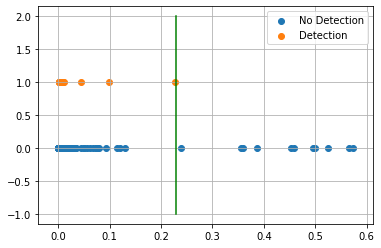

AUC 0.735003431708991
Predicted TPR 0.48936170212765956
Predicted FPR 0.01935483870967742
Threshold 0.2299532
-----------------------End of training---------------------------


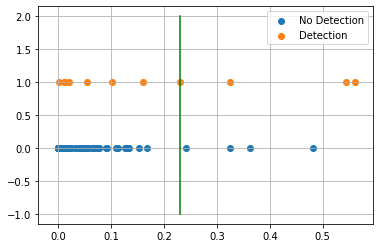

Test on detected  11  non-detected  118
F0.5 46.51%

Confusion Matrix:
True Negative 96.61%
False Positive 3.39%
False Negative 63.64%
True Positive 36.36%

Classification Report
              precision    recall  f1-score   support

       blank      0.942     0.966     0.954       118
    detected      0.500     0.364     0.421        11

    accuracy                          0.915       129
   macro avg      0.721     0.665     0.688       129
weighted avg      0.904     0.915     0.909       129

---------------------------end of testing--------------------------------

Compound ID 13
[41, 42, 46]


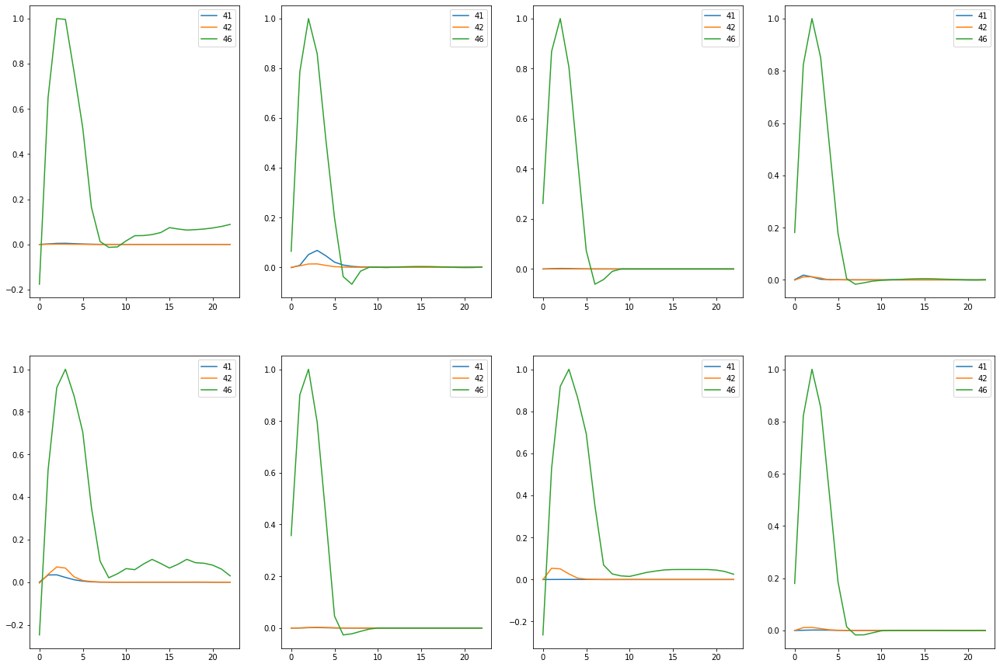

Train on detected  56  non-detected  456
Train time in seconds:  5.943085670471191


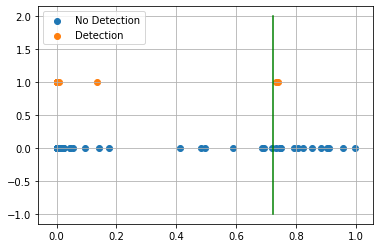

AUC 0.930921052631579
Predicted TPR 0.875
Predicted FPR 0.013157894736842105
Threshold 0.72416127
-----------------------End of training---------------------------


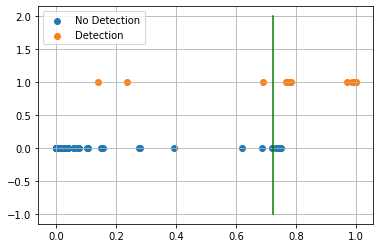

Test on detected  12  non-detected  117
F0.5 75.00%

Confusion Matrix:
True Negative 97.44%
False Positive 2.56%
False Negative 25.00%
True Positive 75.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.974     0.974     0.974       117
    detected      0.750     0.750     0.750        12

    accuracy                          0.953       129
   macro avg      0.862     0.862     0.862       129
weighted avg      0.953     0.953     0.953       129

---------------------------end of testing--------------------------------

Compound ID 15
[36, 39, 46]


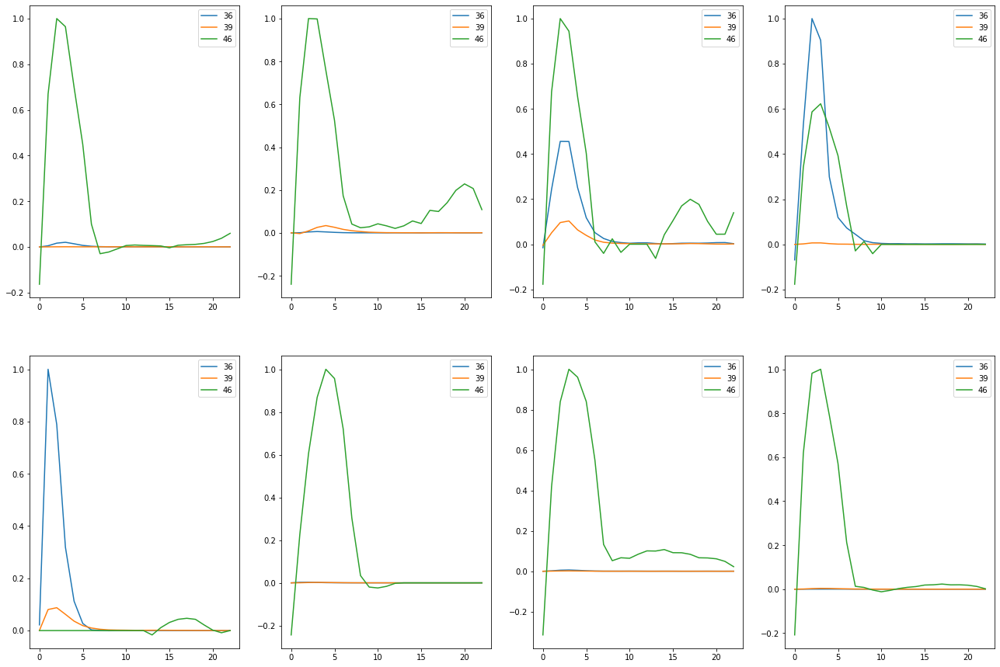

Train on detected  56  non-detected  456
Train time in seconds:  7.501119375228882


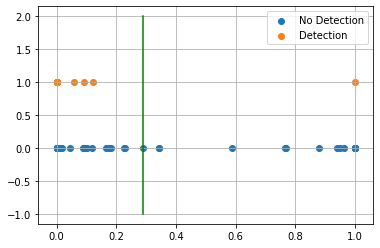

AUC 0.9844924812030075
Predicted TPR 0.9821428571428571
Predicted FPR 0.013157894736842105
Threshold 0.2896914
-----------------------End of training---------------------------


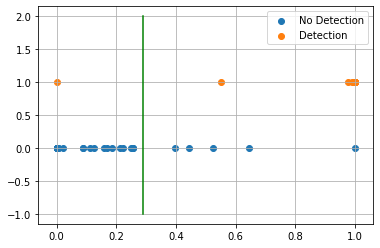

Test on detected  12  non-detected  117
F0.5 72.37%

Confusion Matrix:
True Negative 95.73%
False Positive 4.27%
False Negative 8.33%
True Positive 91.67%

Classification Report
              precision    recall  f1-score   support

       blank      0.991     0.957     0.974       117
    detected      0.688     0.917     0.786        12

    accuracy                          0.953       129
   macro avg      0.839     0.937     0.880       129
weighted avg      0.963     0.953     0.956       129

---------------------------end of testing--------------------------------
 Compounds  Tr-TPR Tr-FPR Threshold ROC AUC Score Test-TPR Test-FPR
     8      48.94%  1.94%   23.00%      73.50%     36.36%    3.39% 
    13      87.50%  1.32%   72.42%      93.09%     75.00%    2.56% 
    15      98.21%  1.32%   28.97%      98.45%     91.67%    4.27% 


In [23]:
#search
#initialize
mass_pair_ids_to_window_size = dict()
for mass_pair_id in range(max_mass_pair_count):
    mass_pair_ids_to_window_size[mass_pair_id] = 5
mass_pair_ids_to_window_size[16] = 9
mass_pair_ids_to_window_size[18] = 9
mass_pair_ids_to_window_size[46] = 9

# check compounds using above mass pairs
mini_compound_id_to_filtered_results = dict()
for compound_id in [8, 13, 15]:
    mass_pair_ids_to_dataset = compound_ids_to_mass_pair_ids_to_dataset[compound_id]
    print()
    print("Compound ID", compound_id)
    model, testset, predicted_tpr, predicted_fpr, threshold, auc_score = build_train_model_with_filter(mass_pair_ids_to_dataset, mass_pair_ids_to_window_size)
    tpr, fpr = test_model_and_output_results(model, testset, threshold)
    mini_compound_id_to_filtered_results[compound_id] = predicted_tpr, predicted_fpr, threshold, auc_score, tpr, fpr
    
mini_filtered_results_dataframe = compound_id_results_to_dataframe(mini_compound_id_to_filtered_results)

print(mini_filtered_results_dataframe.to_string(index=False, justify='center'))

Compound 8 was the only one that got better. I wonder if I remove mass pairs that are adding noise to our graphs if that will help stabilize our results. Also I will try adding mass pairs that are shared across compounds to see if that can help differentiate compounds. For example compound 8 and 15 share mass pairs. After adjusting mass pairs it may be worth revisiting mass pair filtering.

{-1: [0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38,
  39,
  40,
  41,
  42,
  43,
  44,
  45,
  46,
  47,
  48,
  49,
  50],
 0: [22, 23],
 3: [47, 49, 50],
 4: [2, 11],
 8: [36, 39, 46],
 10: [0, 3, 4],
 13: [41, 42],
 14: [16, 18],
 15: [36, 39],
 18: [21, 40],
 21: [33, 34],
 22: [35, 37, 38]}


Compound ID 0
[22, 23]


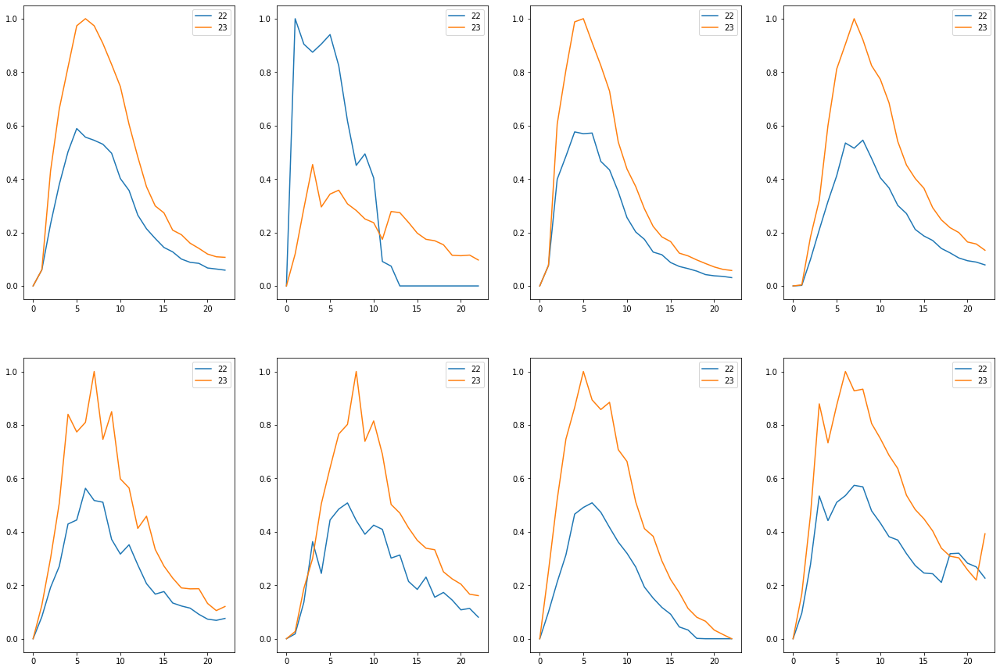

Train on detected  61  non-detected  451
Train time in seconds:  5.5610785484313965


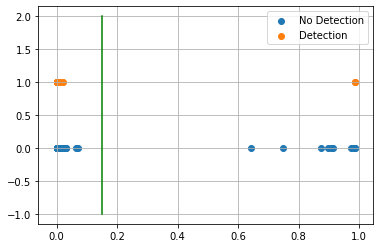

AUC 0.9486023772309258
Predicted TPR 0.9016393442622951
Predicted FPR 0.004434589800443459
Threshold 0.15015265345573425
-----------------------End of training---------------------------


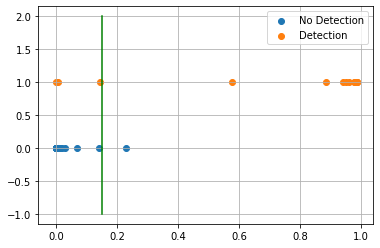

Test on detected  14  non-detected  115
F0.5 88.71%

Confusion Matrix:
True Negative 99.13%
False Positive 0.87%
False Negative 21.43%
True Positive 78.57%

Classification Report
              precision    recall  f1-score   support

       blank      0.974     0.991     0.983       115
    detected      0.917     0.786     0.846        14

    accuracy                          0.969       129
   macro avg      0.946     0.889     0.914       129
weighted avg      0.968     0.969     0.968       129

---------------------------end of testing--------------------------------

Compound ID 3
[47, 49, 50]


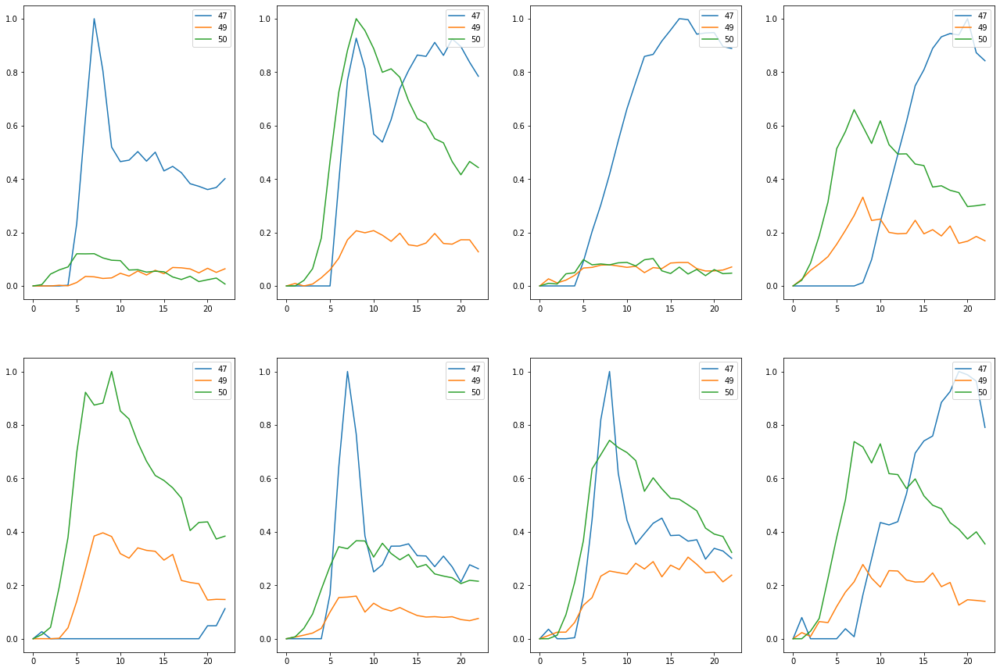

Train on detected  16  non-detected  496
Train time in seconds:  5.167074680328369


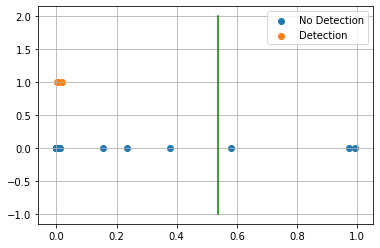

AUC 0.967741935483871
Predicted TPR 0.9375
Predicted FPR 0.0020161290322580645
Threshold 0.5379987359046936
-----------------------End of training---------------------------


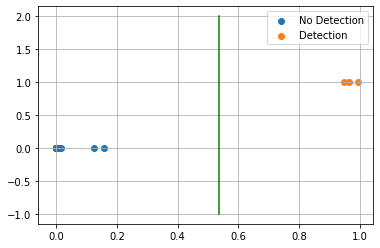

Test on detected  3  non-detected  126
F0.5 100.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 0.00%
True Positive 100.00%

Classification Report
              precision    recall  f1-score   support

       blank      1.000     1.000     1.000       126
    detected      1.000     1.000     1.000         3

    accuracy                          1.000       129
   macro avg      1.000     1.000     1.000       129
weighted avg      1.000     1.000     1.000       129

---------------------------end of testing--------------------------------

Compound ID 4
[2, 11]


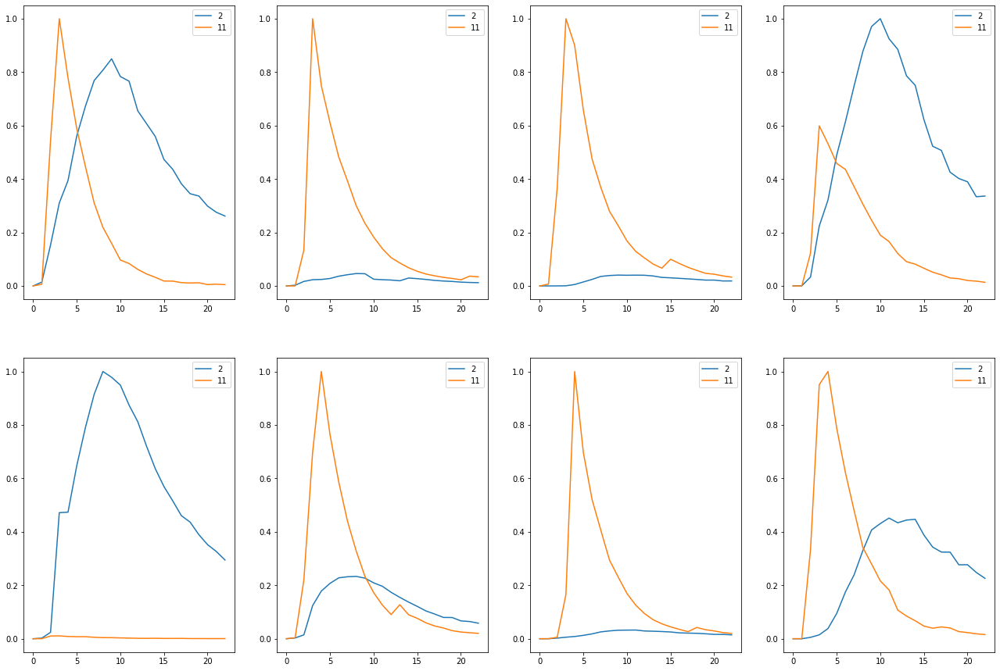

Train on detected  61  non-detected  451
Train time in seconds:  6.296090364456177


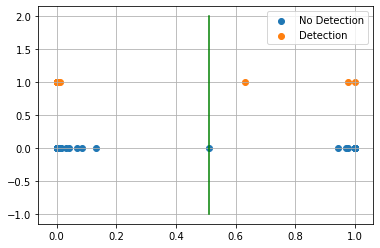

AUC 0.9977827050997783
Predicted TPR 1.0
Predicted FPR 0.004434589800443459
Threshold 0.5117723345756531
-----------------------End of training---------------------------


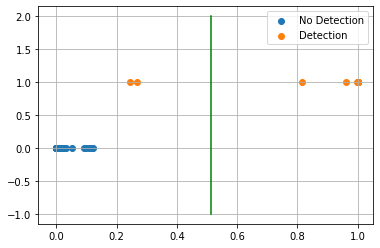

Test on detected  14  non-detected  115
F0.5 96.77%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 14.29%
True Positive 85.71%

Classification Report
              precision    recall  f1-score   support

       blank      0.983     1.000     0.991       115
    detected      1.000     0.857     0.923        14

    accuracy                          0.984       129
   macro avg      0.991     0.929     0.957       129
weighted avg      0.985     0.984     0.984       129

---------------------------end of testing--------------------------------

Compound ID 8
[36, 39, 46]


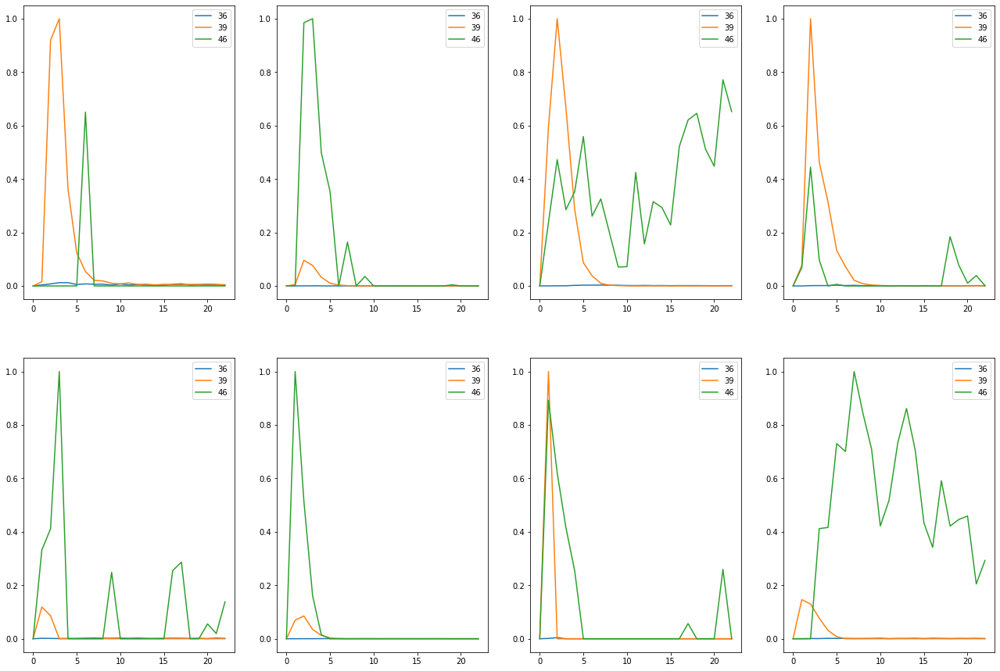

Train on detected  47  non-detected  465
Train time in seconds:  4.840033531188965


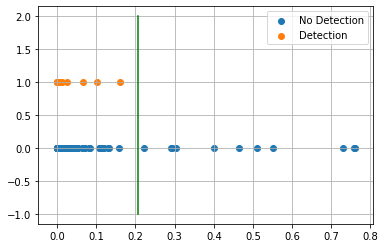

AUC 0.85309997712194
Predicted TPR 0.723404255319149
Predicted FPR 0.017204301075268817
Threshold 0.2071990966796875
-----------------------End of training---------------------------


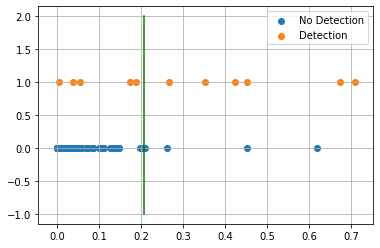

Test on detected  11  non-detected  118
F0.5 58.82%

Confusion Matrix:
True Negative 96.61%
False Positive 3.39%
False Negative 45.45%
True Positive 54.55%

Classification Report
              precision    recall  f1-score   support

       blank      0.958     0.966     0.962       118
    detected      0.600     0.545     0.571        11

    accuracy                          0.930       129
   macro avg      0.779     0.756     0.767       129
weighted avg      0.927     0.930     0.929       129

---------------------------end of testing--------------------------------

Compound ID 10
[0, 3, 4]


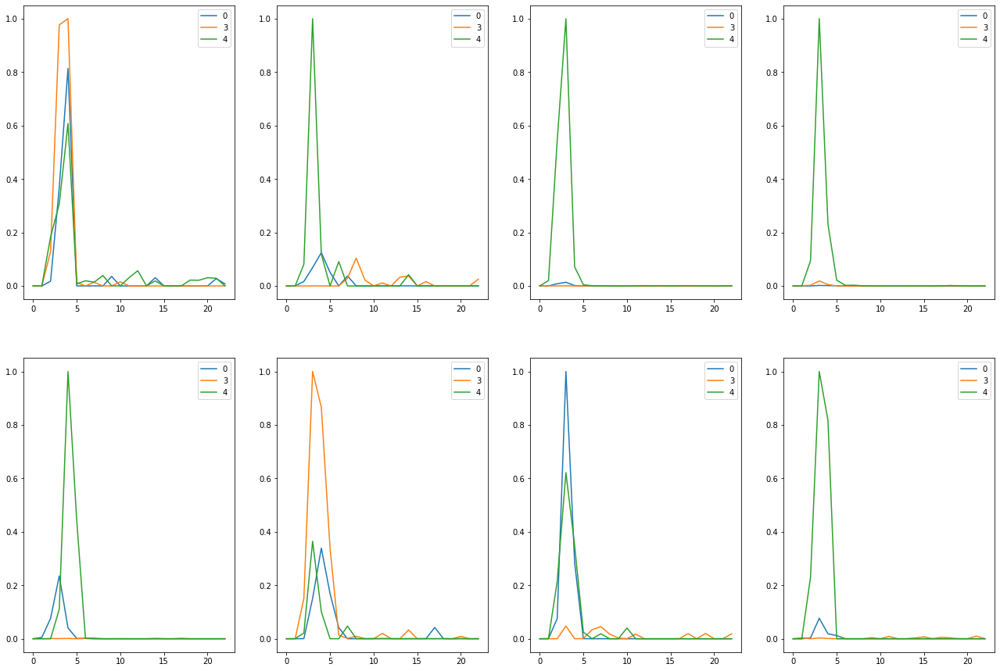

Train on detected  47  non-detected  465
Train time in seconds:  5.173075437545776


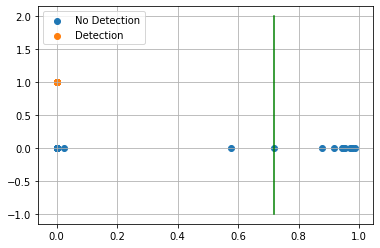

AUC 1.0
Predicted TPR 1.0
Predicted FPR 0.0
Threshold 0.7188001275062561
-----------------------End of training---------------------------


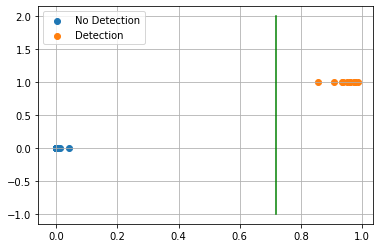

Test on detected  11  non-detected  118
F0.5 100.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 0.00%
True Positive 100.00%

Classification Report
              precision    recall  f1-score   support

       blank      1.000     1.000     1.000       118
    detected      1.000     1.000     1.000        11

    accuracy                          1.000       129
   macro avg      1.000     1.000     1.000       129
weighted avg      1.000     1.000     1.000       129

---------------------------end of testing--------------------------------

Compound ID 13
[41, 42]


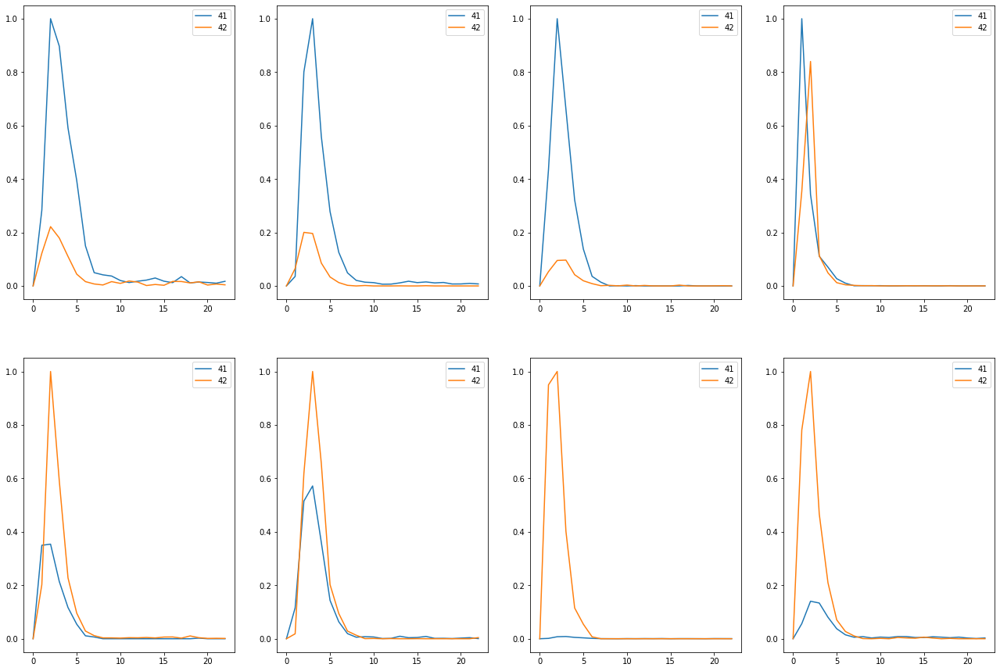

Train on detected  56  non-detected  456
Train time in seconds:  5.754079341888428


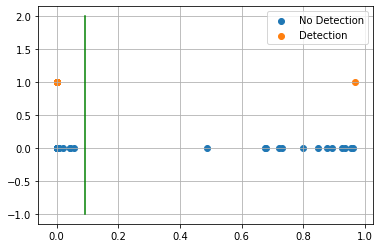

AUC 0.9733709273182958
Predicted TPR 0.9642857142857143
Predicted FPR 0.017543859649122806
Threshold 0.09207090735435486
-----------------------End of training---------------------------


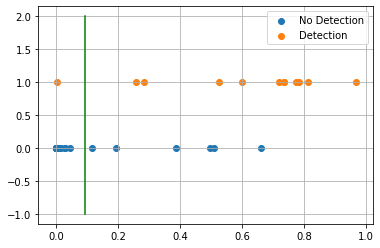

Test on detected  12  non-detected  117
F0.5 68.75%

Confusion Matrix:
True Negative 94.87%
False Positive 5.13%
False Negative 8.33%
True Positive 91.67%

Classification Report
              precision    recall  f1-score   support

       blank      0.991     0.949     0.969       117
    detected      0.647     0.917     0.759        12

    accuracy                          0.946       129
   macro avg      0.819     0.933     0.864       129
weighted avg      0.959     0.946     0.950       129

---------------------------end of testing--------------------------------

Compound ID 14
[16, 18]


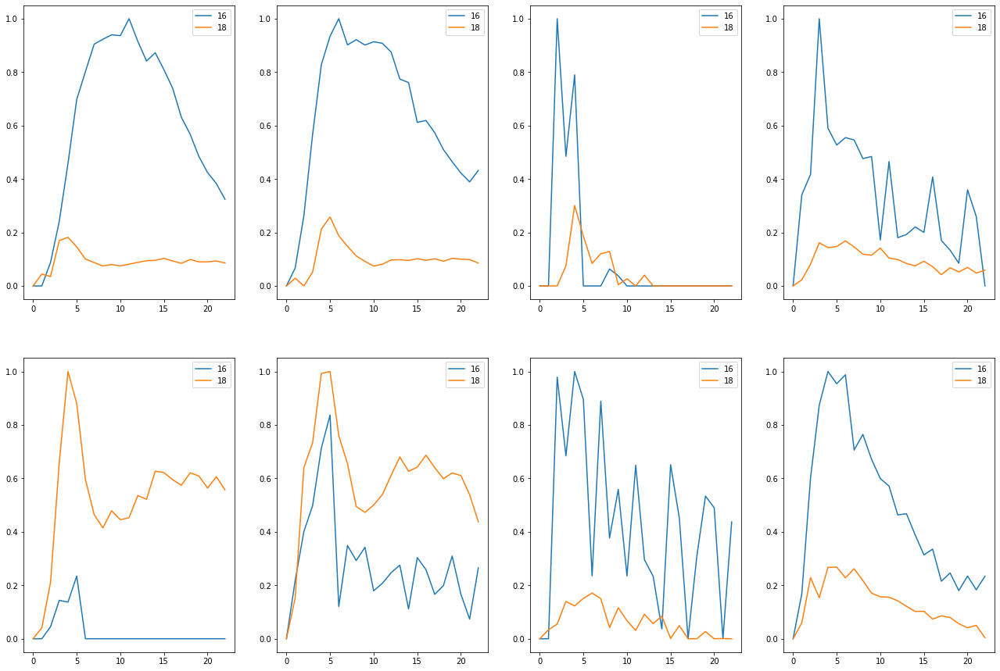

Train on detected  31  non-detected  481
Train time in seconds:  5.043084144592285


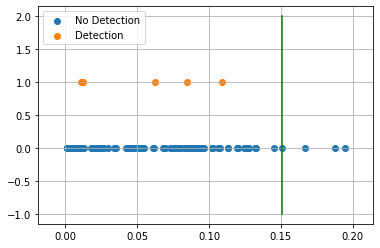

AUC 0.6077057206089465
Predicted TPR 0.22580645161290322
Predicted FPR 0.010395010395010396
Threshold 0.1506284773349762
-----------------------End of training---------------------------


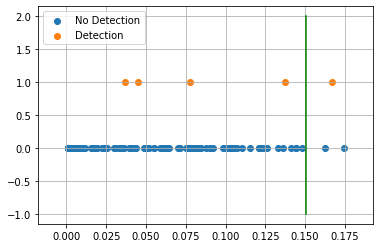

Test on detected  5  non-detected  124
F0.5 29.41%

Confusion Matrix:
True Negative 98.39%
False Positive 1.61%
False Negative 80.00%
True Positive 20.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.968     0.984     0.976       124
    detected      0.333     0.200     0.250         5

    accuracy                          0.953       129
   macro avg      0.651     0.592     0.613       129
weighted avg      0.944     0.953     0.948       129

---------------------------end of testing--------------------------------

Compound ID 15
[36, 39]


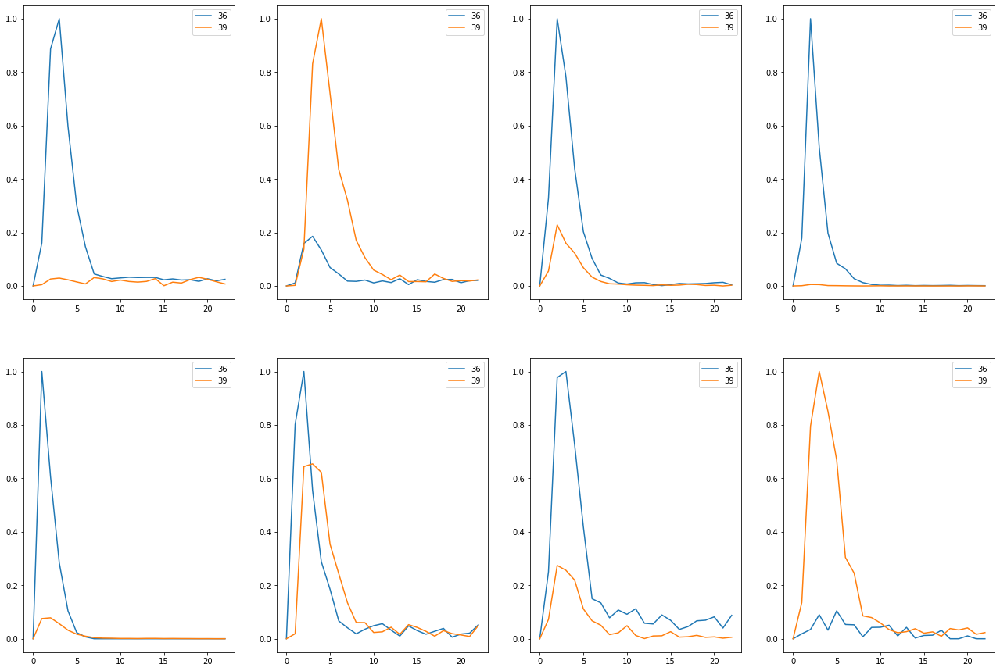

Train on detected  56  non-detected  456
Train time in seconds:  6.039087295532227


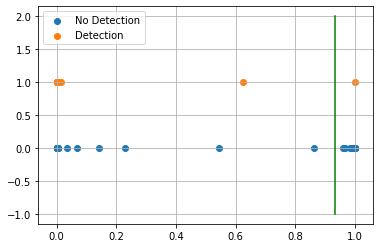

AUC 0.9978070175438596
Predicted TPR 1.0
Predicted FPR 0.0043859649122807015
Threshold 0.9313919544219971
-----------------------End of training---------------------------


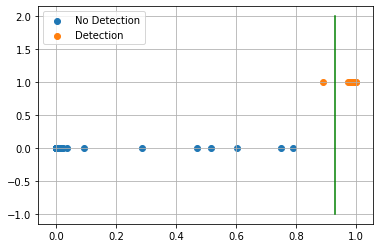

Test on detected  12  non-detected  117
F0.5 98.21%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 8.33%
True Positive 91.67%

Classification Report
              precision    recall  f1-score   support

       blank      0.992     1.000     0.996       117
    detected      1.000     0.917     0.957        12

    accuracy                          0.992       129
   macro avg      0.996     0.958     0.976       129
weighted avg      0.992     0.992     0.992       129

---------------------------end of testing--------------------------------

Compound ID 18
[21, 40]


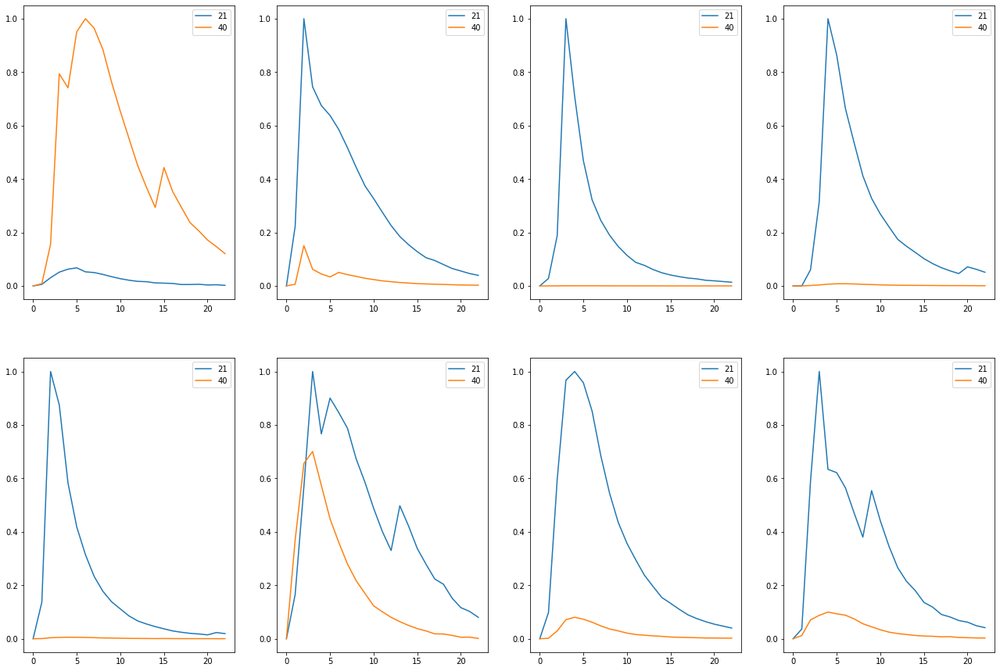

Train on detected  63  non-detected  449
Train time in seconds:  6.627058029174805


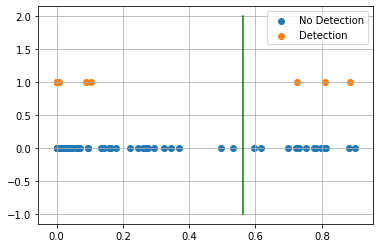

AUC 0.911726234666101
Predicted TPR 0.8412698412698413
Predicted FPR 0.017817371937639197
Threshold 0.5609434843063354
-----------------------End of training---------------------------


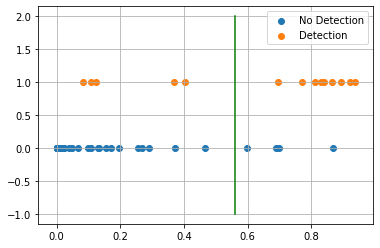

Test on detected  14  non-detected  115
F0.5 68.18%

Confusion Matrix:
True Negative 96.52%
False Positive 3.48%
False Negative 35.71%
True Positive 64.29%

Classification Report
              precision    recall  f1-score   support

       blank      0.957     0.965     0.961       115
    detected      0.692     0.643     0.667        14

    accuracy                          0.930       129
   macro avg      0.825     0.804     0.814       129
weighted avg      0.928     0.930     0.929       129

---------------------------end of testing--------------------------------

Compound ID 21
[33, 34]


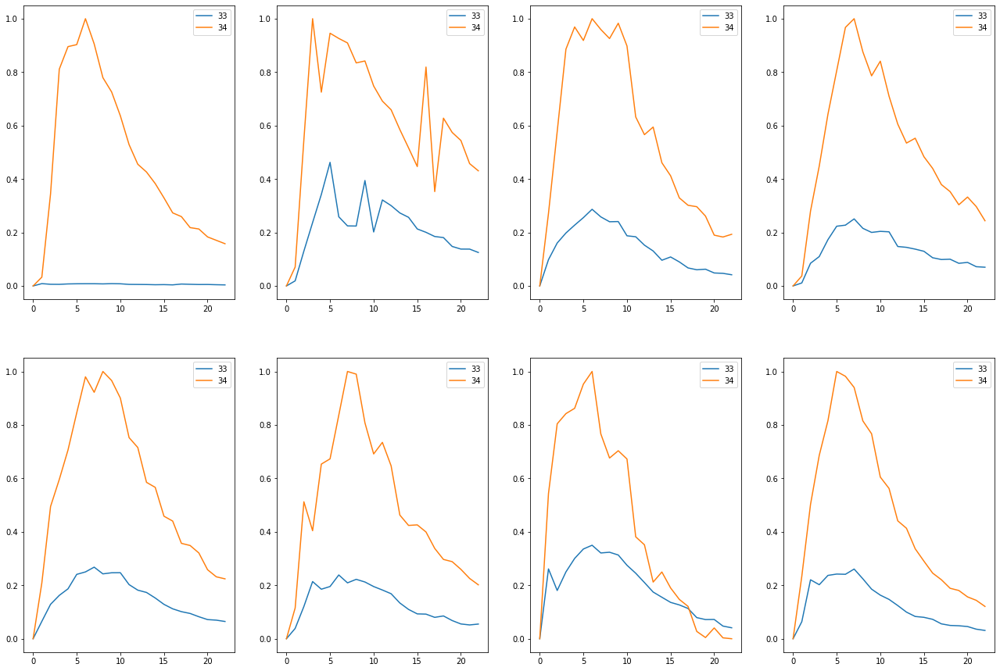

Train on detected  61  non-detected  451
Train time in seconds:  7.504150867462158


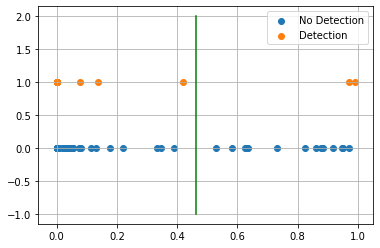

AUC 0.9523645087419579
Predicted TPR 0.9180327868852459
Predicted FPR 0.013303769401330377
Threshold 0.46144577860832214
-----------------------End of training---------------------------


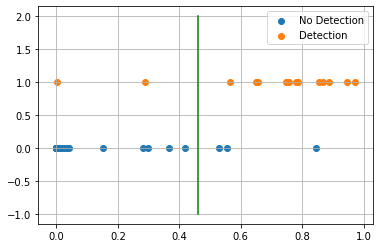

Test on detected  14  non-detected  115
F0.5 81.08%

Confusion Matrix:
True Negative 97.39%
False Positive 2.61%
False Negative 14.29%
True Positive 85.71%

Classification Report
              precision    recall  f1-score   support

       blank      0.982     0.974     0.978       115
    detected      0.800     0.857     0.828        14

    accuracy                          0.961       129
   macro avg      0.891     0.916     0.903       129
weighted avg      0.963     0.961     0.962       129

---------------------------end of testing--------------------------------

Compound ID 22
[35, 37, 38]


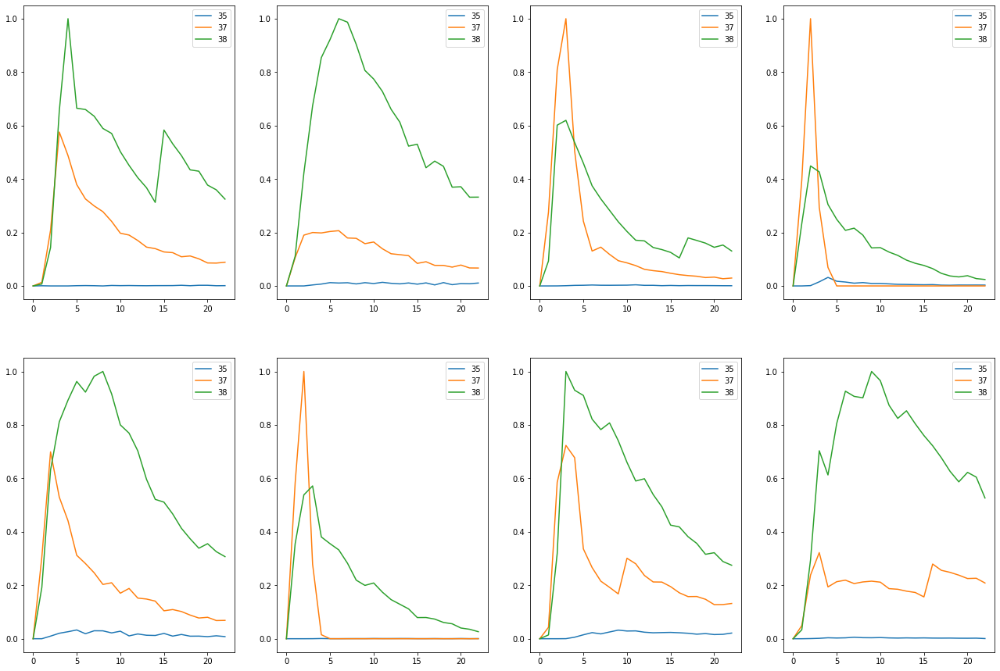

Train on detected  65  non-detected  447
Train time in seconds:  5.576079368591309


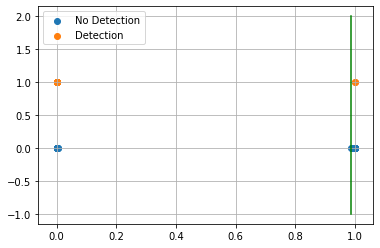

AUC 1.0
Predicted TPR 1.0
Predicted FPR 0.0
Threshold 0.9849526882171631
-----------------------End of training---------------------------


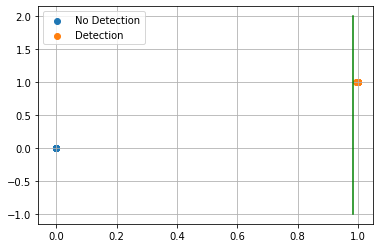

Test on detected  14  non-detected  115
F0.5 100.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 0.00%
True Positive 100.00%

Classification Report
              precision    recall  f1-score   support

       blank      1.000     1.000     1.000       115
    detected      1.000     1.000     1.000        14

    accuracy                          1.000       129
   macro avg      1.000     1.000     1.000       129
weighted avg      1.000     1.000     1.000       129

---------------------------end of testing--------------------------------
 Compounds  Tr-TPR  Tr-FPR Threshold ROC AUC Score Test-TPR Test-FPR
     0       90.16%  0.44%   15.02%       94.86%     78.57%   0.87% 
     3       93.75%  0.20%   53.80%       96.77%    100.00%   0.00% 
     4      100.00%  0.44%   51.18%       99.78%     85.71%   0.00% 
     8       72.34%  1.72%   20.72%       85.31%     54.55%   3.39% 
    10      100.00%  0.00%   71.88%      100.00%    100.00%   0.00% 
    

In [24]:
compound_id_to_adjusted_mass_pair_ids = compound_id_to_mass_pair_ids.copy()

if 7 in compound_id_to_adjusted_mass_pair_ids:
    del compound_id_to_adjusted_mass_pair_ids[7]
if 19 in compound_id_to_adjusted_mass_pair_ids:
    del compound_id_to_adjusted_mass_pair_ids[19]
    
compound_id_to_adjusted_mass_pair_ids[0] = [22, 23]
compound_id_to_adjusted_mass_pair_ids[3] = [47, 49, 50]
#4 same
compound_id_to_adjusted_mass_pair_ids[8] = [36, 39, 46]
compound_id_to_adjusted_mass_pair_ids[10] = [0, 3, 4]
compound_id_to_adjusted_mass_pair_ids[13] = [41, 42]
compound_id_to_adjusted_mass_pair_ids[14] = [16, 18]
compound_id_to_adjusted_mass_pair_ids[15] = [36, 39]
compound_id_to_adjusted_mass_pair_ids[18] = [21, 40]
compound_id_to_adjusted_mass_pair_ids[21] = [33, 34]
#22 same

display(compound_id_to_adjusted_mass_pair_ids)

compound_ids_to_adjusted_mass_pair_ids_to_dataset = get_compound_ids_to_mass_pair_ids_to_dataset(merged_data_set, compound_id_to_adjusted_mass_pair_ids)

compound_id_to_adjusted_results = dict()
for compound_id, mass_pair_ids_to_dataset in compound_ids_to_adjusted_mass_pair_ids_to_dataset.items():
    print()
    print("Compound ID", compound_id)
    model, testset, predicted_tpr, predicted_fpr, threshold, auc_score = build_train_model(mass_pair_ids_to_dataset)
    tpr, fpr = test_model_and_output_results(model, testset, threshold)
    compound_id_to_adjusted_results[compound_id] = predicted_tpr, predicted_fpr, threshold, auc_score, tpr, fpr
    
adjusted_results_dataframe = compound_id_results_to_dataframe(compound_id_to_adjusted_results)

print(adjusted_results_dataframe.to_string(index=False, justify='center'))

Compound 14 seems to be very noisy and needs many more samples in order to try to distinguish when we have a detection or not. I will need to consider removing this compound for now. Some of the compounds do better others do worse. I will try adding filtering to see if we can get even better results.


Compound ID 0
[22, 23]


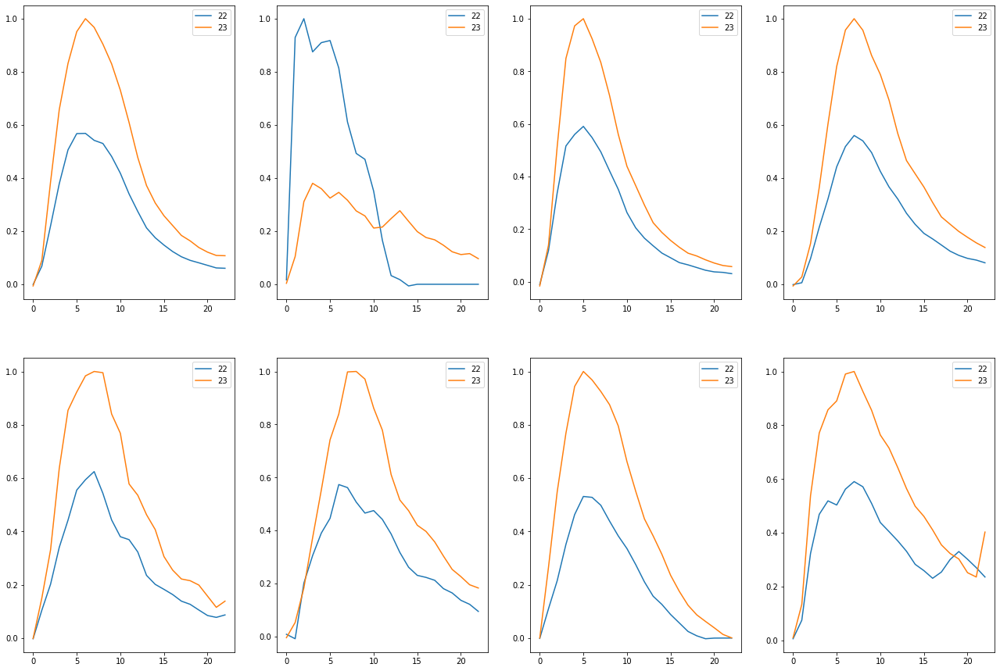

Train on detected  61  non-detected  451
Train time in seconds:  6.3720903396606445


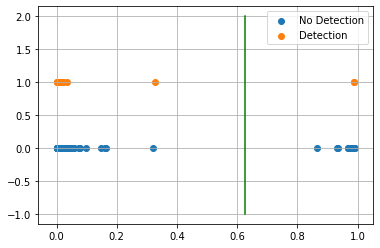

AUC 0.9452764348805932
Predicted TPR 0.9016393442622951
Predicted FPR 0.011086474501108648
Threshold 0.62718886
-----------------------End of training---------------------------


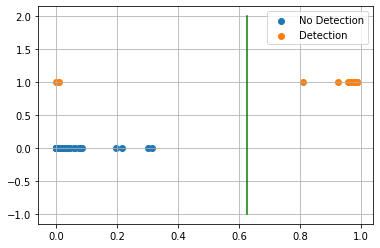

Test on detected  14  non-detected  115
F0.5 96.77%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 14.29%
True Positive 85.71%

Classification Report
              precision    recall  f1-score   support

       blank      0.983     1.000     0.991       115
    detected      1.000     0.857     0.923        14

    accuracy                          0.984       129
   macro avg      0.991     0.929     0.957       129
weighted avg      0.985     0.984     0.984       129

---------------------------end of testing--------------------------------

Compound ID 3
[47, 49, 50]


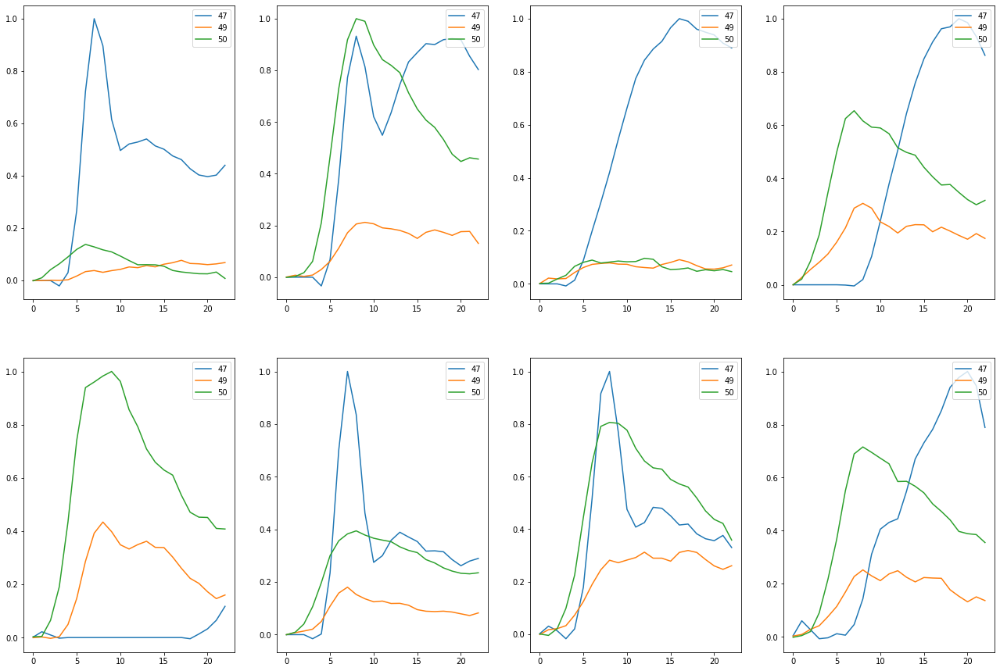

Train on detected  16  non-detected  496
Train time in seconds:  6.149048089981079


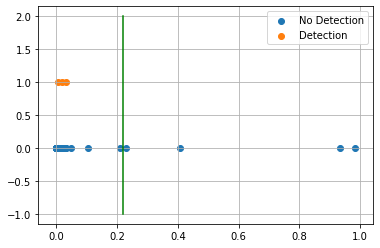

AUC 0.9637096774193549
Predicted TPR 0.9375
Predicted FPR 0.010080645161290322
Threshold 0.2180919
-----------------------End of training---------------------------


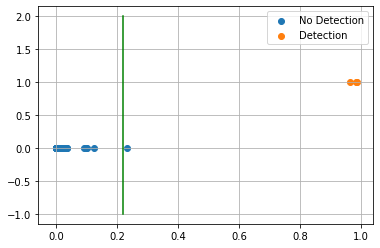

Test on detected  3  non-detected  126
F0.5 78.95%

Confusion Matrix:
True Negative 99.21%
False Positive 0.79%
False Negative 0.00%
True Positive 100.00%

Classification Report
              precision    recall  f1-score   support

       blank      1.000     0.992     0.996       126
    detected      0.750     1.000     0.857         3

    accuracy                          0.992       129
   macro avg      0.875     0.996     0.927       129
weighted avg      0.994     0.992     0.993       129

---------------------------end of testing--------------------------------

Compound ID 4
[2, 11]


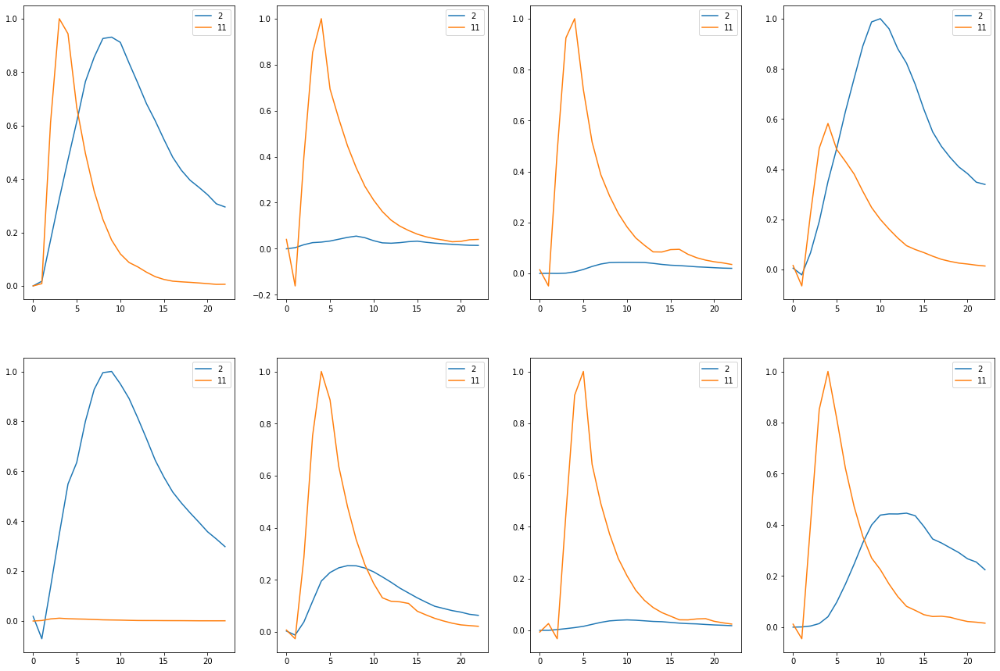

Train on detected  61  non-detected  451
Train time in seconds:  6.810094594955444


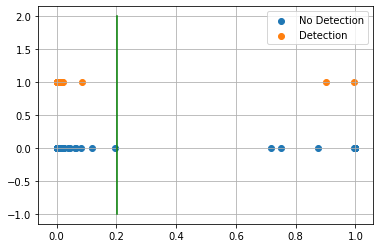

AUC 0.9780633201264948
Predicted TPR 0.9672131147540983
Predicted FPR 0.011086474501108648
Threshold 0.2017568
-----------------------End of training---------------------------


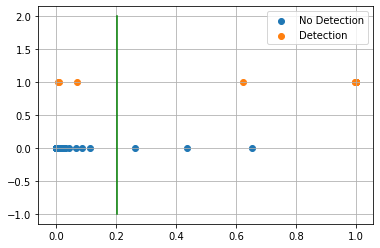

Test on detected  14  non-detected  115
F0.5 78.57%

Confusion Matrix:
True Negative 97.39%
False Positive 2.61%
False Negative 21.43%
True Positive 78.57%

Classification Report
              precision    recall  f1-score   support

       blank      0.974     0.974     0.974       115
    detected      0.786     0.786     0.786        14

    accuracy                          0.953       129
   macro avg      0.880     0.880     0.880       129
weighted avg      0.953     0.953     0.953       129

---------------------------end of testing--------------------------------

Compound ID 8
[36, 39, 46]


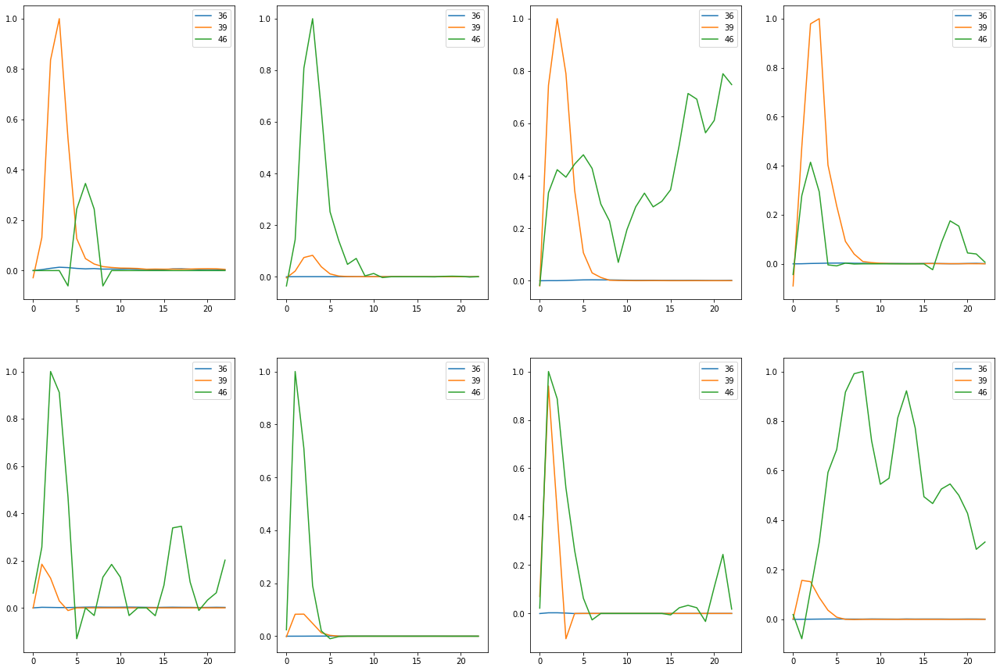

Train on detected  47  non-detected  465
Train time in seconds:  5.9230804443359375


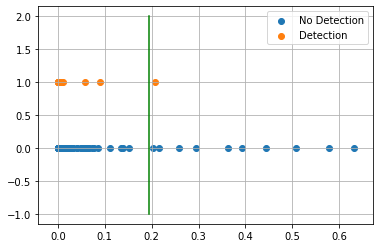

AUC 0.8328986501944635
Predicted TPR 0.6808510638297872
Predicted FPR 0.015053763440860216
Threshold 0.19412321
-----------------------End of training---------------------------


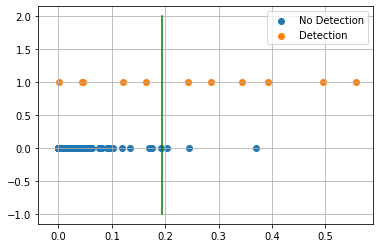

Test on detected  11  non-detected  118
F0.5 63.83%

Confusion Matrix:
True Negative 97.46%
False Positive 2.54%
False Negative 45.45%
True Positive 54.55%

Classification Report
              precision    recall  f1-score   support

       blank      0.958     0.975     0.966       118
    detected      0.667     0.545     0.600        11

    accuracy                          0.938       129
   macro avg      0.812     0.760     0.783       129
weighted avg      0.933     0.938     0.935       129

---------------------------end of testing--------------------------------

Compound ID 10
[0, 3, 4]


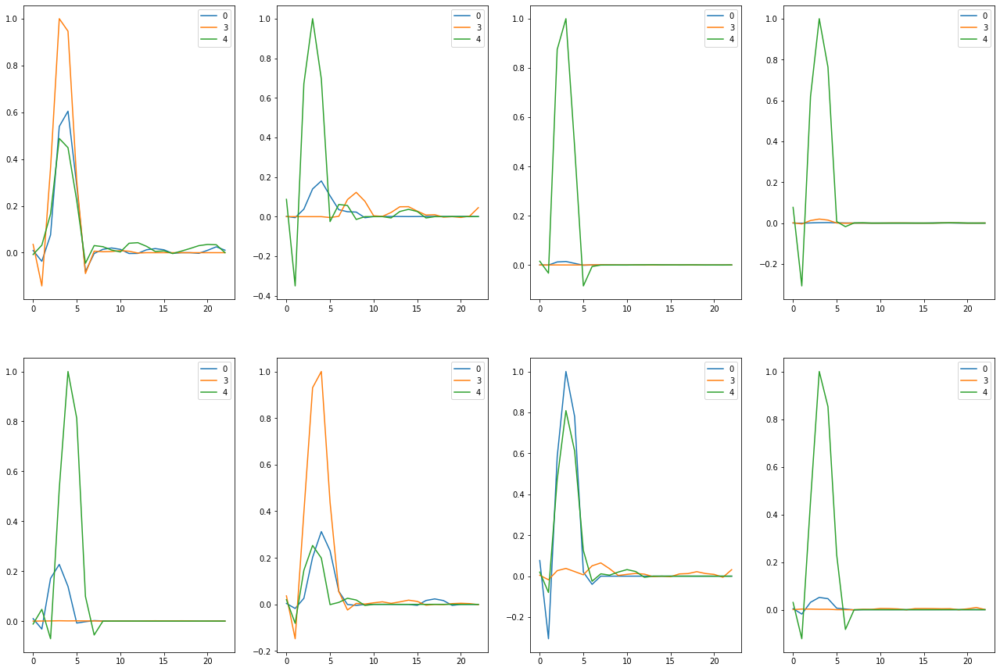

Train on detected  47  non-detected  465
Train time in seconds:  6.7670934200286865


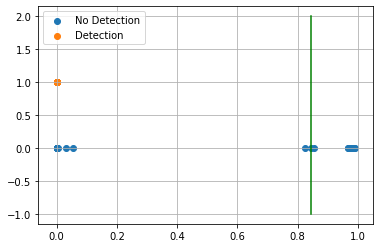

AUC 1.0
Predicted TPR 1.0
Predicted FPR 0.0
Threshold 0.84479463
-----------------------End of training---------------------------


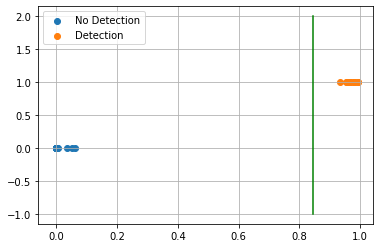

Test on detected  11  non-detected  118
F0.5 100.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 0.00%
True Positive 100.00%

Classification Report
              precision    recall  f1-score   support

       blank      1.000     1.000     1.000       118
    detected      1.000     1.000     1.000        11

    accuracy                          1.000       129
   macro avg      1.000     1.000     1.000       129
weighted avg      1.000     1.000     1.000       129

---------------------------end of testing--------------------------------

Compound ID 13
[41, 42]


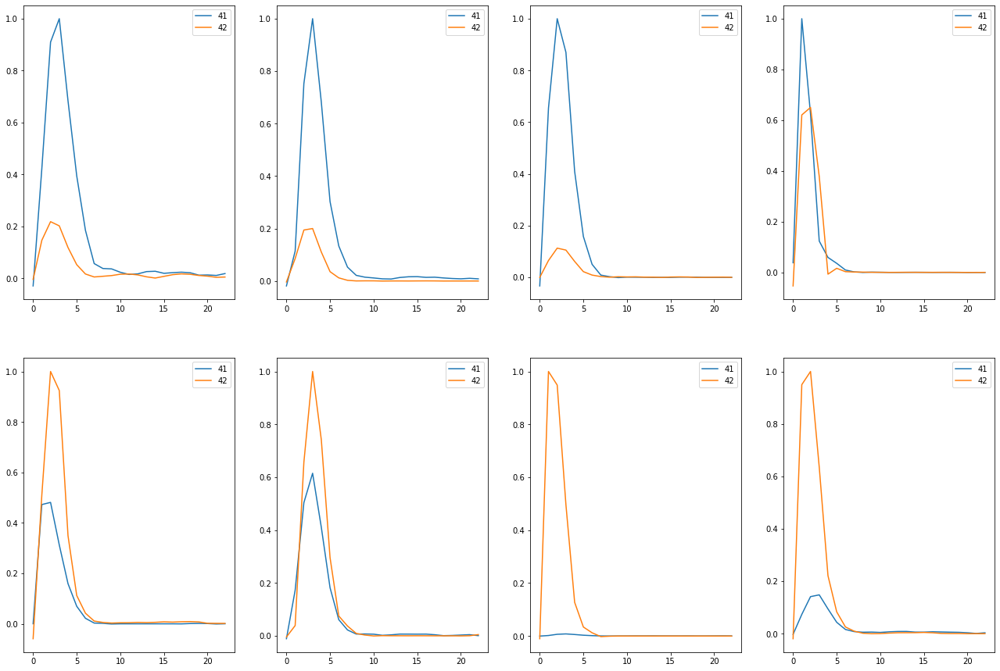

Train on detected  56  non-detected  456
Train time in seconds:  6.373088598251343


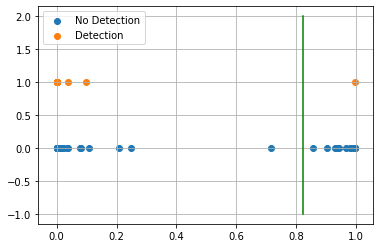

AUC 0.9888784461152882
Predicted TPR 0.9821428571428571
Predicted FPR 0.0043859649122807015
Threshold 0.8243941
-----------------------End of training---------------------------


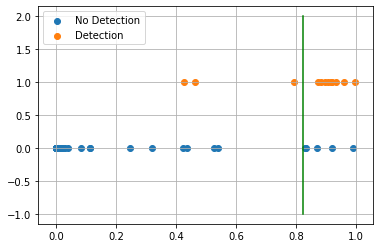

Test on detected  12  non-detected  117
F0.5 66.18%

Confusion Matrix:
True Negative 95.73%
False Positive 4.27%
False Negative 25.00%
True Positive 75.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.974     0.957     0.966       117
    detected      0.643     0.750     0.692        12

    accuracy                          0.938       129
   macro avg      0.808     0.854     0.829       129
weighted avg      0.943     0.938     0.940       129

---------------------------end of testing--------------------------------

Compound ID 14
[16, 18]


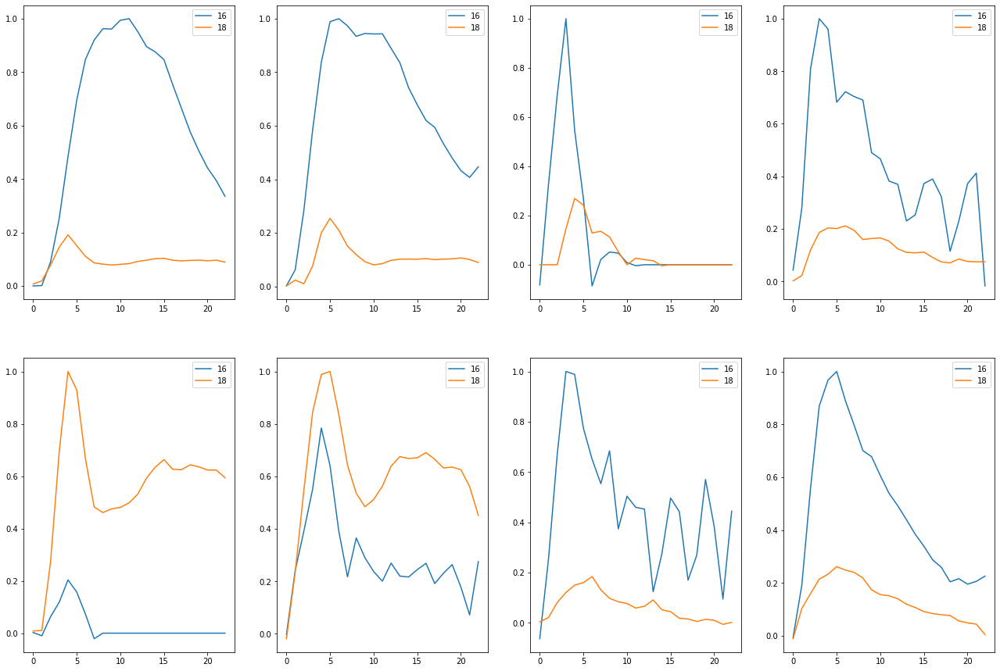

Train on detected  31  non-detected  481
Train time in seconds:  6.2781102657318115


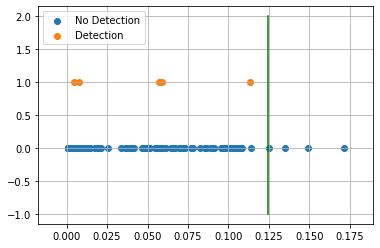

AUC 0.6035477164509423
Predicted TPR 0.22580645161290322
Predicted FPR 0.018711018711018712
Threshold 0.12429607
-----------------------End of training---------------------------


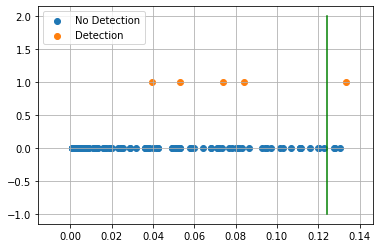

Test on detected  5  non-detected  124
F0.5 23.81%

Confusion Matrix:
True Negative 97.58%
False Positive 2.42%
False Negative 80.00%
True Positive 20.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.968     0.976     0.972       124
    detected      0.250     0.200     0.222         5

    accuracy                          0.946       129
   macro avg      0.609     0.588     0.597       129
weighted avg      0.940     0.946     0.943       129

---------------------------end of testing--------------------------------

Compound ID 15
[36, 39]


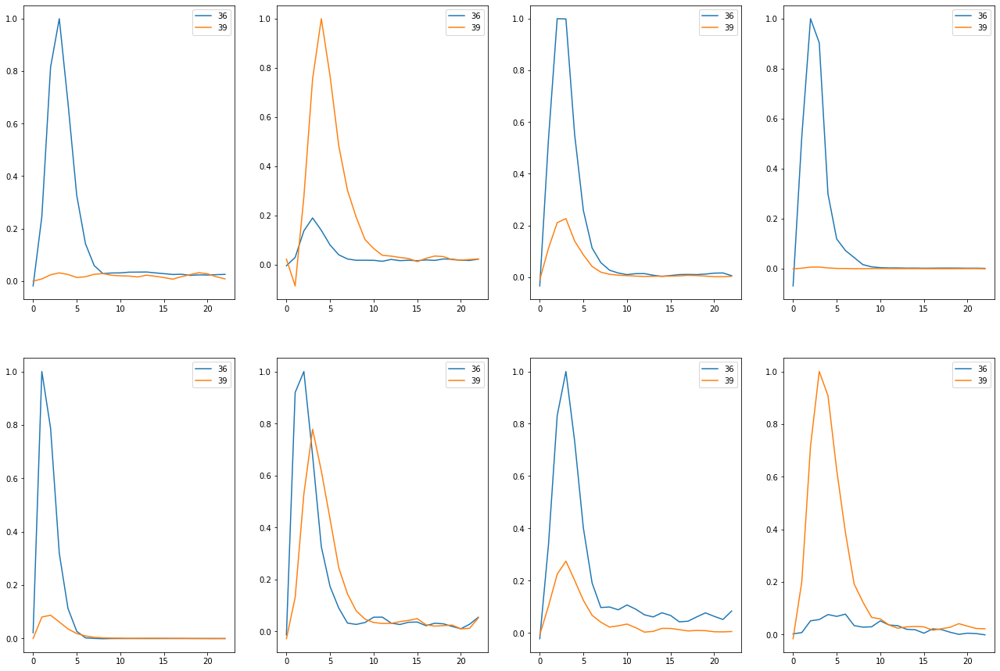

Train on detected  56  non-detected  456
Train time in seconds:  8.545121669769287


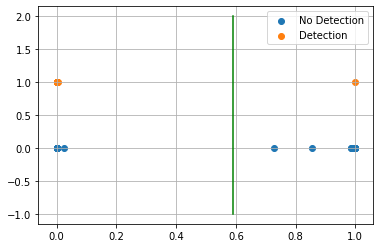

AUC 1.0
Predicted TPR 1.0
Predicted FPR 0.0
Threshold 0.592218
-----------------------End of training---------------------------


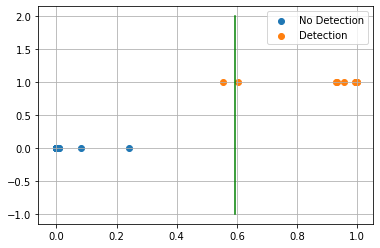

Test on detected  12  non-detected  117
F0.5 98.21%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 8.33%
True Positive 91.67%

Classification Report
              precision    recall  f1-score   support

       blank      0.992     1.000     0.996       117
    detected      1.000     0.917     0.957        12

    accuracy                          0.992       129
   macro avg      0.996     0.958     0.976       129
weighted avg      0.992     0.992     0.992       129

---------------------------end of testing--------------------------------

Compound ID 18
[21, 40]


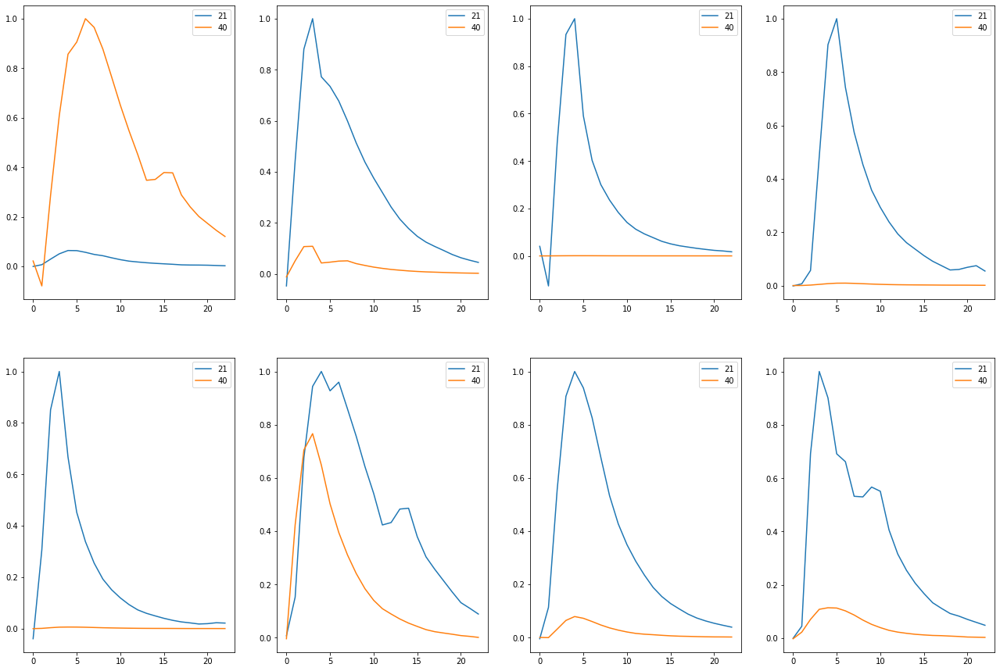

Train on detected  63  non-detected  449
Train time in seconds:  7.771056413650513


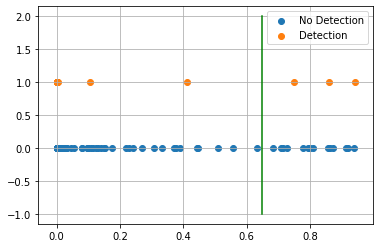

AUC 0.903789726729593
Predicted TPR 0.8253968253968254
Predicted FPR 0.017817371937639197
Threshold 0.64906466
-----------------------End of training---------------------------


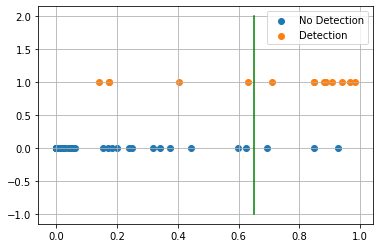

Test on detected  14  non-detected  115
F0.5 72.58%

Confusion Matrix:
True Negative 97.39%
False Positive 2.61%
False Negative 35.71%
True Positive 64.29%

Classification Report
              precision    recall  f1-score   support

       blank      0.957     0.974     0.966       115
    detected      0.750     0.643     0.692        14

    accuracy                          0.938       129
   macro avg      0.854     0.808     0.829       129
weighted avg      0.935     0.938     0.936       129

---------------------------end of testing--------------------------------

Compound ID 21
[33, 34]


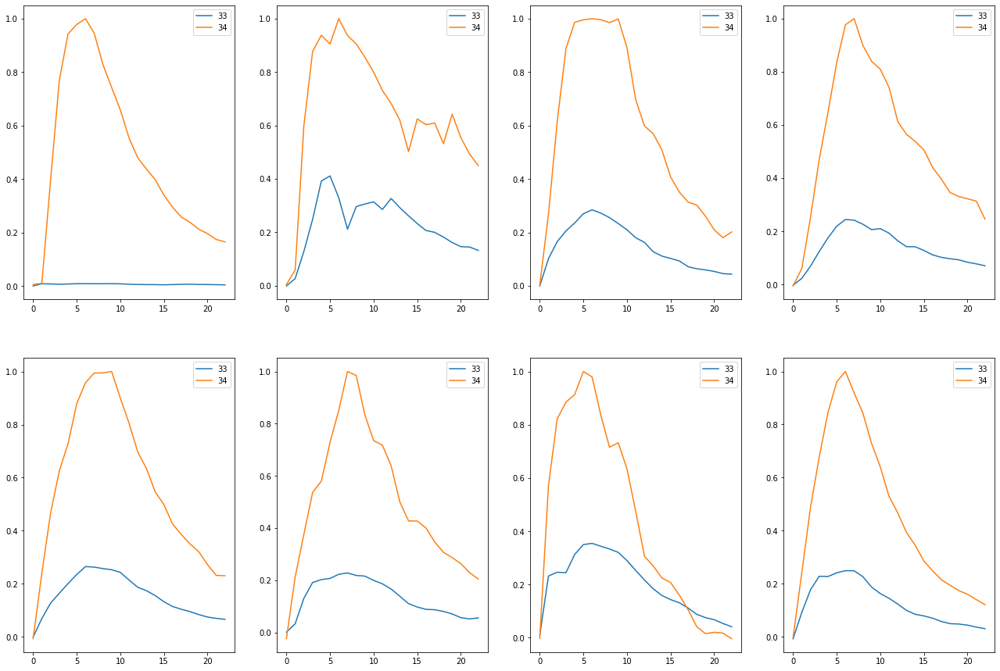

Train on detected  61  non-detected  451
Train time in seconds:  10.201140642166138


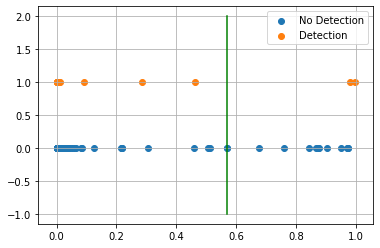

AUC 0.9009668859728837
Predicted TPR 0.819672131147541
Predicted FPR 0.017738359201773836
Threshold 0.56822395
-----------------------End of training---------------------------


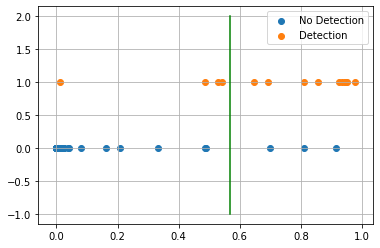

Test on detected  14  non-detected  115
F0.5 75.76%

Confusion Matrix:
True Negative 97.39%
False Positive 2.61%
False Negative 28.57%
True Positive 71.43%

Classification Report
              precision    recall  f1-score   support

       blank      0.966     0.974     0.970       115
    detected      0.769     0.714     0.741        14

    accuracy                          0.946       129
   macro avg      0.867     0.844     0.855       129
weighted avg      0.944     0.946     0.945       129

---------------------------end of testing--------------------------------

Compound ID 22
[35, 37, 38]


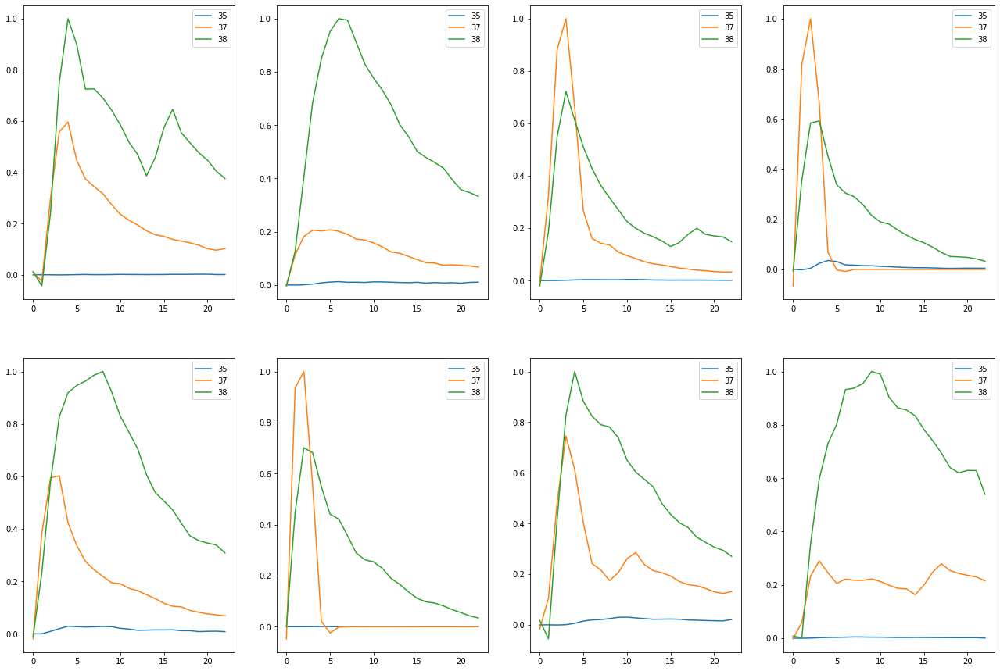

Train on detected  65  non-detected  447
Train time in seconds:  7.501105308532715


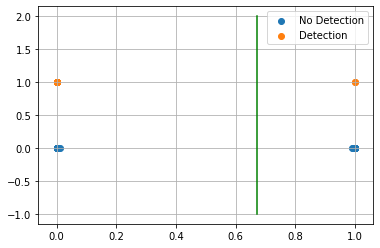

AUC 1.0
Predicted TPR 1.0
Predicted FPR 0.0
Threshold 0.671275
-----------------------End of training---------------------------


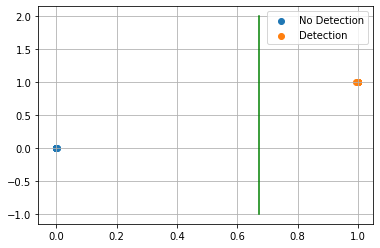

Test on detected  14  non-detected  115
F0.5 100.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 0.00%
True Positive 100.00%

Classification Report
              precision    recall  f1-score   support

       blank      1.000     1.000     1.000       115
    detected      1.000     1.000     1.000        14

    accuracy                          1.000       129
   macro avg      1.000     1.000     1.000       129
weighted avg      1.000     1.000     1.000       129

---------------------------end of testing--------------------------------
 Compounds  Tr-TPR  Tr-FPR Threshold ROC AUC Score Test-TPR Test-FPR
     0       90.16%  1.11%   62.72%       94.53%     85.71%   0.00% 
     3       93.75%  1.01%   21.81%       96.37%    100.00%   0.79% 
     4       96.72%  1.11%   20.18%       97.81%     78.57%   2.61% 
     8       68.09%  1.51%   19.41%       83.29%     54.55%   2.54% 
    10      100.00%  0.00%   84.48%      100.00%    100.00%   0.00% 
    

In [25]:
#Add filtering to original data

#initialize
mass_pair_ids_to_window_size = dict()
for mass_pair_id in range(max_mass_pair_count):
    mass_pair_ids_to_window_size[mass_pair_id] = 5

compound_id_to_adjusted_filtered_results = dict()
for compound_id, mass_pair_ids_to_dataset in compound_ids_to_adjusted_mass_pair_ids_to_dataset.items():
    print()
    print("Compound ID", compound_id)
    model, testset, predicted_tpr, predicted_fpr, threshold, auc_score = build_train_model_with_filter(mass_pair_ids_to_dataset, mass_pair_ids_to_window_size)
    tpr, fpr = test_model_and_output_results(model, testset, threshold)
    compound_id_to_adjusted_filtered_results[compound_id] = predicted_tpr, predicted_fpr, threshold, auc_score, tpr, fpr
    
adjusted_filtered_results_dataframe = compound_id_results_to_dataframe(compound_id_to_adjusted_filtered_results)

print(adjusted_filtered_results_dataframe.to_string(index=False, justify='center'))

In [26]:
print("\tOriginal")
print(original_results_dataframe.to_string(index=False, justify='center'))
print()
print("\tFiltered")
print(filtered_results_dataframe.to_string(index=False, justify='center'))
print()
print("\tNo Filtering Adjusted")
print(adjusted_results_dataframe.to_string(index=False, justify='center'))
print()
print("\tFiltered Adjusted")
print(adjusted_filtered_results_dataframe.to_string(index=False, justify='center'))

	Original
 Compounds  Tr-TPR  Tr-FPR Threshold ROC AUC Score Test-TPR Test-FPR
     0       95.08%  0.44%   22.68%       97.32%     92.86%   0.87% 
     3       93.75%  1.01%    6.45%       96.37%    100.00%   3.97% 
     4      100.00%  0.89%   55.19%       99.56%     92.86%   0.87% 
     7      100.00%  0.99%   14.10%       99.50%      0.00%   1.56% 
     8       48.94%  1.08%   33.15%       73.93%     27.27%   1.69% 
    10       95.74%  0.65%   78.00%       97.55%     72.73%   2.54% 
    13       98.21%  1.32%   70.68%       98.45%     83.33%   1.71% 
    14       35.48%  1.66%   14.83%       66.91%     40.00%   4.03% 
    15       26.79%  1.97%   47.93%       62.41%     50.00%   0.00% 
    18       77.78%  1.78%   68.28%       88.00%     57.14%   5.22% 
    19      100.00%  0.00%   43.91%      100.00%      0.00%   0.00% 
    21       95.08%  0.89%   63.75%       97.10%     92.86%   1.74% 
    22      100.00%  0.00%   95.40%      100.00%    100.00%   0.00% 

	Filtered
 Compounds  T

The results are mixed. In some cases the results are better and in others worse. For results that are the same as the original I am inclined to take the adjusted because it creates a simpler model. Most compounds perform better or equal with intensity smoothing/filtering. The adjusted/filtered mass pairs can do much worse meaning the removed or filtered mass pairs have some important features that distinguish them as detections. We will need to adjust our filtering and adjusted mass pairs on a compound basis.


Compound ID 0
Filtered
[22, 23, 25, 26, 33, 34]


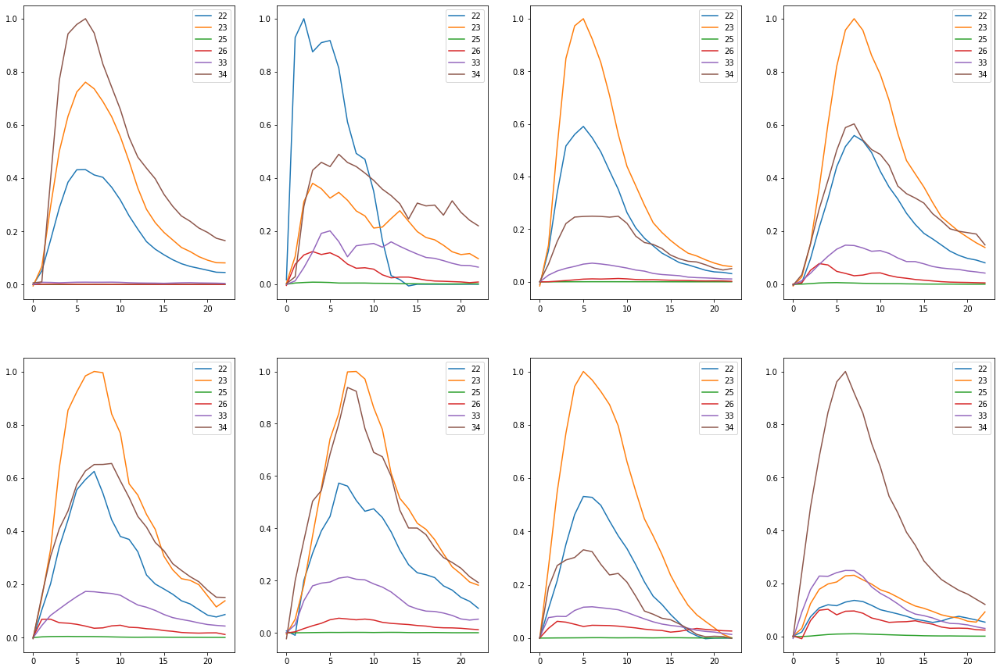

Train on detected  61  non-detected  451
Train time in seconds:  8.48105764389038


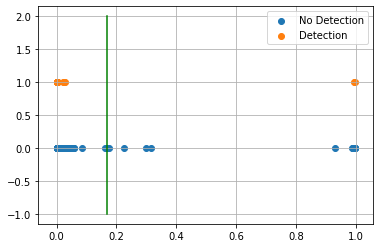

AUC 0.9747373777761623
Predicted TPR 0.9672131147540983
Predicted FPR 0.017738359201773836
Threshold 0.16813818
-----------------------End of training---------------------------


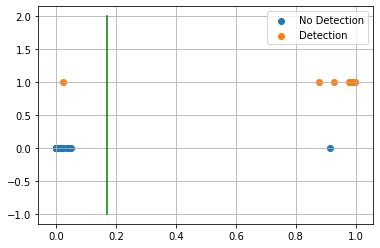

Test on detected  14  non-detected  115
F0.5 92.86%

Confusion Matrix:
True Negative 99.13%
False Positive 0.87%
False Negative 7.14%
True Positive 92.86%

Classification Report
              precision    recall  f1-score   support

       blank      0.991     0.991     0.991       115
    detected      0.929     0.929     0.929        14

    accuracy                          0.984       129
   macro avg      0.960     0.960     0.960       129
weighted avg      0.984     0.984     0.984       129

---------------------------end of testing--------------------------------

Compound ID 3
Non-filtered Adjusted
[47, 49, 50]


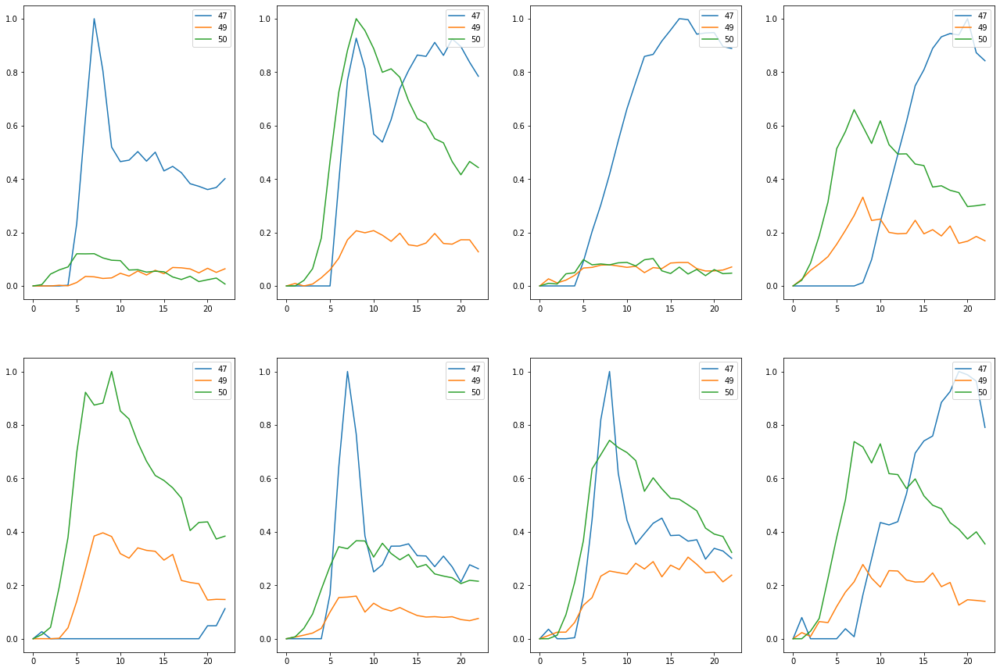

Train on detected  16  non-detected  496
Train time in seconds:  7.360049486160278


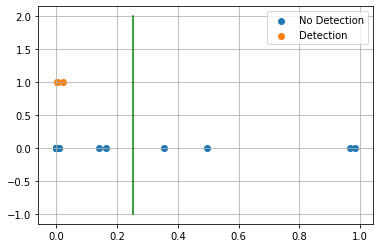

AUC 0.9657258064516129
Predicted TPR 0.9375
Predicted FPR 0.006048387096774193
Threshold 0.2539319396018982
-----------------------End of training---------------------------


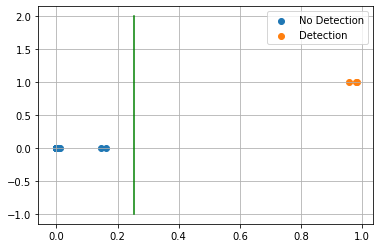

Test on detected  3  non-detected  126
F0.5 100.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 0.00%
True Positive 100.00%

Classification Report
              precision    recall  f1-score   support

       blank      1.000     1.000     1.000       126
    detected      1.000     1.000     1.000         3

    accuracy                          1.000       129
   macro avg      1.000     1.000     1.000       129
weighted avg      1.000     1.000     1.000       129

---------------------------end of testing--------------------------------

Compound ID 4
Non-filtered Adjusted
[2, 11]


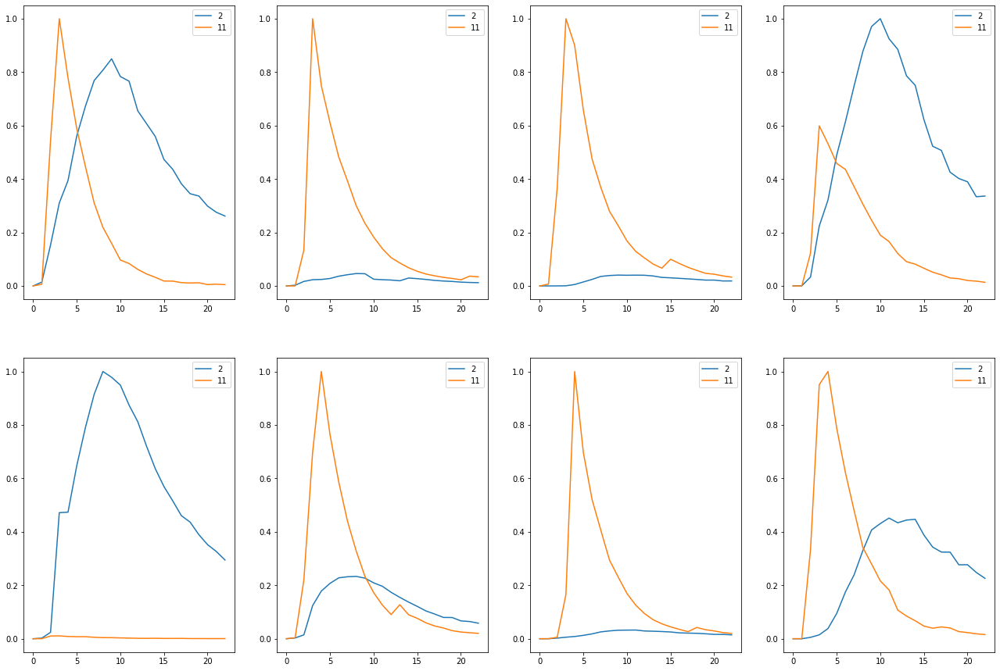

Train on detected  61  non-detected  451
Train time in seconds:  8.192052602767944


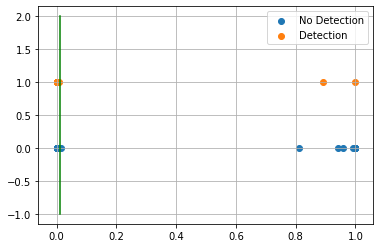

AUC 0.9988913525498891
Predicted TPR 1.0
Predicted FPR 0.0022172949002217295
Threshold 0.010570645332336426
-----------------------End of training---------------------------


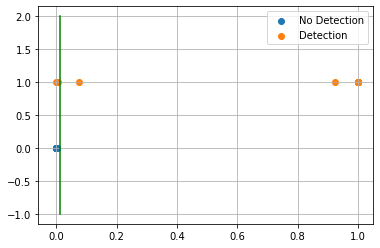

Test on detected  14  non-detected  115
F0.5 96.77%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 14.29%
True Positive 85.71%

Classification Report
              precision    recall  f1-score   support

       blank      0.983     1.000     0.991       115
    detected      1.000     0.857     0.923        14

    accuracy                          0.984       129
   macro avg      0.991     0.929     0.957       129
weighted avg      0.985     0.984     0.984       129

---------------------------end of testing--------------------------------

Compound ID 7
Original
[16, 18, 27, 30, 46]


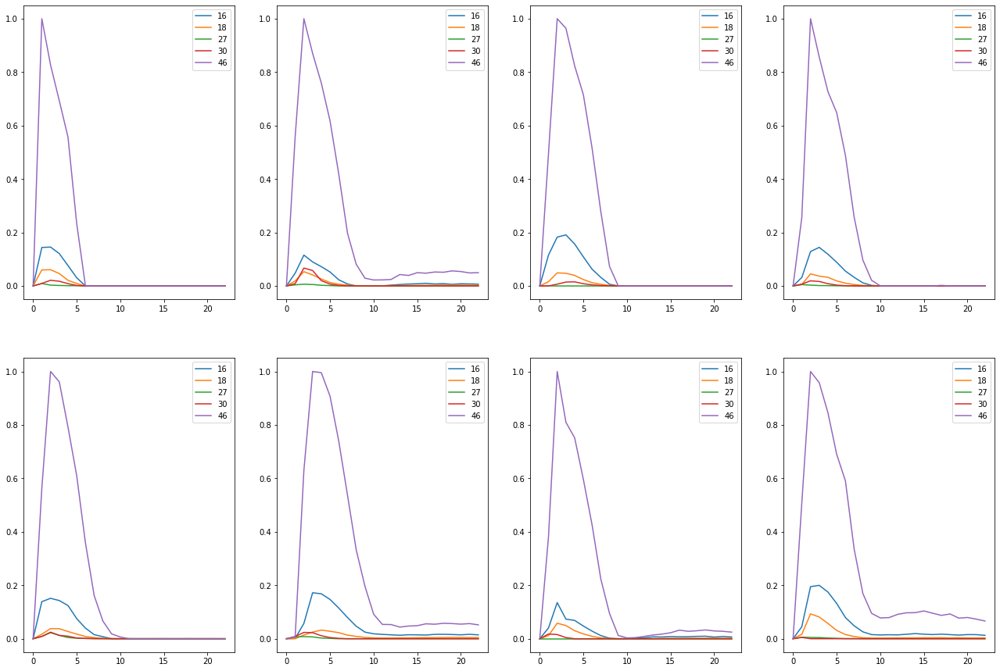

Train on detected  8  non-detected  504
Train time in seconds:  7.038044691085815


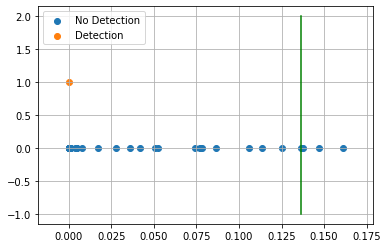

AUC 0.9940476190476191
Predicted TPR 1.0
Predicted FPR 0.011904761904761904
Threshold 0.13671618700027466
-----------------------End of training---------------------------


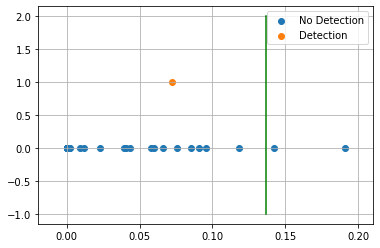

Test on detected  1  non-detected  128
F0.5 0.00%

Confusion Matrix:
True Negative 98.44%
False Positive 1.56%
False Negative 100.00%
True Positive 0.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.992     0.984     0.988       128
    detected      0.000     0.000     0.000         1

    accuracy                          0.977       129
   macro avg      0.496     0.492     0.494       129
weighted avg      0.984     0.977     0.981       129

---------------------------end of testing--------------------------------

Compound ID 8
Non-filtered Adjusted
[36, 39, 46]


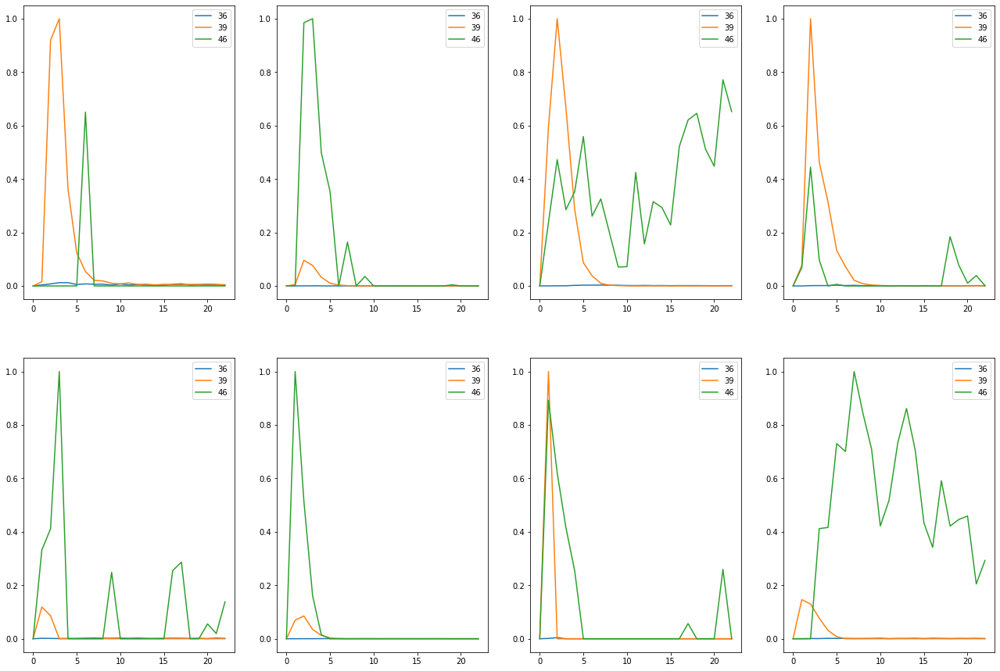

Train on detected  47  non-detected  465
Train time in seconds:  8.161065101623535


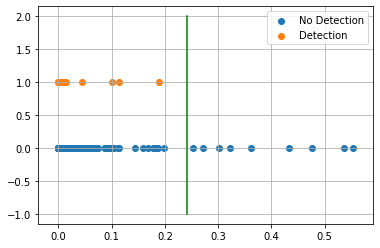

AUC 0.778631892015557
Predicted TPR 0.574468085106383
Predicted FPR 0.017204301075268817
Threshold 0.24193161725997925
-----------------------End of training---------------------------


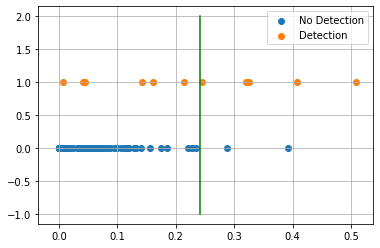

Test on detected  11  non-detected  118
F0.5 64.10%

Confusion Matrix:
True Negative 98.31%
False Positive 1.69%
False Negative 54.55%
True Positive 45.45%

Classification Report
              precision    recall  f1-score   support

       blank      0.951     0.983     0.967       118
    detected      0.714     0.455     0.556        11

    accuracy                          0.938       129
   macro avg      0.833     0.719     0.761       129
weighted avg      0.931     0.938     0.932       129

---------------------------end of testing--------------------------------

Compound ID 10
Filtered Adjusted
[0, 3, 4]


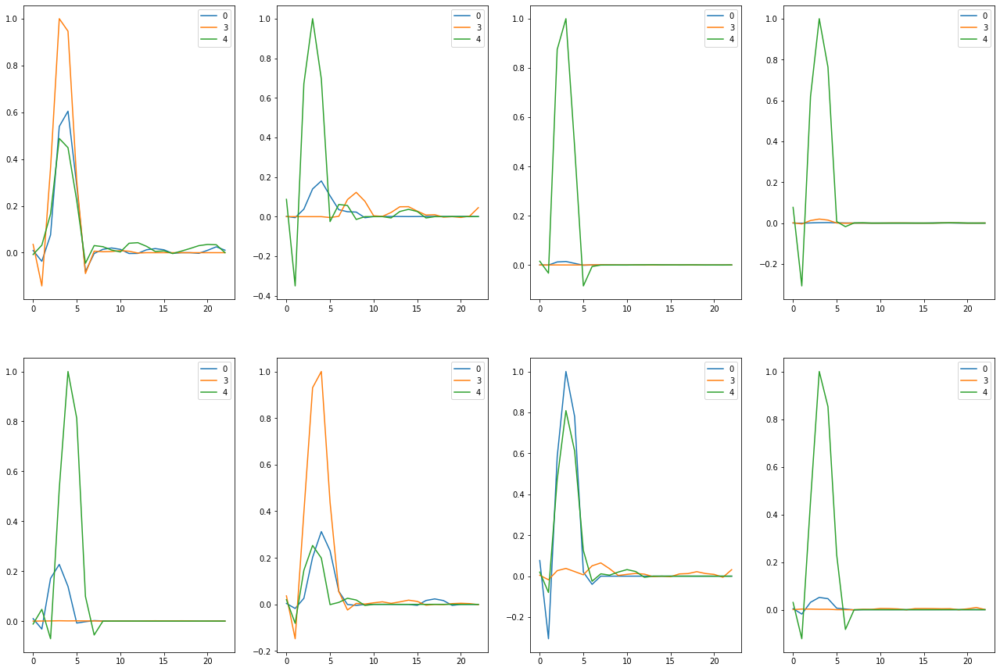

Train on detected  47  non-detected  465
Train time in seconds:  7.404049873352051


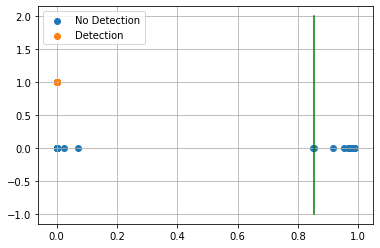

AUC 0.9989247311827957
Predicted TPR 1.0
Predicted FPR 0.002150537634408602
Threshold 0.85454684
-----------------------End of training---------------------------


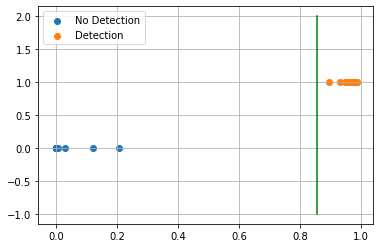

Test on detected  11  non-detected  118
F0.5 100.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 0.00%
True Positive 100.00%

Classification Report
              precision    recall  f1-score   support

       blank      1.000     1.000     1.000       118
    detected      1.000     1.000     1.000        11

    accuracy                          1.000       129
   macro avg      1.000     1.000     1.000       129
weighted avg      1.000     1.000     1.000       129

---------------------------end of testing--------------------------------

Compound ID 13
Filtered Adjusted
[41, 42]


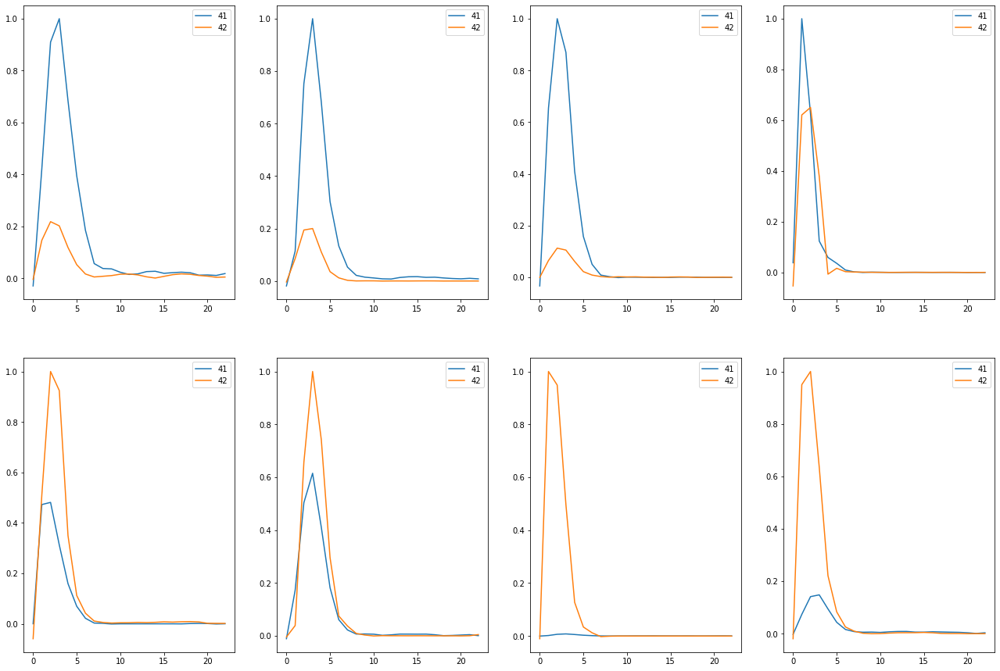

Train on detected  56  non-detected  456
Train time in seconds:  7.364049434661865


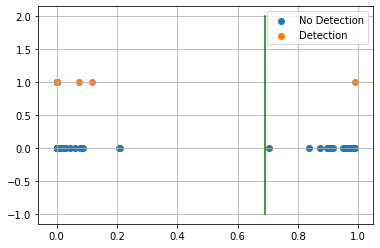

AUC 0.9855889724310778
Predicted TPR 0.9821428571428571
Predicted FPR 0.010964912280701754
Threshold 0.68965924
-----------------------End of training---------------------------


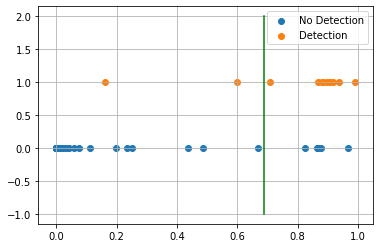

Test on detected  12  non-detected  117
F0.5 69.44%

Confusion Matrix:
True Negative 95.73%
False Positive 4.27%
False Negative 16.67%
True Positive 83.33%

Classification Report
              precision    recall  f1-score   support

       blank      0.982     0.957     0.970       117
    detected      0.667     0.833     0.741        12

    accuracy                          0.946       129
   macro avg      0.825     0.895     0.855       129
weighted avg      0.953     0.946     0.948       129

---------------------------end of testing--------------------------------

Compound ID 14
Filtered
[16, 18, 46]


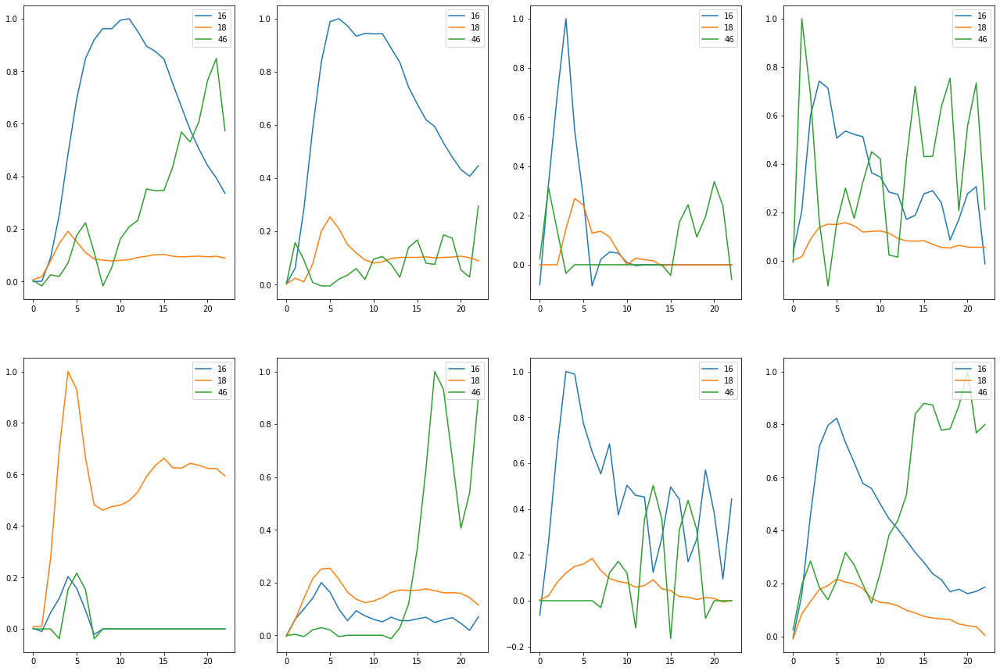

Train on detected  31  non-detected  481
Train time in seconds:  7.3280487060546875


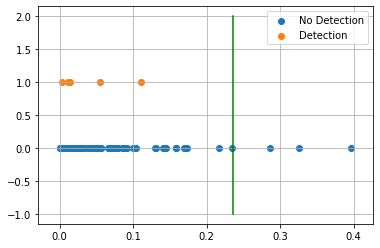

AUC 0.6701428475622024
Predicted TPR 0.3548387096774194
Predicted FPR 0.014553014553014554
Threshold 0.23576614
-----------------------End of training---------------------------


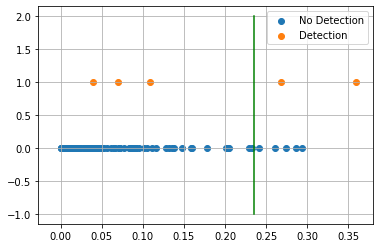

Test on detected  5  non-detected  124
F0.5 30.30%

Confusion Matrix:
True Negative 95.97%
False Positive 4.03%
False Negative 60.00%
True Positive 40.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.975     0.960     0.967       124
    detected      0.286     0.400     0.333         5

    accuracy                          0.938       129
   macro avg      0.631     0.680     0.650       129
weighted avg      0.949     0.938     0.943       129

---------------------------end of testing--------------------------------

Compound ID 15
Filtered Adjusted
[36, 39]


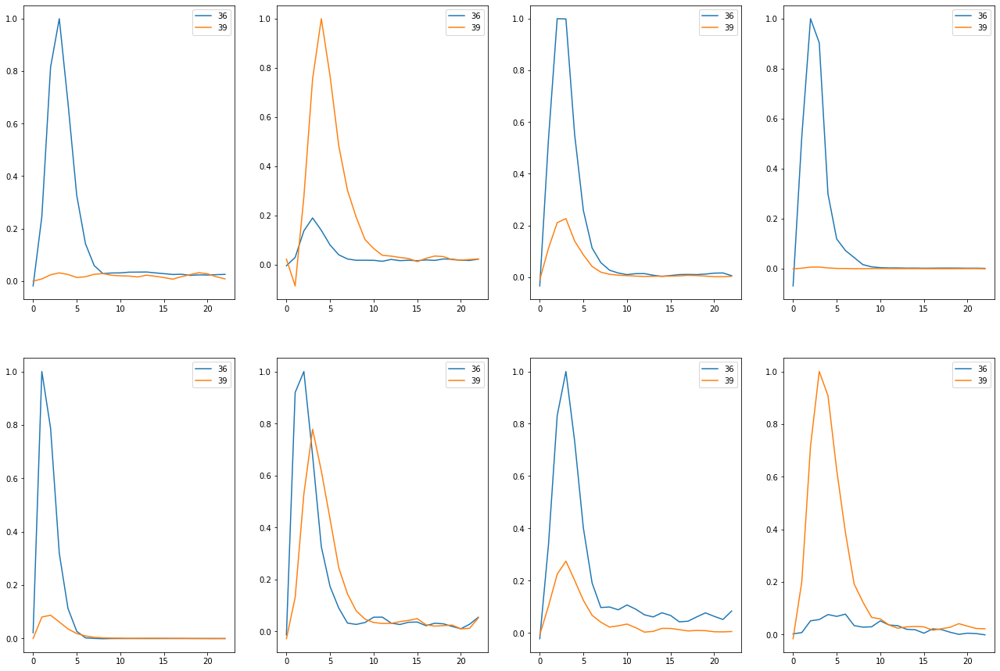

Train on detected  56  non-detected  456
Train time in seconds:  8.566058158874512


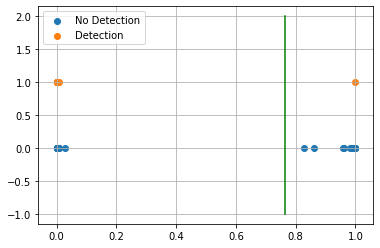

AUC 1.0
Predicted TPR 1.0
Predicted FPR 0.0
Threshold 0.7656459
-----------------------End of training---------------------------


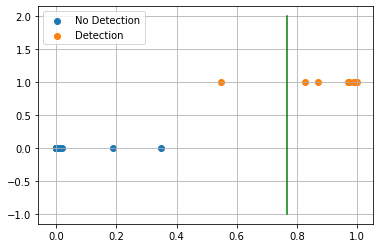

Test on detected  12  non-detected  117
F0.5 98.21%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 8.33%
True Positive 91.67%

Classification Report
              precision    recall  f1-score   support

       blank      0.992     1.000     0.996       117
    detected      1.000     0.917     0.957        12

    accuracy                          0.992       129
   macro avg      0.996     0.958     0.976       129
weighted avg      0.992     0.992     0.992       129

---------------------------end of testing--------------------------------

Compound ID 18
Non-filtered Adjusted
[21, 40]


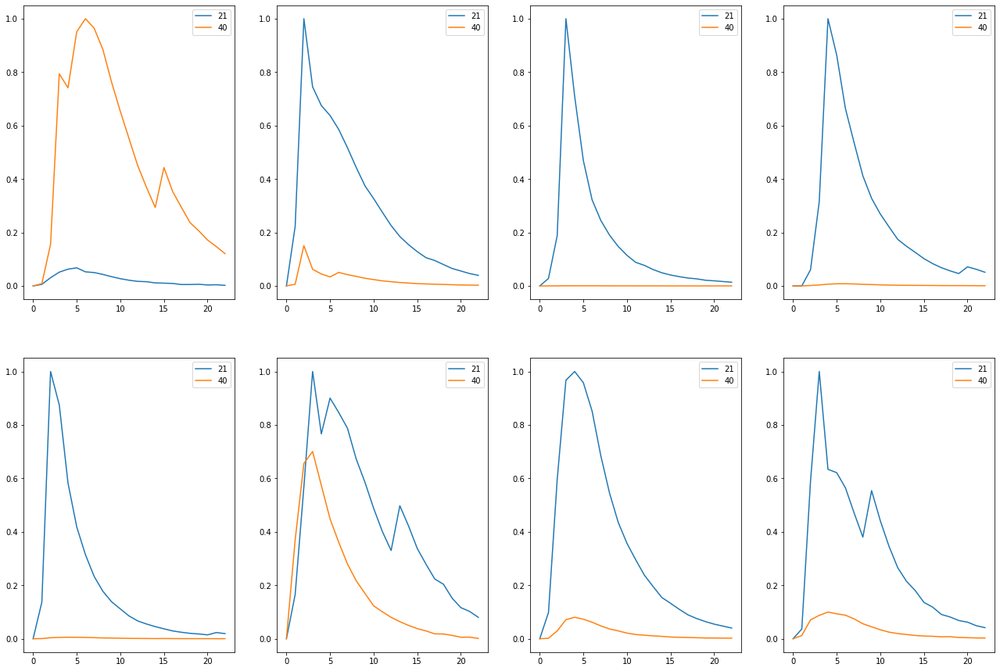

Train on detected  63  non-detected  449
Train time in seconds:  9.01406741142273


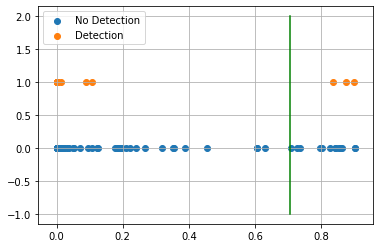

AUC 0.9049033124756956
Predicted TPR 0.8253968253968254
Predicted FPR 0.015590200445434299
Threshold 0.7073225975036621
-----------------------End of training---------------------------


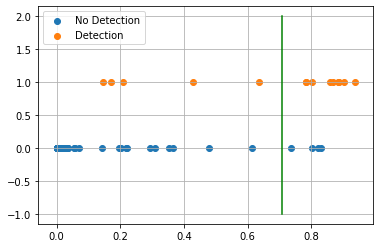

Test on detected  14  non-detected  115
F0.5 68.18%

Confusion Matrix:
True Negative 96.52%
False Positive 3.48%
False Negative 35.71%
True Positive 64.29%

Classification Report
              precision    recall  f1-score   support

       blank      0.957     0.965     0.961       115
    detected      0.692     0.643     0.667        14

    accuracy                          0.930       129
   macro avg      0.825     0.804     0.814       129
weighted avg      0.928     0.930     0.929       129

---------------------------end of testing--------------------------------

Compound ID 19
Filtered
[7, 8]


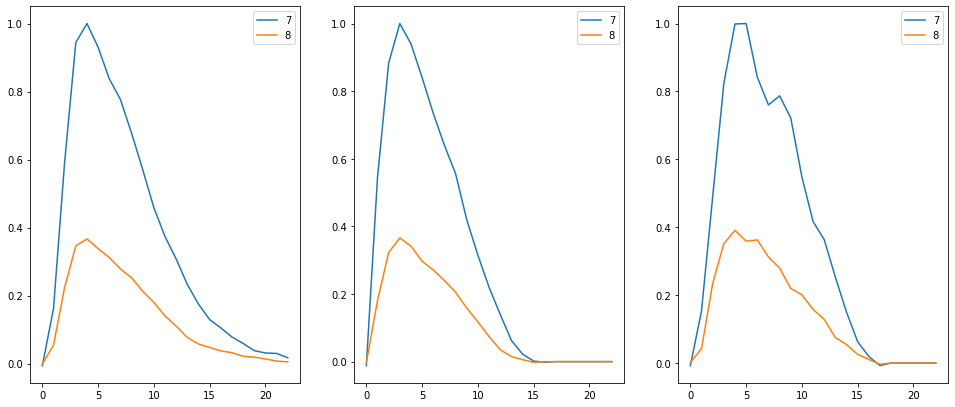

Train on detected  3  non-detected  509
Train time in seconds:  8.098052263259888


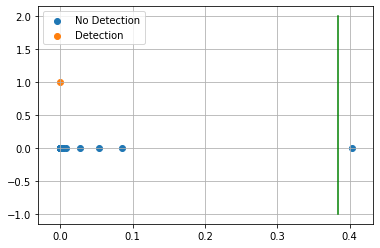

AUC 1.0
Predicted TPR 1.0
Predicted FPR 0.0
Threshold 0.38333753
-----------------------End of training---------------------------


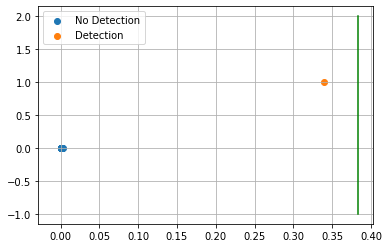

Test on detected  1  non-detected  128
F0.5 0.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 100.00%
True Positive 0.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.992     1.000     0.996       128
    detected      0.000     0.000     0.000         1

    accuracy                          0.992       129
   macro avg      0.496     0.500     0.498       129
weighted avg      0.985     0.992     0.988       129

---------------------------end of testing--------------------------------

Compound ID 21
Original
[22, 23, 25, 26, 33, 34]


C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and bein

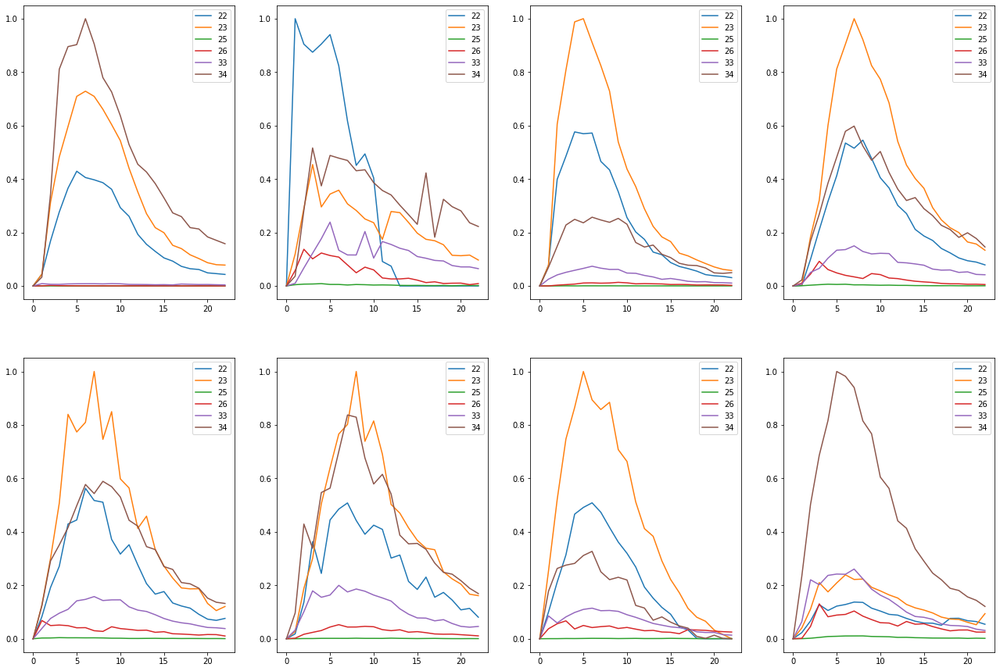

Train on detected  61  non-detected  451
Train time in seconds:  8.932060718536377


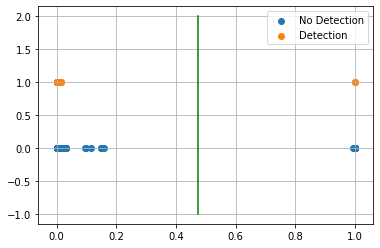

AUC 0.973192541165352
Predicted TPR 0.9508196721311475
Predicted FPR 0.004434589800443459
Threshold 0.47215184569358826
-----------------------End of training---------------------------


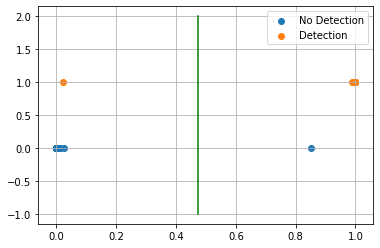

Test on detected  14  non-detected  115
F0.5 92.86%

Confusion Matrix:
True Negative 99.13%
False Positive 0.87%
False Negative 7.14%
True Positive 92.86%

Classification Report
              precision    recall  f1-score   support

       blank      0.991     0.991     0.991       115
    detected      0.929     0.929     0.929        14

    accuracy                          0.984       129
   macro avg      0.960     0.960     0.960       129
weighted avg      0.984     0.984     0.984       129

---------------------------end of testing--------------------------------

Compound ID 22
Filtered Adjusted
[35, 37, 38]


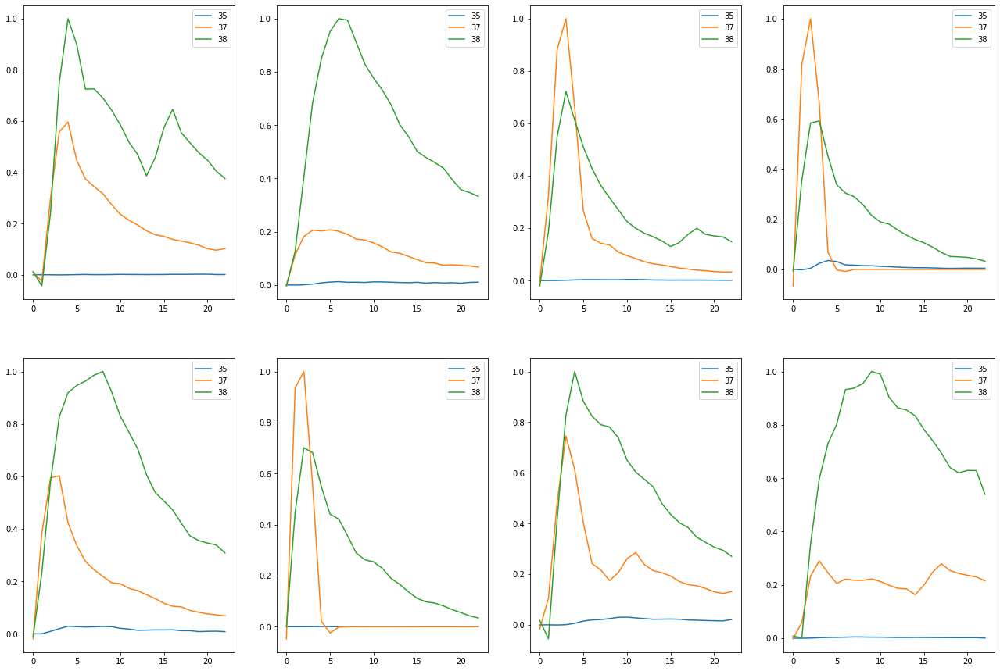

Train on detected  65  non-detected  447
Train time in seconds:  8.575071573257446


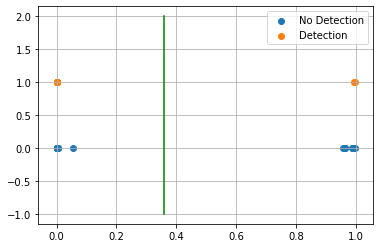

AUC 1.0
Predicted TPR 1.0
Predicted FPR 0.0
Threshold 0.3578397
-----------------------End of training---------------------------


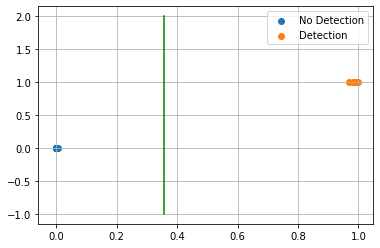

Test on detected  14  non-detected  115
F0.5 100.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 0.00%
True Positive 100.00%

Classification Report
              precision    recall  f1-score   support

       blank      1.000     1.000     1.000       115
    detected      1.000     1.000     1.000        14

    accuracy                          1.000       129
   macro avg      1.000     1.000     1.000       129
weighted avg      1.000     1.000     1.000       129

---------------------------end of testing--------------------------------
 Comp.   TPR     FPR   Thresh. ROC Score Test-TPR Test-FPR      Type     
   0     96.72%  1.77%  16.81%    97.47%   92.86%   0.87%            Fil.
   3     93.75%  0.60%  25.39%    96.57%  100.00%   0.00%   Non-fil. Adj.
   4    100.00%  0.22%   1.06%    99.89%   85.71%   0.00%   Non-fil. Adj.
   7    100.00%  1.19%  13.67%    99.40%    0.00%   1.56%           Orig.
   8     57.45%  1.72%  24.19%    77.86%   45.45

In [28]:
#From results choose whether to adjust or filter to get best model

def percent_to_float(x):
    return float(x.strip('%'))/100

def get_roc_auc_score(dataframe, compound_id):
    row = dataframe[dataframe['Compounds'] == compound_id]
    if not row.empty:
        values = row.to_numpy()[0]
        return percent_to_float(values[4])
    else:
        return 0
    
mass_pair_ids_to_window_size = dict()
for mass_pair_id in range(max_mass_pair_count):
    mass_pair_ids_to_window_size[mass_pair_id] = 5

compound_id_to_final_results = dict()
compound_id_to_final_model = dict()
for compound_id in compound_ids_to_mass_pair_ids_to_dataset.keys():
    original_score = get_roc_auc_score(original_results_dataframe, compound_id)
    filtered_score = get_roc_auc_score(filtered_results_dataframe, compound_id)
    nfa_score = get_roc_auc_score(adjusted_results_dataframe, compound_id)
    filtadj_score = get_roc_auc_score(adjusted_filtered_results_dataframe, compound_id)
    
    scores = [filtadj_score, nfa_score, filtered_score, original_score]
    
    choice = scores.index(max(scores))
    labels = ["Filtered Adjusted", "Non-filtered Adjusted", "Filtered", "Original"]
    abbrev_labels = ["Filt. Adj.", "Non-fil. Adj.", "Fil.", "Orig."]
    print()
    print("Compound ID", compound_id)
    print(labels[choice])
    if choice > 1:
        #original
        mass_pair_ids_to_dataset = compound_ids_to_mass_pair_ids_to_dataset[compound_id]
    else:
        #adjusted
        mass_pair_ids_to_dataset = compound_ids_to_adjusted_mass_pair_ids_to_dataset[compound_id]
    
    if choice % 2 == 1:#Even has filters 0 and 2
        model, testset, predicted_tpr, predicted_fpr, threshold, auc_score  = build_train_model(mass_pair_ids_to_dataset)
    else:
        model, testset, predicted_tpr, predicted_fpr, threshold, auc_score  = build_train_model_with_filter(mass_pair_ids_to_dataset, mass_pair_ids_to_window_size)
    
    tpr, fpr = test_model_and_output_results(model, testset, threshold)
    compound_id_to_final_results[compound_id] = predicted_tpr, predicted_fpr, threshold, auc_score, tpr, fpr, abbrev_labels[choice]
    compound_id_to_final_model[compound_id] = model
    

final_results_dataframe = compound_id_results_to_dataframe(compound_id_to_final_results, ["Comp.", "TPR" ,"FPR", "Thresh.", "ROC Score", "Test-TPR", "Test-FPR", "Type"])

print(final_results_dataframe.to_string(index=False, justify='center'))
print()

# Results

## Model Evaluation and Validation

We have not exactly reached our intended goal, but we have acheived some good results. I would like to see if I could extend my neural network to add additional features that may increase my prediction accuracy. This will allow me to evaluate how good our model is.

In [29]:
from sklearn.model_selection import train_test_split
from keras.callbacks import ModelCheckpoint, EarlyStopping
from keras.models import Sequential, Model
from keras.layers import Dense, Conv1D, \
    MaxPooling1D, GlobalAveragePooling1D, Dropout, \
    Input, Permute, Concatenate, Flatten
import time


def build_compound_model_with_extra_features(mass_pair_count, max_timestep, print_summary=True):
    shape_input = Input(shape=(mass_pair_count, max_timestep))
    features_input = Input(shape=(mass_pair_count, 2))# width and position

    x = Permute((2, 1))(shape_input)
    x = Conv1D(128, 5, activation='relu')(x)
    x = Conv1D(128, 5, activation='relu')(x)
    x = MaxPooling1D()(x)
    x = Dropout(0.2)(x)
    x = Conv1D(128, 3, activation='relu')(x)
    x = Conv1D(128, 3, activation='relu')(x)
    x = GlobalAveragePooling1D()(x)
    x = Dropout(0.2)(x)
    shape_output = Dense(1, activation='relu')(x)
    
    x2 = Dense(32, activation='relu')(features_input)
    x2 = Dropout(0.4)(x2)
    feature_output = Dense(1, activation='relu')(x2)
    
    feature_output = Flatten()(feature_output)
    
    merge = Concatenate()([shape_output, feature_output])
    
    output = Dense(1, activation='sigmoid')(merge)

    model = Model([shape_input, features_input], output)

    if print_summary:
        print(model.summary())

    return model

def build_train_model_with_extra_features(mass_pair_ids_to_dataset, mass_pair_ids_to_features):
    mass_pair_ids_to_dataset_copy = mass_pair_ids_to_dataset.copy()
    mass_pair_ids_to_features_copy = mass_pair_ids_to_features.copy()
    mass_pair_count = len(mass_pair_ids_to_dataset_copy)
    model = build_compound_model_with_extra_features(mass_pair_count, max_timestep, False)
    model.compile(optimizer='adam',
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    
    intensities_and_outputs = np.stack(list(mass_pair_ids_to_dataset_copy.values()), axis=1)
    
    features_and_outputs = np.stack(list(mass_pair_ids_to_features_copy.values()), axis=1)
    
    
    print(list(mass_pair_ids_to_dataset_copy.keys()))
    
    #validate
    #for i, (mass_pair_ids, dataset) in enumerate(mass_pair_ids_to_dataset.items()):
    #    if not np.array_equal(intensities_and_outputs[1,i], dataset.to_numpy()[1]):
    #        print("stack fail")
    #        break
    X = intensities_and_outputs[:,:,:-1]

    #normalize
    def normalize(array):
        for i, data in enumerate(array):
            array[i] = np.nan_to_num(data/np.amax(data))
        return array

    X = normalize(X)
    
    X2 = features_and_outputs[:,:,:-1]
    
    X2 = X2/max_timestep
    
    y = intensities_and_outputs[:,0,-1]#all of axis 1 will have same value
    #convert y to binary form
    y = (y >= 0).astype(int)

    X_train, X_test, X2_train, X2_test, y_train, y_test = train_test_split(X, X2, y, test_size=0.2, random_state=7)
    
    detected_count = sum(y_train)
    non_detected_count = len(y_train) - detected_count
    
    arange = np.arange(X.shape[-1])

    fig = plt.figure()
    
    plot_count = detected_count if detected_count < 8 else 8
    
    detected_train_X = X_train[np.where(y_train > 0)]
    
    subplot = 241
    for sample_index in range(plot_count):
        ax = fig.add_subplot(subplot)
        subplot += 1
    
        for mass_pair_index, array in enumerate(detected_train_X[sample_index]):
            ax.plot(arange, array)

    plt.show()
    
    
    print("Train on detected ", detected_count, " non-detected ", non_detected_count)
    start = time.time()
    early_stopping = EarlyStopping('val_acc', patience=10)
    model.fit([X_train, X2_train], y_train, epochs=100, verbose=0,
              validation_split=0.2, callbacks=[early_stopping])
    end = time.time()
    
    train_time = end - start
    
    print("Train time in seconds: ", train_time)
    
    y_hat = model.predict([X_train, X2_train])
    fprs, tprs, thresholds = roc_curve(y_train, y_hat)
    
    #choose threshold where fpr <= 2% and tpr is the greatest
    
    potential_indices = np.where(fprs <= 0.02)
    max_tpr = max(tprs[potential_indices])
    index = tprs.tolist().index(max_tpr)
    
    threshold = thresholds[index]
    
    #dt = DecisionTreeClassifier(random_state=0, max_depth=1)
    #dt.fit(y_hat, y_test)
    
    #threshold = dt.tree_.threshold[0]
    
    #plot threshold
    fig, ax = plt.subplots()
    
    detection_indices = np.where(y_test > 0)
    no_detection_indices = np.where(y_test == 0)
    
    ax.scatter(y_hat[no_detection_indices], y_test[no_detection_indices], label="No Detection")
    ax.scatter(y_hat[detection_indices], y_test[detection_indices], label="Detection")
    ax.plot([threshold, threshold], [-1, 2], color='g')

    ax.legend()
    ax.grid(True)

    plt.show()
    
    #apply theshold
    y_hat = (y_hat >= threshold).astype(int)
    
    auc_score = roc_auc_score(y_train, y_hat)
    predicted_tpr = tprs[index]
    predicted_fpr = fprs[index]
    print("AUC", auc_score)
    print("Predicted TPR", predicted_tpr)
    print("Predicted FPR", predicted_fpr)
    print("Threshold", threshold)
    
    print("-----------------------End of training---------------------------")
    
    return model, (X_test, X2_test, y_test), predicted_tpr, predicted_fpr, threshold, auc_score

In [30]:
from sklearn.metrics import accuracy_score, confusion_matrix, fbeta_score, classification_report, precision_recall_fscore_support

def test_extra_features_model_and_output_results(model, testset, threshold, print_results=True):
    X_test, X2_test, y_test = testset
    y_hat = model.predict([X_test, X2_test])
    
    #plot threshold
    fig, ax = plt.subplots()
    
    detection_indices = np.where(y_test > 0)
    no_detection_indices = np.where(y_test == 0)
    
    ax.scatter(y_hat[no_detection_indices], y_test[no_detection_indices], label="No Detection")
    ax.scatter(y_hat[detection_indices], y_test[detection_indices], label="Detection")
    ax.plot([threshold, threshold], [-1, 2], color='g')

    ax.legend()
    ax.grid(True)

    plt.show()
    
    #apply theshold
    y_hat = (y_hat >= threshold).astype(int)
    
    count = len(y_test)
    detected_count = sum(y_test)
    non_detected_count = count - detected_count
    if print_results:
        print("Test on detected ", detected_count, " non-detected ", non_detected_count)
        print("F0.5 {0:.2%}".format(fbeta_score(y_test, y_hat, beta=0.5)))
        print()
        print("Confusion Matrix:")
    tn, fp, fn, tp = confusion_matrix(y_test, y_hat).ravel()
    fpr = fp/non_detected_count
    tpr = tp/detected_count
    if print_results:
        print("True Negative {0:.2%}".format(tn/non_detected_count))
        print("False Positive {0:.2%}".format(fpr))
        print("False Negative {0:.2%}".format(fn/detected_count))
        print("True Positive {0:.2%}".format(tpr))
        print()
        print("Classification Report")
        print(classification_report(y_test, y_hat, target_names=['blank', 'detected'], digits=3))
        print("---------------------------end of testing--------------------------------")
    return tpr, fpr

In [31]:
def get_compound_ids_to_mass_pair_ids_to_features(merged_data_set, compound_id_to_mass_pair_ids):
    merged_data_set = merged_data_set.copy()
    compounds_to_detection_data_set = merged_data_set.groupby(['detection']).groups
    mass_pair_id_to_group_indices = merged_data_set.groupby(['mass_pair_id']).groups
    feature_columns = [merged_data_set.columns[7], merged_data_set.columns[9]]#width and position

    compound_ids_to_mass_pair_ids_to_dataset = dict()
    for compounds, compound_detection_indices in sorted(compounds_to_detection_data_set.items()):
        if compounds == 'None':
            continue
        else:
            compound_ids = string_to_list_of_int(compounds)
        for compound_id in compound_ids:
            if compound_id not in compound_id_to_mass_pair_ids:
                continue #skip
            if compound_id not in compound_ids_to_mass_pair_ids_to_dataset:
                compound_ids_to_mass_pair_ids_to_dataset[compound_id] = dict()
            for mass_pair_id in compound_id_to_mass_pair_ids[compound_id]:
                mass_pair_indices = mass_pair_id_to_group_indices[mass_pair_id]
                #intersection of group indices
                detection_indices = list(set(mass_pair_indices).intersection(set(compound_detection_indices)))
                no_detection_indices = list(set(mass_pair_indices) - set(detection_indices))

                detection_dataset = merged_data_set.iloc[detection_indices][feature_columns]
                no_detection_dataset = merged_data_set.iloc[no_detection_indices][feature_columns]
                detection_dataset = detection_dataset.assign(detection=compound_id)
                no_detection_dataset = no_detection_dataset.assign(detection=-1)
                dataset = detection_dataset.append(no_detection_dataset)
                #print(set(dataset['detection']))
                if mass_pair_id not in compound_ids_to_mass_pair_ids_to_dataset[compound_id]:
                    compound_ids_to_mass_pair_ids_to_dataset[compound_id][mass_pair_id] = dataset
                else:
                    pd.concat([compound_ids_to_mass_pair_ids_to_dataset[compound_id][mass_pair_id], dataset])
            compound_ids_to_mass_pair_ids_to_dataset[compound_id] = dict(sorted(compound_ids_to_mass_pair_ids_to_dataset[compound_id].items()))
    compound_ids_to_mass_pair_ids_to_dataset = dict(sorted(compound_ids_to_mass_pair_ids_to_dataset.items()))                
    return compound_ids_to_mass_pair_ids_to_dataset
    
compound_ids_to_mass_pair_ids_to_dataset = get_compound_ids_to_mass_pair_ids_to_dataset(merged_data_set, compound_id_to_mass_pair_ids)
compound_ids_to_mass_pair_ids_to_features = get_compound_ids_to_mass_pair_ids_to_features(merged_data_set, compound_id_to_mass_pair_ids)
print("Found compounds ", list(compound_ids_to_mass_pair_ids_to_dataset.keys()))

Found compounds  [0, 3, 4, 7, 8, 10, 13, 14, 15, 18, 19, 21, 22]



Compound ID 0
[22, 23, 25, 26, 33, 34]


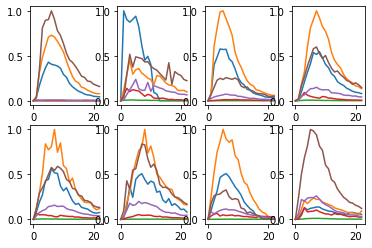

Train on detected  61  non-detected  451
Train time in seconds:  9.542070150375366


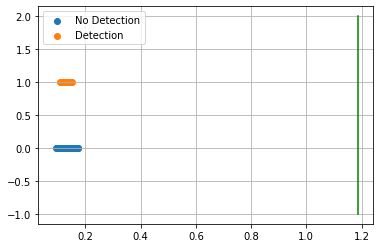

AUC 0.5
Predicted TPR 0.0
Predicted FPR 0.0
Threshold 1.1874163
-----------------------End of training---------------------------


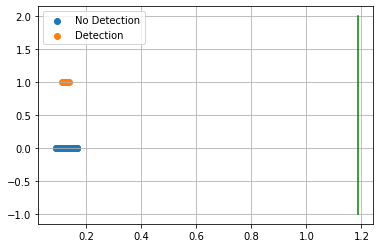

Test on detected  14  non-detected  115
F0.5 0.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 100.00%
True Positive 0.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.891     1.000     0.943       115
    detected      0.000     0.000     0.000        14

    accuracy                          0.891       129
   macro avg      0.446     0.500     0.471       129
weighted avg      0.795     0.891     0.840       129

---------------------------end of testing--------------------------------

Compound ID 3


C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and bein

[20, 47, 49, 50]


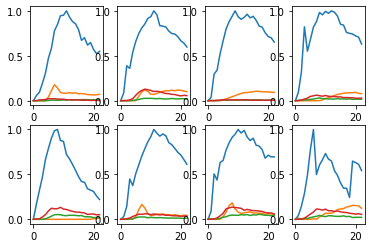

Train on detected  16  non-detected  496
Train time in seconds:  10.457073211669922


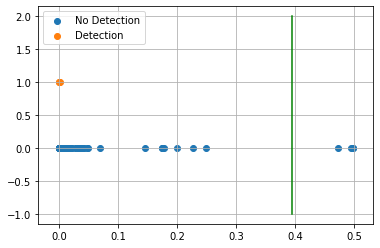

AUC 0.9627016129032258
Predicted TPR 0.9375
Predicted FPR 0.012096774193548387
Threshold 0.39507857
-----------------------End of training---------------------------


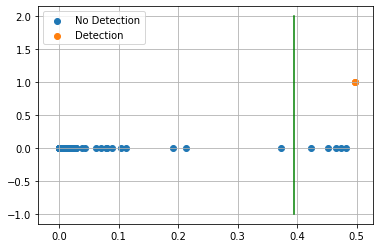

Test on detected  3  non-detected  126
F0.5 42.86%

Confusion Matrix:
True Negative 96.03%
False Positive 3.97%
False Negative 0.00%
True Positive 100.00%

Classification Report
              precision    recall  f1-score   support

       blank      1.000     0.960     0.980       126
    detected      0.375     1.000     0.545         3

    accuracy                          0.961       129
   macro avg      0.688     0.980     0.763       129
weighted avg      0.985     0.961     0.970       129

---------------------------end of testing--------------------------------

Compound ID 4
[2, 11]


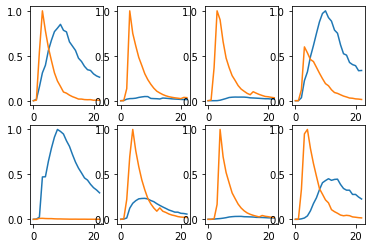

Train on detected  61  non-detected  451
Train time in seconds:  13.164120435714722


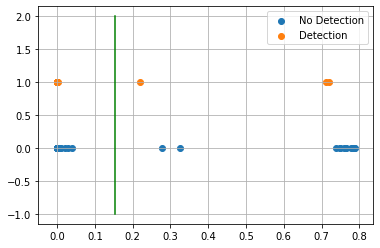

AUC 0.9988913525498891
Predicted TPR 1.0
Predicted FPR 0.0022172949002217295
Threshold 0.15288752
-----------------------End of training---------------------------


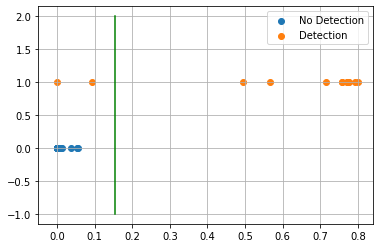

Test on detected  14  non-detected  115
F0.5 96.77%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 14.29%
True Positive 85.71%

Classification Report
              precision    recall  f1-score   support

       blank      0.983     1.000     0.991       115
    detected      1.000     0.857     0.923        14

    accuracy                          0.984       129
   macro avg      0.991     0.929     0.957       129
weighted avg      0.985     0.984     0.984       129

---------------------------end of testing--------------------------------

Compound ID 7
[16, 18, 27, 30, 46]


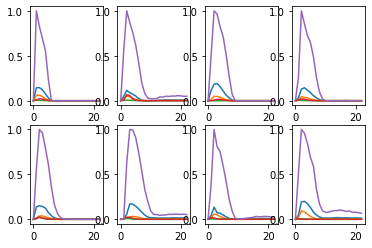

Train on detected  8  non-detected  504
Train time in seconds:  9.593069553375244


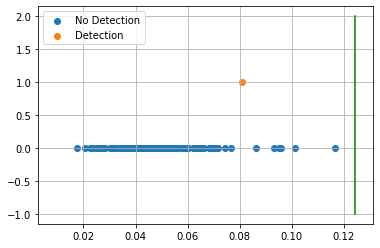

AUC 0.5615079365079365
Predicted TPR 0.125
Predicted FPR 0.001984126984126984
Threshold 0.1243591
-----------------------End of training---------------------------


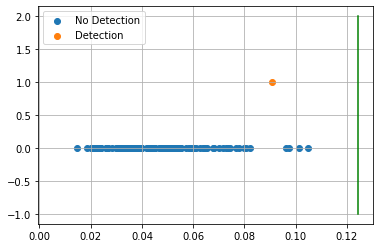

C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and bein

Test on detected  1  non-detected  128
F0.5 0.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 100.00%
True Positive 0.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.992     1.000     0.996       128
    detected      0.000     0.000     0.000         1

    accuracy                          0.992       129
   macro avg      0.496     0.500     0.498       129
weighted avg      0.985     0.992     0.988       129

---------------------------end of testing--------------------------------

Compound ID 8
[16, 18, 39, 46]


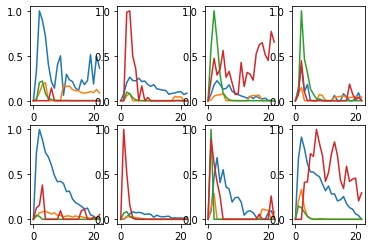

Train on detected  47  non-detected  465
Train time in seconds:  9.88106656074524


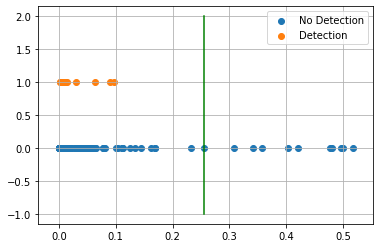

AUC 0.7456417295813313
Predicted TPR 0.5106382978723404
Predicted FPR 0.01935483870967742
Threshold 0.25506642
-----------------------End of training---------------------------


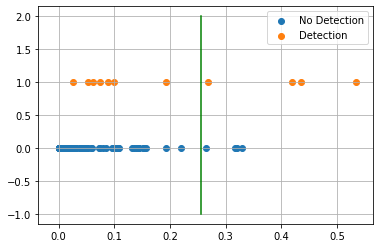

Test on detected  11  non-detected  118
F0.5 46.51%

Confusion Matrix:
True Negative 96.61%
False Positive 3.39%
False Negative 63.64%
True Positive 36.36%

Classification Report
              precision    recall  f1-score   support

       blank      0.942     0.966     0.954       118
    detected      0.500     0.364     0.421        11

    accuracy                          0.915       129
   macro avg      0.721     0.665     0.688       129
weighted avg      0.904     0.915     0.909       129

---------------------------end of testing--------------------------------

Compound ID 10
[0, 3, 4, 19, 20, 22, 23]


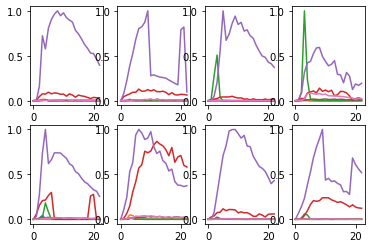

Train on detected  47  non-detected  465
Train time in seconds:  10.009071588516235


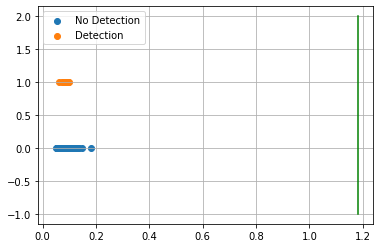

AUC 0.5
Predicted TPR 0.0
Predicted FPR 0.0
Threshold 1.1823924
-----------------------End of training---------------------------


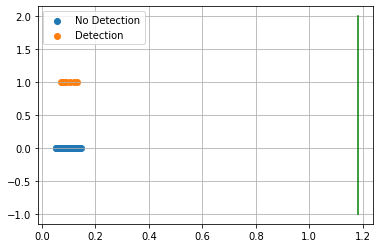

Test on detected  11  non-detected  118
F0.5 0.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 100.00%
True Positive 0.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.915     1.000     0.955       118
    detected      0.000     0.000     0.000        11

    accuracy                          0.915       129
   macro avg      0.457     0.500     0.478       129
weighted avg      0.837     0.915     0.874       129

---------------------------end of testing--------------------------------

Compound ID 13


C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and bein

[41, 42, 46]


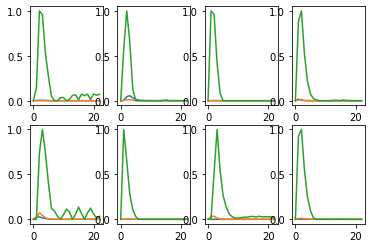

Train on detected  56  non-detected  456
Train time in seconds:  11.077075004577637


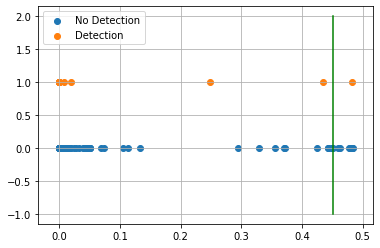

AUC 0.8930137844611529
Predicted TPR 0.8035714285714286
Predicted FPR 0.017543859649122806
Threshold 0.45037067
-----------------------End of training---------------------------


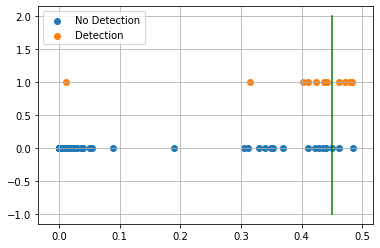

Test on detected  12  non-detected  117
F0.5 56.82%

Confusion Matrix:
True Negative 97.44%
False Positive 2.56%
False Negative 58.33%
True Positive 41.67%

Classification Report
              precision    recall  f1-score   support

       blank      0.942     0.974     0.958       117
    detected      0.625     0.417     0.500        12

    accuracy                          0.922       129
   macro avg      0.784     0.696     0.729       129
weighted avg      0.913     0.922     0.915       129

---------------------------end of testing--------------------------------

Compound ID 14
[16, 18, 46]


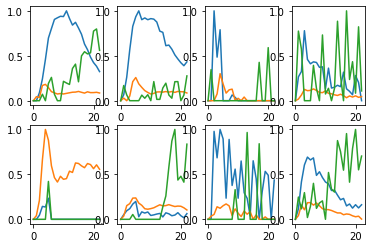

Train on detected  31  non-detected  481
Train time in seconds:  10.341082334518433


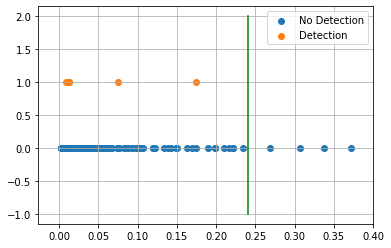

AUC 0.6841928777412649
Predicted TPR 0.3870967741935484
Predicted FPR 0.018711018711018712
Threshold 0.24123824
-----------------------End of training---------------------------


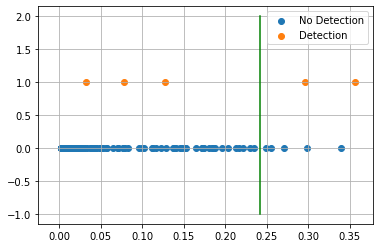

Test on detected  5  non-detected  124
F0.5 30.30%

Confusion Matrix:
True Negative 95.97%
False Positive 4.03%
False Negative 60.00%
True Positive 40.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.975     0.960     0.967       124
    detected      0.286     0.400     0.333         5

    accuracy                          0.938       129
   macro avg      0.631     0.680     0.650       129
weighted avg      0.949     0.938     0.943       129

---------------------------end of testing--------------------------------

Compound ID 15
[36, 39, 46]


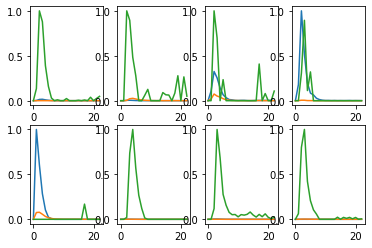

Train on detected  56  non-detected  456
Train time in seconds:  10.666054010391235


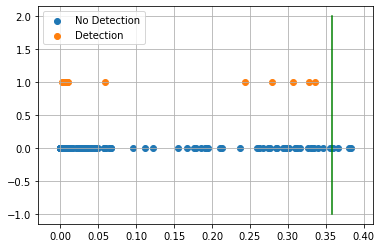

AUC 0.5258458646616541
Predicted TPR 0.07142857142857142
Predicted FPR 0.019736842105263157
Threshold 0.35883594
-----------------------End of training---------------------------


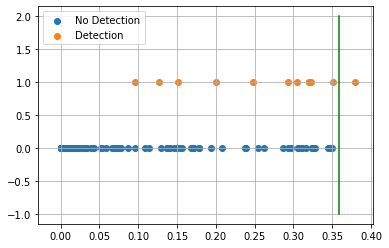

Test on detected  12  non-detected  117
F0.5 31.25%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 91.67%
True Positive 8.33%

Classification Report
              precision    recall  f1-score   support

       blank      0.914     1.000     0.955       117
    detected      1.000     0.083     0.154        12

    accuracy                          0.915       129
   macro avg      0.957     0.542     0.554       129
weighted avg      0.922     0.915     0.881       129

---------------------------end of testing--------------------------------

Compound ID 18
[19, 20, 21, 40]


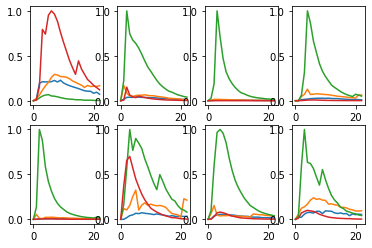

Train on detected  63  non-detected  449
Train time in seconds:  11.840061902999878


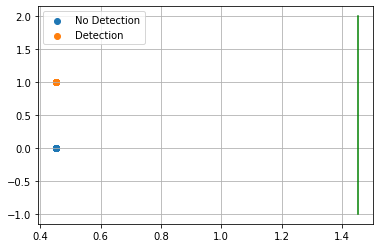

AUC 0.5
Predicted TPR 0.0
Predicted FPR 0.0
Threshold 1.4532937
-----------------------End of training---------------------------


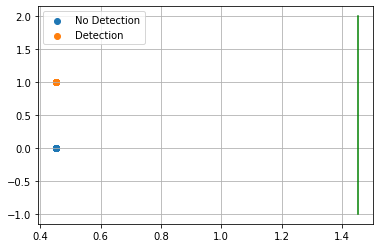

Test on detected  14  non-detected  115
F0.5 0.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 100.00%
True Positive 0.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.891     1.000     0.943       115
    detected      0.000     0.000     0.000        14

    accuracy                          0.891       129
   macro avg      0.446     0.500     0.471       129
weighted avg      0.795     0.891     0.840       129

---------------------------end of testing--------------------------------

Compound ID 19


C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and bein

[7, 8]


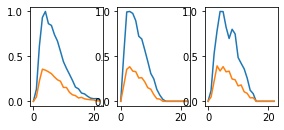

Train on detected  3  non-detected  509
Train time in seconds:  11.312057733535767


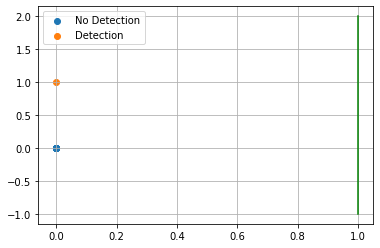

AUC 0.5
Predicted TPR 0.0
Predicted FPR 0.0
Threshold 1.0
-----------------------End of training---------------------------


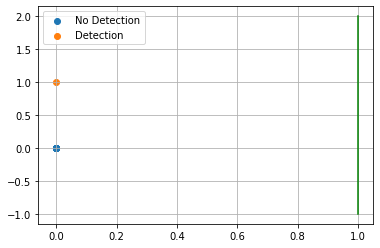

Test on detected  1  non-detected  128
F0.5 0.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 100.00%
True Positive 0.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.992     1.000     0.996       128
    detected      0.000     0.000     0.000         1

    accuracy                          0.992       129
   macro avg      0.496     0.500     0.498       129
weighted avg      0.985     0.992     0.988       129

---------------------------end of testing--------------------------------

Compound ID 21


C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and bein

[22, 23, 25, 26, 33, 34]


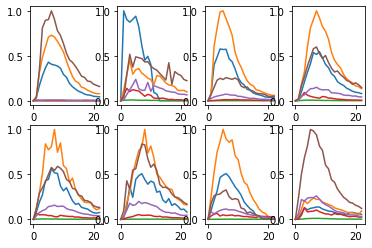

Train on detected  61  non-detected  451
Train time in seconds:  13.475065469741821


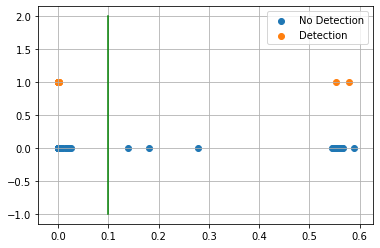

AUC 0.9698665988150195
Predicted TPR 0.9508196721311475
Predicted FPR 0.011086474501108648
Threshold 0.09861466
-----------------------End of training---------------------------


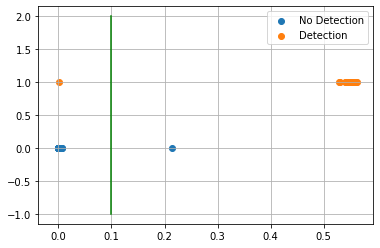

Test on detected  14  non-detected  115
F0.5 92.86%

Confusion Matrix:
True Negative 99.13%
False Positive 0.87%
False Negative 7.14%
True Positive 92.86%

Classification Report
              precision    recall  f1-score   support

       blank      0.991     0.991     0.991       115
    detected      0.929     0.929     0.929        14

    accuracy                          0.984       129
   macro avg      0.960     0.960     0.960       129
weighted avg      0.984     0.984     0.984       129

---------------------------end of testing--------------------------------

Compound ID 22
[35, 37, 38]


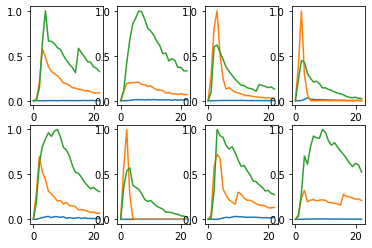

Train on detected  65  non-detected  447
Train time in seconds:  11.339058637619019


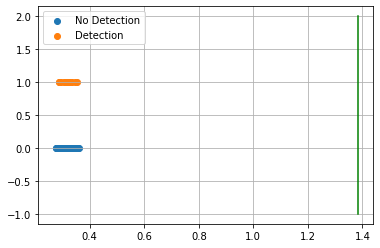

AUC 0.5
Predicted TPR 0.0
Predicted FPR 0.0
Threshold 1.3840158
-----------------------End of training---------------------------


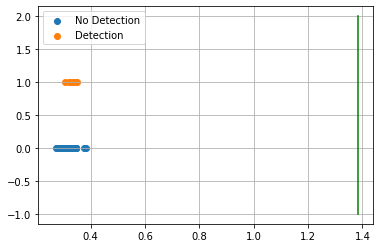

Test on detected  14  non-detected  115
F0.5 0.00%

Confusion Matrix:
True Negative 100.00%
False Positive 0.00%
False Negative 100.00%
True Positive 0.00%

Classification Report
              precision    recall  f1-score   support

       blank      0.891     1.000     0.943       115
    detected      0.000     0.000     0.000        14

    accuracy                          0.891       129
   macro avg      0.446     0.500     0.471       129
weighted avg      0.795     0.891     0.840       129

---------------------------end of testing--------------------------------
 Compounds  Tr-TPR  Tr-FPR Threshold ROC AUC Score Test-TPR Test-FPR
     0        0.00%  0.00%   118.74%     50.00%       0.00%   0.00% 
     3       93.75%  1.21%    39.51%     96.27%     100.00%   3.97% 
     4      100.00%  0.22%    15.29%     99.89%      85.71%   0.00% 
     7       12.50%  0.20%    12.44%     56.15%       0.00%   0.00% 
     8       51.06%  1.94%    25.51%     74.56%      36.36%   3.39% 
    10

C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Brian.Mello\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and bein

In [32]:
compound_id_to_extra_features_results = dict()
for compound_id, mass_pair_ids_to_dataset in compound_ids_to_mass_pair_ids_to_dataset.items():
    mass_pair_ids_to_features = compound_ids_to_mass_pair_ids_to_features[compound_id]
    print()
    print("Compound ID", compound_id)
    model, testset, predicted_tpr, predicted_fpr, threshold, auc_score = build_train_model_with_extra_features(mass_pair_ids_to_dataset, mass_pair_ids_to_features)
    tpr, fpr = test_extra_features_model_and_output_results(model, testset, threshold)
    compound_id_to_extra_features_results[compound_id] = predicted_tpr, predicted_fpr, threshold, auc_score, tpr, fpr
    
extra_features_results_dataframe = compound_id_results_to_dataframe(compound_id_to_extra_features_results)

print(extra_features_results_dataframe.to_string(index=False, justify='center'))
print()

Attempting to incorporate width and position into the network has resulted in much worse results. It seems that the best option is to go ahead with the previously refined model. I do believe that my refined model could do even better if we had a larger sample set.

In [42]:
def get_compound_ids_to_substrate_to_masspair_to_dataset(merged_data_set, compound_id_to_mass_pair_ids):
    merged_data_set = merged_data_set.copy()
    compounds_to_detection_data_set = merged_data_set.groupby(['detection']).groups
    substrate_to_group_indices = merged_data_set.groupby(['substrate']).groups
    mass_pair_id_to_group_indices = merged_data_set.groupby(['mass_pair_id']).groups
    timestep_columns = merged_data_set.columns[10:]
    
    compound_ids_to_substrate_to_masspair_to_dataset = dict()
    for compounds, compound_detection_indices in sorted(compounds_to_detection_data_set.items()):
        if compounds == 'None':
            continue
        else:
            compound_ids = string_to_list_of_int(compounds)
        for compound_id in compound_ids:
            if compound_id not in compound_id_to_mass_pair_ids:
                continue #skip
            if compound_id not in compound_ids_to_substrate_to_masspair_to_dataset:
                compound_ids_to_substrate_to_masspair_to_dataset[compound_id] = dict()
            for substrate, substrate_indices in substrate_to_group_indices.items():
                #intersection of group indices
                detection_substrate_indices = list(set(substrate_indices).intersection(set(compound_detection_indices)))

                if substrate not in compound_ids_to_substrate_to_masspair_to_dataset[compound_id]:
                    compound_ids_to_substrate_to_masspair_to_dataset[compound_id][substrate] = dict()
                for mass_pair_id in compound_id_to_mass_pair_ids[compound_id]:
                    mass_pair_indices = mass_pair_id_to_group_indices[mass_pair_id]
                    
                    detection_substrate_mass_pair_indices = list(set(detection_substrate_indices).intersection(set(mass_pair_indices)))
                    detection_dataset = merged_data_set.iloc[detection_substrate_mass_pair_indices][timestep_columns]
                    detection_dataset = detection_dataset.assign(detection=compound_id)
                    #print(set(dataset['detection']))

                    if mass_pair_id not in compound_ids_to_substrate_to_masspair_to_dataset[compound_id][substrate]:
                        compound_ids_to_substrate_to_masspair_to_dataset[compound_id][substrate][mass_pair_id] = detection_dataset
                    else:
                        pd.concat([compound_ids_to_substrate_to_masspair_to_dataset[compound_id][substrate][mass_pair_id], detection_dataset])
                #sort mass pairs
                compound_ids_to_substrate_to_masspair_to_dataset[compound_id][substrate] = dict(sorted(compound_ids_to_substrate_to_masspair_to_dataset[compound_id][substrate].items()))
            #sort substrates    
            compound_ids_to_substrate_to_masspair_to_dataset[compound_id] = dict(sorted(compound_ids_to_substrate_to_masspair_to_dataset[compound_id].items()))
    compound_ids_to_substrate_to_masspair_to_dataset = dict(sorted(compound_ids_to_substrate_to_masspair_to_dataset.items()))                
    return compound_ids_to_substrate_to_masspair_to_dataset
    
compound_ids_to_substrate_to_masspair_to_dataset = get_compound_ids_to_substrate_to_masspair_to_dataset(merged_data_set, compound_id_to_mass_pair_ids)

for compound_id, substrate_to_masspair_to_dataset in compound_ids_to_substrate_to_masspair_to_dataset.items():
    print("Compound", compound_id)
    for substrate, masspair_to_dataset in substrate_to_masspair_to_dataset.items():
        if substrate == "Blank":
            continue
        dataset = list(masspair_to_dataset.values())[0]
        print("Substrate", substrate, "# of samples", int(len(dataset)))
    

Compound 0
Substrate BG1 # of samples 0
Substrate BG4 # of samples 0
Substrate CB4 # of samples 0
Substrate Med4 # of samples 0
Substrate None # of samples 75
Substrate Per3 # of samples 0
Substrate Per5 # of samples 0
Substrate Teflon # of samples 0
Compound 3
Substrate BG1 # of samples 0
Substrate BG4 # of samples 0
Substrate CB4 # of samples 0
Substrate Med4 # of samples 0
Substrate None # of samples 3
Substrate Per3 # of samples 0
Substrate Per5 # of samples 11
Substrate Teflon # of samples 5
Compound 4
Substrate BG1 # of samples 0
Substrate BG4 # of samples 0
Substrate CB4 # of samples 0
Substrate Med4 # of samples 0
Substrate None # of samples 75
Substrate Per3 # of samples 0
Substrate Per5 # of samples 0
Substrate Teflon # of samples 0
Compound 7
Substrate BG1 # of samples 0
Substrate BG4 # of samples 0
Substrate CB4 # of samples 0
Substrate Med4 # of samples 0
Substrate None # of samples 9
Substrate Per3 # of samples 0
Substrate Per5 # of samples 0
Substrate Teflon # of samples

Above is a list of all of the detection samples broken down by substrate. We know that depending on the substrate and the tested compound the shapes of the lines do change. According to this data we should perform best on the compounds that have a high amount of samples within each substrate. For example, compounds 0 and 4 should perform well because they have samples only within the No substrate category therefore they will perform well because their are many good samples to train, validate and test on. Our model struggled on compound 8 giving an average accuracy between ~27-54%. By looking at the distribution of data we can understand why. This might be the kind of compound that needs more than 10 samples per category to train a good model. Depending on how the data is shuffled for train, validate, test our model may not do very well. Same reasoning goes for compounds 13 and 18.

## Justification

In [34]:
print(final_results_dataframe.to_string(index=False, justify='center'))

 Comp.   TPR     FPR   Thresh. ROC Score Test-TPR Test-FPR      Type     
   0     96.72%  1.77%  16.81%    97.47%   92.86%   0.87%            Fil.
   3     93.75%  0.60%  25.39%    96.57%  100.00%   0.00%   Non-fil. Adj.
   4    100.00%  0.22%   1.06%    99.89%   85.71%   0.00%   Non-fil. Adj.
   7    100.00%  1.19%  13.67%    99.40%    0.00%   1.56%           Orig.
   8     57.45%  1.72%  24.19%    77.86%   45.45%   1.69%   Non-fil. Adj.
  10    100.00%  0.22%  85.45%    99.89%  100.00%   0.00%      Filt. Adj.
  13     98.21%  1.10%  68.97%    98.56%   83.33%   4.27%      Filt. Adj.
  14     35.48%  1.46%  23.58%    67.01%   40.00%   4.03%            Fil.
  15    100.00%  0.00%  76.56%   100.00%   91.67%   0.00%      Filt. Adj.
  18     82.54%  1.56%  70.73%    90.49%   64.29%   3.48%   Non-fil. Adj.
  19    100.00%  0.00%  38.33%   100.00%    0.00%   0.00%            Fil.
  21     95.08%  0.44%  47.22%    97.32%   92.86%   0.87%           Orig.
  22    100.00%  0.00%  35.78%   100.0

If we exclude the results of compounds, 7, 14 and 19, six out of the remaining 10 compounds meet our benchmark of 90% or higher true positive rate and have a false positive rate of less than 2%. Compounds 4 and 13 are close and may just need more sample data to reach our benchmark. I would have thought compound 4 and 18 would have exceeded our benchmark as well, but for some reason they have not. One thing I think I would change is making the samples that have the detection of [21, 0, 18, 4] compounds be a separate model rather than split up into their respective models. This kind of sample is known as a confidence check and is a premade solution that is used to verify the system is calibrated for use. I have noticed that the shapes of our mass pair lines do slightly change when tested within a confidence check and by themselves. This can be observed in compounds 18 and 21. I think perhaps that both these compounds would perform even better without the addition of the confidence check data. By creating a confidence check model there will probably be more features that our CNN can use to better determine a detection. As previously stated, the compounds that performed poorly did not have enough sample data to train on. Looking at how well some compounds did do I think it is a good indicator that the model will work well. With some additional samples and refinement, I could meet my intended benchmark.

# Conclusion

## Free form Visualization

Notes: A visualization has been provided that emphasizes an important quality about the project with thorough discussion. Visual cues are clearly defined.

In [37]:
def plot_visuals(mass_pair_ids_to_dataset):
    mass_pair_ids_to_dataset_copy = mass_pair_ids_to_dataset.copy()
    intensities_and_outputs = np.stack(list(mass_pair_ids_to_dataset_copy.values()), axis=1)
    #validate
    #for i, (mass_pair_ids, dataset) in enumerate(mass_pair_ids_to_dataset.items()):
    #    if not np.array_equal(intensities_and_outputs[1,i], dataset.to_numpy()[1]):
    #        print("stack fail")
    #        break
    X = intensities_and_outputs[:,:,:-1]

    #normalize
    def normalize(array):
        for i, data in enumerate(array):
            array[i] = np.nan_to_num(data/np.amax(data))
        return array

    X = normalize(X)
    
    y = intensities_and_outputs[:,0,-1]#all of axis 1 will have same value
    #convert y to binary form
    y = (y >= 0).astype(int)

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=7)
    
    detected_count = sum(y_train)
    non_detected_count = len(y_train) - detected_count
    
    arange = np.arange(X.shape[-1])

    fig = plt.figure()
    
    plot_count = detected_count if detected_count < 8 else 8
    
    detected_train_X = X_train[np.where(y_train > 0)]
    
    mass_pairs = list(mass_pair_ids_to_dataset_copy.keys())
    subplot = 241
    for sample_index in range(plot_count):
        ax = fig.add_subplot(subplot)
        subplot += 1
    
        
        for mass_pair_index, array in enumerate(detected_train_X[sample_index]):
            lines = ax.plot(arange, array, label=mass_pairs[mass_pair_index])
        
        ax.legend(loc='upper right')

    plt.subplots_adjust(right=3, top=3)
    plt.show()

Compound 0
Substrate None


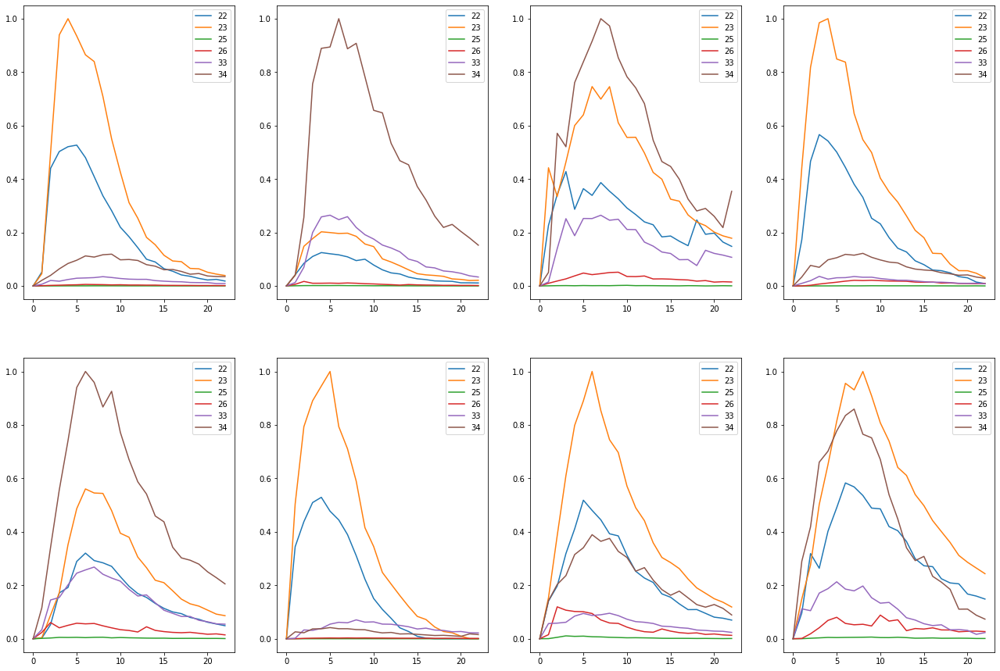

Compound 3
Substrate None


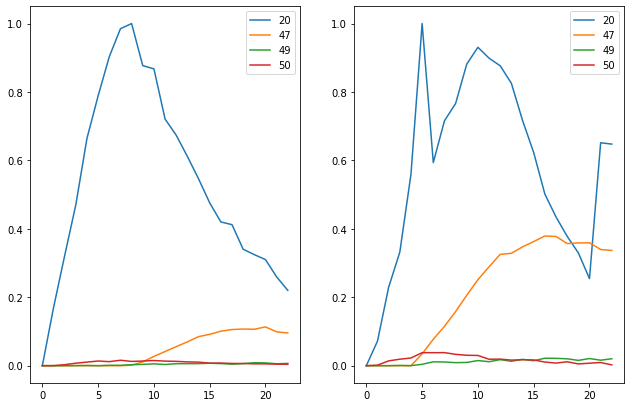

Substrate Per5


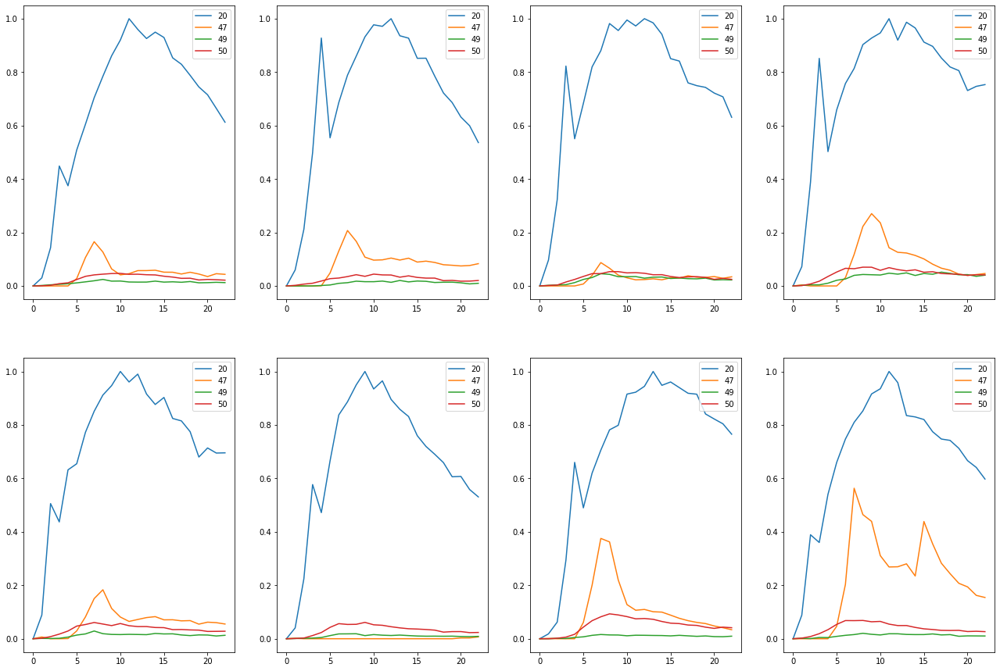

Substrate Teflon


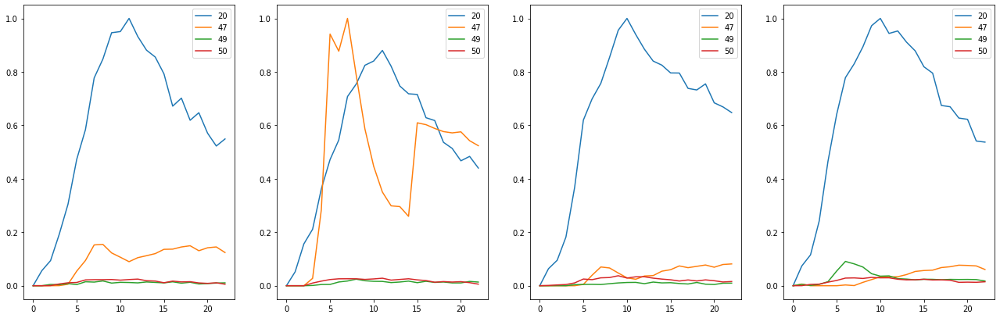

Compound 4
Substrate None


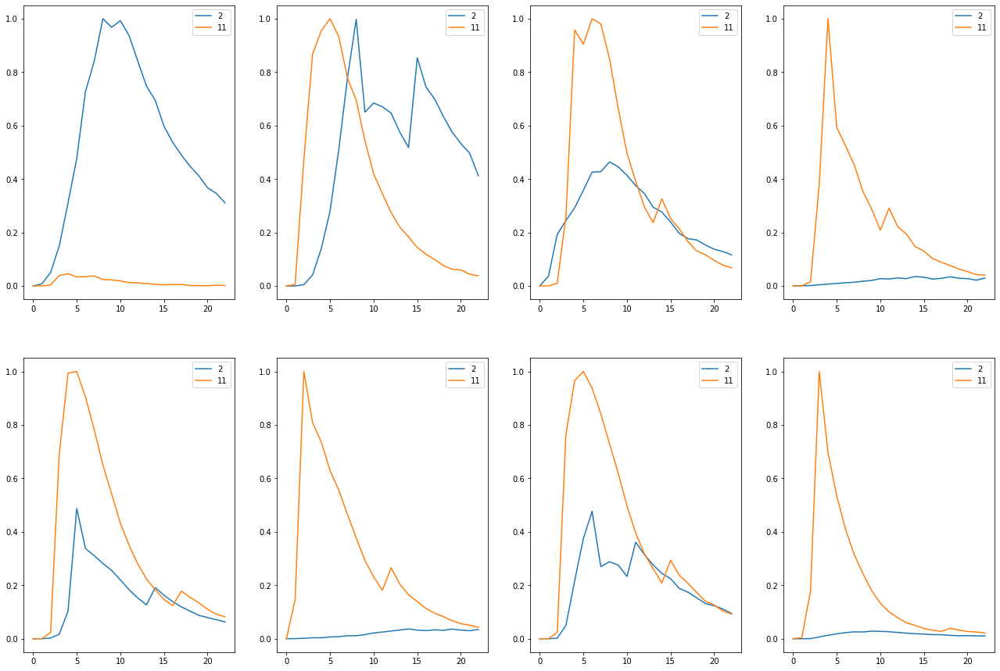

Compound 7
Substrate None


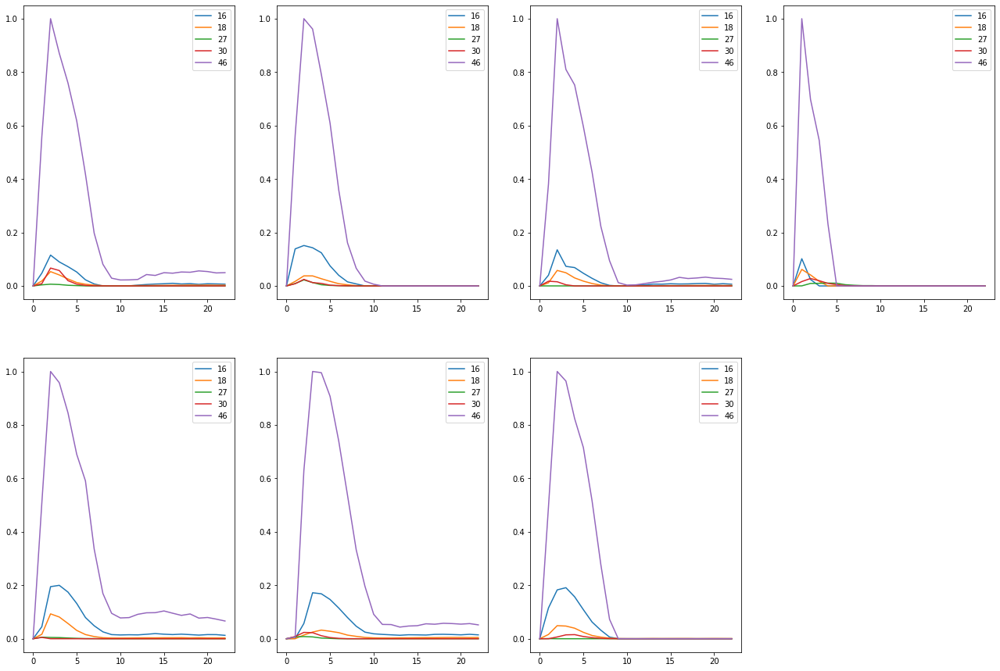

Compound 8
Substrate BG1


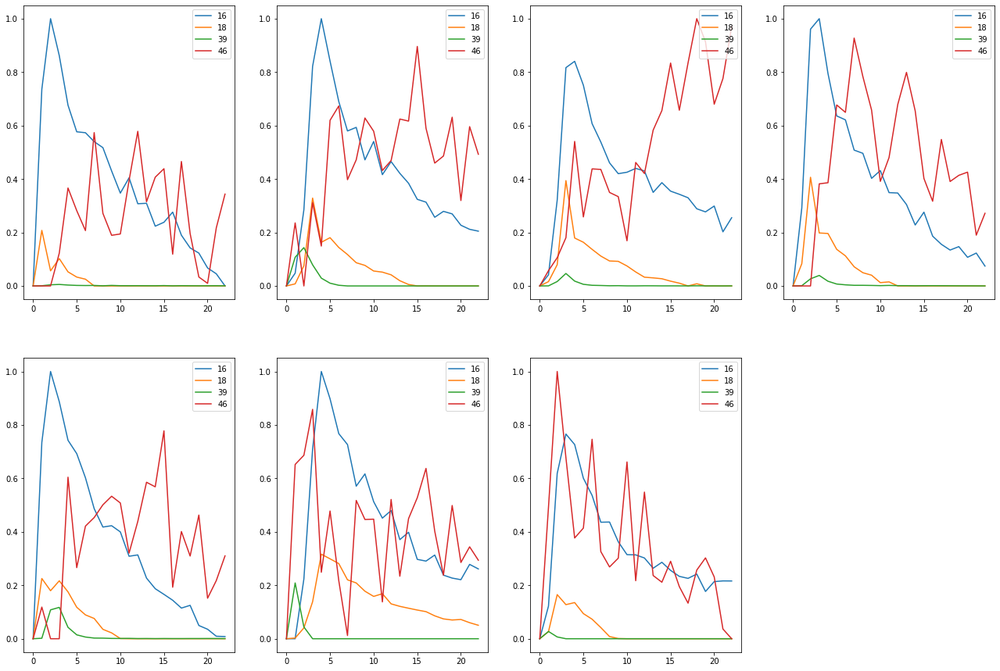

Substrate BG4


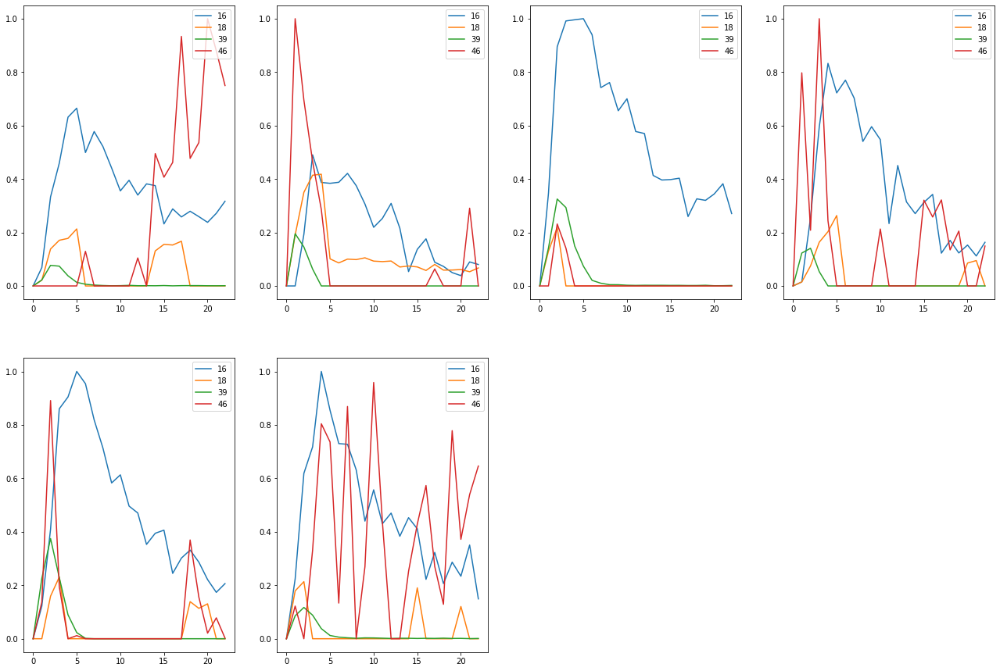

Substrate CB4


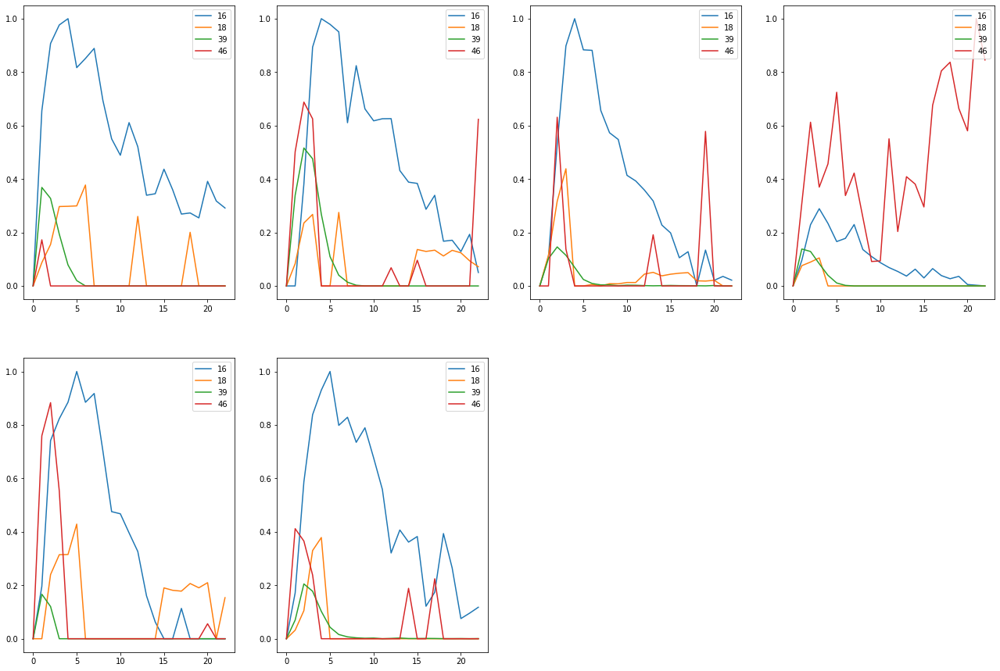

Substrate Med4


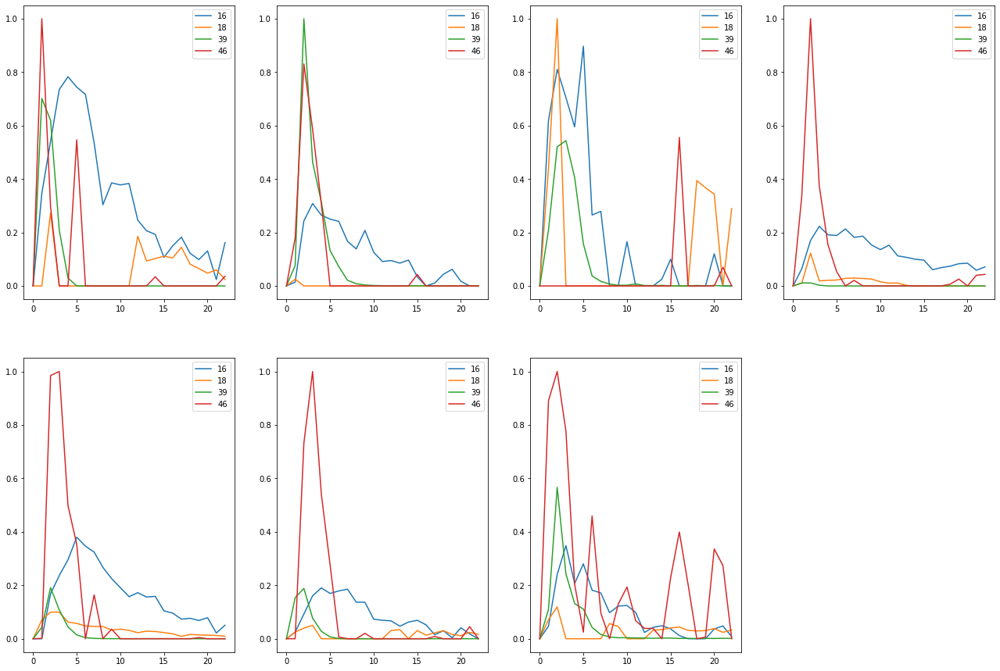

Substrate None


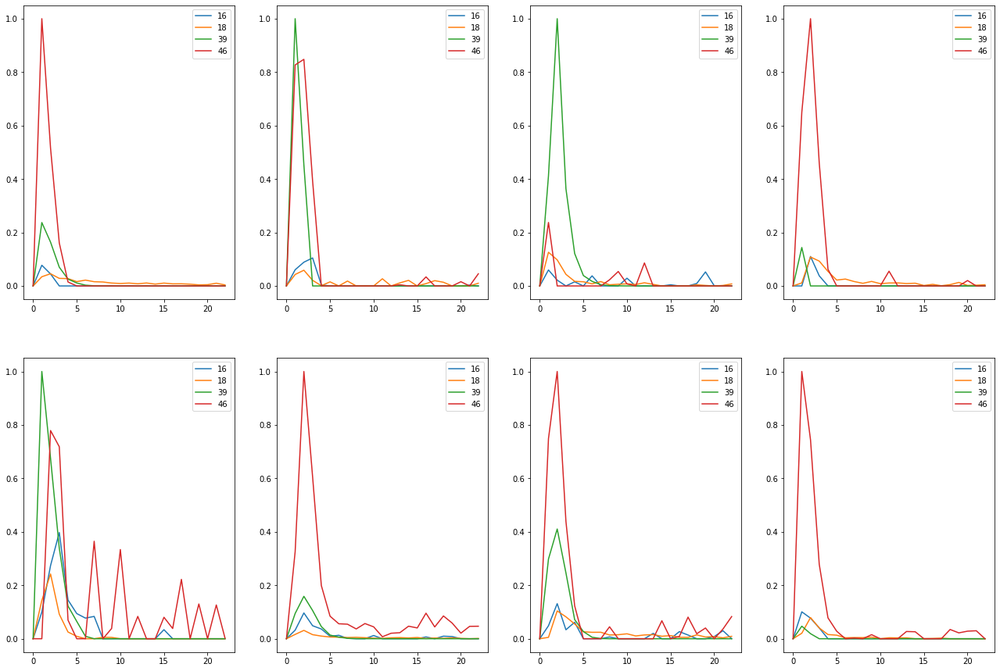

Substrate Per3


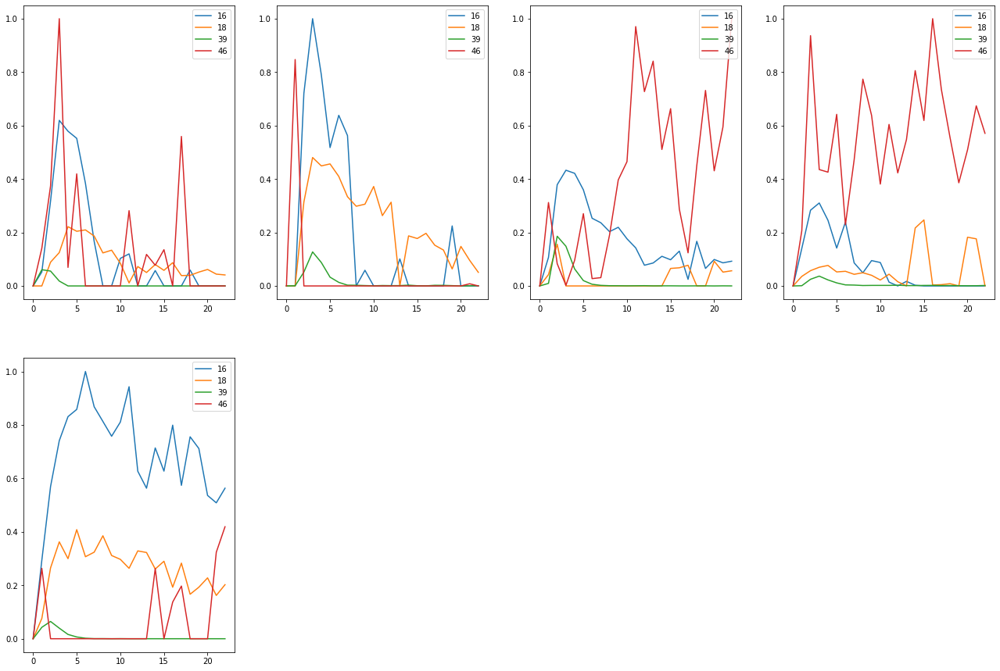

Substrate Per5


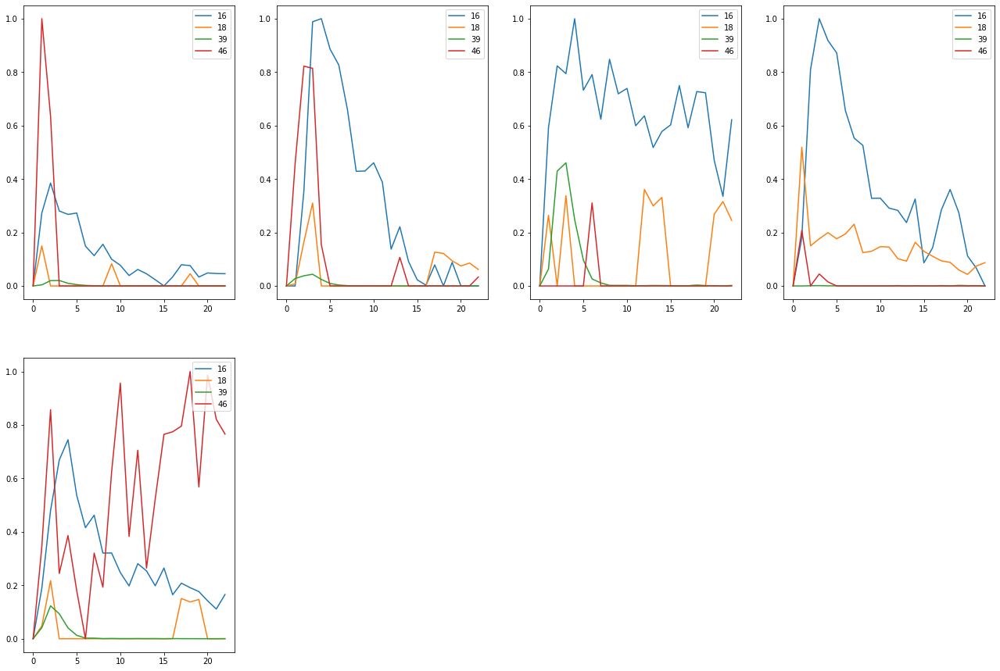

Compound 10
Substrate BG1


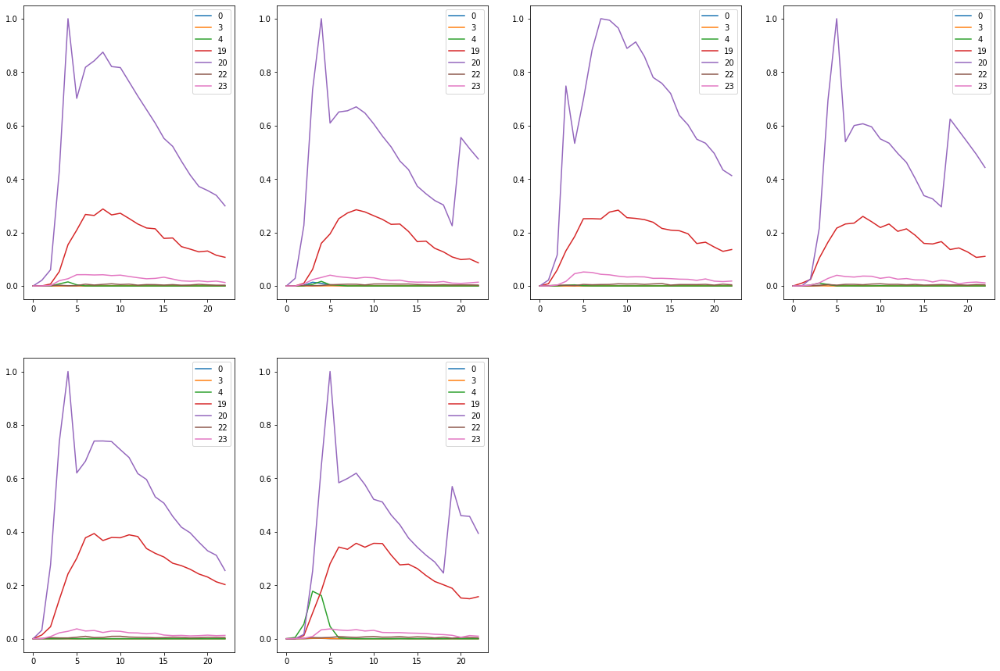

Substrate BG4


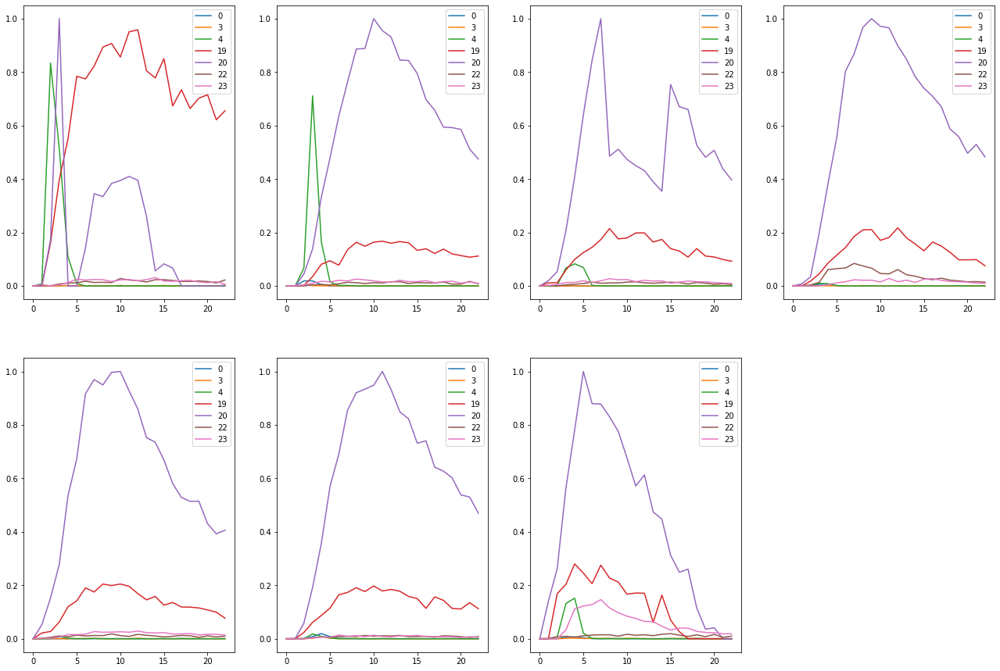

Substrate CB4


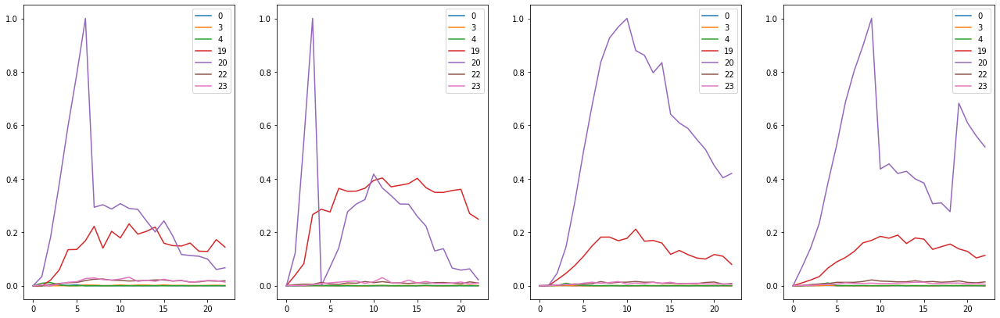

Substrate Med4


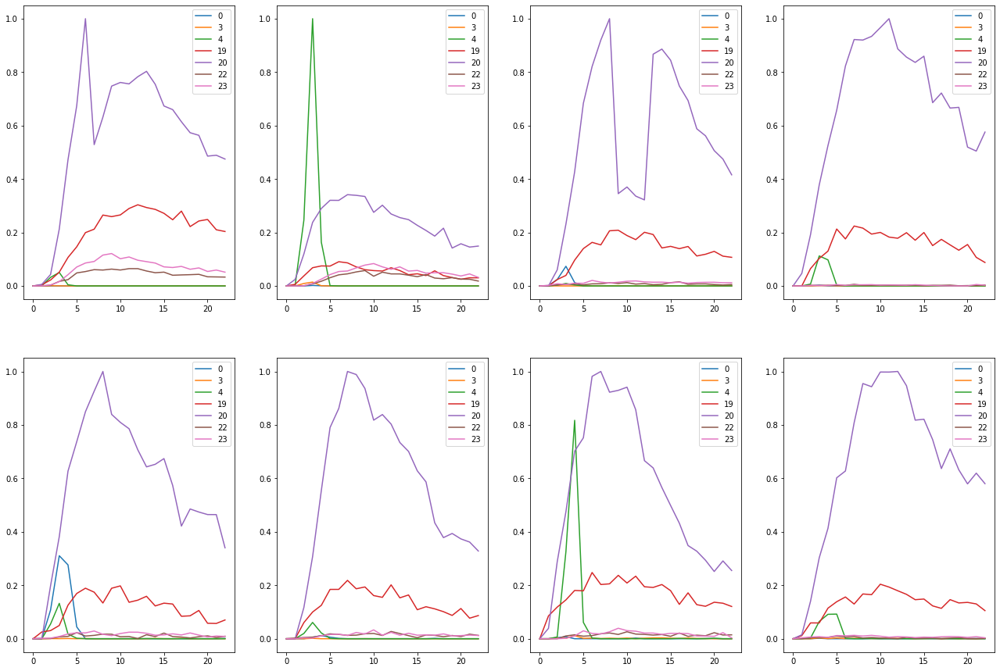

Substrate None


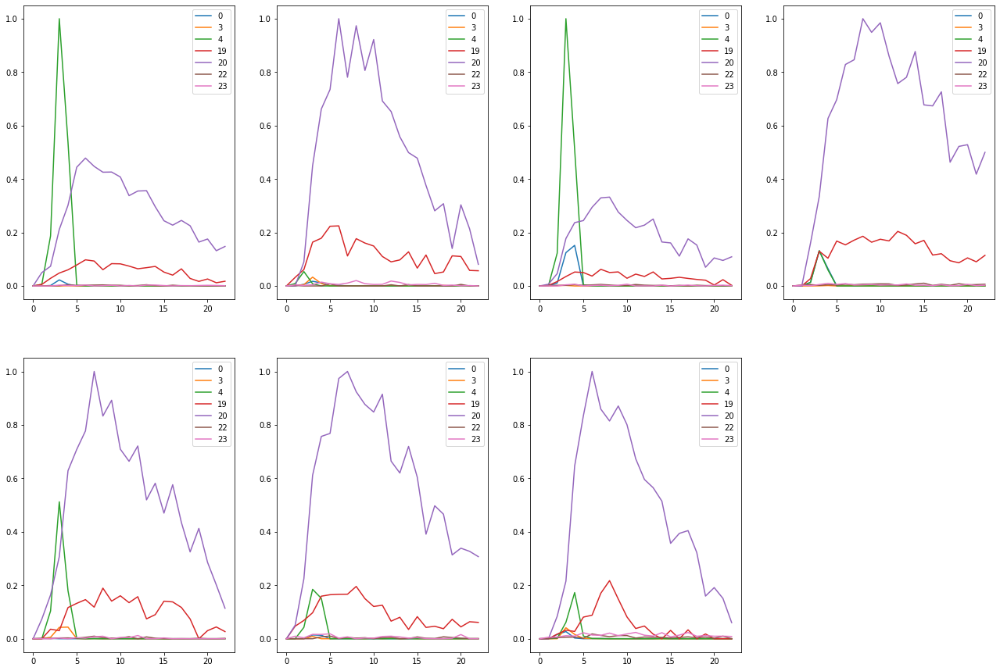

Substrate Per3


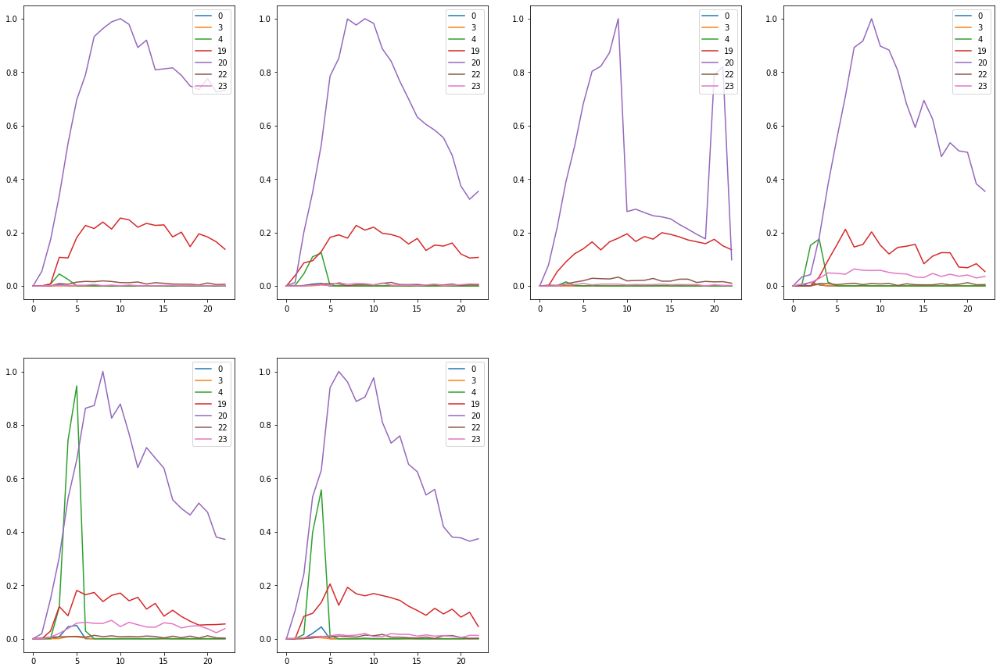

Substrate Per5


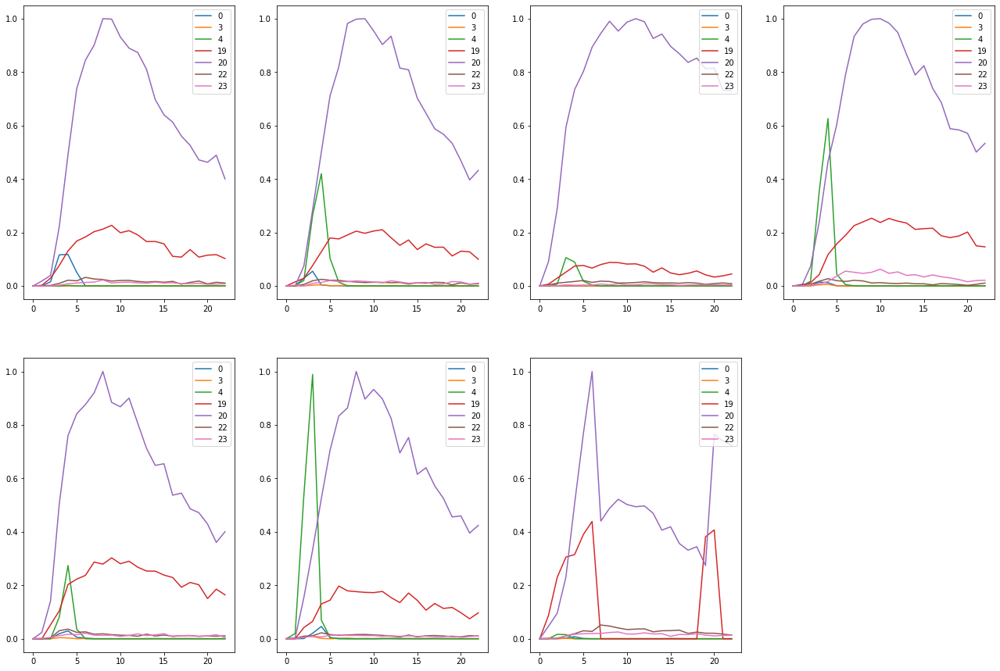

Compound 13
Substrate BG1


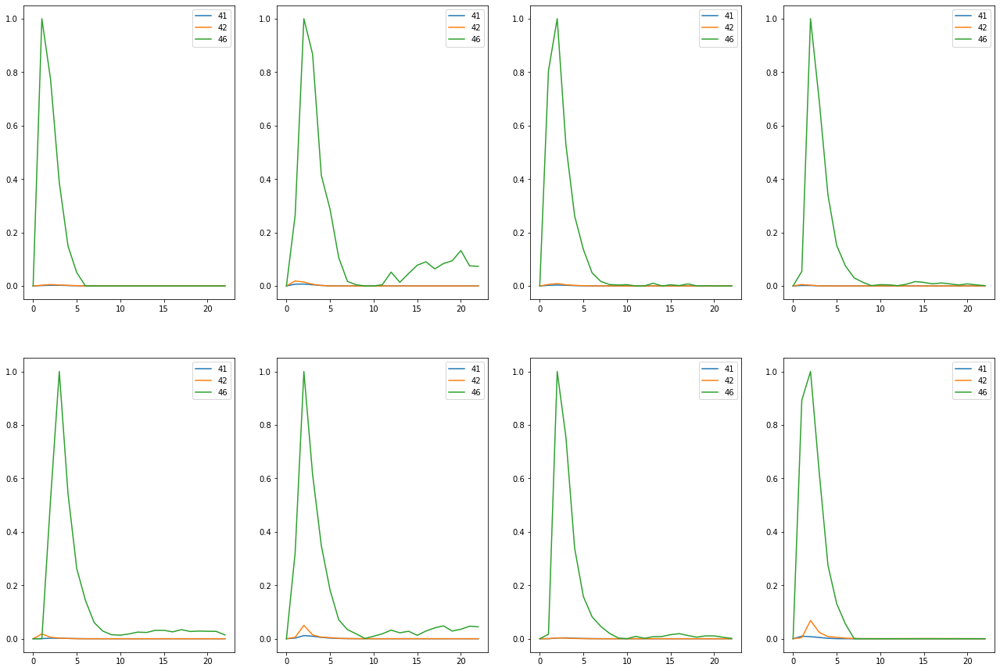

Substrate BG4


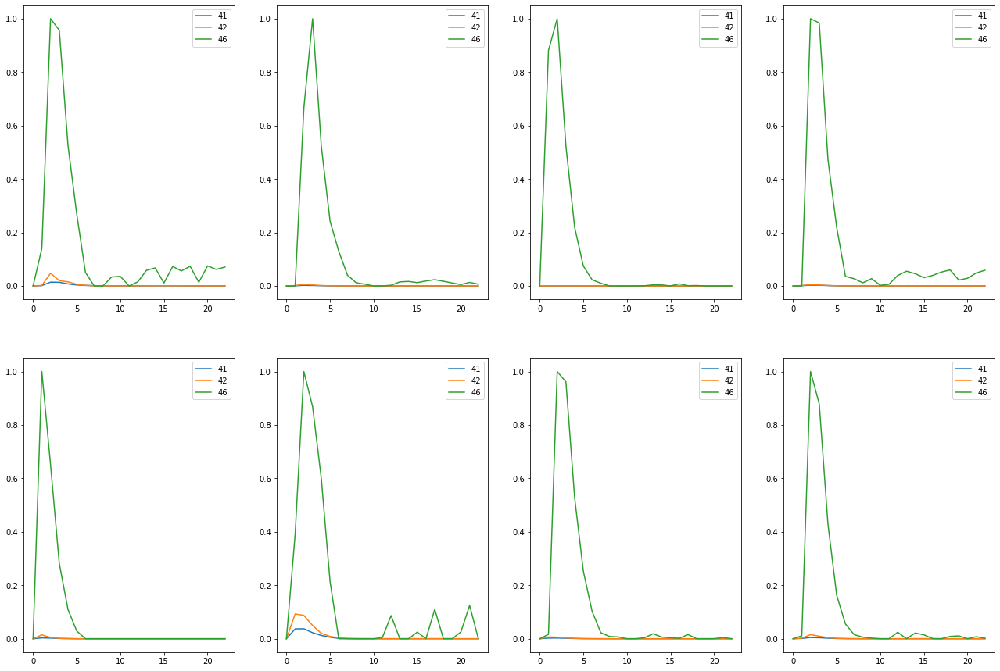

Substrate CB4


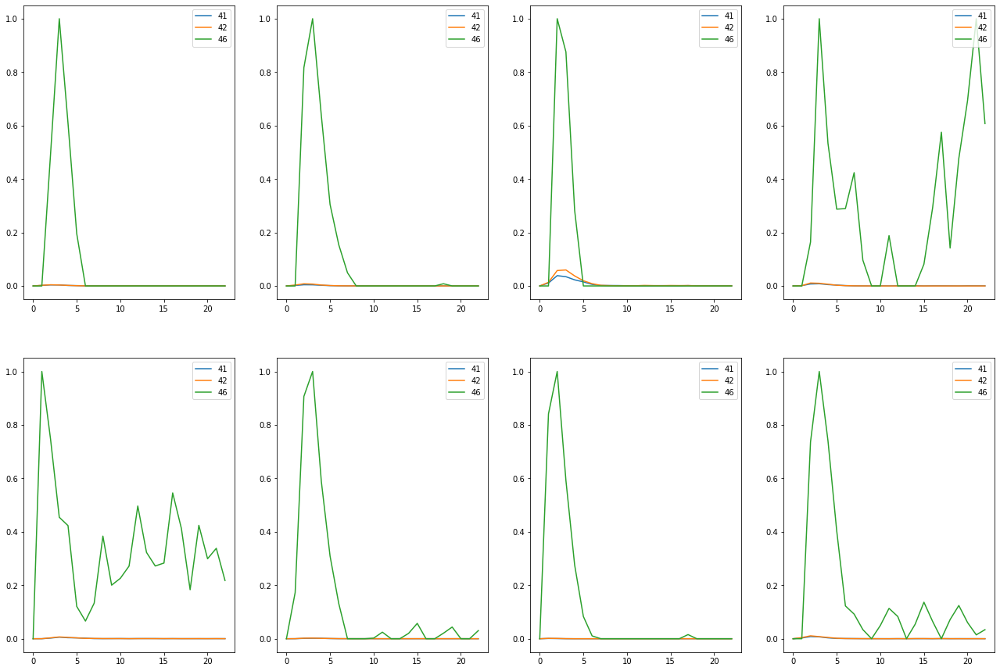

Substrate Med4


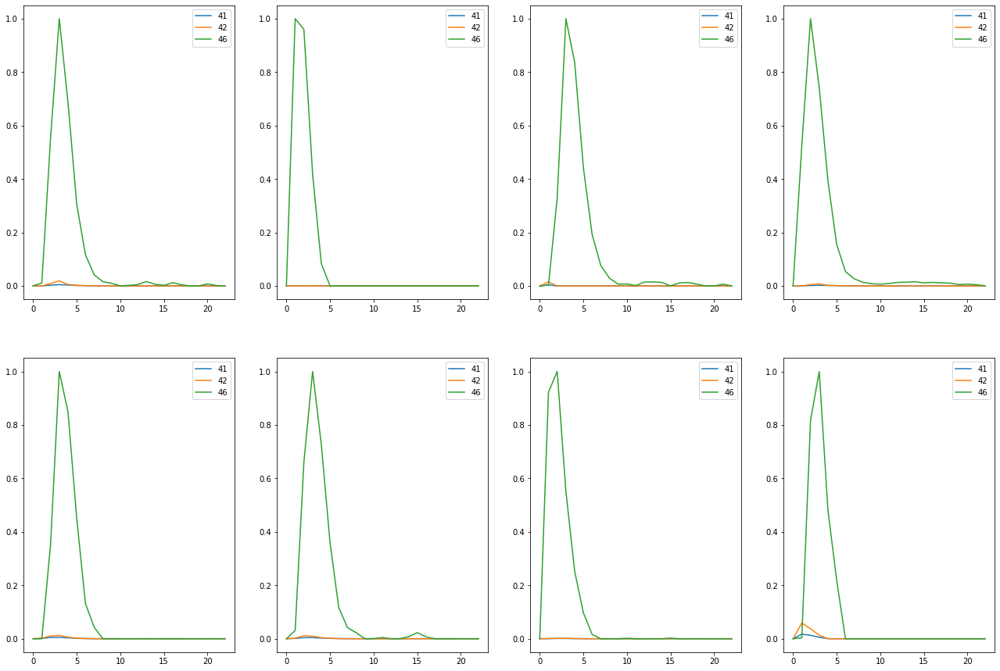

Substrate None


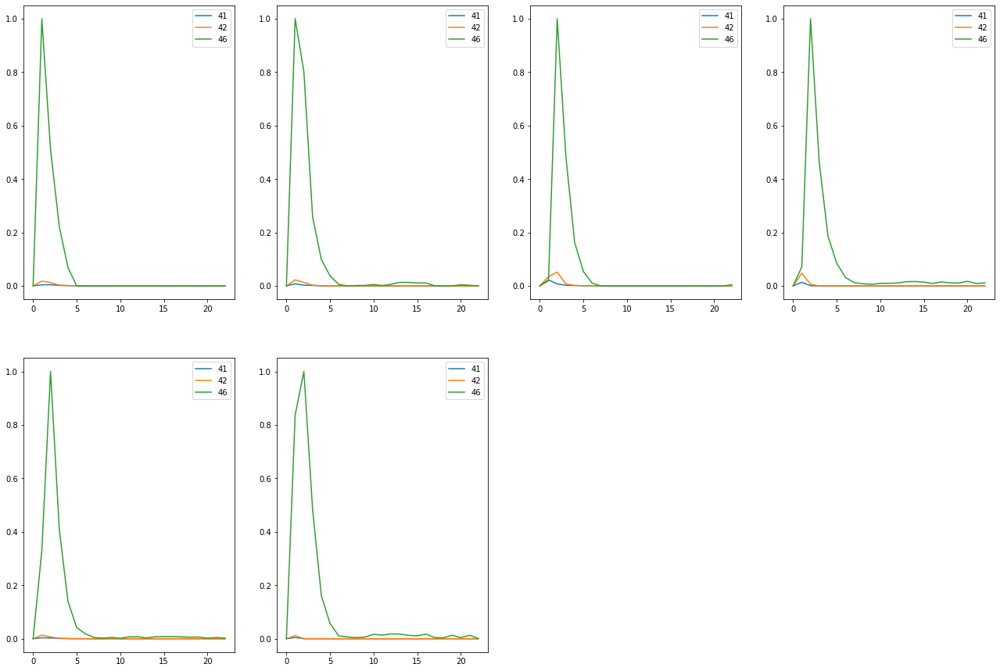

Substrate Per3


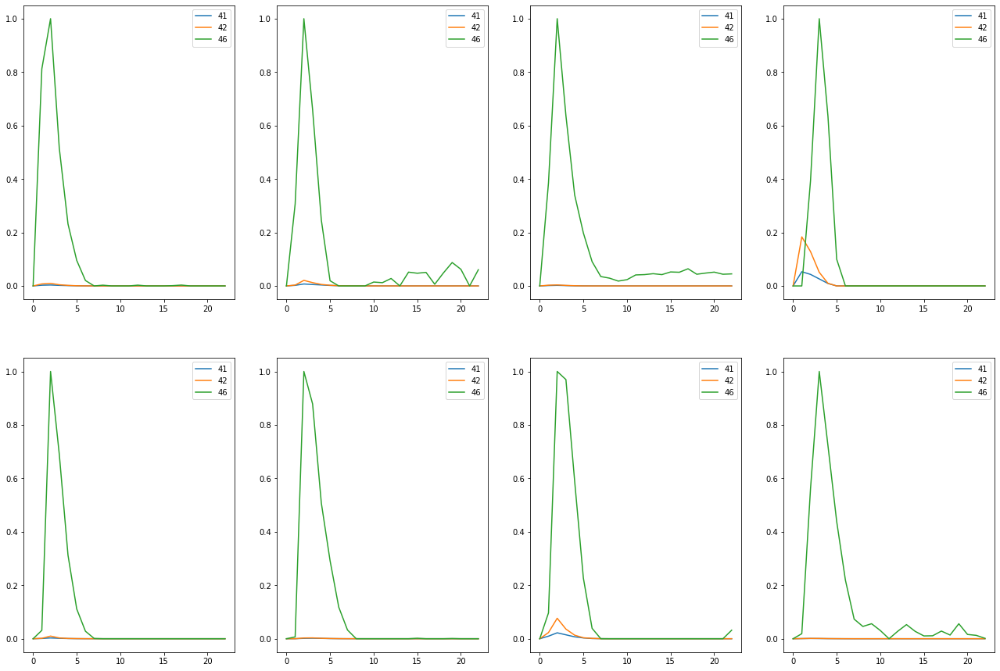

Substrate Per5


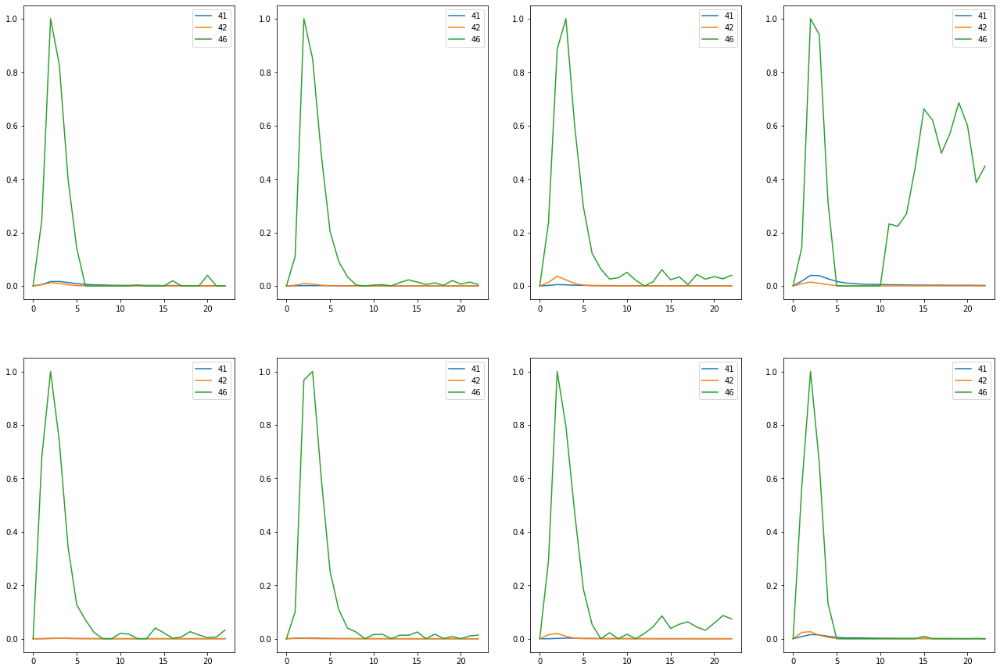

Compound 14
Substrate None


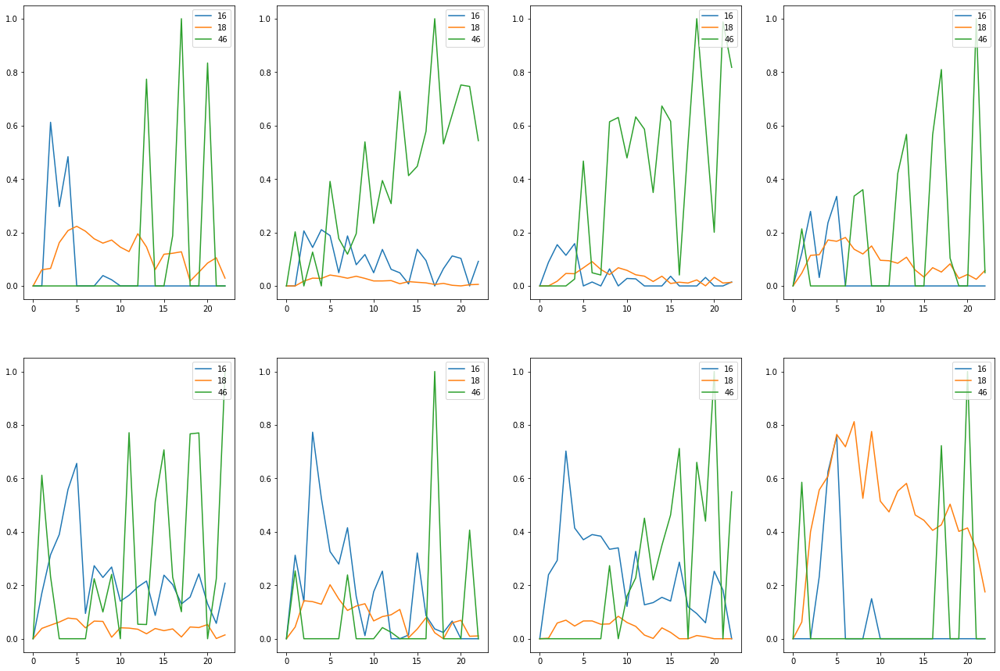

Substrate Per5


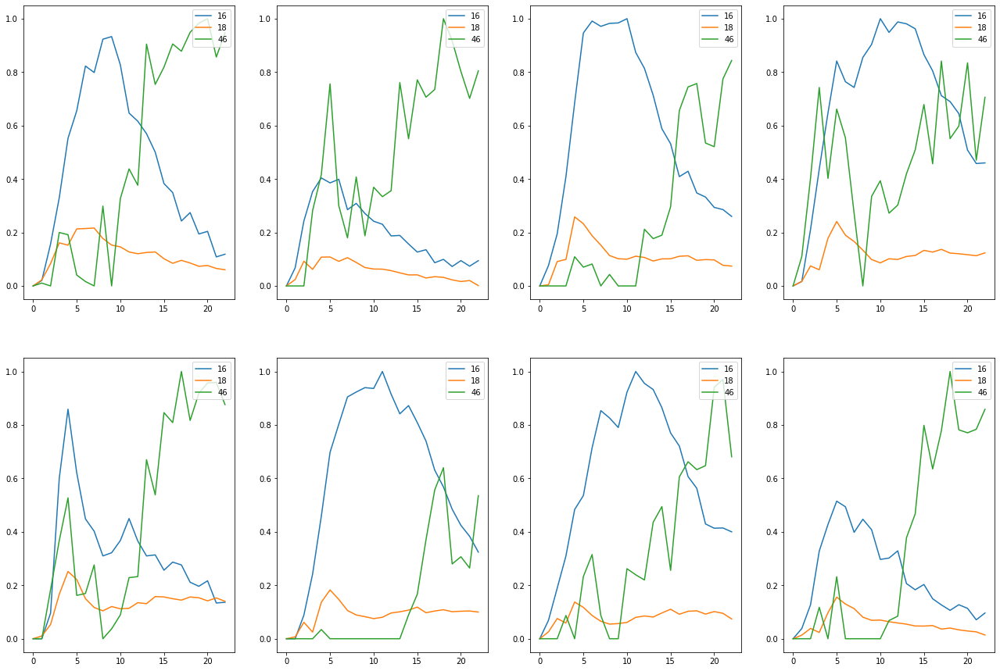

Substrate Teflon


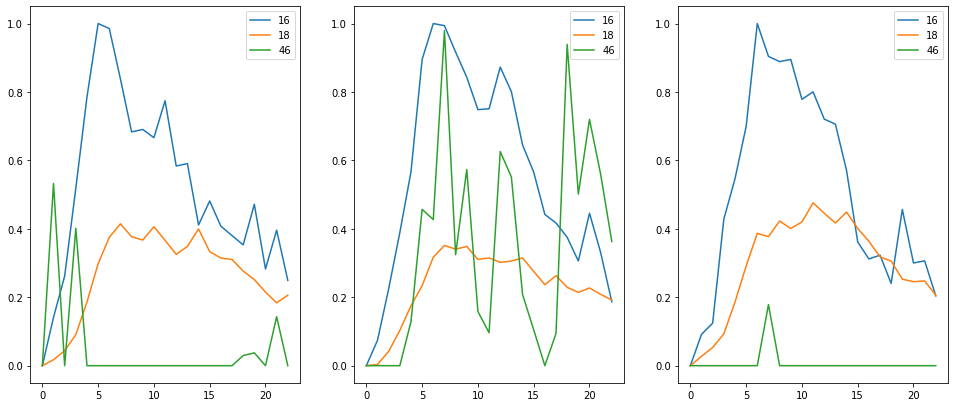

Compound 15
Substrate BG1


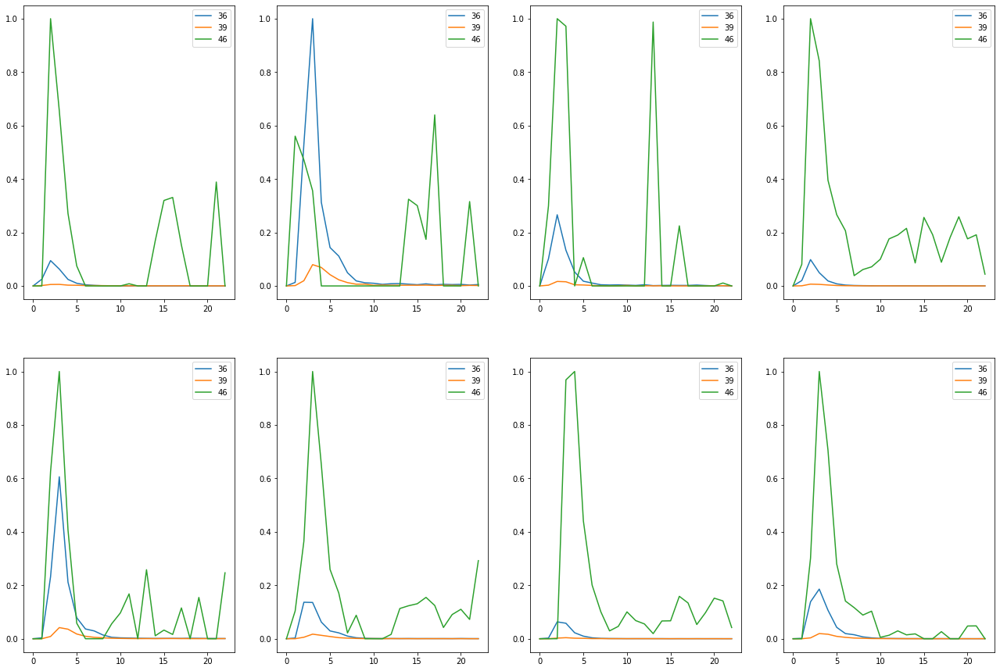

Substrate BG4


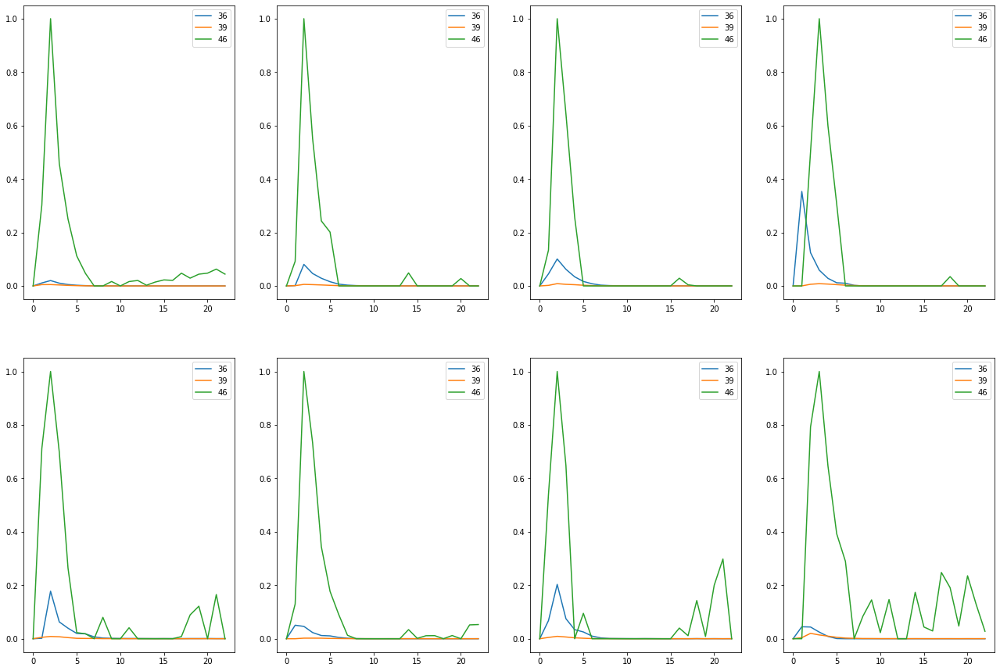

Substrate CB4


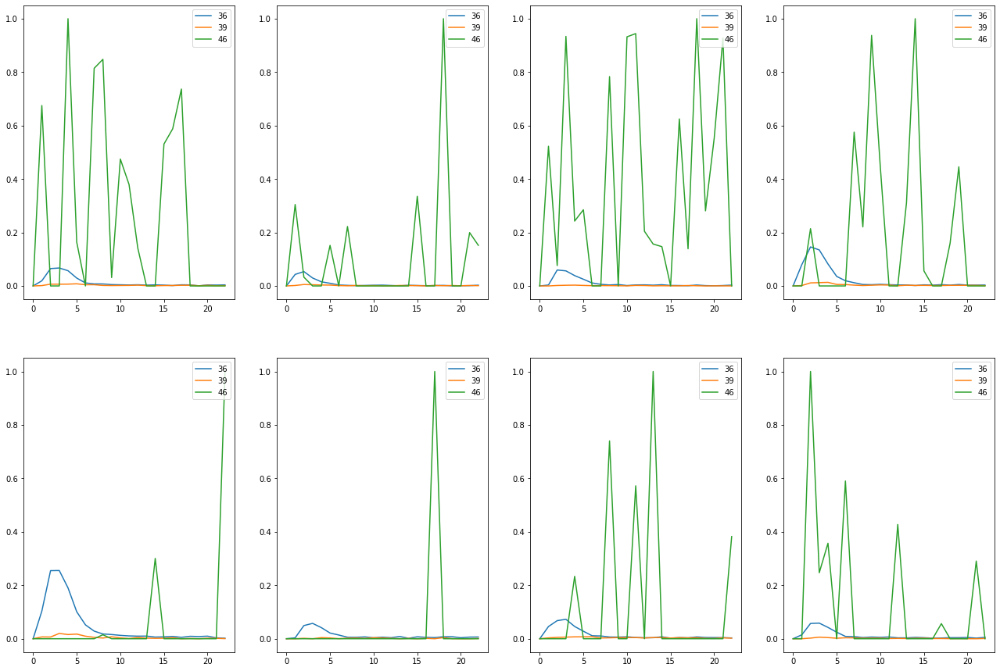

Substrate Med4


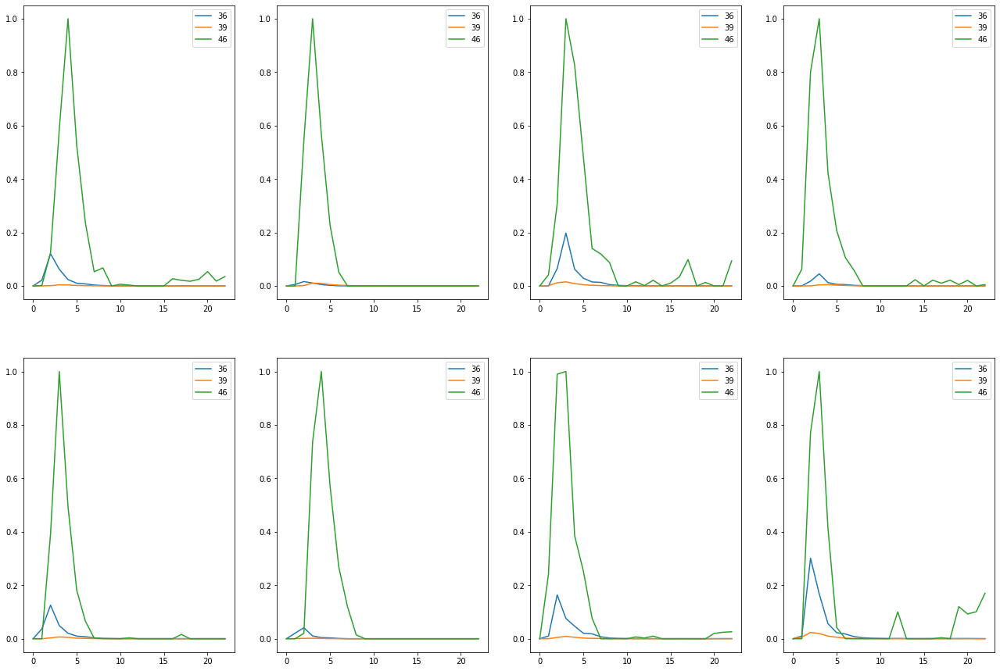

Substrate None


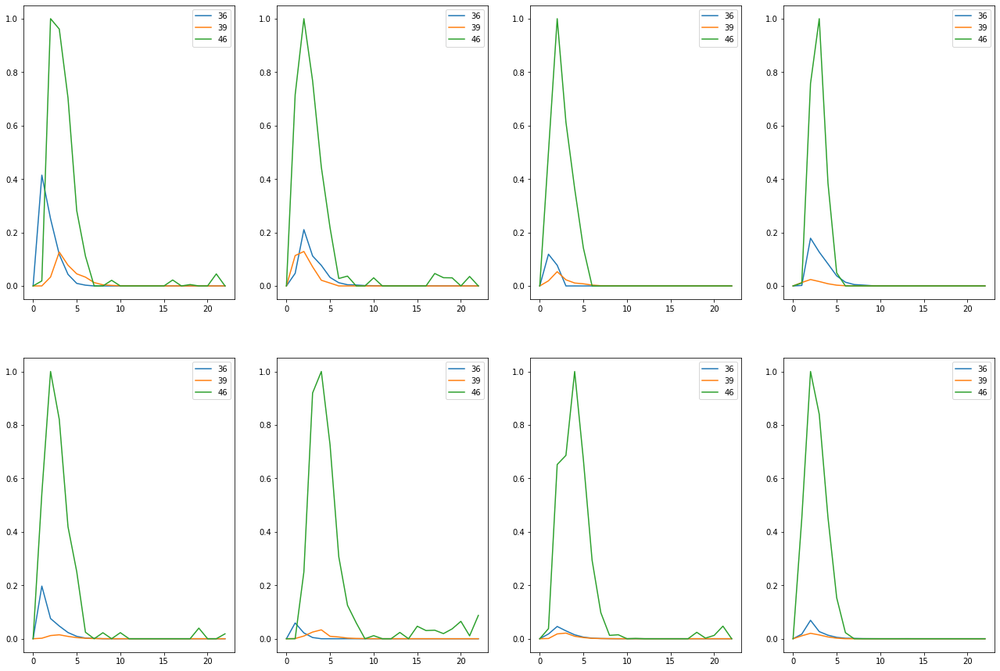

Substrate Per3


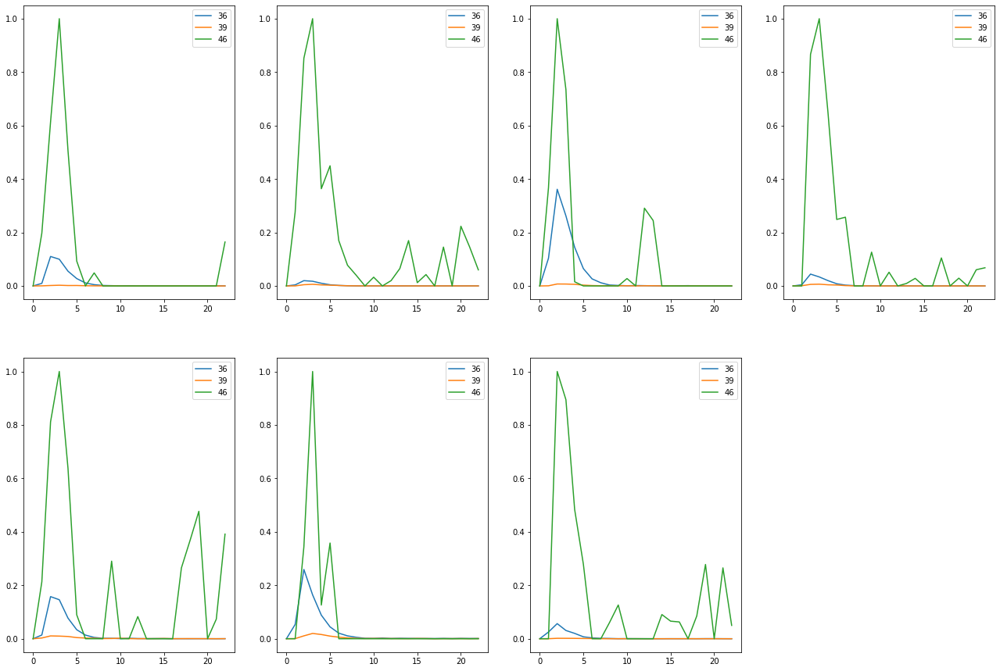

Substrate Per5


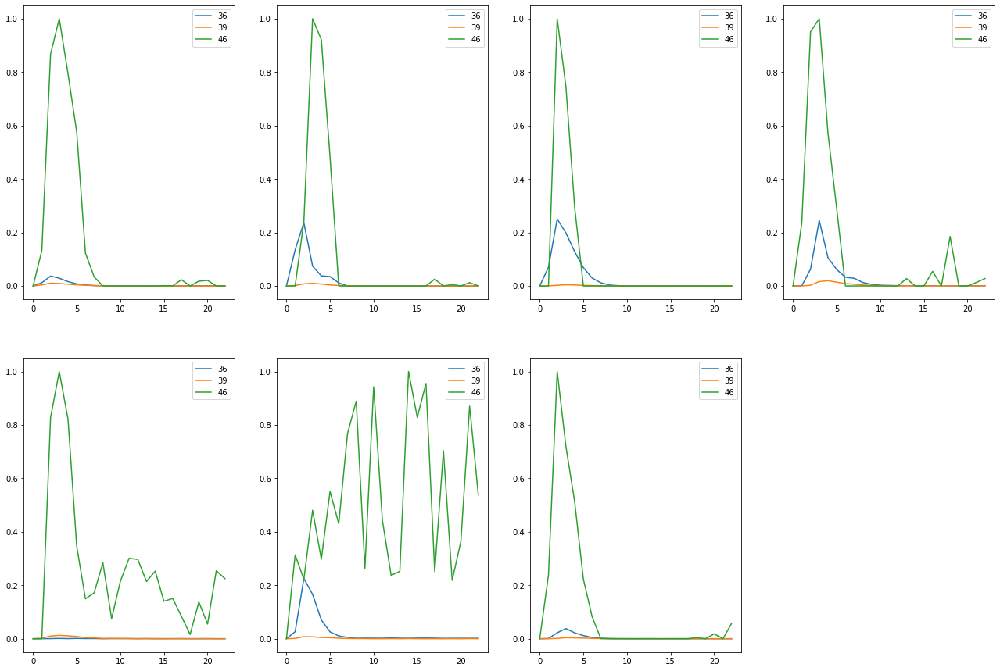

Compound 18
Substrate BG1


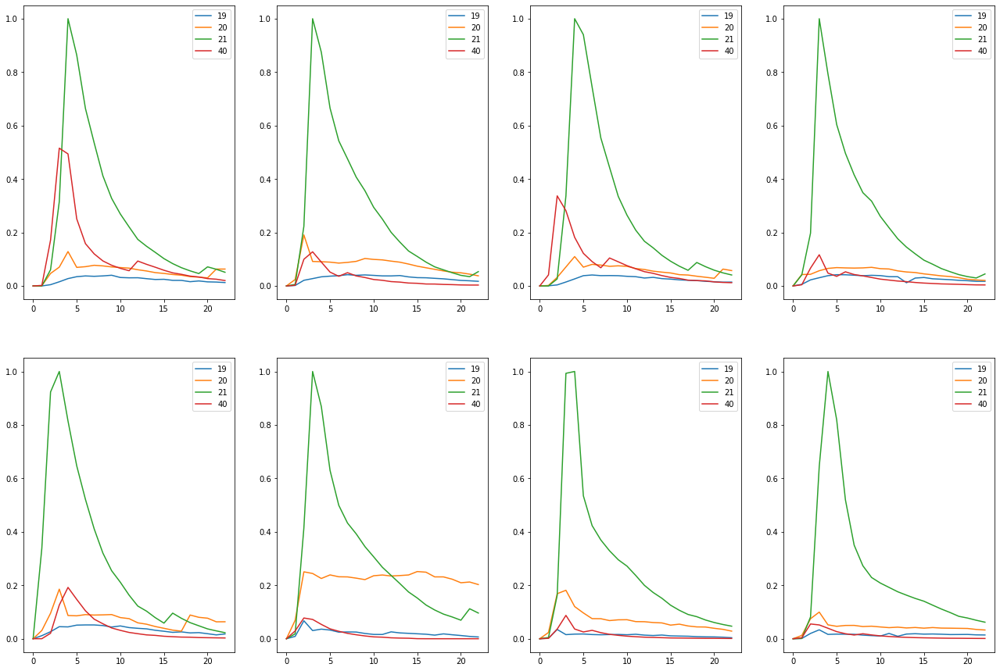

Substrate BG4


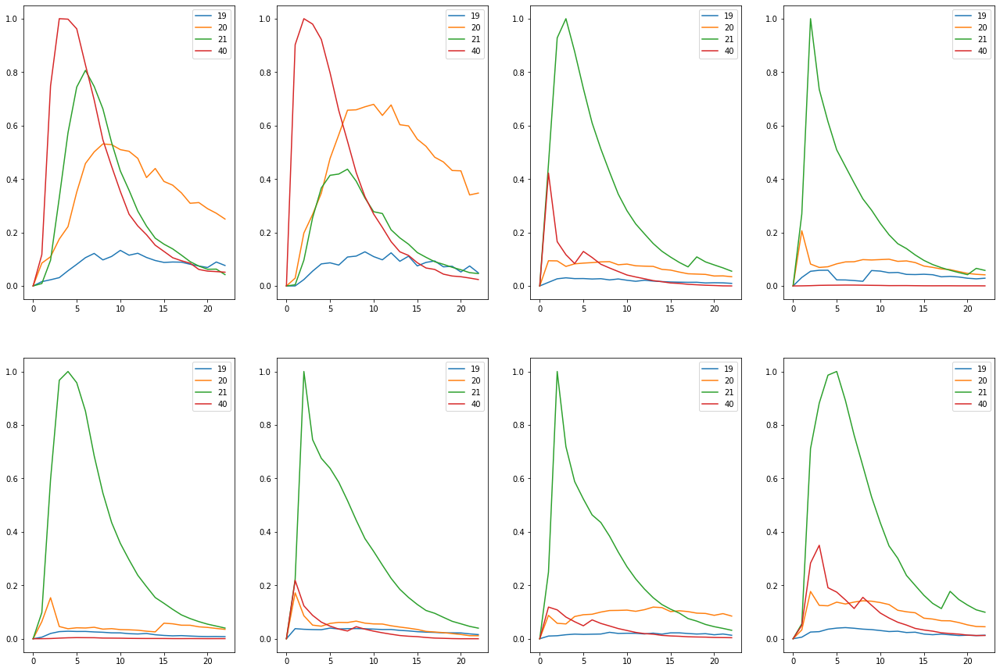

Substrate CB4


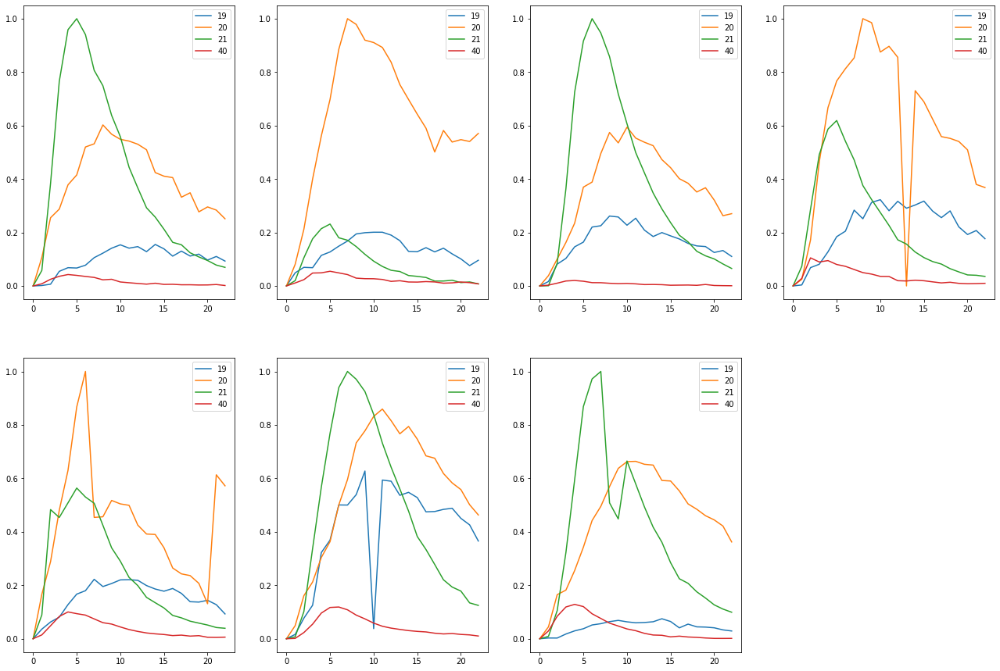

Substrate Med4


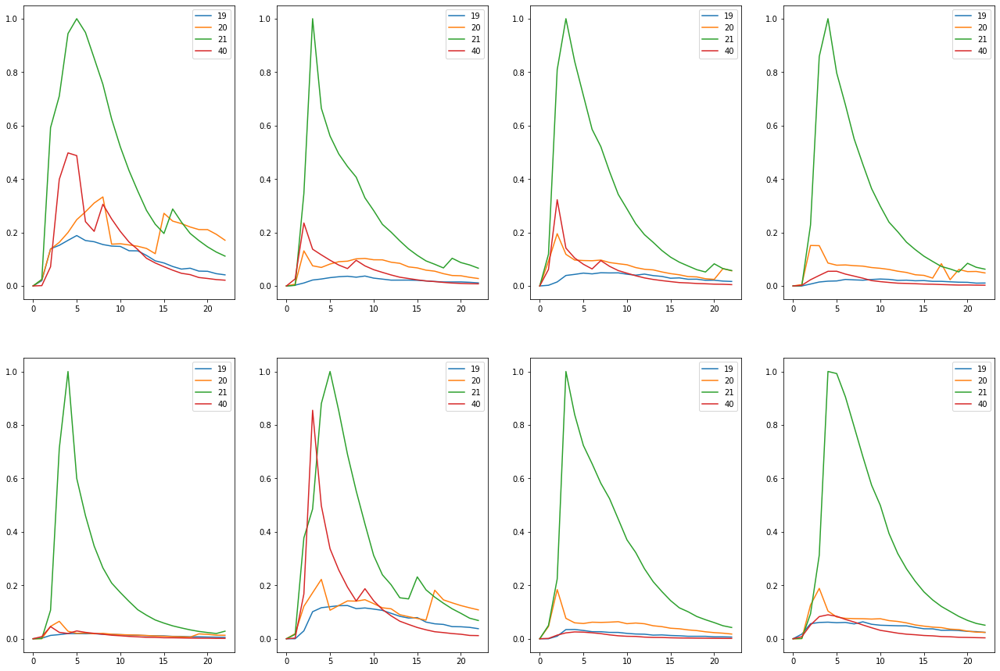

Substrate None


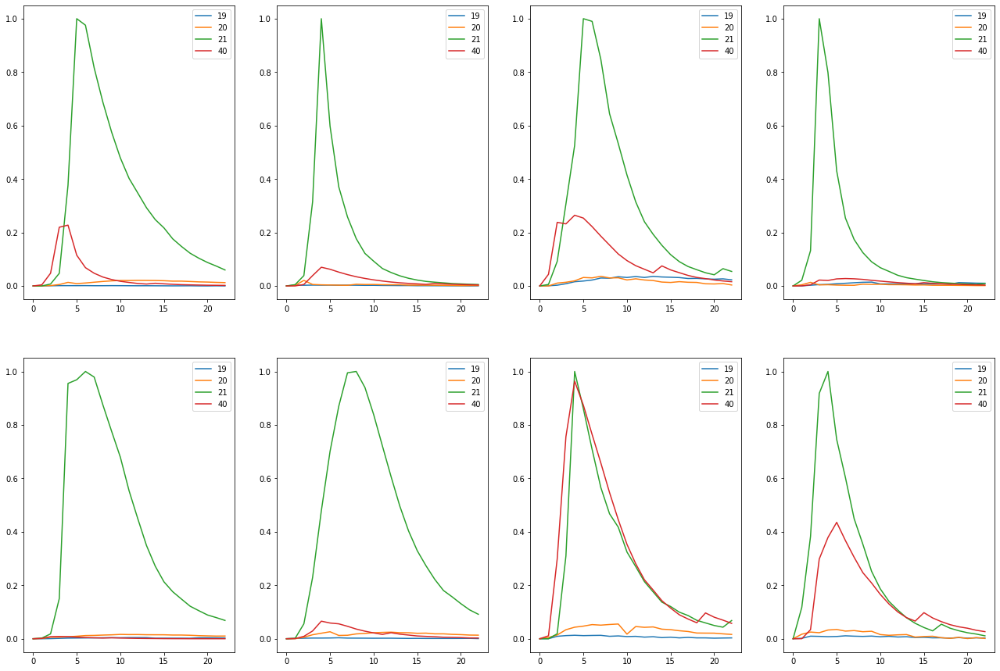

Substrate Per3


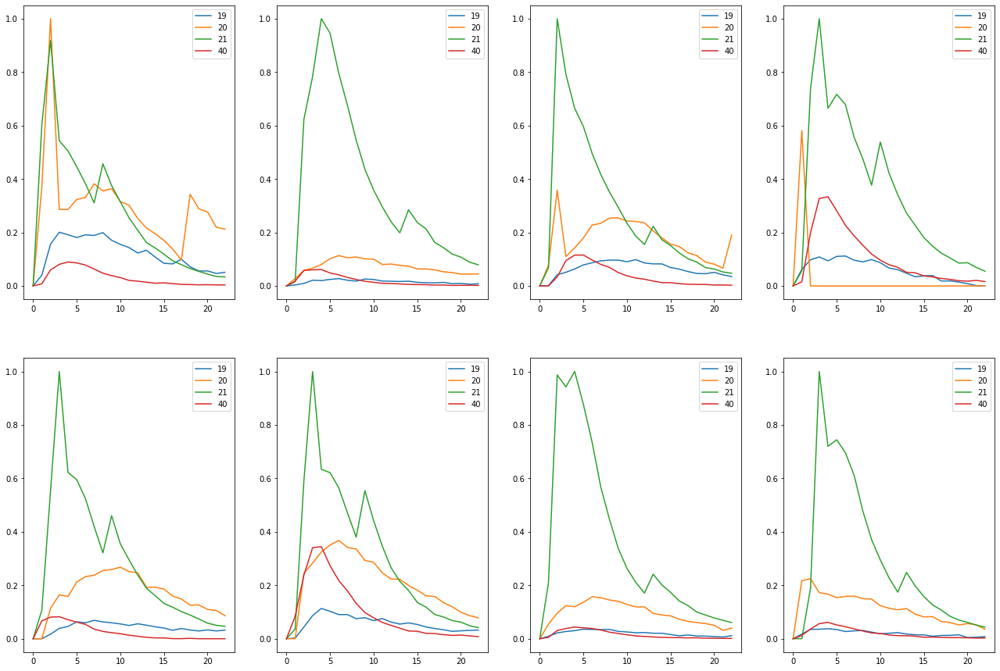

Substrate Per5


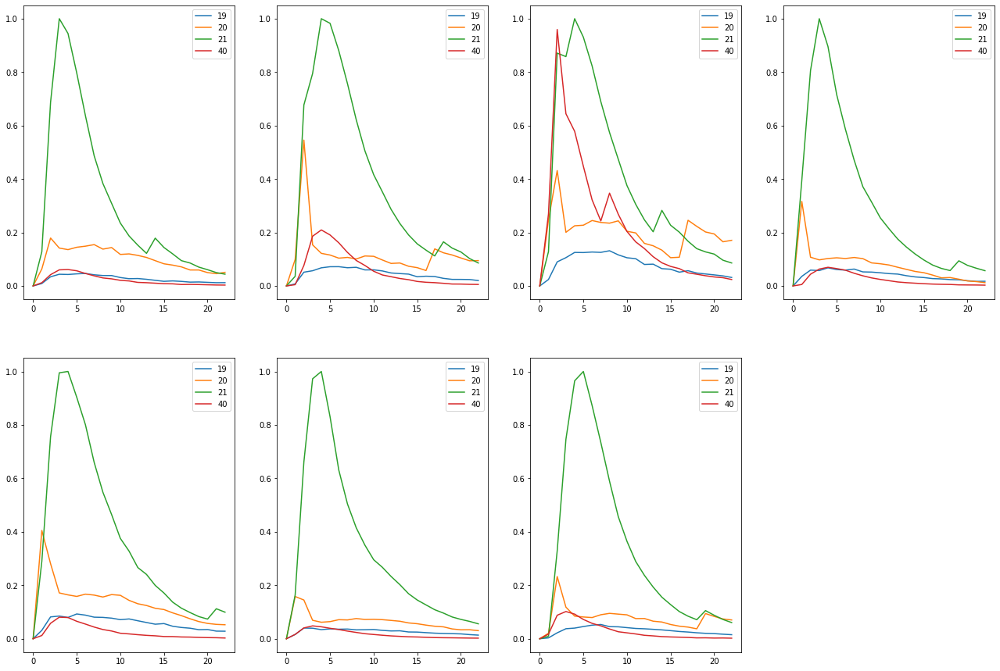

Compound 19
Substrate None


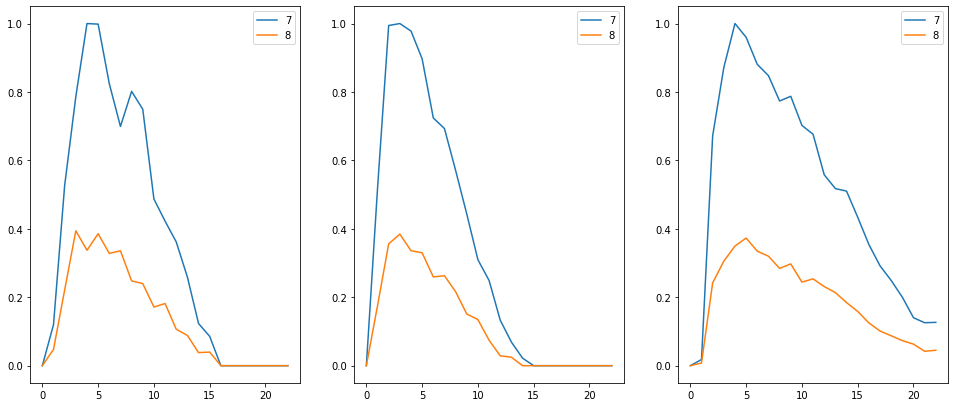

Compound 21
Substrate None


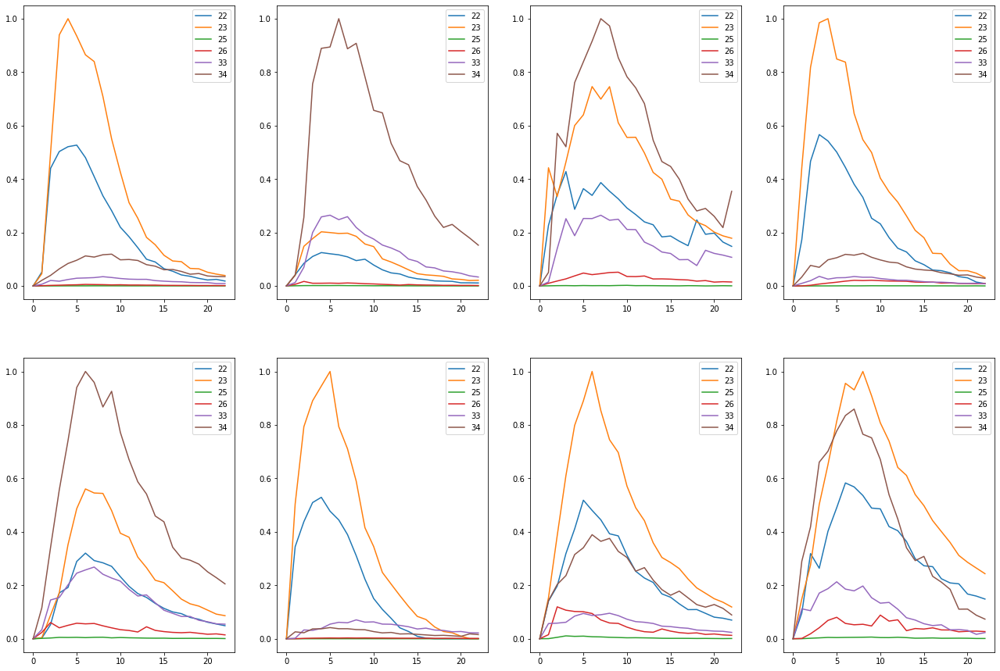

Compound 22
Substrate BG1


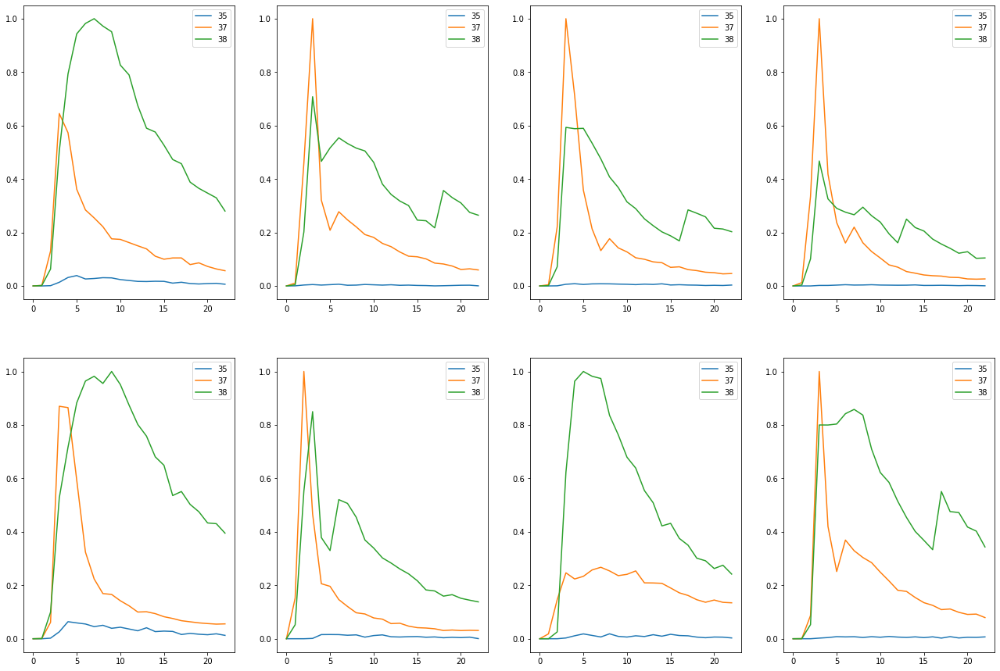

Substrate BG4


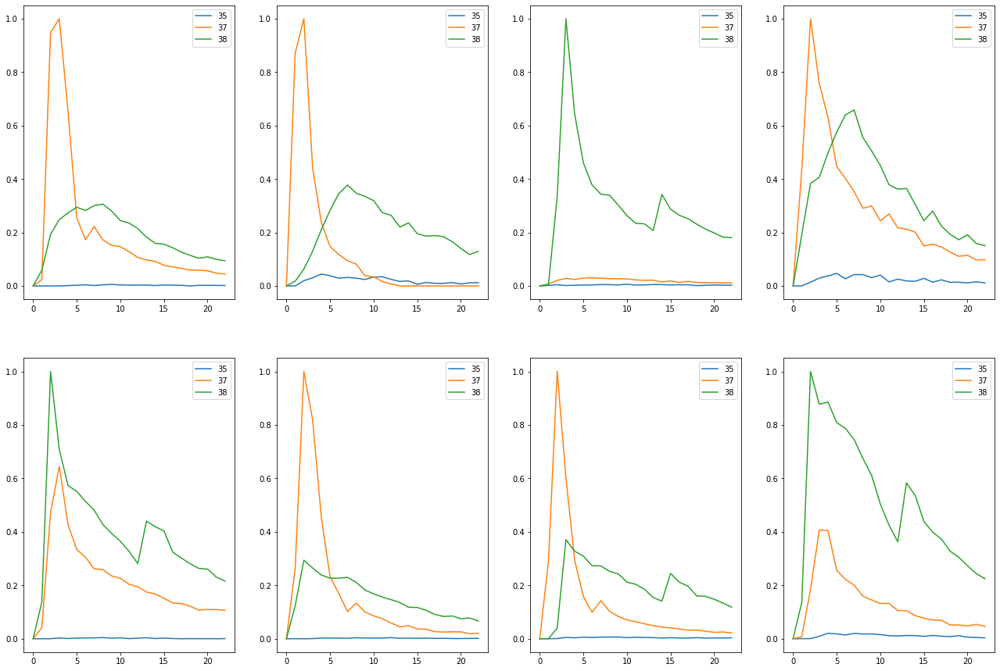

Substrate CB4


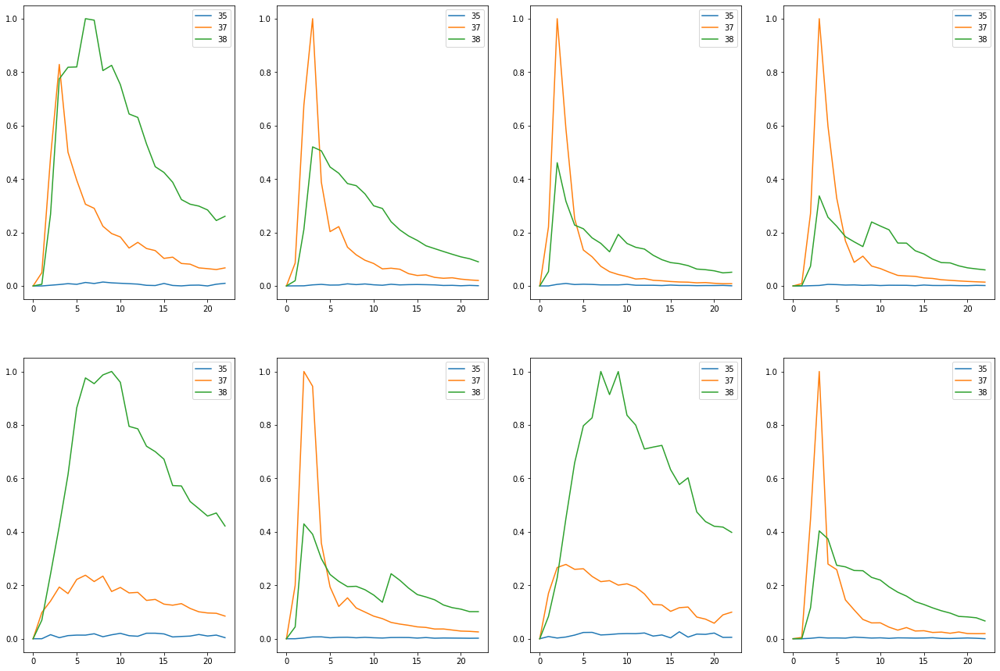

Substrate Med4


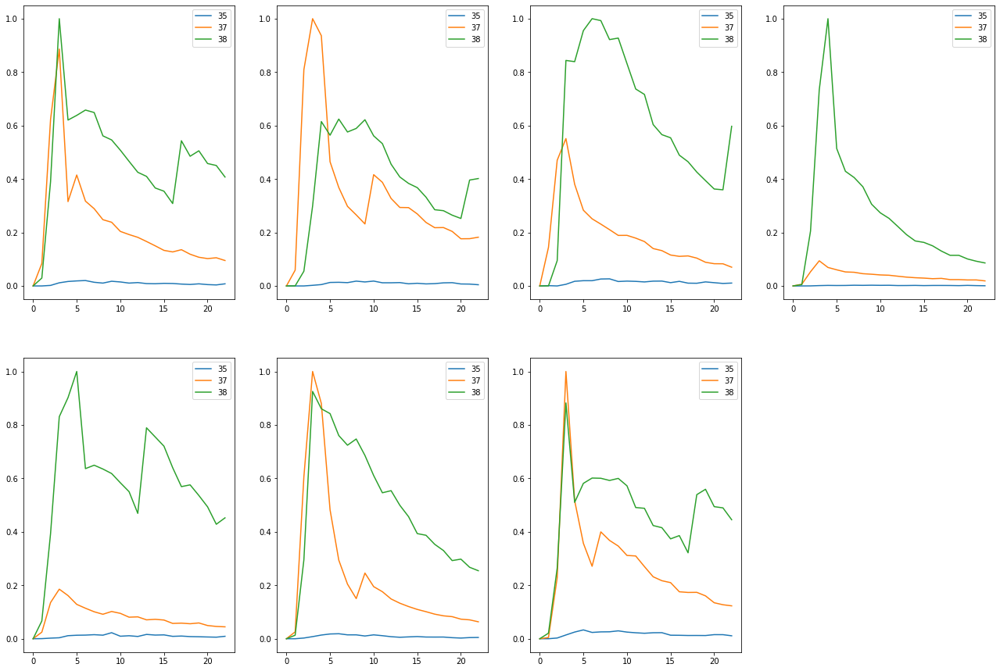

Substrate None


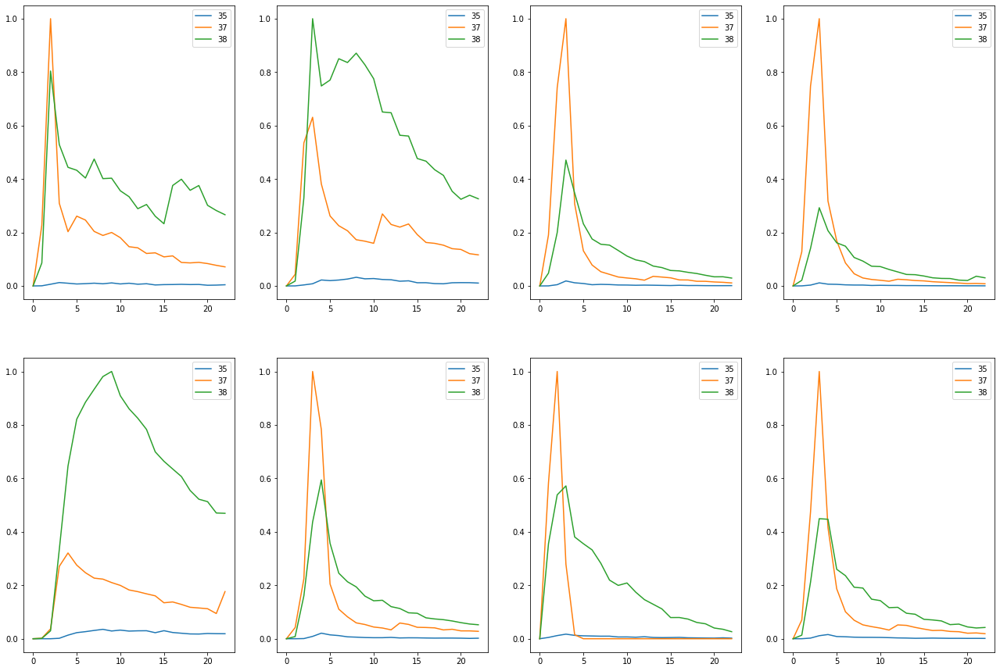

Substrate Per3


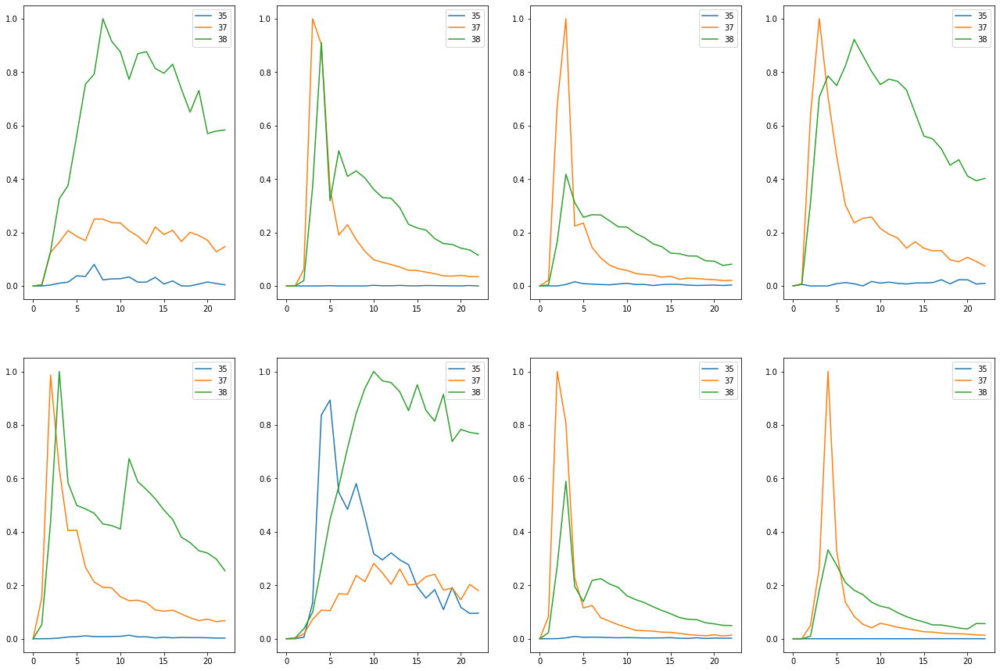

Substrate Per5


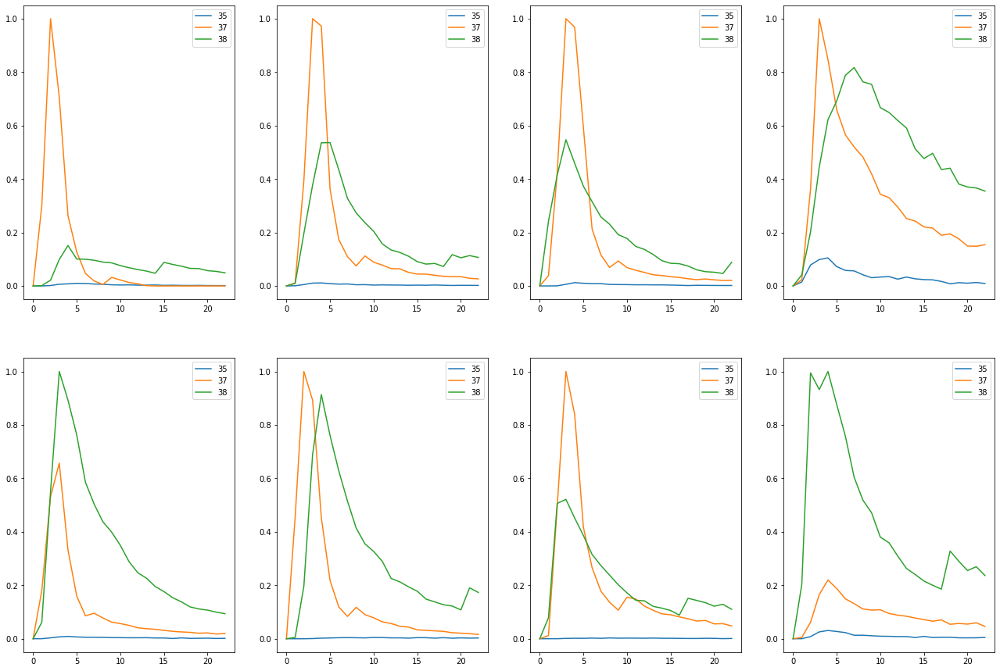

In [45]:
for compound_id, substrate_to_masspair_to_dataset in compound_ids_to_substrate_to_masspair_to_dataset.items():
    print("Compound", compound_id)
    for substrate, masspair_to_dataset in substrate_to_masspair_to_dataset.items():
        if substrate == "Blank" or len(list(masspair_to_dataset.values())[0]) == 0:
            continue
        print("Substrate", substrate)
        plot_visuals(masspair_to_dataset)

## Reflection

Notes: Student adequately summarizes the end-to-end problem solution and discusses one or two particular aspects of the project they found interesting or difficult.

## Improvement

Notes: Discussion is made as to how one aspect of the implementation could be improved. Potential solutions resulting from these improvements are considered and compared/contrasted to the current solution.